In [ ]:
!pip install d3rlpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 45.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 18.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 9.6 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np

## Prepare the dataset 

In [ ]:
# Read the data to compute the probabilities 

df1 = pd.read_csv('Final_Datasetnew.csv')
df2 = pd.read_csv('Final_Datasetnew2.csv')
data = pd.concat([df1, df2])

data.head()

,State,Action,Reward,Next_State
0,1,neutral,-1,1.0
1,1,neutral,10,2.0
2,2,neutral,10,2.0
3,2,neutral,-1,1.0
4,1,neutral,10,2.0


In [ ]:
data_MDP = data.drop('Next_State', axis = 1)
data_MDP.head()

,State,Action,Reward
0,1,neutral,-1
1,1,neutral,10
2,2,neutral,10
3,2,neutral,-1
4,1,neutral,10


In [ ]:
# Need to label encode the actions 
# Positive - 2
# Neutral - 1
# Negative - 0 

from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
data_MDP['Action'] = label_encoder.fit_transform(data_MDP['Action'])
print(data_MDP['Action'].unique())
data_MDP.head(5)

[1 2 0]


,State,Action,Reward
0,1,1,-1
1,1,1,10
2,2,1,10
3,2,1,-1
4,1,1,10


In [ ]:
# Need to add episode terminals 

data_MDP['ET'] = np.zeros(len(data_MDP)).astype(int)
data_MDP.head()

,State,Action,Reward,ET
0,1,1,-1,0
1,1,1,10,0
2,2,1,10,0
3,2,1,-1,0
4,1,1,10,0


In [ ]:
data_MDP.loc[::36, 'ET'] = 1

In [ ]:
data_MDP['ET'].value_counts()

0    6375
1     183
Name: ET, dtype: int64

In [ ]:
# Final dataset 
data_MDP.head()

,State,Action,Reward,ET
0,1,1,-1,1
1,1,1,10,0
2,2,1,10,0
3,2,1,-1,0
4,1,1,10,0


In [ ]:
# Save dataset 
data_MDP.to_csv('data_New_MDP.csv', index=False)

## Run Algorithms 

In [ ]:
# Read the data 

data_MDP = pd.read_csv('/content/data_New_MDP.csv')
data_MDP.head()

,State,Action,Reward,ET
0,1,1,-1,1
1,1,1,10,0
2,2,1,10,0
3,2,1,-1,0
4,1,1,10,0


In [ ]:
observations = data_MDP['State'].to_numpy()
actions = data_MDP['Action'].to_numpy()
rewards = data_MDP['Reward'].to_numpy()
terminals = np.zeros(len(data_MDP))
episode_terminals = data_MDP['ET'].to_numpy()

In [ ]:
observations_new = observations.reshape(-1,1)
actions_new = actions.reshape(-1,1)

In [ ]:
import d3rlpy

dataset = d3rlpy.dataset.MDPDataset(
    observations=observations_new,
    actions=actions_new,
    rewards=rewards,
    terminals=terminals,
    episode_terminals=episode_terminals,
    discrete_action=True,
)

## SAC

In [ ]:
from d3rlpy.algos import DiscreteSAC
from sklearn.model_selection import train_test_split
from d3rlpy.metrics.scorer import discounted_sum_of_advantage_scorer
from d3rlpy.metrics.scorer import td_error_scorer
from d3rlpy.metrics.scorer import average_value_estimation_scorer

# setup DSAC algorithm
sac = DiscreteSAC( actor_learning_rate=0.005, critic_learning_rate=0.005, temp_learning_rate=0.01, batch_size=32, gamma= 0.99, target_update_interval=3000, use_gpu=True)
#sac = DiscreteSAC(target_update_interval=3000, use_gpu=True)

# split train and test episodes
train_episodes, test_episodes = train_test_split(dataset, test_size=0.2)

# start training
result = sac.fit(train_episodes,
        eval_episodes=test_episodes,
        n_epochs=500, # Run for longer 
        scorers={
            'advantage': discounted_sum_of_advantage_scorer, # smaller is better
            'td_error': td_error_scorer, # smaller is better
            'value_scale': average_value_estimation_scorer # smaller is better
        })

2023-04-14 19:16:44 [debug    ] RoundIterator is selected.
2023-04-14 19:16:44 [info     ] Directory is created at d3rlpy_logs/DiscreteSAC_20230414191644
2023-04-14 19:16:44 [debug    ] Building models...
2023-04-14 19:16:44 [debug    ] Models have been built.
2023-04-14 19:16:44 [info     ] Parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/params.json params={'action_scaler': None, 'actor_encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'actor_learning_rate': 0.005, 'actor_optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 0.0001, 'weight_decay': 0, 'amsgrad': False}, 'batch_size': 50, 'critic_encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'critic_learning_rate': 0.005, 'critic_optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 0.0001, 'weight_decay': 0, 'amsgrad': False}, 'gamma': 0.99, 'generate

Epoch 1/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:45 [info     ] DiscreteSAC_20230414191644: epoch=1 step=101 epoch=1 metrics={'time_sample_batch': 0.00016445216566029163, 'time_algorithm_update': 0.010743906002233523, 'temp_loss': -1.9154187806946512, 'temp': 1.8306082764474472, 'critic_loss': 31.59264660825824, 'actor_loss': -13.967674300222114, 'time_step': 0.010994724708028359, 'advantage': -11.233095055707759, 'td_error': 1372.1310884723332, 'value_scale': 16.177508628874673} step=101
2023-04-14 19:16:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_101.pt


Epoch 2/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:47 [info     ] DiscreteSAC_20230414191644: epoch=2 step=202 epoch=2 metrics={'time_sample_batch': 0.00015788031096505647, 'time_algorithm_update': 0.010153423441518651, 'temp_loss': -9.854305548243003, 'temp': 9.339435789844778, 'critic_loss': 30.77837349164604, 'actor_loss': -14.048878055987972, 'time_step': 0.010393784777952893, 'advantage': 37.74112242568337, 'td_error': 1185.738626217658, 'value_scale': 9.991475041952834} step=202
2023-04-14 19:16:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_202.pt


Epoch 3/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:48 [info     ] DiscreteSAC_20230414191644: epoch=3 step=303 epoch=3 metrics={'time_sample_batch': 0.00014108950548832958, 'time_algorithm_update': 0.01035246990694858, 'temp_loss': -117.55063793446757, 'temp': 112.36704492096854, 'critic_loss': 30.756882393714225, 'actor_loss': -14.364238257455353, 'time_step': 0.01057810358481832, 'advantage': -12.842123948665666, 'td_error': 1389.8803874193932, 'value_scale': 14.841214447316055} step=303
2023-04-14 19:16:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_303.pt


Epoch 4/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:49 [info     ] DiscreteSAC_20230414191644: epoch=4 step=404 epoch=4 metrics={'time_sample_batch': 0.00014309363790077737, 'time_algorithm_update': 0.010245431767831934, 'temp_loss': -3013.326825736773, 'temp': 2899.170026420367, 'critic_loss': 30.53730815471989, 'actor_loss': -14.629475801297934, 'time_step': 0.010479889293708423, 'advantage': -19.39937363530776, 'td_error': 1423.3016878309684, 'value_scale': 15.239241668524429} step=404
2023-04-14 19:16:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_404.pt


Epoch 5/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:52 [info     ] DiscreteSAC_20230414191644: epoch=5 step=505 epoch=5 metrics={'time_sample_batch': 0.00021409044171323872, 'time_algorithm_update': 0.019290107311588704, 'temp_loss': -136586.33904122835, 'temp': 132062.41865524443, 'critic_loss': 30.54520603217701, 'actor_loss': -15.637776006566416, 'time_step': 0.019754825252117497, 'advantage': -1.099830082164345, 'td_error': 1368.7337894546479, 'value_scale': 16.717775898642522} step=505
2023-04-14 19:16:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_505.pt


Epoch 6/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:54 [info     ] DiscreteSAC_20230414191644: epoch=6 step=606 epoch=6 metrics={'time_sample_batch': 0.0002872282915776319, 'time_algorithm_update': 0.012727388060919128, 'temp_loss': -9694512.69430693, 'temp': 9410943.38180693, 'critic_loss': 31.509740961660253, 'actor_loss': -88.43081970970229, 'time_step': 0.013165084442289749, 'advantage': -16.405434154374625, 'td_error': 1520.5052163756031, 'value_scale': 188.21493322895302} step=606
2023-04-14 19:16:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_606.pt


Epoch 7/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:55 [info     ] DiscreteSAC_20230414191644: epoch=7 step=707 epoch=7 metrics={'time_sample_batch': 0.00013748017868193068, 'time_algorithm_update': 0.01025262209448484, 'temp_loss': -994622180.6336634, 'temp': 968746837.2277228, 'critic_loss': 440.1500518345597, 'actor_loss': -7549.357599541692, 'time_step': 0.010481274954163202, 'advantage': 1565.6445712709426, 'td_error': 3696094.6180288424, 'value_scale': 17422.971283783783} step=707
2023-04-14 19:16:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_707.pt


Epoch 8/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:57 [info     ] DiscreteSAC_20230414191644: epoch=8 step=808 epoch=8 metrics={'time_sample_batch': 0.00015497679757599784, 'time_algorithm_update': 0.010377909877512715, 'temp_loss': -139075767154.05942, 'temp': 135840160580.43564, 'critic_loss': 608265.2066348236, 'actor_loss': -756472.9289139851, 'time_step': 0.010621644482754244, 'advantage': 22888.014238366246, 'td_error': 34415349886.10039, 'value_scale': 675977.9928571428} step=808
2023-04-14 19:16:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_808.pt


Epoch 9/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:58 [info     ] DiscreteSAC_20230414191644: epoch=9 step=909 epoch=9 metrics={'time_sample_batch': 0.0001391868780154993, 'time_algorithm_update': 0.010397684456098198, 'temp_loss': -25321624194707.01, 'temp': 24792401076953.98, 'critic_loss': 189259540.08415842, 'actor_loss': -98727379.1039604, 'time_step': 0.01065862768947488, 'advantage': 172931.9860969427, 'td_error': 662505515272.5251, 'value_scale': 2755133.9285714286} step=909
2023-04-14 19:16:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_909.pt


Epoch 10/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:16:59 [info     ] DiscreteSAC_20230414191644: epoch=10 step=1010 epoch=10 metrics={'time_sample_batch': 0.00015154451426893179, 'time_algorithm_update': 0.010572402784139803, 'temp_loss': -5787681104167236.0, 'temp': 5678592782312965.0, 'critic_loss': 44068231204.75247, 'actor_loss': -22265215209.188118, 'time_step': 0.01082465908314922, 'advantage': 495421.56274168333, 'td_error': 3507368870147.756, 'value_scale': 6175294.458301159} step=1010
2023-04-14 19:16:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1010.pt


Epoch 11/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:01 [info     ] DiscreteSAC_20230414191644: epoch=11 step=1111 epoch=11 metrics={'time_sample_batch': 0.00014436362993599163, 'time_algorithm_update': 0.010246486947087958, 'temp_loss': -1.6117416489752364e+18, 'temp': 1.5842486398743094e+18, 'critic_loss': 12296825692241.11, 'actor_loss': -6210534821685.228, 'time_step': 0.010478546123693484, 'advantage': 1027163.1670727163, 'td_error': 11258663476202.65, 'value_scale': 10908160.6011583} step=1111
2023-04-14 19:17:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1111.pt


Epoch 12/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:04 [info     ] DiscreteSAC_20230414191644: epoch=12 step=1212 epoch=12 metrics={'time_sample_batch': 0.0002370777696666151, 'time_algorithm_update': 0.01634162959485951, 'temp_loss': -1.8205396307281015e+19, 'temp': 1.6995513263788022e+19, 'critic_loss': 131918125666750.1, 'actor_loss': -66625346628212.59, 'time_step': 0.01685690407705779, 'advantage': 1753530.494985954, 'td_error': 27773592274022.797, 'value_scale': 16976327.888030887} step=1212
2023-04-14 19:17:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1212.pt


Epoch 13/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:08 [info     ] DiscreteSAC_20230414191644: epoch=13 step=1313 epoch=13 metrics={'time_sample_batch': 0.00028055257136278813, 'time_algorithm_update': 0.037304951412843006, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041649665500.52, 'actor_loss': -68707945016249.03, 'time_step': 0.037909847674983566, 'advantage': 2672496.9540573256, 'td_error': 58113352980978.164, 'value_scale': 24399215.885714285} step=1313
2023-04-14 19:17:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1313.pt


Epoch 14/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:11 [info     ] DiscreteSAC_20230414191644: epoch=14 step=1414 epoch=14 metrics={'time_sample_batch': 0.0002489444052818978, 'time_algorithm_update': 0.020650714930921497, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041638120782.58, 'actor_loss': -68707953612495.84, 'time_step': 0.02104689107082858, 'advantage': 3965096.828595555, 'td_error': 108678131918805.3, 'value_scale': 33199061.376061775} step=1414
2023-04-14 19:17:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1414.pt


Epoch 15/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:13 [info     ] DiscreteSAC_20230414191644: epoch=15 step=1515 epoch=15 metrics={'time_sample_batch': 0.00016509424341787206, 'time_algorithm_update': 0.0135633119262091, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041618353567.69, 'actor_loss': -68707961834992.79, 'time_step': 0.01380114508147287, 'advantage': 5023198.705230004, 'td_error': 187383153286889.66, 'value_scale': 43443400.91428571} step=1515
2023-04-14 19:17:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1515.pt


Epoch 16/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:14 [info     ] DiscreteSAC_20230414191644: epoch=16 step=1616 epoch=16 metrics={'time_sample_batch': 0.00012550259580706606, 'time_algorithm_update': 0.010570724411766128, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041595347187.33, 'actor_loss': -68707973462766.26, 'time_step': 0.010762009290185306, 'advantage': 6031154.6773992255, 'td_error': 303650613197291.8, 'value_scale': 55157519.12277992} step=1616
2023-04-14 19:17:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1616.pt


Epoch 17/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:16 [info     ] DiscreteSAC_20230414191644: epoch=17 step=1717 epoch=17 metrics={'time_sample_batch': 0.00016787500664739325, 'time_algorithm_update': 0.010207294237495649, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041568769419.4, 'actor_loss': -68707984384567.766, 'time_step': 0.01043934161120122, 'advantage': 7959288.847774574, 'td_error': 468692551832833.0, 'value_scale': 68337749.23861004} step=1717
2023-04-14 19:17:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1717.pt


Epoch 18/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:17 [info     ] DiscreteSAC_20230414191644: epoch=18 step=1818 epoch=18 metrics={'time_sample_batch': 0.00017611579139633935, 'time_algorithm_update': 0.01091575858616593, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041540281374.42, 'actor_loss': -68707998545534.734, 'time_step': 0.011164034947310345, 'advantage': 9327788.939312456, 'td_error': 695008250144472.2, 'value_scale': 83062495.08571428} step=1818
2023-04-14 19:17:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1818.pt


Epoch 19/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:19 [info     ] DiscreteSAC_20230414191644: epoch=19 step=1919 epoch=19 metrics={'time_sample_batch': 0.00042098583561359066, 'time_algorithm_update': 0.013709207572559319, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041512042496.0, 'actor_loss': -68708013661640.234, 'time_step': 0.014230645529114374, 'advantage': 10991348.624098971, 'td_error': 997484854604759.6, 'value_scale': 99338855.53359073} step=1919
2023-04-14 19:17:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_1919.pt


Epoch 20/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:21 [info     ] DiscreteSAC_20230414191644: epoch=20 step=2020 epoch=20 metrics={'time_sample_batch': 0.00013930254643506343, 'time_algorithm_update': 0.010392059193979395, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041476826953.5, 'actor_loss': -68708030065106.375, 'time_step': 0.010600257628034838, 'advantage': 13278132.400035894, 'td_error': 1392823271643330.5, 'value_scale': 117188312.64864865} step=2020
2023-04-14 19:17:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2020.pt


Epoch 21/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:22 [info     ] DiscreteSAC_20230414191644: epoch=21 step=2121 epoch=21 metrics={'time_sample_batch': 0.0001475811004638672, 'time_algorithm_update': 0.010550709054021551, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041441777522.06, 'actor_loss': -68708046593155.805, 'time_step': 0.010772882121624333, 'advantage': 15795492.99335627, 'td_error': 1897120294770869.8, 'value_scale': 136576165.4857143} step=2121
2023-04-14 19:17:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2121.pt


Epoch 22/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:24 [info     ] DiscreteSAC_20230414191644: epoch=22 step=2222 epoch=22 metrics={'time_sample_batch': 0.00013798062164004486, 'time_algorithm_update': 0.010368382576668616, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041400083648.64, 'actor_loss': -68708065654398.734, 'time_step': 0.010572754510558478, 'advantage': 18755032.65429888, 'td_error': 2533718708193509.5, 'value_scale': 157624438.8200772} step=2222
2023-04-14 19:17:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2222.pt


Epoch 23/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:25 [info     ] DiscreteSAC_20230414191644: epoch=23 step=2323 epoch=23 metrics={'time_sample_batch': 0.0001635598664236541, 'time_algorithm_update': 0.010519379436379612, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041355731998.42, 'actor_loss': -68708086459807.68, 'time_step': 0.010767903658423093, 'advantage': 21046544.376460236, 'td_error': 3324105481610399.0, 'value_scale': 180370184.75984555} step=2323
2023-04-14 19:17:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2323.pt


Epoch 24/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:26 [info     ] DiscreteSAC_20230414191644: epoch=24 step=2424 epoch=24 metrics={'time_sample_batch': 0.00015399243571970723, 'time_algorithm_update': 0.01027412461762381, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041308971737.98, 'actor_loss': -68708109050910.414, 'time_step': 0.010492457021581063, 'advantage': 23317522.609950792, 'td_error': 4293560974850590.5, 'value_scale': 204820811.84864864} step=2424
2023-04-14 19:17:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2424.pt


Epoch 25/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:28 [info     ] DiscreteSAC_20230414191644: epoch=25 step=2525 epoch=25 metrics={'time_sample_batch': 0.0001626888124069365, 'time_algorithm_update': 0.01067172654784552, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041258224812.36, 'actor_loss': -68708133095484.83, 'time_step': 0.010906372920121296, 'advantage': 24923161.087519433, 'td_error': 5467256649372575.0, 'value_scale': 230990915.73127413} step=2525
2023-04-14 19:17:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2525.pt


Epoch 26/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:30 [info     ] DiscreteSAC_20230414191644: epoch=26 step=2626 epoch=26 metrics={'time_sample_batch': 0.00030360599555591546, 'time_algorithm_update': 0.012851648991650875, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041202992888.39, 'actor_loss': -68708158593530.93, 'time_step': 0.013235630375323909, 'advantage': 28425930.35452978, 'td_error': 6878859823342422.0, 'value_scale': 258866171.53976834} step=2626
2023-04-14 19:17:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2626.pt


Epoch 27/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:32 [info     ] DiscreteSAC_20230414191644: epoch=27 step=2727 epoch=27 metrics={'time_sample_batch': 0.000348220957387792, 'time_algorithm_update': 0.019512414932250977, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041147179575.77, 'actor_loss': -68708185960326.336, 'time_step': 0.01995580739314013, 'advantage': 32960323.635119405, 'td_error': 8553271119237819.0, 'value_scale': 288394130.24864864} step=2727
2023-04-14 19:17:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2727.pt


Epoch 28/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:34 [info     ] DiscreteSAC_20230414191644: epoch=28 step=2828 epoch=28 metrics={'time_sample_batch': 0.00014354686925906947, 'time_algorithm_update': 0.012997216517382329, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041085967654.02, 'actor_loss': -68708215154343.29, 'time_step': 0.013225255626263005, 'advantage': 36706842.298965976, 'td_error': 1.0531236178046834e+16, 'value_scale': 319784019.0517374} step=2828
2023-04-14 19:17:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2828.pt


Epoch 29/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:36 [info     ] DiscreteSAC_20230414191644: epoch=29 step=2929 epoch=29 metrics={'time_sample_batch': 0.0001394536235544941, 'time_algorithm_update': 0.01074261712555838, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041020935178.14, 'actor_loss': -68708244389888.0, 'time_step': 0.010954708156019155, 'advantage': 39921751.16803276, 'td_error': 1.2841118182599284e+16, 'value_scale': 352933799.24015445} step=2929
2023-04-14 19:17:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_2929.pt


Epoch 30/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:37 [info     ] DiscreteSAC_20230414191644: epoch=30 step=3030 epoch=30 metrics={'time_sample_batch': 0.00014275607496204944, 'time_algorithm_update': 0.010856323903149898, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041156315683.48, 'actor_loss': -68708278235014.336, 'time_step': 0.011074044916889455, 'advantage': 43436523.46914813, 'td_error': 1.5528617463852154e+16, 'value_scale': 387914015.01158303} step=3030
2023-04-14 19:17:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3030.pt


Epoch 31/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:39 [info     ] DiscreteSAC_20230414191644: epoch=31 step=3131 epoch=31 metrics={'time_sample_batch': 0.00014989682943514077, 'time_algorithm_update': 0.010511476214569394, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041585380524.36, 'actor_loss': -68708311997085.15, 'time_step': 0.010733646921592184, 'advantage': 49136018.30997502, 'td_error': 1.863713115407156e+16, 'value_scale': 424669747.2} step=3131
2023-04-14 19:17:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3131.pt


Epoch 32/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:40 [info     ] DiscreteSAC_20230414191644: epoch=32 step=3232 epoch=32 metrics={'time_sample_batch': 0.00016952977322115756, 'time_algorithm_update': 0.01065702485566092, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041509384719.2, 'actor_loss': -68708347088044.36, 'time_step': 0.010895058660223932, 'advantage': 52284853.09198956, 'td_error': 2.2202612165827236e+16, 'value_scale': 463349584.45714283} step=3232
2023-04-14 19:17:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3232.pt


Epoch 33/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:42 [info     ] DiscreteSAC_20230414191644: epoch=33 step=3333 epoch=33 metrics={'time_sample_batch': 0.000148050855882097, 'time_algorithm_update': 0.01130109966391384, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041430980303.84, 'actor_loss': -68708385584280.08, 'time_step': 0.011528222867757967, 'advantage': 58838057.63314799, 'td_error': 2.6283085538491176e+16, 'value_scale': 503807449.45173746} step=3333
2023-04-14 19:17:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3333.pt


Epoch 34/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:43 [info     ] DiscreteSAC_20230414191644: epoch=34 step=3434 epoch=34 metrics={'time_sample_batch': 0.0004170625516683748, 'time_algorithm_update': 0.012869232952004612, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041348173945.66, 'actor_loss': -68708424122043.56, 'time_step': 0.013373228583005395, 'advantage': 64411831.535997614, 'td_error': 3.0917231175229308e+16, 'value_scale': 546161678.8509653} step=3434
2023-04-14 19:17:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3434.pt


Epoch 35/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:45 [info     ] DiscreteSAC_20230414191644: epoch=35 step=3535 epoch=35 metrics={'time_sample_batch': 0.00035004568572091587, 'time_algorithm_update': 0.012910290519789895, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041260716478.1, 'actor_loss': -68708465691333.7, 'time_step': 0.013341042074826684, 'advantage': 71470849.96982007, 'td_error': 3.615846013144403e+16, 'value_scale': 590330048.0} step=3535
2023-04-14 19:17:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3535.pt


Epoch 36/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:47 [info     ] DiscreteSAC_20230414191644: epoch=36 step=3636 epoch=36 metrics={'time_sample_batch': 0.00014224618968397085, 'time_algorithm_update': 0.0105420716918341, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041170352067.17, 'actor_loss': -68708508174234.62, 'time_step': 0.010756577595625774, 'advantage': 75330515.81219718, 'td_error': 4.2094539702783736e+16, 'value_scale': 636767723.6633204} step=3636
2023-04-14 19:17:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3636.pt


Epoch 37/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:48 [info     ] DiscreteSAC_20230414191644: epoch=37 step=3737 epoch=37 metrics={'time_sample_batch': 0.00019838078187243773, 'time_algorithm_update': 0.010576510193324324, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041075585713.42, 'actor_loss': -68708552525884.83, 'time_step': 0.01084207544232359, 'advantage': 81566563.40262651, 'td_error': 4.8737419164994184e+16, 'value_scale': 684908416.0} step=3737
2023-04-14 19:17:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3737.pt


Epoch 38/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:50 [info     ] DiscreteSAC_20230414191644: epoch=38 step=3838 epoch=38 metrics={'time_sample_batch': 0.00013069115062751393, 'time_algorithm_update': 0.010444537247761641, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040978078527.36, 'actor_loss': -68708599493784.08, 'time_step': 0.010641428503659692, 'advantage': 85781508.60964935, 'td_error': 5.6177603774708296e+16, 'value_scale': 735161870.6285714} step=3838
2023-04-14 19:17:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3838.pt


Epoch 39/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:51 [info     ] DiscreteSAC_20230414191644: epoch=39 step=3939 epoch=39 metrics={'time_sample_batch': 0.00031555525147088684, 'time_algorithm_update': 0.012990174907268864, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040875421898.77, 'actor_loss': -68708648621126.97, 'time_step': 0.013392882772011332, 'advantage': 94006754.51366611, 'td_error': 6.447613062140613e+16, 'value_scale': 787239149.4177606} step=3939
2023-04-14 19:17:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_3939.pt


Epoch 40/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:53 [info     ] DiscreteSAC_20230414191644: epoch=40 step=4040 epoch=40 metrics={'time_sample_batch': 0.00024927016532067024, 'time_algorithm_update': 0.011620861468928875, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040768944716.05, 'actor_loss': -68708698537497.34, 'time_step': 0.01194248105039691, 'advantage': 101891399.12741742, 'td_error': 7.368273347629851e+16, 'value_scale': 841261191.1660231} step=4040
2023-04-14 19:17:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4040.pt


Epoch 41/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:54 [info     ] DiscreteSAC_20230414191644: epoch=41 step=4141 epoch=41 metrics={'time_sample_batch': 0.00014139165972719097, 'time_algorithm_update': 0.010503351098240013, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040658480868.12, 'actor_loss': -68708750488728.08, 'time_step': 0.010723730125049553, 'advantage': 107318250.2353812, 'td_error': 8.392543582885666e+16, 'value_scale': 897618157.5660231} step=4141
2023-04-14 19:17:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4141.pt


Epoch 42/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:56 [info     ] DiscreteSAC_20230414191644: epoch=42 step=4242 epoch=42 metrics={'time_sample_batch': 0.0003511764035366549, 'time_algorithm_update': 0.014148341547144522, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040544445632.64, 'actor_loss': -68708804640930.22, 'time_step': 0.014599276061105256, 'advantage': 117278524.48045498, 'td_error': 9.521093533696638e+16, 'value_scale': 955673969.3714286} step=4242
2023-04-14 19:17:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4242.pt


Epoch 43/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:58 [info     ] DiscreteSAC_20230414191644: epoch=43 step=4343 epoch=43 metrics={'time_sample_batch': 0.000256939689711769, 'time_algorithm_update': 0.011923256486949354, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040424596510.42, 'actor_loss': -68708861077159.29, 'time_step': 0.012263746544866278, 'advantage': 125997908.94919384, 'td_error': 1.07657210248708e+17, 'value_scale': 1015901261.0965251} step=4343
2023-04-14 19:17:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4343.pt


Epoch 44/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:17:59 [info     ] DiscreteSAC_20230414191644: epoch=44 step=4444 epoch=44 metrics={'time_sample_batch': 0.00015797001300471843, 'time_algorithm_update': 0.01057008705516853, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040303252388.75, 'actor_loss': -68708918966860.04, 'time_step': 0.010796034690177087, 'advantage': 132153368.2688987, 'td_error': 1.2135446115334474e+17, 'value_scale': 1078392246.857143} step=4444
2023-04-14 19:17:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4444.pt


Epoch 45/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:01 [info     ] DiscreteSAC_20230414191644: epoch=45 step=4545 epoch=45 metrics={'time_sample_batch': 0.0001534164542018777, 'time_algorithm_update': 0.010692908032105701, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040175097714.06, 'actor_loss': -68708979472809.82, 'time_step': 0.010915753865005946, 'advantage': 137852620.58601078, 'td_error': 1.3637675572433987e+17, 'value_scale': 1143017855.8517375} step=4545
2023-04-14 19:18:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4545.pt


Epoch 46/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:02 [info     ] DiscreteSAC_20230414191644: epoch=46 step=4646 epoch=46 metrics={'time_sample_batch': 0.00015514911991534847, 'time_algorithm_update': 0.010332100462205339, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040043122485.23, 'actor_loss': -68709041847508.914, 'time_step': 0.010552042781716526, 'advantage': 148484120.22726387, 'td_error': 1.5282971691005107e+17, 'value_scale': 1209605361.3714285} step=4646
2023-04-14 19:18:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4646.pt


Epoch 47/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:04 [info     ] DiscreteSAC_20230414191644: epoch=47 step=4747 epoch=47 metrics={'time_sample_batch': 0.0001434642489593808, 'time_algorithm_update': 0.010605151110356398, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039909320034.84, 'actor_loss': -68709105135818.77, 'time_step': 0.010820849107043578, 'advantage': 157721908.65309083, 'td_error': 1.7077215818455117e+17, 'value_scale': 1278330100.8803089} step=4747
2023-04-14 19:18:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4747.pt


Epoch 48/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:05 [info     ] DiscreteSAC_20230414191644: epoch=48 step=4848 epoch=48 metrics={'time_sample_batch': 0.00019261860611415144, 'time_algorithm_update': 0.010369579390724106, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039767461198.58, 'actor_loss': -68709171953988.44, 'time_step': 0.01062731695647287, 'advantage': 169028452.54353043, 'td_error': 1.903079465571083e+17, 'value_scale': 1349083961.9212356} step=4848
2023-04-14 19:18:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4848.pt


Epoch 49/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:07 [info     ] DiscreteSAC_20230414191644: epoch=49 step=4949 epoch=49 metrics={'time_sample_batch': 0.00018571627022016167, 'time_algorithm_update': 0.01057199204322135, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039624771807.05, 'actor_loss': -68709239436602.3, 'time_step': 0.010824878617088394, 'advantage': 176547935.95609644, 'td_error': 2.1162366182082525e+17, 'value_scale': 1422406294.0911198} step=4949
2023-04-14 19:18:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_4949.pt


Epoch 50/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:08 [info     ] DiscreteSAC_20230414191644: epoch=50 step=5050 epoch=50 metrics={'time_sample_batch': 0.00018919576512704982, 'time_algorithm_update': 0.012556328631863735, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039475604084.6, 'actor_loss': -68709310739770.3, 'time_step': 0.01282351559931689, 'advantage': 187281902.73844317, 'td_error': 2.3473898194452995e+17, 'value_scale': 1497724679.3142858} step=5050
2023-04-14 19:18:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5050.pt


Epoch 51/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:10 [info     ] DiscreteSAC_20230414191644: epoch=51 step=5151 epoch=51 metrics={'time_sample_batch': 0.0001701199182189337, 'time_algorithm_update': 0.012968509504110506, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039324110807.45, 'actor_loss': -68709382292104.875, 'time_step': 0.013233770238290919, 'advantage': 197624398.35294947, 'td_error': 2.5982301372490493e+17, 'value_scale': 1575380546.1250966} step=5151
2023-04-14 19:18:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5151.pt


Epoch 52/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:12 [info     ] DiscreteSAC_20230414191644: epoch=52 step=5252 epoch=52 metrics={'time_sample_batch': 0.00016876494530403968, 'time_algorithm_update': 0.01072716476893661, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039165142533.06, 'actor_loss': -68709456585271.766, 'time_step': 0.010966964287332969, 'advantage': 211297542.6549985, 'td_error': 2.8685626225092278e+17, 'value_scale': 1654875063.4501932} step=5252
2023-04-14 19:18:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5252.pt


Epoch 53/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:13 [info     ] DiscreteSAC_20230414191644: epoch=53 step=5353 epoch=53 metrics={'time_sample_batch': 0.00015669766038951306, 'time_algorithm_update': 0.010496243391886796, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039003350370.84, 'actor_loss': -68709534782048.32, 'time_step': 0.010719325282786152, 'advantage': 216629239.69715363, 'td_error': 3.1616848971377645e+17, 'value_scale': 1737300677.4857142} step=5353
2023-04-14 19:18:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5353.pt


Epoch 54/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:15 [info     ] DiscreteSAC_20230414191644: epoch=54 step=5454 epoch=54 metrics={'time_sample_batch': 0.00013961414299388923, 'time_algorithm_update': 0.010534007950584488, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038836325710.58, 'actor_loss': -68709611982158.58, 'time_step': 0.010742440082059048, 'advantage': 233512614.81212267, 'td_error': 3.477618865127401e+17, 'value_scale': 1821438018.1250966} step=5454
2023-04-14 19:18:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5454.pt


Epoch 55/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:16 [info     ] DiscreteSAC_20230414191644: epoch=55 step=5555 epoch=55 metrics={'time_sample_batch': 0.00013197530614267482, 'time_algorithm_update': 0.010671204859667485, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038665480496.16, 'actor_loss': -68709693168934.02, 'time_step': 0.010874450796901589, 'advantage': 240022562.71470922, 'td_error': 3.8183277302916595e+17, 'value_scale': 1908473607.3142858} step=5555
2023-04-14 19:18:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5555.pt


Epoch 56/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:17 [info     ] DiscreteSAC_20230414191644: epoch=56 step=5656 epoch=56 metrics={'time_sample_batch': 0.000133153235558236, 'time_algorithm_update': 0.010545598398340812, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038487658617.66, 'actor_loss': -68709777677930.45, 'time_step': 0.010746946429262067, 'advantage': 252770597.9109236, 'td_error': 4.184243844478451e+17, 'value_scale': 1997451893.0285714} step=5656
2023-04-14 19:18:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5656.pt


Epoch 57/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:19 [info     ] DiscreteSAC_20230414191644: epoch=57 step=5757 epoch=57 metrics={'time_sample_batch': 0.00012739578095993193, 'time_algorithm_update': 0.010520750933354445, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038308507850.77, 'actor_loss': -68709862602204.516, 'time_step': 0.010716409966497137, 'advantage': 266041760.75245276, 'td_error': 4.577238194827485e+17, 'value_scale': 2088763896.3891892} step=5757
2023-04-14 19:18:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5757.pt


Epoch 58/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:21 [info     ] DiscreteSAC_20230414191644: epoch=58 step=5858 epoch=58 metrics={'time_sample_batch': 0.00016074133391427522, 'time_algorithm_update': 0.011145251812321125, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038120968475.88, 'actor_loss': -68709950350366.414, 'time_step': 0.011401679256174824, 'advantage': 279967592.4373505, 'td_error': 4.998642053692975e+17, 'value_scale': 2182406026.3783784} step=5858
2023-04-14 19:18:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5858.pt


Epoch 59/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:22 [info     ] DiscreteSAC_20230414191644: epoch=59 step=5959 epoch=59 metrics={'time_sample_batch': 0.00043809767996910774, 'time_algorithm_update': 0.013135208941922329, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037932764656.8, 'actor_loss': -68710040382555.25, 'time_step': 0.013703709781760037, 'advantage': 291141781.7697976, 'td_error': 5.4508049052007565e+17, 'value_scale': 2278706511.864093} step=5959
2023-04-14 19:18:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_5959.pt


Epoch 60/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:24 [info     ] DiscreteSAC_20230414191644: epoch=60 step=6060 epoch=60 metrics={'time_sample_batch': 0.00012147308576225054, 'time_algorithm_update': 0.010500877210409335, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039857493387.4, 'actor_loss': -68710133363215.21, 'time_step': 0.010686329095670492, 'advantage': 302211991.67993927, 'td_error': 5.934399909486127e+17, 'value_scale': 2377394154.3536677} step=6060
2023-04-14 19:18:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6060.pt


Epoch 61/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:25 [info     ] DiscreteSAC_20230414191644: epoch=61 step=6161 epoch=61 metrics={'time_sample_batch': 0.00012852885935566214, 'time_algorithm_update': 0.010439690977039904, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136041181813729.58, 'actor_loss': -68710227382069.23, 'time_step': 0.01062924318974561, 'advantage': 318527917.2095229, 'td_error': 6.4519250373439e+17, 'value_scale': 2478395831.450193} step=6161
2023-04-14 19:18:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6161.pt


Epoch 62/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:27 [info     ] DiscreteSAC_20230414191644: epoch=62 step=6262 epoch=62 metrics={'time_sample_batch': 0.0001027914557126489, 'time_algorithm_update': 0.01089928409840801, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040976251305.83, 'actor_loss': -68710324806199.766, 'time_step': 0.011069448867646775, 'advantage': 329743587.78863084, 'td_error': 7.004108406437699e+17, 'value_scale': 2582039120.457143} step=6262
2023-04-14 19:18:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6262.pt


Epoch 63/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:28 [info     ] DiscreteSAC_20230414191644: epoch=63 step=6363 epoch=63 metrics={'time_sample_batch': 0.00010266162381313815, 'time_algorithm_update': 0.010653488706834245, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040765871661.62, 'actor_loss': -68710424140607.37, 'time_step': 0.010824602429229434, 'advantage': 340622245.3504686, 'td_error': 7.594130351290577e+17, 'value_scale': 2688363103.6787643} step=6363
2023-04-14 19:18:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6363.pt


Epoch 64/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:30 [info     ] DiscreteSAC_20230414191644: epoch=64 step=6464 epoch=64 metrics={'time_sample_batch': 0.00010946009418751934, 'time_algorithm_update': 0.010473324520753162, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040552003685.39, 'actor_loss': -68710525800569.664, 'time_step': 0.010656963480581151, 'advantage': 353276016.1725588, 'td_error': 8.220406408298889e+17, 'value_scale': 2796768198.0787644} step=6464
2023-04-14 19:18:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6464.pt


Epoch 65/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:31 [info     ] DiscreteSAC_20230414191644: epoch=65 step=6565 epoch=65 metrics={'time_sample_batch': 0.0001045902176658706, 'time_algorithm_update': 0.010604126618640257, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040334149043.95, 'actor_loss': -68710628664837.07, 'time_step': 0.010770743436152391, 'advantage': 369334229.59437835, 'td_error': 8.887498902212435e+17, 'value_scale': 2907619232.0247107} step=6565
2023-04-14 19:18:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6565.pt


Epoch 66/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:33 [info     ] DiscreteSAC_20230414191644: epoch=66 step=6666 epoch=66 metrics={'time_sample_batch': 0.00011673304114011255, 'time_algorithm_update': 0.01037783669953299, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040103088574.1, 'actor_loss': -68710737509102.26, 'time_step': 0.010555508113143468, 'advantage': 385060921.2354422, 'td_error': 9.59902201972791e+17, 'value_scale': 3021347780.892664} step=6666
2023-04-14 19:18:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6666.pt


Epoch 67/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:34 [info     ] DiscreteSAC_20230414191644: epoch=67 step=6767 epoch=67 metrics={'time_sample_batch': 0.00019073958444123222, 'time_algorithm_update': 0.012869381668544051, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039879918379.1, 'actor_loss': -68710844193923.805, 'time_step': 0.01314087433390098, 'advantage': 397756773.74686617, 'td_error': 1.0354146963905101e+18, 'value_scale': 3137692760.3644786} step=6767
2023-04-14 19:18:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6767.pt


Epoch 68/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:36 [info     ] DiscreteSAC_20230414191644: epoch=68 step=6868 epoch=68 metrics={'time_sample_batch': 0.00015961769783850944, 'time_algorithm_update': 0.011942514098516785, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039640303190.17, 'actor_loss': -68710956692632.08, 'time_step': 0.012180326008560633, 'advantage': 415337349.36566705, 'td_error': 1.115537058259169e+18, 'value_scale': 3256370745.3281856} step=6868
2023-04-14 19:18:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6868.pt


Epoch 69/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:37 [info     ] DiscreteSAC_20230414191644: epoch=69 step=6969 epoch=69 metrics={'time_sample_batch': 0.0001413586116073155, 'time_algorithm_update': 0.01077274992914483, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039400854112.31, 'actor_loss': -68711069938840.08, 'time_step': 0.01098395574210894, 'advantage': 427144532.4262781, 'td_error': 1.2005951825181722e+18, 'value_scale': 3378037892.250193} step=6969
2023-04-14 19:18:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_6969.pt


Epoch 70/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:39 [info     ] DiscreteSAC_20230414191644: epoch=70 step=7070 epoch=70 metrics={'time_sample_batch': 0.00011888589009199993, 'time_algorithm_update': 0.0108182689931133, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039153846981.7, 'actor_loss': -68711187794629.7, 'time_step': 0.011013932747415977, 'advantage': 438589755.87369066, 'td_error': 1.290739564795531e+18, 'value_scale': 3502386454.5359073} step=7070
2023-04-14 19:18:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7070.pt


Epoch 71/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:40 [info     ] DiscreteSAC_20230414191644: epoch=71 step=7171 epoch=71 metrics={'time_sample_batch': 0.00011452589884842976, 'time_algorithm_update': 0.010539968415062027, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038901192075.4, 'actor_loss': -68711305899585.9, 'time_step': 0.010722372791554668, 'advantage': 459938238.7520278, 'td_error': 1.386022674101996e+18, 'value_scale': 3628756070.4} step=7171
2023-04-14 19:18:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7171.pt


Epoch 72/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:42 [info     ] DiscreteSAC_20230414191644: epoch=72 step=7272 epoch=72 metrics={'time_sample_batch': 0.00013935447919486774, 'time_algorithm_update': 0.011080045511226842, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038646294669.94, 'actor_loss': -68711426579263.37, 'time_step': 0.011286490034348893, 'advantage': 479434480.9189481, 'td_error': 1.486762599061132e+18, 'value_scale': 3757841349.4857144} step=7272
2023-04-14 19:18:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7272.pt


Epoch 73/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:43 [info     ] DiscreteSAC_20230414191644: epoch=73 step=7373 epoch=73 metrics={'time_sample_batch': 0.00013787675612043627, 'time_algorithm_update': 0.010909009687971361, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038386580044.05, 'actor_loss': -68711550207411.96, 'time_step': 0.011112203692445661, 'advantage': 494622579.7286065, 'td_error': 1.5935190297478925e+18, 'value_scale': 3890106398.443243} step=7373
2023-04-14 19:18:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7373.pt


Epoch 74/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:45 [info     ] DiscreteSAC_20230414191644: epoch=74 step=7474 epoch=74 metrics={'time_sample_batch': 0.00013476079053217823, 'time_algorithm_update': 0.010715423244060857, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038120470142.73, 'actor_loss': -68711677365420.36, 'time_step': 0.010937017969565817, 'advantage': 512946035.93524843, 'td_error': 1.706146412953398e+18, 'value_scale': 4024818424.6857142} step=7474
2023-04-14 19:18:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7474.pt


Epoch 75/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:47 [info     ] DiscreteSAC_20230414191644: epoch=75 step=7575 epoch=75 metrics={'time_sample_batch': 0.0004259170872150081, 'time_algorithm_update': 0.013057470321655273, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037845473300.28, 'actor_loss': -68711806143011.484, 'time_step': 0.01356841786072986, 'advantage': 531749303.5071834, 'td_error': 1.82481352586681e+18, 'value_scale': 4162044461.0718145} step=7575
2023-04-14 19:18:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7575.pt


Epoch 76/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:48 [info     ] DiscreteSAC_20230414191644: epoch=76 step=7676 epoch=76 metrics={'time_sample_batch': 0.0002674867611120243, 'time_algorithm_update': 0.012206115344963452, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037572469790.42, 'actor_loss': -68711934920602.62, 'time_step': 0.012560787767466932, 'advantage': 550621357.9454165, 'td_error': 1.950254182040837e+18, 'value_scale': 4302295464.228572} step=7676
2023-04-14 19:18:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7676.pt


Epoch 77/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:50 [info     ] DiscreteSAC_20230414191644: epoch=77 step=7777 epoch=77 metrics={'time_sample_batch': 0.00014406855743710357, 'time_algorithm_update': 0.010545711706180384, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037286841840.8, 'actor_loss': -68712071048607.68, 'time_step': 0.010758147381319859, 'advantage': 573839639.1879673, 'td_error': 2.0826169685380475e+18, 'value_scale': 4445283241.414672} step=7777
2023-04-14 19:18:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7777.pt


Epoch 78/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:51 [info     ] DiscreteSAC_20230414191644: epoch=78 step=7878 epoch=78 metrics={'time_sample_batch': 0.00014024441785151417, 'time_algorithm_update': 0.01074945100463263, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036990998061.62, 'actor_loss': -68712208962306.53, 'time_step': 0.010959554426740892, 'advantage': 593635925.8159044, 'td_error': 2.2218048299534344e+18, 'value_scale': 4591025941.942857} step=7878
2023-04-14 19:18:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7878.pt


Epoch 79/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:53 [info     ] DiscreteSAC_20230414191644: epoch=79 step=7979 epoch=79 metrics={'time_sample_batch': 0.0001439835765574238, 'time_algorithm_update': 0.010741061503344243, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036700386780.52, 'actor_loss': -68712347831143.92, 'time_step': 0.010955454099296344, 'advantage': 612369523.5907828, 'td_error': 2.3682569819612826e+18, 'value_scale': 4739584452.299614} step=7979
2023-04-14 19:18:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_7979.pt


Epoch 80/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:54 [info     ] DiscreteSAC_20230414191644: epoch=80 step=8080 epoch=80 metrics={'time_sample_batch': 0.0001475811004638672, 'time_algorithm_update': 0.010778929927561543, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036401220780.36, 'actor_loss': -68712488776369.42, 'time_step': 0.01100184421728153, 'advantage': 637645859.2486784, 'td_error': 2.5228292856282307e+18, 'value_scale': 4891141631.40695} step=8080
2023-04-14 19:18:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8080.pt


Epoch 81/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:56 [info     ] DiscreteSAC_20230414191644: epoch=81 step=8181 epoch=81 metrics={'time_sample_batch': 0.0001357309889085222, 'time_algorithm_update': 0.01065298354271615, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036096074782.42, 'actor_loss': -68712634165065.51, 'time_step': 0.010870001103618358, 'advantage': 656722462.172123, 'td_error': 2.684630329448772e+18, 'value_scale': 5045261574.128185} step=8181
2023-04-14 19:18:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8181.pt


Epoch 82/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:57 [info     ] DiscreteSAC_20230414191644: epoch=82 step=8282 epoch=82 metrics={'time_sample_batch': 0.00013405497711483795, 'time_algorithm_update': 0.01062951937760457, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035781626565.7, 'actor_loss': -68712781256399.84, 'time_step': 0.010843222684199266, 'advantage': 684117789.46449, 'td_error': 2.8550893185112197e+18, 'value_scale': 5202255664.827799} step=8282
2023-04-14 19:18:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8282.pt


Epoch 83/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:18:59 [info     ] DiscreteSAC_20230414191644: epoch=83 step=8383 epoch=83 metrics={'time_sample_batch': 0.00027740827881463684, 'time_algorithm_update': 0.012456074799641524, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035464271405.62, 'actor_loss': -68712931836066.22, 'time_step': 0.012820173018049486, 'advantage': 706524537.5753329, 'td_error': 3.034047462227442e+18, 'value_scale': 5362370765.9861} step=8383
2023-04-14 19:18:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8383.pt


Epoch 84/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:01 [info     ] DiscreteSAC_20230414191644: epoch=84 step=8484 epoch=84 metrics={'time_sample_batch': 0.00020317984099435334, 'time_algorithm_update': 0.012996031506226795, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035138444582.02, 'actor_loss': -68713086485453.305, 'time_step': 0.013278607094641959, 'advantage': 726963600.5431569, 'td_error': 3.2218089171485926e+18, 'value_scale': 5525464677.80695} step=8484
2023-04-14 19:19:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8484.pt


Epoch 85/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:02 [info     ] DiscreteSAC_20230414191644: epoch=85 step=8585 epoch=85 metrics={'time_sample_batch': 0.00012889947041426554, 'time_algorithm_update': 0.010880555256758587, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034814112757.86, 'actor_loss': -68713239639840.95, 'time_step': 0.011084367733190555, 'advantage': 750043767.044523, 'td_error': 3.418822042858101e+18, 'value_scale': 5691447849.513514} step=8585
2023-04-14 19:19:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8585.pt


Epoch 86/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:04 [info     ] DiscreteSAC_20230414191644: epoch=86 step=8686 epoch=86 metrics={'time_sample_batch': 0.0007053271378621017, 'time_algorithm_update': 0.01308562968036916, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034475080105.83, 'actor_loss': -68713400020059.25, 'time_step': 0.013874625215435973, 'advantage': 773505358.9339808, 'td_error': 3.625437770175235e+18, 'value_scale': 5860448502.906564} step=8686
2023-04-14 19:19:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8686.pt


Epoch 87/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:06 [info     ] DiscreteSAC_20230414191644: epoch=87 step=8787 epoch=87 metrics={'time_sample_batch': 0.00013054715524805655, 'time_algorithm_update': 0.01062992775794303, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034134552454.34, 'actor_loss': -68713560607916.36, 'time_step': 0.010824708655329035, 'advantage': 803904655.9208298, 'td_error': 3.841714046672203e+18, 'value_scale': 6031976580.250193} step=8787
2023-04-14 19:19:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8787.pt


Epoch 88/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:07 [info     ] DiscreteSAC_20230414191644: epoch=88 step=8888 epoch=88 metrics={'time_sample_batch': 0.0001305259100281366, 'time_algorithm_update': 0.010611930696090848, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033785387028.28, 'actor_loss': -68713726137577.19, 'time_step': 0.010808810149088945, 'advantage': 825434719.2503227, 'td_error': 4.068799879603179e+18, 'value_scale': 6207340779.243243} step=8888
2023-04-14 19:19:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8888.pt


Epoch 89/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:08 [info     ] DiscreteSAC_20230414191644: epoch=89 step=8989 epoch=89 metrics={'time_sample_batch': 0.0001316660701638401, 'time_algorithm_update': 0.010667062041783098, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033430324659.95, 'actor_loss': -68713894906403.484, 'time_step': 0.010866273747812403, 'advantage': 847275763.2707617, 'td_error': 4.3058937602099343e+18, 'value_scale': 6385334390.214672} step=8989
2023-04-14 19:19:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_8989.pt


Epoch 90/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:10 [info     ] DiscreteSAC_20230414191644: epoch=90 step=9090 epoch=90 metrics={'time_sample_batch': 0.00014558168921140161, 'time_algorithm_update': 0.010615946042655719, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039835649784.39, 'actor_loss': -68714060062314.45, 'time_step': 0.010821989267179281, 'advantage': 869258710.8123673, 'td_error': 4.554000118006559e+18, 'value_scale': 6566423024.1853285} step=9090
2023-04-14 19:19:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9090.pt


Epoch 91/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:12 [info     ] DiscreteSAC_20230414191644: epoch=91 step=9191 epoch=91 metrics={'time_sample_batch': 0.0002406800147330407, 'time_algorithm_update': 0.013595729771226939, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136040380078749.16, 'actor_loss': -68714237302804.27, 'time_step': 0.013923482139511863, 'advantage': 900662277.4311129, 'td_error': 4.813904685960282e+18, 'value_scale': 6750451549.306563} step=9191
2023-04-14 19:19:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9191.pt


Epoch 92/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:14 [info     ] DiscreteSAC_20230414191644: epoch=92 step=9292 epoch=92 metrics={'time_sample_batch': 0.00034918407402416266, 'time_algorithm_update': 0.013455369684955861, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039996196113.75, 'actor_loss': -68714415706071.445, 'time_step': 0.013906988767114017, 'advantage': 928270488.3956712, 'td_error': 5.085684689713674e+18, 'value_scale': 6937824548.571428} step=9292
2023-04-14 19:19:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9292.pt


Epoch 93/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:15 [info     ] DiscreteSAC_20230414191644: epoch=93 step=9393 epoch=93 metrics={'time_sample_batch': 0.00016153920995126857, 'time_algorithm_update': 0.010929272906615002, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039631333193.5, 'actor_loss': -68714591534617.34, 'time_step': 0.011161754627038938, 'advantage': 954437777.5086584, 'td_error': 5.369052957712389e+18, 'value_scale': 7128061585.692664} step=9393
2023-04-14 19:19:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9393.pt


Epoch 94/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:17 [info     ] DiscreteSAC_20230414191644: epoch=94 step=9494 epoch=94 metrics={'time_sample_batch': 0.00014999125263478495, 'time_algorithm_update': 0.010839049178774995, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039239477227.72, 'actor_loss': -68714774173716.27, 'time_step': 0.011054046083204818, 'advantage': 985574773.3692036, 'td_error': 5.665903204692814e+18, 'value_scale': 7321758924.8} step=9494
2023-04-14 19:19:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9494.pt


Epoch 95/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:18 [info     ] DiscreteSAC_20230414191644: epoch=95 step=9595 epoch=95 metrics={'time_sample_batch': 0.00022334863643835086, 'time_algorithm_update': 0.01067668848698682, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038842887097.03, 'actor_loss': -68714959470592.0, 'time_step': 0.010965540857598334, 'advantage': 1005209200.5608134, 'td_error': 5.975164915355275e+18, 'value_scale': 7518818157.714286} step=9595
2023-04-14 19:19:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9595.pt


Epoch 96/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:19 [info     ] DiscreteSAC_20230414191644: epoch=96 step=9696 epoch=96 metrics={'time_sample_batch': 0.00013927658005516126, 'time_algorithm_update': 0.010571191806604367, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038449868353.9, 'actor_loss': -68715150705937.74, 'time_step': 0.010771305254190275, 'advantage': 1031210050.419987, 'td_error': 6.298167992509543e+18, 'value_scale': 7718946845.257143} step=9696
2023-04-14 19:19:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9696.pt


Epoch 97/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:21 [info     ] DiscreteSAC_20230414191644: epoch=97 step=9797 epoch=97 metrics={'time_sample_batch': 0.00013134503128504988, 'time_algorithm_update': 0.01063560967398162, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038053776556.36, 'actor_loss': -68715336293507.805, 'time_step': 0.010832880983258238, 'advantage': 1061923652.1984795, 'td_error': 6.634325375379184e+18, 'value_scale': 7921697350.770657} step=9797
2023-04-14 19:19:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9797.pt


Epoch 98/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:22 [info     ] DiscreteSAC_20230414191644: epoch=98 step=9898 epoch=98 metrics={'time_sample_batch': 0.0001356294839689047, 'time_algorithm_update': 0.010753395533797765, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037628698380.67, 'actor_loss': -68715536789544.555, 'time_step': 0.010949722611077942, 'advantage': 1091226475.0680325, 'td_error': 6.985539712282309e+18, 'value_scale': 8128135550.715058} step=9898
2023-04-14 19:19:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9898.pt


Epoch 99/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:24 [info     ] DiscreteSAC_20230414191644: epoch=99 step=9999 epoch=99 metrics={'time_sample_batch': 0.00015961061609853612, 'time_algorithm_update': 0.011875638867368792, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037226128252.2, 'actor_loss': -68715729104612.12, 'time_step': 0.012117737590676487, 'advantage': 1118502230.9844115, 'td_error': 7.350970869057089e+18, 'value_scale': 8337651329.284942} step=9999
2023-04-14 19:19:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_9999.pt


Epoch 100/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:26 [info     ] DiscreteSAC_20230414191644: epoch=100 step=10100 epoch=100 metrics={'time_sample_batch': 0.00034074736113595493, 'time_algorithm_update': 0.013158592847314212, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036795734522.94, 'actor_loss': -68715932175370.14, 'time_step': 0.0135856028830651, 'advantage': 1146373641.880951, 'td_error': 7.732616336683124e+18, 'value_scale': 8550901057.828571} step=10100
2023-04-14 19:19:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10100.pt


Epoch 101/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:27 [info     ] DiscreteSAC_20230414191644: epoch=101 step=10201 epoch=101 metrics={'time_sample_batch': 0.0001343901794735748, 'time_algorithm_update': 0.010573226626556699, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036370407180.67, 'actor_loss': -68716132256129.266, 'time_step': 0.010768732221999972, 'advantage': 1178413886.420667, 'td_error': 8.129340421657917e+18, 'value_scale': 8766935888.457144} step=10201
2023-04-14 19:19:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10201.pt


Epoch 102/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:29 [info     ] DiscreteSAC_20230414191644: epoch=102 step=10302 epoch=102 metrics={'time_sample_batch': 0.00013731021692257116, 'time_algorithm_update': 0.01085224482092527, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035937521785.66, 'actor_loss': -68716336821886.734, 'time_step': 0.01106101687591855, 'advantage': 1209336857.7374501, 'td_error': 8.542559630212166e+18, 'value_scale': 8986462412.8} step=10302
2023-04-14 19:19:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10302.pt


Epoch 103/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:30 [info     ] DiscreteSAC_20230414191644: epoch=103 step=10403 epoch=103 metrics={'time_sample_batch': 0.00013050938596819887, 'time_algorithm_update': 0.010915083460288473, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035501065003.1, 'actor_loss': -68716544834448.48, 'time_step': 0.01111570679315246, 'advantage': 1238849652.9115396, 'td_error': 8.97190213213583e+18, 'value_scale': 9209115500.528185} step=10403
2023-04-14 19:19:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10403.pt


Epoch 104/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:32 [info     ] DiscreteSAC_20230414191644: epoch=104 step=10504 epoch=104 metrics={'time_sample_batch': 0.000143152652400555, 'time_algorithm_update': 0.010803187247550134, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035038445730.22, 'actor_loss': -68716765097700.12, 'time_step': 0.011010219555089969, 'advantage': 1269499504.412909, 'td_error': 9.418973652855292e+18, 'value_scale': 9435301827.113514} step=10504
2023-04-14 19:19:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10504.pt


Epoch 105/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:33 [info     ] DiscreteSAC_20230414191644: epoch=105 step=10605 epoch=105 metrics={'time_sample_batch': 0.00013315559613822712, 'time_algorithm_update': 0.010876620169913415, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034592520617.83, 'actor_loss': -68716973525539.484, 'time_step': 0.01107396937832974, 'advantage': 1314128848.89304, 'td_error': 9.883689731981287e+18, 'value_scale': 9664179285.399227} step=10605
2023-04-14 19:19:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10605.pt


Epoch 106/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:35 [info     ] DiscreteSAC_20230414191644: epoch=106 step=10706 epoch=106 metrics={'time_sample_batch': 0.00015058611879254332, 'time_algorithm_update': 0.010612941024327043, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034127409679.2, 'actor_loss': -68717192958235.88, 'time_step': 0.010826759999341304, 'advantage': 1345921412.995932, 'td_error': 1.0366497880332683e+19, 'value_scale': 9896950604.898842} step=10706
2023-04-14 19:19:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10706.pt


Epoch 107/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:36 [info     ] DiscreteSAC_20230414191644: epoch=107 step=10807 epoch=107 metrics={'time_sample_batch': 0.0001307312804873627, 'time_algorithm_update': 0.011230693005099155, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033654989854.42, 'actor_loss': -68717415630097.74, 'time_step': 0.011438310736476784, 'advantage': 1373723579.1082985, 'td_error': 1.0867990184009599e+19, 'value_scale': 10133285452.701159} step=10807
2023-04-14 19:19:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10807.pt


Epoch 108/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:38 [info     ] DiscreteSAC_20230414191644: epoch=108 step=10908 epoch=108 metrics={'time_sample_batch': 0.00014679738790682046, 'time_algorithm_update': 0.012831673763766148, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033177005309.47, 'actor_loss': -68717642745430.18, 'time_step': 0.013055846242621393, 'advantage': 1397845493.712484, 'td_error': 1.1389701814066248e+19, 'value_scale': 10373560200.599228} step=10908
2023-04-14 19:19:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_10908.pt


Epoch 109/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:40 [info     ] DiscreteSAC_20230414191644: epoch=109 step=11009 epoch=109 metrics={'time_sample_batch': 0.00015092132115128017, 'time_algorithm_update': 0.011642824305166112, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032695532432.47, 'actor_loss': -68717869736179.33, 'time_step': 0.011867223399700505, 'advantage': 1428051853.9860187, 'td_error': 1.193159234652271e+19, 'value_scale': 10617091771.799229} step=11009
2023-04-14 19:19:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11009.pt


Epoch 110/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:41 [info     ] DiscreteSAC_20230414191644: epoch=110 step=11110 epoch=110 metrics={'time_sample_batch': 0.0001417032562860168, 'time_algorithm_update': 0.0111794117653724, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032199524838.66, 'actor_loss': -68718104534147.805, 'time_step': 0.011389541153860564, 'advantage': 1455918251.483163, 'td_error': 1.2494351417266043e+19, 'value_scale': 10864325897.686487} step=11110
2023-04-14 19:19:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11110.pt


Epoch 111/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:43 [info     ] DiscreteSAC_20230414191644: epoch=111 step=11211 epoch=111 metrics={'time_sample_batch': 0.0001556330388135249, 'time_algorithm_update': 0.010955692517875445, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031716806128.8, 'actor_loss': -68718334514895.84, 'time_step': 0.01117830229277658, 'advantage': 1498247732.6711385, 'td_error': 1.30769599049923e+19, 'value_scale': 11113911585.013128} step=11211
2023-04-14 19:19:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11211.pt


Epoch 112/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:44 [info     ] DiscreteSAC_20230414191644: epoch=112 step=11312 epoch=112 metrics={'time_sample_batch': 0.00013487645895174233, 'time_algorithm_update': 0.01109876018939632, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031187493269.55, 'actor_loss': -68718581895776.32, 'time_step': 0.011303538143044651, 'advantage': 1518118369.640729, 'td_error': 1.3681679807625011e+19, 'value_scale': 11368192581.584557} step=11312
2023-04-14 19:19:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11312.pt


Epoch 113/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:46 [info     ] DiscreteSAC_20230414191644: epoch=113 step=11413 epoch=113 metrics={'time_sample_batch': 0.00013064157844770073, 'time_algorithm_update': 0.010634023364227597, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030692980675.17, 'actor_loss': -68718819642215.92, 'time_step': 0.010830168676848459, 'advantage': 1562594001.9747272, 'td_error': 1.4310419149640964e+19, 'value_scale': 11625481769.513514} step=11413
2023-04-14 19:19:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11413.pt


Epoch 114/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:47 [info     ] DiscreteSAC_20230414191644: epoch=114 step=11514 epoch=114 metrics={'time_sample_batch': 0.0001434052344596032, 'time_algorithm_update': 0.010810325641443234, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030163584760.39, 'actor_loss': -68719070511428.44, 'time_step': 0.01103236179540653, 'advantage': 1590364104.7725995, 'td_error': 1.4962742998070333e+19, 'value_scale': 11887274714.242472} step=11514
2023-04-14 19:19:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11514.pt


Epoch 115/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:49 [info     ] DiscreteSAC_20230414191644: epoch=115 step=11615 epoch=115 metrics={'time_sample_batch': 0.0001388823631966468, 'time_algorithm_update': 0.010641336441040039, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029643574119.92, 'actor_loss': -68719312203005.47, 'time_step': 0.010842616015141554, 'advantage': 1623890881.4257832, 'td_error': 1.563639085918766e+19, 'value_scale': 12151576398.084942} step=11615
2023-04-14 19:19:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11615.pt


Epoch 116/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:51 [info     ] DiscreteSAC_20230414191644: epoch=116 step=11716 epoch=116 metrics={'time_sample_batch': 0.0004421012236340211, 'time_algorithm_update': 0.013443559703260366, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029115257926.97, 'actor_loss': -68719563445967.84, 'time_step': 0.01398258634132914, 'advantage': 1671223094.6302748, 'td_error': 1.6334992465927752e+19, 'value_scale': 12419066031.542856} step=11716
2023-04-14 19:19:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11716.pt


Epoch 117/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:52 [info     ] DiscreteSAC_20230414191644: epoch=117 step=11817 epoch=117 metrics={'time_sample_batch': 0.00026784084811068995, 'time_algorithm_update': 0.012621020326519957, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028558121466.94, 'actor_loss': -68719826441286.97, 'time_step': 0.012982037988039527, 'advantage': 1700616138.39068, 'td_error': 1.706014981610575e+19, 'value_scale': 12691522647.77143} step=11817
2023-04-14 19:19:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11817.pt


Epoch 118/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:54 [info     ] DiscreteSAC_20230414191644: epoch=118 step=11918 epoch=118 metrics={'time_sample_batch': 0.0001370151444236831, 'time_algorithm_update': 0.01101045797366907, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028012695835.88, 'actor_loss': -68720082459942.02, 'time_step': 0.011220098722099078, 'advantage': 1734240185.132703, 'td_error': 1.7808546639250956e+19, 'value_scale': 12966633528.142084} step=11918
2023-04-14 19:19:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_11918.pt


Epoch 119/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:55 [info     ] DiscreteSAC_20230414191644: epoch=119 step=12019 epoch=119 metrics={'time_sample_batch': 0.00012787497869812617, 'time_algorithm_update': 0.01066593604512734, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029736679363.17, 'actor_loss': -68720354549841.11, 'time_step': 0.010861016736172213, 'advantage': 1777011374.970987, 'td_error': 1.858650484310975e+19, 'value_scale': 13246010511.913513} step=12019
2023-04-14 19:19:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12019.pt


Epoch 120/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:57 [info     ] DiscreteSAC_20230414191644: epoch=120 step=12120 epoch=120 metrics={'time_sample_batch': 0.00019947845156830136, 'time_algorithm_update': 0.010845219734871741, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039641549023.05, 'actor_loss': -68720614762800.16, 'time_step': 0.011117304905806438, 'advantage': 1818039872.3792472, 'td_error': 1.9390492873203675e+19, 'value_scale': 13528815501.34363} step=12120
2023-04-14 19:19:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12120.pt


Epoch 121/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:19:58 [info     ] DiscreteSAC_20230414191644: epoch=121 step=12221 epoch=121 metrics={'time_sample_batch': 0.0001516531009485226, 'time_algorithm_update': 0.011065414636441976, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136039057834795.1, 'actor_loss': -68720884444089.03, 'time_step': 0.011303580633484491, 'advantage': 1853206083.0595224, 'td_error': 2.0223044526574993e+19, 'value_scale': 13815810045.6278} step=12221
2023-04-14 19:19:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12221.pt


Epoch 122/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:00 [info     ] DiscreteSAC_20230414191644: epoch=122 step=12322 epoch=122 metrics={'time_sample_batch': 0.00016700159205068456, 'time_algorithm_update': 0.010806338621838258, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136038485997507.17, 'actor_loss': -68721155869543.92, 'time_step': 0.011041645956511545, 'advantage': 1897720696.3310034, 'td_error': 2.1082346430343815e+19, 'value_scale': 14105561062.301159} step=12322
2023-04-14 19:20:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12322.pt


Epoch 123/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:01 [info     ] DiscreteSAC_20230414191644: epoch=123 step=12423 epoch=123 metrics={'time_sample_batch': 0.0001434548066394164, 'time_algorithm_update': 0.01096187959803213, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037913329664.0, 'actor_loss': -68721433274996.59, 'time_step': 0.011175424745767423, 'advantage': 1943908866.4684324, 'td_error': 2.1971221282675147e+19, 'value_scale': 14399071022.455599} step=12423
2023-04-14 19:20:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12423.pt


Epoch 124/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:03 [info     ] DiscreteSAC_20230414191644: epoch=124 step=12524 epoch=124 metrics={'time_sample_batch': 0.0002503159022567296, 'time_algorithm_update': 0.012910118197450544, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037314416275.02, 'actor_loss': -68721710638921.51, 'time_step': 0.01324347694321434, 'advantage': 1993663305.2583525, 'td_error': 2.2891367590039286e+19, 'value_scale': 14696524361.142857} step=12524
2023-04-14 19:20:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12524.pt


Epoch 125/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:05 [info     ] DiscreteSAC_20230414191644: epoch=125 step=12625 epoch=125 metrics={'time_sample_batch': 0.00015800778228457611, 'time_algorithm_update': 0.013170978810527537, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036721648994.84, 'actor_loss': -68721998592425.82, 'time_step': 0.013428735260916229, 'advantage': 2019279618.084206, 'td_error': 2.384239514142218e+19, 'value_scale': 14998890554.514286} step=12625
2023-04-14 19:20:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12625.pt


Epoch 126/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:06 [info     ] DiscreteSAC_20230414191644: epoch=126 step=12726 epoch=126 metrics={'time_sample_batch': 0.0001604698672152982, 'time_algorithm_update': 0.011086159413403804, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036102636168.88, 'actor_loss': -68722284054264.4, 'time_step': 0.011316433991536055, 'advantage': 2059910818.9588203, 'td_error': 2.4825303813428396e+19, 'value_scale': 15304429043.74363} step=12726
2023-04-14 19:20:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12726.pt


Epoch 127/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:08 [info     ] DiscreteSAC_20230414191644: epoch=127 step=12827 epoch=127 metrics={'time_sample_batch': 0.0001496560502760481, 'time_algorithm_update': 0.011215800105935276, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035504221113.03, 'actor_loss': -68722573378184.875, 'time_step': 0.011440444700788744, 'advantage': 2101673002.9933968, 'td_error': 2.583993165787276e+19, 'value_scale': 15613532160.0} step=12827
2023-04-14 19:20:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12827.pt


Epoch 128/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:09 [info     ] DiscreteSAC_20230414191644: epoch=128 step=12928 epoch=128 metrics={'time_sample_batch': 0.00016191218158986308, 'time_algorithm_update': 0.011427135750798895, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034862201906.69, 'actor_loss': -68722875118906.3, 'time_step': 0.011665780945579605, 'advantage': 2165010533.54782, 'td_error': 2.6889910941346423e+19, 'value_scale': 15926040753.915058} step=12928
2023-04-14 19:20:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_12928.pt


Epoch 129/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:11 [info     ] DiscreteSAC_20230414191644: epoch=129 step=13029 epoch=129 metrics={'time_sample_batch': 0.00016417361722134127, 'time_algorithm_update': 0.01100165064972226, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034237042971.88, 'actor_loss': -68723170298241.266, 'time_step': 0.011235017587642858, 'advantage': 2210101451.347167, 'td_error': 2.7971074333868294e+19, 'value_scale': 16242503211.885714} step=13029
2023-04-14 19:20:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13029.pt


Epoch 130/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:12 [info     ] DiscreteSAC_20230414191644: epoch=130 step=13130 epoch=130 metrics={'time_sample_batch': 0.00020204912317861424, 'time_algorithm_update': 0.010718916902447691, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033588960712.23, 'actor_loss': -68723476025627.88, 'time_step': 0.010987281799316406, 'advantage': 2256706157.5890627, 'td_error': 2.9090241019001786e+19, 'value_scale': 16563548394.057142} step=13130
2023-04-14 19:20:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13130.pt


Epoch 131/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:14 [info     ] DiscreteSAC_20230414191644: epoch=131 step=13231 epoch=131 metrics={'time_sample_batch': 0.00015045864747302367, 'time_algorithm_update': 0.0111953338774124, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032948104283.25, 'actor_loss': -68723777018849.586, 'time_step': 0.011417398358335589, 'advantage': 2302235864.7797275, 'td_error': 3.0245556478252368e+19, 'value_scale': 16888620817.198456} step=13231
2023-04-14 19:20:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13231.pt


Epoch 132/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:16 [info     ] DiscreteSAC_20230414191644: epoch=132 step=13332 epoch=132 metrics={'time_sample_batch': 0.0002847095527271233, 'time_algorithm_update': 0.015533865088283425, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032299606745.98, 'actor_loss': -68724084905679.84, 'time_step': 0.01591532773310595, 'advantage': 2346179549.231899, 'td_error': 3.143383732168156e+19, 'value_scale': 17216782509.17066} step=13332
2023-04-14 19:20:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13332.pt


Epoch 133/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:18 [info     ] DiscreteSAC_20230414191644: epoch=133 step=13433 epoch=133 metrics={'time_sample_batch': 0.00031968390587532876, 'time_algorithm_update': 0.01446381417831572, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031642886711.77, 'actor_loss': -68724393456954.3, 'time_step': 0.01486774246291359, 'advantage': 2401145796.987181, 'td_error': 3.2663497051258925e+19, 'value_scale': 17549288296.969883} step=13433
2023-04-14 19:20:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13433.pt


Epoch 134/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:20 [info     ] DiscreteSAC_20230414191644: epoch=134 step=13534 epoch=134 metrics={'time_sample_batch': 0.0002987833306340888, 'time_algorithm_update': 0.013622449176146252, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030943808359.92, 'actor_loss': -68724721650860.36, 'time_step': 0.014005051981104483, 'advantage': 2450657208.836087, 'td_error': 3.393187457621349e+19, 'value_scale': 17886057094.029343} step=13534
2023-04-14 19:20:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13534.pt


Epoch 135/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:21 [info     ] DiscreteSAC_20230414191644: epoch=135 step=13635 epoch=135 metrics={'time_sample_batch': 0.00015869943222196974, 'time_algorithm_update': 0.011292273455327101, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030285178048.64, 'actor_loss': -68725035310049.586, 'time_step': 0.011525786749207147, 'advantage': 2505714930.937037, 'td_error': 3.5239431694524125e+19, 'value_scale': 18226487710.344402} step=13635
2023-04-14 19:20:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13635.pt


Epoch 136/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:23 [info     ] DiscreteSAC_20230414191644: epoch=136 step=13736 epoch=136 metrics={'time_sample_batch': 0.0001638360542826133, 'time_algorithm_update': 0.011107319652444065, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029605866911.69, 'actor_loss': -68725353163542.81, 'time_step': 0.0113452944425073, 'advantage': 2540301895.7787695, 'td_error': 3.6584932518875156e+19, 'value_scale': 18571309411.830116} step=13736
2023-04-14 19:20:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13736.pt


Epoch 137/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:24 [info     ] DiscreteSAC_20230414191644: epoch=137 step=13837 epoch=137 metrics={'time_sample_batch': 0.00014401662467729927, 'time_algorithm_update': 0.011123862597021725, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028902137450.45, 'actor_loss': -68725693732722.06, 'time_step': 0.011340596888325002, 'advantage': 2577464504.588601, 'td_error': 3.797703508674468e+19, 'value_scale': 18921201317.658688} step=13837
2023-04-14 19:20:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13837.pt


Epoch 138/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:26 [info     ] DiscreteSAC_20230414191644: epoch=138 step=13938 epoch=138 metrics={'time_sample_batch': 0.00015513259585541074, 'time_algorithm_update': 0.010914103819592165, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028204471042.53, 'actor_loss': -68726012582881.586, 'time_step': 0.011140245022159993, 'advantage': 2633460569.452125, 'td_error': 3.940728418454352e+19, 'value_scale': 19273351809.284943} step=13938
2023-04-14 19:20:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_13938.pt


Epoch 139/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:27 [info     ] DiscreteSAC_20230414191644: epoch=139 step=14039 epoch=139 metrics={'time_sample_batch': 0.00014884401075910815, 'time_algorithm_update': 0.010851638151867555, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136027484213531.88, 'actor_loss': -68726358924419.805, 'time_step': 0.01107516855296522, 'advantage': 2678600679.596423, 'td_error': 4.0887857467059765e+19, 'value_scale': 19631555964.342857} step=14039
2023-04-14 19:20:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14039.pt


Epoch 140/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:29 [info     ] DiscreteSAC_20230414191644: epoch=140 step=14140 epoch=140 metrics={'time_sample_batch': 0.00016540583997669788, 'time_algorithm_update': 0.010865768583694308, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026763457688.08, 'actor_loss': -68726705390541.305, 'time_step': 0.011107895633961895, 'advantage': 2727627313.722091, 'td_error': 4.240846745812828e+19, 'value_scale': 19992722402.74286} step=14140
2023-04-14 19:20:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14140.pt


Epoch 141/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:31 [info     ] DiscreteSAC_20230414191644: epoch=141 step=14241 epoch=141 metrics={'time_sample_batch': 0.00042268781378717706, 'time_algorithm_update': 0.013819052441285389, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026050093785.98, 'actor_loss': -68727043509582.58, 'time_step': 0.014330446129978294, 'advantage': 2779889162.4358897, 'td_error': 4.397336357152663e+19, 'value_scale': 20357629785.945946} step=14241
2023-04-14 19:20:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14241.pt


Epoch 142/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:33 [info     ] DiscreteSAC_20230414191644: epoch=142 step=14342 epoch=142 metrics={'time_sample_batch': 0.0003456644492574257, 'time_algorithm_update': 0.013923187067012975, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136025319454334.73, 'actor_loss': -68727383455845.38, 'time_step': 0.014360503395005027, 'advantage': 2833406386.30636, 'td_error': 4.558776364531658e+19, 'value_scale': 20727210447.369884} step=14342
2023-04-14 19:20:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14342.pt


Epoch 143/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:34 [info     ] DiscreteSAC_20230414191644: epoch=143 step=14443 epoch=143 metrics={'time_sample_batch': 0.0001425861132026899, 'time_algorithm_update': 0.011307881610228283, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136024559164061.16, 'actor_loss': -68727738933491.33, 'time_step': 0.011525014839550056, 'advantage': 2881634270.3400087, 'td_error': 4.724723612423339e+19, 'value_scale': 21100729663.45637} step=14443
2023-04-14 19:20:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14443.pt


Epoch 144/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:36 [info     ] DiscreteSAC_20230414191644: epoch=144 step=14544 epoch=144 metrics={'time_sample_batch': 0.0001390806519158996, 'time_algorithm_update': 0.011166407330201404, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023799372120.72, 'actor_loss': -68728107824604.516, 'time_step': 0.011376829430608465, 'advantage': 2923725012.4200644, 'td_error': 4.8958537094925345e+19, 'value_scale': 21479291694.455597} step=14544
2023-04-14 19:20:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14544.pt


Epoch 145/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:37 [info     ] DiscreteSAC_20230414191644: epoch=145 step=14645 epoch=145 metrics={'time_sample_batch': 0.00017869354474662555, 'time_algorithm_update': 0.011310256353699335, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023046972121.98, 'actor_loss': -68728457986696.875, 'time_step': 0.011557069155249265, 'advantage': 2973573918.969967, 'td_error': 5.0718781352805196e+19, 'value_scale': 21861532762.14363} step=14645
2023-04-14 19:20:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14645.pt


Epoch 146/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:39 [info     ] DiscreteSAC_20230414191644: epoch=146 step=14746 epoch=146 metrics={'time_sample_batch': 0.00015152799020899405, 'time_algorithm_update': 0.01160651150316295, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136022274223519.69, 'actor_loss': -68728817284896.95, 'time_step': 0.011836646807075727, 'advantage': 3030671864.913971, 'td_error': 5.2530836442892894e+19, 'value_scale': 22247834838.288803} step=14746
2023-04-14 19:20:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14746.pt


Epoch 147/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:40 [info     ] DiscreteSAC_20230414191644: epoch=147 step=14847 epoch=147 metrics={'time_sample_batch': 0.00018909662076742342, 'time_algorithm_update': 0.011270438090409382, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136021501308806.34, 'actor_loss': -68729191450035.96, 'time_step': 0.011541406707008286, 'advantage': 3107225513.771224, 'td_error': 5.439204111777471e+19, 'value_scale': 22636964834.74286} step=14847
2023-04-14 19:20:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14847.pt


Epoch 148/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:42 [info     ] DiscreteSAC_20230414191644: epoch=148 step=14948 epoch=148 metrics={'time_sample_batch': 0.00015592575073242188, 'time_algorithm_update': 0.010978774269028465, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136020716849375.05, 'actor_loss': -68729561254759.92, 'time_step': 0.011211862658510114, 'advantage': 3149158283.7331114, 'td_error': 5.6308113270227575e+19, 'value_scale': 23032235154.285713} step=14948
2023-04-14 19:20:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_14948.pt


Epoch 149/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:44 [info     ] DiscreteSAC_20230414191644: epoch=149 step=15049 epoch=149 metrics={'time_sample_batch': 0.00023213943632522432, 'time_algorithm_update': 0.014067076220370756, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028965259649.27, 'actor_loss': -68729942770312.875, 'time_step': 0.014402087372128326, 'advantage': 3173174553.911285, 'td_error': 5.828689278260294e+19, 'value_scale': 23434100155.601543} step=15049
2023-04-14 19:20:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15049.pt


Epoch 150/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:46 [info     ] DiscreteSAC_20230414191644: epoch=150 step=15150 epoch=150 metrics={'time_sample_batch': 0.00031540653493144724, 'time_algorithm_update': 0.013816968049153243, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037952864093.78, 'actor_loss': -68730324244338.06, 'time_step': 0.014216151567968991, 'advantage': 3268679928.8553333, 'td_error': 6.030884531523887e+19, 'value_scale': 23834777312.172974} step=15150
2023-04-14 19:20:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15150.pt


Epoch 151/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:47 [info     ] DiscreteSAC_20230414191644: epoch=151 step=15251 epoch=151 metrics={'time_sample_batch': 0.00015253359728520458, 'time_algorithm_update': 0.010910789565284653, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136037152208835.17, 'actor_loss': -68730715269748.59, 'time_step': 0.011137745167949412, 'advantage': 3304147379.234279, 'td_error': 6.239957503190416e+19, 'value_scale': 24244627280.45714} step=15251
2023-04-14 19:20:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15251.pt


Epoch 152/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:49 [info     ] DiscreteSAC_20230414191644: epoch=152 step=15352 epoch=152 metrics={'time_sample_batch': 0.0001579558495247718, 'time_algorithm_update': 0.011232161285853621, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136036321321365.55, 'actor_loss': -68731093712247.125, 'time_step': 0.01146587050787293, 'advantage': 3379074623.1663356, 'td_error': 6.454192809580027e+19, 'value_scale': 24655901491.2} step=15352
2023-04-14 19:20:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15352.pt


Epoch 153/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:50 [info     ] DiscreteSAC_20230414191644: epoch=153 step=15453 epoch=153 metrics={'time_sample_batch': 0.00015799125822463838, 'time_algorithm_update': 0.011074120455449171, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035506795834.3, 'actor_loss': -68731474937105.74, 'time_step': 0.011301852688931002, 'advantage': 3406835226.255452, 'td_error': 6.674965042375467e+19, 'value_scale': 25074703494.42471} step=15453
2023-04-14 19:20:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15453.pt


Epoch 154/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:52 [info     ] DiscreteSAC_20230414191644: epoch=154 step=15554 epoch=154 metrics={'time_sample_batch': 0.00019889774889048962, 'time_algorithm_update': 0.011156155331300037, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034670841977.66, 'actor_loss': -68731878711539.33, 'time_step': 0.01142703660643927, 'advantage': 3475367914.3504214, 'td_error': 6.9011613576272265e+19, 'value_scale': 25494972347.99691} step=15554
2023-04-14 19:20:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15554.pt


Epoch 155/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:53 [info     ] DiscreteSAC_20230414191644: epoch=155 step=15655 epoch=155 metrics={'time_sample_batch': 0.00015276257354434174, 'time_algorithm_update': 0.010997130139039295, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033819439793.42, 'actor_loss': -68732293906107.56, 'time_step': 0.011218066262726737, 'advantage': 3524817955.55693, 'td_error': 7.134026127566976e+19, 'value_scale': 25921276547.657143} step=15655
2023-04-14 19:20:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15655.pt


Epoch 156/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:55 [info     ] DiscreteSAC_20230414191644: epoch=156 step=15756 epoch=156 metrics={'time_sample_batch': 0.00013717802444306932, 'time_algorithm_update': 0.010968090283988726, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032922689292.67, 'actor_loss': -68732703660538.93, 'time_step': 0.011176118756284808, 'advantage': 3576963508.399222, 'td_error': 7.373321072231935e+19, 'value_scale': 26352085991.48726} step=15756
2023-04-14 19:20:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15756.pt


Epoch 157/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:57 [info     ] DiscreteSAC_20230414191644: epoch=157 step=15857 epoch=157 metrics={'time_sample_batch': 0.00028839677867322866, 'time_algorithm_update': 0.013404383517727993, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032081585993.5, 'actor_loss': -68733105566223.21, 'time_step': 0.013779349846415, 'advantage': 3633060538.690679, 'td_error': 7.618892583542889e+19, 'value_scale': 26786842616.883396} step=15857
2023-04-14 19:20:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15857.pt


Epoch 158/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:20:58 [info     ] DiscreteSAC_20230414191644: epoch=158 step=15958 epoch=158 metrics={'time_sample_batch': 0.00035813067219044904, 'time_algorithm_update': 0.013782024383544922, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031208257150.73, 'actor_loss': -68733511873850.3, 'time_step': 0.014225881878692325, 'advantage': 3709340349.540913, 'td_error': 7.870857866327084e+19, 'value_scale': 27224820121.6} step=15958
2023-04-14 19:20:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_15958.pt


Epoch 159/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:00 [info     ] DiscreteSAC_20230414191644: epoch=159 step=16059 epoch=159 metrics={'time_sample_batch': 0.00018679033411611424, 'time_algorithm_update': 0.010960800812976195, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030327287199.69, 'actor_loss': -68733941976885.23, 'time_step': 0.011216269861353507, 'advantage': 3760230827.170813, 'td_error': 8.129800863004985e+19, 'value_scale': 27668859930.88494} step=16059
2023-04-14 19:21:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16059.pt


Epoch 160/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:01 [info     ] DiscreteSAC_20230414191644: epoch=160 step=16160 epoch=160 metrics={'time_sample_batch': 0.00015076552287186727, 'time_algorithm_update': 0.011075598178523601, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029454290579.02, 'actor_loss': -68734356465481.51, 'time_step': 0.01129810644848512, 'advantage': 3799081346.8652244, 'td_error': 8.396053255407298e+19, 'value_scale': 28118580648.62394} step=16160
2023-04-14 19:21:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16160.pt


Epoch 161/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:03 [info     ] DiscreteSAC_20230414191644: epoch=161 step=16261 epoch=161 metrics={'time_sample_batch': 0.00015015413265417118, 'time_algorithm_update': 0.010937567984703744, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028551393969.42, 'actor_loss': -68734775148381.78, 'time_step': 0.011173873844713267, 'advantage': 3869350275.7494254, 'td_error': 8.668737199914746e+19, 'value_scale': 28570544074.230114} step=16261
2023-04-14 19:21:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16261.pt


Epoch 162/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:04 [info     ] DiscreteSAC_20230414191644: epoch=162 step=16362 epoch=162 metrics={'time_sample_batch': 0.00013427451105401067, 'time_algorithm_update': 0.010967519023630879, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136027656719856.8, 'actor_loss': -68735214719746.53, 'time_step': 0.011194040279577273, 'advantage': 3951029428.8150377, 'td_error': 8.949064089354964e+19, 'value_scale': 29027226540.972973} step=16362
2023-04-14 19:21:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16362.pt


Epoch 163/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:06 [info     ] DiscreteSAC_20230414191644: epoch=163 step=16463 epoch=163 metrics={'time_sample_batch': 0.00016837544960550743, 'time_algorithm_update': 0.011379090866239944, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026690784103.92, 'actor_loss': -68735656367499.41, 'time_step': 0.011616666718284683, 'advantage': 3988883616.972415, 'td_error': 9.236486883780918e+19, 'value_scale': 29490217554.63166} step=16463
2023-04-14 19:21:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16463.pt


Epoch 164/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:08 [info     ] DiscreteSAC_20230414191644: epoch=164 step=16564 epoch=164 metrics={'time_sample_batch': 0.0001421730117042466, 'time_algorithm_update': 0.011208225004743822, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136025766625280.0, 'actor_loss': -68736095108308.914, 'time_step': 0.011422872543334961, 'advantage': 4050212966.7125907, 'td_error': 9.53127069430843e+19, 'value_scale': 29956614085.485714} step=16564
2023-04-14 19:21:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16564.pt


Epoch 165/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:09 [info     ] DiscreteSAC_20230414191644: epoch=165 step=16665 epoch=165 metrics={'time_sample_batch': 0.00036454436802628014, 'time_algorithm_update': 0.013360016416795182, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136024857914783.69, 'actor_loss': -68736531980369.11, 'time_step': 0.013812860639968722, 'advantage': 4117619986.80732, 'td_error': 9.833605649931218e+19, 'value_scale': 30427230802.63166} step=16665
2023-04-14 19:21:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16665.pt


Epoch 166/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:11 [info     ] DiscreteSAC_20230414191644: epoch=166 step=16766 epoch=166 metrics={'time_sample_batch': 0.00021221378062031058, 'time_algorithm_update': 0.01415714178935136, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023892145141.86, 'actor_loss': -68736984217701.38, 'time_step': 0.014478400202080756, 'advantage': 4198333593.109795, 'td_error': 1.014386016628624e+20, 'value_scale': 30902152406.288803} step=16766
2023-04-14 19:21:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16766.pt


Epoch 167/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:13 [info     ] DiscreteSAC_20230414191644: epoch=167 step=16867 epoch=167 metrics={'time_sample_batch': 0.0001320673687623279, 'time_algorithm_update': 0.011185759364968479, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136022928285777.11, 'actor_loss': -68737435292256.32, 'time_step': 0.011385181162616994, 'advantage': 4285675388.201317, 'td_error': 1.0462067543755026e+20, 'value_scale': 31381462693.658688} step=16867
2023-04-14 19:21:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16867.pt


Epoch 168/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:14 [info     ] DiscreteSAC_20230414191644: epoch=168 step=16968 epoch=168 metrics={'time_sample_batch': 0.0001360520277873124, 'time_algorithm_update': 0.011592574638895469, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136021991917791.05, 'actor_loss': -68737882089451.73, 'time_step': 0.011803428725440903, 'advantage': 4371091004.69843, 'td_error': 1.0788448601195056e+20, 'value_scale': 31865713098.625484} step=16968
2023-04-14 19:21:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_16968.pt


Epoch 169/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:16 [info     ] DiscreteSAC_20230414191644: epoch=169 step=17069 epoch=169 metrics={'time_sample_batch': 0.00016963599932075726, 'time_algorithm_update': 0.010834620730711682, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136020994337883.25, 'actor_loss': -68738349775111.6, 'time_step': 0.011070407263123163, 'advantage': 4393571184.16792, 'td_error': 1.112326154785614e+20, 'value_scale': 32357787940.57143} step=17069
2023-04-14 19:21:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17069.pt


Epoch 170/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:17 [info     ] DiscreteSAC_20230414191644: epoch=170 step=17170 epoch=170 metrics={'time_sample_batch': 0.00013646748986574682, 'time_algorithm_update': 0.011076315794840898, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019994930753.9, 'actor_loss': -68738826555351.445, 'time_step': 0.011278164268720269, 'advantage': 4458829836.328208, 'td_error': 1.1466765450783598e+20, 'value_scale': 32853008496.28417} step=17170
2023-04-14 19:21:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17170.pt


Epoch 171/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:19 [info     ] DiscreteSAC_20230414191644: epoch=171 step=17271 epoch=171 metrics={'time_sample_batch': 0.00013206264760234567, 'time_algorithm_update': 0.011098668126776666, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019030573056.0, 'actor_loss': -68739291541706.77, 'time_step': 0.011297721673946569, 'advantage': 4552378932.754335, 'td_error': 1.1818078139409103e+20, 'value_scale': 33350720375.20309} step=17271
2023-04-14 19:21:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17271.pt


Epoch 172/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:20 [info     ] DiscreteSAC_20230414191644: epoch=172 step=17372 epoch=172 metrics={'time_sample_batch': 0.0001326905618799795, 'time_algorithm_update': 0.010876596564113503, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136018000020104.88, 'actor_loss': -68739758189172.59, 'time_step': 0.011072881150953841, 'advantage': 4621993563.895786, 'td_error': 1.2178224089626188e+20, 'value_scale': 33854431349.028572} step=17372
2023-04-14 19:21:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17372.pt


Epoch 173/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:22 [info     ] DiscreteSAC_20230414191644: epoch=173 step=17473 epoch=173 metrics={'time_sample_batch': 0.00020744540903827933, 'time_algorithm_update': 0.012321724750027798, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136016999450198.17, 'actor_loss': -68740251331350.81, 'time_step': 0.012608089069328686, 'advantage': 4686421390.225738, 'td_error': 1.2547596063351623e+20, 'value_scale': 34363609560.85869} step=17473
2023-04-14 19:21:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17473.pt


Epoch 174/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:24 [info     ] DiscreteSAC_20230414191644: epoch=174 step=17574 epoch=174 metrics={'time_sample_batch': 0.00014942943459690208, 'time_algorithm_update': 0.013355122934473624, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136015968398913.9, 'actor_loss': -68740723502009.03, 'time_step': 0.013612324648564406, 'advantage': 4787334264.675386, 'td_error': 1.2926196593972363e+20, 'value_scale': 34876088675.83012} step=17574
2023-04-14 19:21:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17574.pt


Epoch 175/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:25 [info     ] DiscreteSAC_20230414191644: epoch=175 step=17675 epoch=175 metrics={'time_sample_batch': 0.00015995526077723738, 'time_algorithm_update': 0.01083117428392467, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014939340962.22, 'actor_loss': -68741208255579.25, 'time_step': 0.011051631209873918, 'advantage': 4822101722.726913, 'td_error': 1.3314924008565552e+20, 'value_scale': 35397473533.825485} step=17675
2023-04-14 19:21:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17675.pt


Epoch 176/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:27 [info     ] DiscreteSAC_20230414191644: epoch=176 step=17776 epoch=176 metrics={'time_sample_batch': 0.00018646457407734183, 'time_algorithm_update': 0.013254821890651589, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136013860781917.78, 'actor_loss': -68741722120110.89, 'time_step': 0.013532105058726698, 'advantage': 4889774522.522379, 'td_error': 1.3711739041414074e+20, 'value_scale': 35920634918.74595} step=17776
2023-04-14 19:21:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17776.pt


Epoch 177/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:29 [info     ] DiscreteSAC_20230414191644: epoch=177 step=17877 epoch=177 metrics={'time_sample_batch': 0.0001503170126735574, 'time_algorithm_update': 0.01288824742383296, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136012855062568.55, 'actor_loss': -68742196782434.85, 'time_step': 0.013116928610471215, 'advantage': 4982191284.057779, 'td_error': 1.4118512463105355e+20, 'value_scale': 36447953130.057144} step=17877
2023-04-14 19:21:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17877.pt


Epoch 178/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:30 [info     ] DiscreteSAC_20230414191644: epoch=178 step=17978 epoch=178 metrics={'time_sample_batch': 0.0001676908814080871, 'time_algorithm_update': 0.01098207435985603, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136011742367703.45, 'actor_loss': -68742730248070.336, 'time_step': 0.011213630732923452, 'advantage': 5032920925.148987, 'td_error': 1.4535205779646765e+20, 'value_scale': 36982257830.054054} step=17978
2023-04-14 19:21:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_17978.pt


Epoch 179/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:32 [info     ] DiscreteSAC_20230414191644: epoch=179 step=18079 epoch=179 metrics={'time_sample_batch': 0.00014496557783372333, 'time_algorithm_update': 0.011066677546737218, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030742398712.39, 'actor_loss': -68743222850387.64, 'time_step': 0.011276433963586789, 'advantage': 5103307339.620887, 'td_error': 1.4962236428013807e+20, 'value_scale': 37520991485.825485} step=18079
2023-04-14 19:21:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18079.pt


Epoch 180/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:33 [info     ] DiscreteSAC_20230414191644: epoch=180 step=18180 epoch=180 metrics={'time_sample_batch': 0.00013276373985970374, 'time_algorithm_update': 0.010914755339669709, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136035646744393.5, 'actor_loss': -68743725959228.83, 'time_step': 0.011113900949459264, 'advantage': 5179264349.256358, 'td_error': 1.539932637430716e+20, 'value_scale': 38064302035.71892} step=18180
2023-04-14 19:21:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18180.pt


Epoch 181/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:35 [info     ] DiscreteSAC_20230414191644: epoch=181 step=18281 epoch=181 metrics={'time_sample_batch': 0.00029562251402599977, 'time_algorithm_update': 0.013587231683258963, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136034512288980.9, 'actor_loss': -68744267315139.17, 'time_step': 0.013961825040307376, 'advantage': 5259498017.448272, 'td_error': 1.584611902150227e+20, 'value_scale': 38611676121.25405} step=18281
2023-04-14 19:21:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18281.pt


Epoch 182/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:37 [info     ] DiscreteSAC_20230414191644: epoch=182 step=18382 epoch=182 metrics={'time_sample_batch': 0.0003208925228307743, 'time_algorithm_update': 0.0135971201528417, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033408730223.53, 'actor_loss': -68744772375785.19, 'time_step': 0.013996190363817875, 'advantage': 5359318271.545074, 'td_error': 1.6304243880692056e+20, 'value_scale': 39164023603.2} step=18382
2023-04-14 19:21:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18382.pt


Epoch 183/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:39 [info     ] DiscreteSAC_20230414191644: epoch=183 step=18483 epoch=183 metrics={'time_sample_batch': 0.0001528451938440304, 'time_algorithm_update': 0.011003836546794023, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032280005642.14, 'actor_loss': -68745315475861.55, 'time_step': 0.011228618055286974, 'advantage': 5413755105.534595, 'td_error': 1.677372599450518e+20, 'value_scale': 39724094600.79691} step=18483
2023-04-14 19:21:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18483.pt


Epoch 184/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:40 [info     ] DiscreteSAC_20230414191644: epoch=184 step=18584 epoch=184 metrics={'time_sample_batch': 0.0001561948568514078, 'time_algorithm_update': 0.01090952193382943, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031178107995.25, 'actor_loss': -68745838393445.38, 'time_step': 0.011135745756696947, 'advantage': 5509840578.637849, 'td_error': 1.7252951110749854e+20, 'value_scale': 40286048962.91583} step=18584
2023-04-14 19:21:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18584.pt


Epoch 185/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:42 [info     ] DiscreteSAC_20230414191644: epoch=185 step=18685 epoch=185 metrics={'time_sample_batch': 0.00013900511335618426, 'time_algorithm_update': 0.011127504971948001, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030052705634.84, 'actor_loss': -68746371942136.4, 'time_step': 0.011330637601342532, 'advantage': 5554686601.949273, 'td_error': 1.7744321548906824e+20, 'value_scale': 40856457801.14286} step=18685
2023-04-14 19:21:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18685.pt


Epoch 186/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:43 [info     ] DiscreteSAC_20230414191644: epoch=186 step=18786 epoch=186 metrics={'time_sample_batch': 0.0001598041836578067, 'time_algorithm_update': 0.011158029631812973, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028910858280.55, 'actor_loss': -68746935058594.22, 'time_step': 0.01141231366903475, 'advantage': 5643853992.864174, 'td_error': 1.824591343499944e+20, 'value_scale': 41428756894.3444} step=18786
2023-04-14 19:21:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18786.pt


Epoch 187/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:45 [info     ] DiscreteSAC_20230414191644: epoch=187 step=18887 epoch=187 metrics={'time_sample_batch': 0.0001608333965339283, 'time_algorithm_update': 0.011446742728205011, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136027757632319.36, 'actor_loss': -68747449712153.34, 'time_step': 0.011670983663879999, 'advantage': 5732876239.152237, 'td_error': 1.8759622741788066e+20, 'value_scale': 42006780070.054054} step=18887
2023-04-14 19:21:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18887.pt


Epoch 188/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:46 [info     ] DiscreteSAC_20230414191644: epoch=188 step=18988 epoch=188 metrics={'time_sample_batch': 0.00012910484087349163, 'time_algorithm_update': 0.011135908636716332, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026559971652.44, 'actor_loss': -68748031889854.1, 'time_step': 0.011333810220850577, 'advantage': 5784665018.209354, 'td_error': 1.9286819770724224e+20, 'value_scale': 42593273924.00309} step=18988
2023-04-14 19:21:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_18988.pt


Epoch 189/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:48 [info     ] DiscreteSAC_20230414191644: epoch=189 step=19089 epoch=189 metrics={'time_sample_batch': 0.0003644452236666538, 'time_algorithm_update': 0.01306340481975291, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136025448937897.83, 'actor_loss': -68748556177854.1, 'time_step': 0.013578615566291431, 'advantage': 5915065333.805722, 'td_error': 1.9822766437013235e+20, 'value_scale': 43178241355.317375} step=19089
2023-04-14 19:21:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19089.pt


Epoch 190/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:50 [info     ] DiscreteSAC_20230414191644: epoch=190 step=19190 epoch=190 metrics={'time_sample_batch': 0.000303008768818166, 'time_algorithm_update': 0.013889940658418259, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136024254765562.94, 'actor_loss': -68749120374033.74, 'time_step': 0.014270102623665687, 'advantage': 5979690706.372452, 'td_error': 2.037306378383872e+20, 'value_scale': 43773426775.77143} step=19190
2023-04-14 19:21:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19190.pt


Epoch 191/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:51 [info     ] DiscreteSAC_20230414191644: epoch=191 step=19291 epoch=191 metrics={'time_sample_batch': 0.00015652061689018024, 'time_algorithm_update': 0.010939895516574974, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023055776007.61, 'actor_loss': -68749685566879.68, 'time_step': 0.011159309066168152, 'advantage': 6049180324.431152, 'td_error': 2.0934734148181344e+20, 'value_scale': 44372604167.314285} step=19291
2023-04-14 19:21:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19291.pt


Epoch 192/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:53 [info     ] DiscreteSAC_20230414191644: epoch=192 step=19392 epoch=192 metrics={'time_sample_batch': 0.00014736628768467668, 'time_algorithm_update': 0.011013923305096013, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136021809943136.31, 'actor_loss': -68750269073468.83, 'time_step': 0.011241629572197943, 'advantage': 6158556874.344021, 'td_error': 2.1509298916635754e+20, 'value_scale': 44975492179.02702} step=19392
2023-04-14 19:21:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19392.pt


Epoch 193/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:54 [info     ] DiscreteSAC_20230414191644: epoch=193 step=19493 epoch=193 metrics={'time_sample_batch': 0.0001683589255455697, 'time_algorithm_update': 0.0109955627139252, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136020654640787.02, 'actor_loss': -68750819523959.125, 'time_step': 0.011227643135750648, 'advantage': 6239677451.578635, 'td_error': 2.2096399619954737e+20, 'value_scale': 45584602716.911194} step=19493
2023-04-14 19:21:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19493.pt


Epoch 194/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:56 [info     ] DiscreteSAC_20230414191644: epoch=194 step=19594 epoch=194 metrics={'time_sample_batch': 0.00018813586471104387, 'time_algorithm_update': 0.010945440518974078, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019393525699.17, 'actor_loss': -68751428113316.75, 'time_step': 0.0111957847481907, 'advantage': 6294156328.137546, 'td_error': 2.2697713333796428e+20, 'value_scale': 46201238791.314285} step=19594
2023-04-14 19:21:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19594.pt


Epoch 195/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:57 [info     ] DiscreteSAC_20230414191644: epoch=195 step=19695 epoch=195 metrics={'time_sample_batch': 0.0001508764701314492, 'time_algorithm_update': 0.010949564452218537, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136018195781976.72, 'actor_loss': -68751981844500.27, 'time_step': 0.011166650469940488, 'advantage': 6421719875.44295, 'td_error': 2.3309991132972846e+20, 'value_scale': 46817735026.063324} step=19695
2023-04-14 19:21:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19695.pt


Epoch 196/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:21:59 [info     ] DiscreteSAC_20230414191644: epoch=196 step=19796 epoch=196 metrics={'time_sample_batch': 0.0001480484953021059, 'time_algorithm_update': 0.011131454222273119, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136016876694132.6, 'actor_loss': -68752587070109.15, 'time_step': 0.011345601317906144, 'advantage': 6497107196.098004, 'td_error': 2.3937699359396377e+20, 'value_scale': 47443622288.1112} step=19796
2023-04-14 19:21:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19796.pt


Epoch 197/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:01 [info     ] DiscreteSAC_20230414191644: epoch=197 step=19897 epoch=197 metrics={'time_sample_batch': 0.00016231584076834197, 'time_algorithm_update': 0.012584853880476244, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136015689498461.78, 'actor_loss': -68753179131417.34, 'time_step': 0.012832124634544449, 'advantage': 6585623111.446698, 'td_error': 2.4578856227446446e+20, 'value_scale': 48073973067.317375} step=19897
2023-04-14 19:22:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19897.pt


Epoch 198/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:03 [info     ] DiscreteSAC_20230414191644: epoch=198 step=19998 epoch=198 metrics={'time_sample_batch': 0.00016370150122312036, 'time_algorithm_update': 0.01344703447700727, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014378716170.14, 'actor_loss': -68753791292162.53, 'time_step': 0.01369202963196405, 'advantage': 6679394511.105272, 'td_error': 2.5234689843348452e+20, 'value_scale': 48710037021.65251} step=19998
2023-04-14 19:22:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_19998.pt


Epoch 199/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:04 [info     ] DiscreteSAC_20230414191644: epoch=199 step=20099 epoch=199 metrics={'time_sample_batch': 0.00013870295911732288, 'time_algorithm_update': 0.011069977637564782, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136013117684137.83, 'actor_loss': -68754377871806.1, 'time_step': 0.011272930862879988, 'advantage': 6767018604.235417, 'td_error': 2.5904188006694027e+20, 'value_scale': 49351228981.37452} step=20099
2023-04-14 19:22:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20099.pt


Epoch 200/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:06 [info     ] DiscreteSAC_20230414191644: epoch=200 step=20200 epoch=200 metrics={'time_sample_batch': 0.00014278204134195158, 'time_algorithm_update': 0.011188445704998357, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136011792948518.02, 'actor_loss': -68754999044075.73, 'time_step': 0.011399958393361309, 'advantage': 6845409343.484676, 'td_error': 2.6587910981722902e+20, 'value_scale': 49998036514.39691} step=20200
2023-04-14 19:22:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20200.pt


Epoch 201/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:07 [info     ] DiscreteSAC_20230414191644: epoch=201 step=20301 epoch=201 metrics={'time_sample_batch': 0.00014411812961691677, 'time_algorithm_update': 0.011258698926113619, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136010504425107.02, 'actor_loss': -68755612990514.695, 'time_step': 0.011480437646998038, 'advantage': 6986105324.310604, 'td_error': 2.728711991561238e+20, 'value_scale': 50648020811.71274} step=20301
2023-04-14 19:22:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20301.pt


Epoch 202/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:09 [info     ] DiscreteSAC_20230414191644: epoch=202 step=20402 epoch=202 metrics={'time_sample_batch': 0.00017906887696521117, 'time_algorithm_update': 0.011314859484681989, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136009215237251.8, 'actor_loss': -68756233332229.07, 'time_step': 0.011561627435212088, 'advantage': 7027286109.909009, 'td_error': 2.7999648182110893e+20, 'value_scale': 51306671674.11892} step=20402
2023-04-14 19:22:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20402.pt


Epoch 203/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:10 [info     ] DiscreteSAC_20230414191644: epoch=203 step=20503 epoch=203 metrics={'time_sample_batch': 0.000154710052037003, 'time_algorithm_update': 0.01118638019750614, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136007873309138.38, 'actor_loss': -68756864761856.0, 'time_step': 0.011412181476555249, 'advantage': 7128168476.229208, 'td_error': 2.8729541768500796e+20, 'value_scale': 51969739746.74286} step=20503
2023-04-14 19:22:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20503.pt


Epoch 204/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:12 [info     ] DiscreteSAC_20230414191644: epoch=204 step=20604 epoch=204 metrics={'time_sample_batch': 0.000141910987325234, 'time_algorithm_update': 0.011100065590131401, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136006612360161.58, 'actor_loss': -68757468409409.9, 'time_step': 0.011322335441513816, 'advantage': 7218976544.652409, 'td_error': 2.9471887705033222e+20, 'value_scale': 52636375927.20309} step=20604
2023-04-14 19:22:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20604.pt


Epoch 205/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:13 [info     ] DiscreteSAC_20230414191644: epoch=205 step=20705 epoch=205 metrics={'time_sample_batch': 0.00020605974858350093, 'time_algorithm_update': 0.011836493369376306, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136005205980960.95, 'actor_loss': -68758125337082.93, 'time_step': 0.012134035034935074, 'advantage': 7291183975.476903, 'td_error': 3.023303630264647e+20, 'value_scale': 53311764758.33823} step=20705
2023-04-14 19:22:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20705.pt


Epoch 206/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:16 [info     ] DiscreteSAC_20230414191644: epoch=206 step=20806 epoch=206 metrics={'time_sample_batch': 0.000363751213149269, 'time_algorithm_update': 0.01463164197336329, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136003831328970.77, 'actor_loss': -68758776243230.414, 'time_step': 0.015081547274447904, 'advantage': 7382545236.466856, 'td_error': 3.100848307587003e+20, 'value_scale': 53990494081.48263} step=20806
2023-04-14 19:22:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20806.pt


Epoch 207/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:17 [info     ] DiscreteSAC_20230414191644: epoch=207 step=20907 epoch=207 metrics={'time_sample_batch': 0.00017350262934618657, 'time_algorithm_update': 0.011308660601625348, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136002455348092.2, 'actor_loss': -68759429350349.305, 'time_step': 0.011552402288606852, 'advantage': 7544308210.141401, 'td_error': 3.179996319987513e+20, 'value_scale': 54671393479.66023} step=20907
2023-04-14 19:22:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_20907.pt


Epoch 208/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:19 [info     ] DiscreteSAC_20230414191644: epoch=208 step=21008 epoch=208 metrics={'time_sample_batch': 0.00015350143508155749, 'time_algorithm_update': 0.011076337040060818, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136003479671878.97, 'actor_loss': -68760058828171.41, 'time_step': 0.011295741147334032, 'advantage': 7628361046.727739, 'td_error': 3.2608986534384704e+20, 'value_scale': 55362149005.14594} step=21008
2023-04-14 19:22:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21008.pt


Epoch 209/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:20 [info     ] DiscreteSAC_20230414191644: epoch=209 step=21109 epoch=209 metrics={'time_sample_batch': 0.00014724589810513033, 'time_algorithm_update': 0.010988554151931612, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136033900086707.95, 'actor_loss': -68760715672788.914, 'time_step': 0.011207386998846979, 'advantage': 7698632756.094848, 'td_error': 3.3434796392317256e+20, 'value_scale': 56059144362.798454} step=21109
2023-04-14 19:22:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21109.pt


Epoch 210/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:22 [info     ] DiscreteSAC_20230414191644: epoch=210 step=21210 epoch=210 metrics={'time_sample_batch': 0.00016523823879732944, 'time_algorithm_update': 0.011046249087494199, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136032498026394.61, 'actor_loss': -68761364377964.99, 'time_step': 0.011278093451320534, 'advantage': 7795591909.859124, 'td_error': 3.427647277557003e+20, 'value_scale': 56759618306.174515} step=21210
2023-04-14 19:22:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21210.pt


Epoch 211/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:23 [info     ] DiscreteSAC_20230414191644: epoch=211 step=21311 epoch=211 metrics={'time_sample_batch': 0.000153829555700321, 'time_algorithm_update': 0.011364452909715104, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136031073624145.11, 'actor_loss': -68762047218961.74, 'time_step': 0.01159152890195941, 'advantage': 7869462143.375338, 'td_error': 3.513707648741663e+20, 'value_scale': 57467972139.09498} step=21311
2023-04-14 19:22:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21311.pt


Epoch 212/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:25 [info     ] DiscreteSAC_20230414191644: epoch=212 step=21412 epoch=212 metrics={'time_sample_batch': 0.00018256017477205483, 'time_algorithm_update': 0.011211090748853023, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136029668573832.88, 'actor_loss': -68762722792600.08, 'time_step': 0.011469576618458965, 'advantage': 7972428733.875848, 'td_error': 3.601440142721445e+20, 'value_scale': 58179953810.28571} step=21412
2023-04-14 19:22:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21412.pt


Epoch 213/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:26 [info     ] DiscreteSAC_20230414191644: epoch=213 step=21513 epoch=213 metrics={'time_sample_batch': 0.00015090243651135133, 'time_algorithm_update': 0.011972923089962194, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028192012713.83, 'actor_loss': -68763399653599.05, 'time_step': 0.012196529029619575, 'advantage': 8107484644.381043, 'td_error': 3.690886021863381e+20, 'value_scale': 58895593832.57452} step=21513
2023-04-14 19:22:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21513.pt


Epoch 214/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:28 [info     ] DiscreteSAC_20230414191644: epoch=214 step=21614 epoch=214 metrics={'time_sample_batch': 0.00027526251160272277, 'time_algorithm_update': 0.013320830788942847, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026724338535.92, 'actor_loss': -68764113681945.34, 'time_step': 0.013687719212900294, 'advantage': 8196626185.622849, 'td_error': 3.782318062465196e+20, 'value_scale': 59620237096.92046} step=21614
2023-04-14 19:22:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21614.pt


Epoch 215/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:30 [info     ] DiscreteSAC_20230414191644: epoch=215 step=21715 epoch=215 metrics={'time_sample_batch': 0.00017651945057481821, 'time_algorithm_update': 0.012773426452485642, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136025340882660.12, 'actor_loss': -68764760601427.64, 'time_step': 0.013034926782740226, 'advantage': 8309754493.451089, 'td_error': 3.875556180537149e+20, 'value_scale': 60349187939.434746} step=21715
2023-04-14 19:22:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21715.pt


Epoch 216/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:31 [info     ] DiscreteSAC_20230414191644: epoch=216 step=21816 epoch=216 metrics={'time_sample_batch': 0.00017171567029292042, 'time_algorithm_update': 0.011711429841447584, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023814322115.17, 'actor_loss': -68765464912277.55, 'time_step': 0.011952277457359994, 'advantage': 8424554507.250449, 'td_error': 3.970482405423043e+20, 'value_scale': 61082533897.4888} step=21816
2023-04-14 19:22:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21816.pt


Epoch 217/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:33 [info     ] DiscreteSAC_20230414191644: epoch=217 step=21917 epoch=217 metrics={'time_sample_batch': 0.00015379414700045444, 'time_algorithm_update': 0.011053507870966844, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136022382195701.86, 'actor_loss': -68766167852711.29, 'time_step': 0.01127451481205402, 'advantage': 8515840233.527185, 'td_error': 4.067470319523105e+20, 'value_scale': 61823743707.42857} step=21917
2023-04-14 19:22:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_21917.pt


Epoch 218/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:34 [info     ] DiscreteSAC_20230414191644: epoch=218 step=22018 epoch=218 metrics={'time_sample_batch': 0.00019348966013086905, 'time_algorithm_update': 0.011051820056273205, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136020893176254.1, 'actor_loss': -68766865269952.63, 'time_step': 0.011315213571680655, 'advantage': 8580317905.200279, 'td_error': 4.1664402404338244e+20, 'value_scale': 62572277867.53977} step=22018
2023-04-14 19:22:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22018.pt


Epoch 219/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:36 [info     ] DiscreteSAC_20230414191644: epoch=219 step=22119 epoch=219 metrics={'time_sample_batch': 0.00013670590844484839, 'time_algorithm_update': 0.01127596892932854, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019413957358.25, 'actor_loss': -68767568708719.52, 'time_step': 0.011482805308729116, 'advantage': 8709617742.228527, 'td_error': 4.267344859992546e+20, 'value_scale': 63323397909.942856} step=22119
2023-04-14 19:22:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22119.pt


Epoch 220/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:38 [info     ] DiscreteSAC_20230414191644: epoch=220 step=22220 epoch=220 metrics={'time_sample_batch': 0.00015112433103051516, 'time_algorithm_update': 0.011381128046772267, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136017883659314.69, 'actor_loss': -68768276507901.47, 'time_step': 0.01160146694372196, 'advantage': 8792885842.518145, 'td_error': 4.3702393086807245e+20, 'value_scale': 64082452021.37452} step=22220
2023-04-14 19:22:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22220.pt


Epoch 221/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:40 [info     ] DiscreteSAC_20230414191644: epoch=221 step=22321 epoch=221 metrics={'time_sample_batch': 0.00034385860556423076, 'time_algorithm_update': 0.014893704121655757, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136016351866271.69, 'actor_loss': -68769020436236.67, 'time_step': 0.015318381904375435, 'advantage': 8942032073.50235, 'td_error': 4.475001271240435e+20, 'value_scale': 64843259885.02239} step=22321
2023-04-14 19:22:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22321.pt


Epoch 222/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:42 [info     ] DiscreteSAC_20230414191644: epoch=222 step=22422 epoch=222 metrics={'time_sample_batch': 0.0002874690707367246, 'time_algorithm_update': 0.013979092682942305, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014874225430.81, 'actor_loss': -68769719223894.18, 'time_step': 0.01434505812012323, 'advantage': 9008874356.998308, 'td_error': 4.5818917903993995e+20, 'value_scale': 65614131101.949036} step=22422
2023-04-14 19:22:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22422.pt


Epoch 223/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:44 [info     ] DiscreteSAC_20230414191644: epoch=223 step=22523 epoch=223 metrics={'time_sample_batch': 0.000277434245194539, 'time_algorithm_update': 0.014506823945753646, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136013244842146.22, 'actor_loss': -68770489231664.16, 'time_step': 0.01486270026405259, 'advantage': 9145808568.550396, 'td_error': 4.690864560642772e+20, 'value_scale': 66387655767.77143} step=22523
2023-04-14 19:22:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22523.pt


Epoch 224/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:45 [info     ] DiscreteSAC_20230414191644: epoch=224 step=22624 epoch=224 metrics={'time_sample_batch': 0.00015736334394700458, 'time_algorithm_update': 0.011459728278736077, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136011715956046.58, 'actor_loss': -68771227636806.97, 'time_step': 0.011686348679042098, 'advantage': 9239412521.723036, 'td_error': 4.802214009405438e+20, 'value_scale': 67170631904.56834} step=22624
2023-04-14 19:22:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22624.pt


Epoch 225/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:47 [info     ] DiscreteSAC_20230414191644: epoch=225 step=22725 epoch=225 metrics={'time_sample_batch': 0.00013767846740118348, 'time_algorithm_update': 0.011007660686379612, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136010103516089.03, 'actor_loss': -68771983525137.74, 'time_step': 0.011212887150226253, 'advantage': 9375694069.080307, 'td_error': 4.915379890623573e+20, 'value_scale': 67955460360.10502} step=22725
2023-04-14 19:22:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22725.pt


Epoch 226/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:48 [info     ] DiscreteSAC_20230414191644: epoch=226 step=22826 epoch=226 metrics={'time_sample_batch': 0.00012874603271484375, 'time_algorithm_update': 0.011461987353787563, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136008539497502.42, 'actor_loss': -68772710260979.33, 'time_step': 0.011660290236520295, 'advantage': 9494132892.899672, 'td_error': 5.0309709859470397e+20, 'value_scale': 68748529293.93668} step=22826
2023-04-14 19:22:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22826.pt


Epoch 227/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:50 [info     ] DiscreteSAC_20230414191644: epoch=227 step=22927 epoch=227 metrics={'time_sample_batch': 0.00015411518587924467, 'time_algorithm_update': 0.01104586903411563, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136006950230036.28, 'actor_loss': -68773442063207.92, 'time_step': 0.011265018198749806, 'advantage': 9620873222.096111, 'td_error': 5.148539811829046e+20, 'value_scale': 69545717652.46024} step=22927
2023-04-14 19:22:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_22927.pt


Epoch 228/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:51 [info     ] DiscreteSAC_20230414191644: epoch=228 step=23028 epoch=228 metrics={'time_sample_batch': 0.00014436599051598274, 'time_algorithm_update': 0.010962398925630173, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136005326494527.36, 'actor_loss': -68774210036117.55, 'time_step': 0.01117753274369948, 'advantage': 9745522255.388037, 'td_error': 5.2685441057777176e+20, 'value_scale': 70350017565.25714} step=23028
2023-04-14 19:22:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23028.pt


Epoch 229/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:53 [info     ] DiscreteSAC_20230414191644: epoch=229 step=23129 epoch=229 metrics={'time_sample_batch': 0.00019218661997577933, 'time_algorithm_update': 0.011488041075149386, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136003784900932.44, 'actor_loss': -68774942336679.29, 'time_step': 0.011762510431875097, 'advantage': 9860318411.86553, 'td_error': 5.390620465013879e+20, 'value_scale': 71159561771.88571} step=23129
2023-04-14 19:22:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23129.pt


Epoch 230/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:54 [info     ] DiscreteSAC_20230414191644: epoch=230 step=23230 epoch=230 metrics={'time_sample_batch': 0.00013628572520643179, 'time_algorithm_update': 0.011986900084089525, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136002148042650.61, 'actor_loss': -68775733025274.93, 'time_step': 0.012201790762419748, 'advantage': 9955334747.936638, 'td_error': 5.51519508833215e+20, 'value_scale': 71977103242.97144} step=23230
2023-04-14 19:22:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23230.pt


Epoch 231/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:56 [info     ] DiscreteSAC_20230414191644: epoch=231 step=23331 epoch=231 metrics={'time_sample_batch': 0.0004498793347047107, 'time_algorithm_update': 0.013171764883664575, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136000511682701.94, 'actor_loss': -68776481023330.85, 'time_step': 0.013700655191251547, 'advantage': 10053487505.914207, 'td_error': 5.6420572235430055e+20, 'value_scale': 72800160504.68571} step=23331
2023-04-14 19:22:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23331.pt


Epoch 232/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:22:58 [info     ] DiscreteSAC_20230414191644: epoch=232 step=23432 epoch=232 metrics={'time_sample_batch': 0.00022762836796222347, 'time_algorithm_update': 0.0119521169379206, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135998828064159.69, 'actor_loss': -68777299078721.9, 'time_step': 0.012253544118144725, 'advantage': 10176146012.939163, 'td_error': 5.771408516246198e+20, 'value_scale': 73628703110.62239} step=23432
2023-04-14 19:22:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23432.pt


Epoch 233/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:00 [info     ] DiscreteSAC_20230414191644: epoch=233 step=23533 epoch=233 metrics={'time_sample_batch': 0.00014018776393172764, 'time_algorithm_update': 0.011328284103091401, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135997114047295.36, 'actor_loss': -68778107665783.125, 'time_step': 0.011539792070294371, 'advantage': 10267256707.194637, 'td_error': 5.903122286696274e+20, 'value_scale': 74464446522.51428} step=23533
2023-04-14 19:23:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23533.pt


Epoch 234/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:01 [info     ] DiscreteSAC_20230414191644: epoch=234 step=23634 epoch=234 metrics={'time_sample_batch': 0.00013457902587286316, 'time_algorithm_update': 0.010952623763887009, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135995448285690.94, 'actor_loss': -68778893744797.15, 'time_step': 0.01115934683544801, 'advantage': 10449378395.943163, 'td_error': 6.03715259010735e+20, 'value_scale': 75301346391.77142} step=23634
2023-04-14 19:23:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23634.pt


Epoch 235/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:03 [info     ] DiscreteSAC_20230414191644: epoch=235 step=23735 epoch=235 metrics={'time_sample_batch': 0.0001286681335751373, 'time_algorithm_update': 0.011081483104441426, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135993826128236.98, 'actor_loss': -68779662174512.16, 'time_step': 0.01127592407830871, 'advantage': 10535916506.811874, 'td_error': 6.174020553562966e+20, 'value_scale': 76150592541.25714} step=23735
2023-04-14 19:23:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23735.pt


Epoch 236/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:04 [info     ] DiscreteSAC_20230414191644: epoch=236 step=23836 epoch=236 metrics={'time_sample_batch': 0.00013252532128060218, 'time_algorithm_update': 0.011085330849826927, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135992102227765.23, 'actor_loss': -68780479773097.82, 'time_step': 0.011292797504085125, 'advantage': 10671332123.915205, 'td_error': 6.313357567223864e+20, 'value_scale': 77003351654.4} step=23836
2023-04-14 19:23:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23836.pt


Epoch 237/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:06 [info     ] DiscreteSAC_20230414191644: epoch=237 step=23937 epoch=237 metrics={'time_sample_batch': 0.0001488794194589747, 'time_algorithm_update': 0.01123416541826607, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135990361300910.89, 'actor_loss': -68781317429592.71, 'time_step': 0.011449660405074016, 'advantage': 10805422516.418955, 'td_error': 6.454993780404334e+20, 'value_scale': 77860897002.05714} step=23937
2023-04-14 19:23:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_23937.pt


Epoch 238/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:07 [info     ] DiscreteSAC_20230414191644: epoch=238 step=24038 epoch=238 metrics={'time_sample_batch': 0.00022308189089935605, 'time_algorithm_update': 0.011051768123513401, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136004620439511.45, 'actor_loss': -68782081748059.25, 'time_step': 0.011343769507833047, 'advantage': 10927842142.997444, 'td_error': 6.599207414713475e+20, 'value_scale': 78725018156.67645} step=24038
2023-04-14 19:23:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24038.pt


Epoch 239/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:09 [info     ] DiscreteSAC_20230414191644: epoch=239 step=24139 epoch=239 metrics={'time_sample_batch': 0.0004986512779009225, 'time_algorithm_update': 0.013648207825009185, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136030266324444.52, 'actor_loss': -68782918906220.99, 'time_step': 0.014230397668215308, 'advantage': 10997238170.000051, 'td_error': 6.746274564311911e+20, 'value_scale': 79598901695.5552} step=24139
2023-04-14 19:23:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24139.pt


Epoch 240/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:11 [info     ] DiscreteSAC_20230414191644: epoch=240 step=24240 epoch=240 metrics={'time_sample_batch': 0.0002101223067481919, 'time_algorithm_update': 0.013046724961535765, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136028487690381.94, 'actor_loss': -68783778240207.84, 'time_step': 0.013330934071304774, 'advantage': 11128411485.665136, 'td_error': 6.895873404235634e+20, 'value_scale': 80475376844.8} step=24240
2023-04-14 19:23:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24240.pt


Epoch 241/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:12 [info     ] DiscreteSAC_20230414191644: epoch=241 step=24341 epoch=241 metrics={'time_sample_batch': 0.00016026213617608098, 'time_algorithm_update': 0.011528709147236135, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136026798257952.95, 'actor_loss': -68784582342270.734, 'time_step': 0.011755532557421391, 'advantage': 11260141752.945683, 'td_error': 7.048525194954147e+20, 'value_scale': 81359755692.5776} step=24341
2023-04-14 19:23:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24341.pt


Epoch 242/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:14 [info     ] DiscreteSAC_20230414191644: epoch=242 step=24442 epoch=242 metrics={'time_sample_batch': 0.00014003432623230585, 'time_algorithm_update': 0.01115611992260017, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136024948860583.28, 'actor_loss': -68785433952093.78, 'time_step': 0.011360017379911819, 'advantage': 11384610495.825624, 'td_error': 7.203727898342248e+20, 'value_scale': 82249630183.09189} step=24442
2023-04-14 19:23:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24442.pt


Epoch 243/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:15 [info     ] DiscreteSAC_20230414191644: epoch=243 step=24543 epoch=243 metrics={'time_sample_batch': 0.0001363494608661916, 'time_algorithm_update': 0.011027624111364383, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023343646456.39, 'actor_loss': -68786226301799.92, 'time_step': 0.011239965363304214, 'advantage': 11558023089.557758, 'td_error': 7.361383309898285e+20, 'value_scale': 83141870981.83167} step=24543
2023-04-14 19:23:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24543.pt


Epoch 244/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:17 [info     ] DiscreteSAC_20230414191644: epoch=244 step=24644 epoch=244 metrics={'time_sample_batch': 0.00017637545519536083, 'time_algorithm_update': 0.011136803296532962, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136021331626369.27, 'actor_loss': -68787124962577.74, 'time_step': 0.011378281187302995, 'advantage': 11646235711.632061, 'td_error': 7.522197689553241e+20, 'value_scale': 84045941993.2664} step=24644
2023-04-14 19:23:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24644.pt


Epoch 245/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:19 [info     ] DiscreteSAC_20230414191644: epoch=245 step=24745 epoch=245 metrics={'time_sample_batch': 0.00015223852478631652, 'time_algorithm_update': 0.011660110832440972, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019628240612.12, 'actor_loss': -68787962328378.3, 'time_step': 0.011884564220315159, 'advantage': 11779583634.090504, 'td_error': 7.685695287988472e+20, 'value_scale': 84953383399.09189} step=24745
2023-04-14 19:23:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24745.pt


Epoch 246/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:20 [info     ] DiscreteSAC_20230414191644: epoch=246 step=24846 epoch=246 metrics={'time_sample_batch': 0.0001346522038525874, 'time_algorithm_update': 0.011182900702599252, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136017632831629.94, 'actor_loss': -68788872450818.53, 'time_step': 0.011389408961381062, 'advantage': 11899479754.077799, 'td_error': 7.852588347918535e+20, 'value_scale': 85870063049.83475} step=24846
2023-04-14 19:23:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24846.pt


Epoch 247/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:22 [info     ] DiscreteSAC_20230414191644: epoch=247 step=24947 epoch=247 metrics={'time_sample_batch': 0.00031716516702482014, 'time_algorithm_update': 0.014142749333145594, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136015893898108.2, 'actor_loss': -68789738180080.79, 'time_step': 0.014570484066953753, 'advantage': 12055029611.941418, 'td_error': 8.021970954298478e+20, 'value_scale': 86789167551.5552} step=24947
2023-04-14 19:23:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_24947.pt


Epoch 248/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:24 [info     ] DiscreteSAC_20230414191644: epoch=248 step=25048 epoch=248 metrics={'time_sample_batch': 0.00020887119935290648, 'time_algorithm_update': 0.013715083056157179, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014079550169.98, 'actor_loss': -68790607480730.62, 'time_step': 0.014038317274339128, 'advantage': 12183302788.33232, 'td_error': 8.194635593800575e+20, 'value_scale': 87717288345.6} step=25048
2023-04-14 19:23:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25048.pt


Epoch 249/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:25 [info     ] DiscreteSAC_20230414191644: epoch=249 step=25149 epoch=249 metrics={'time_sample_batch': 0.00016328367856469485, 'time_algorithm_update': 0.011353764203515384, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136012150004218.94, 'actor_loss': -68791507013591.445, 'time_step': 0.01159122910830054, 'advantage': 12324581266.502186, 'td_error': 8.369957120635419e+20, 'value_scale': 88649384657.14903} step=25149
2023-04-14 19:23:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25149.pt


Epoch 250/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:27 [info     ] DiscreteSAC_20230414191644: epoch=250 step=25250 epoch=250 metrics={'time_sample_batch': 0.00016169500823068147, 'time_algorithm_update': 0.011256489423241946, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136010293297963.1, 'actor_loss': -68792382169655.766, 'time_step': 0.011488897965686156, 'advantage': 12490460194.975449, 'td_error': 8.548667948195021e+20, 'value_scale': 89588273025.48262} step=25250
2023-04-14 19:23:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25250.pt


Epoch 251/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:28 [info     ] DiscreteSAC_20230414191644: epoch=251 step=25351 epoch=251 metrics={'time_sample_batch': 0.00017770682231034384, 'time_algorithm_update': 0.011308027966187732, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136008391243390.73, 'actor_loss': -68793273438491.88, 'time_step': 0.011549836338156521, 'advantage': 12617031650.85987, 'td_error': 8.730519121190552e+20, 'value_scale': 90535494315.19382} step=25351
2023-04-14 19:23:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25351.pt


Epoch 252/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:30 [info     ] DiscreteSAC_20230414191644: epoch=252 step=25452 epoch=252 metrics={'time_sample_batch': 0.00015739167090689782, 'time_algorithm_update': 0.011438594006075718, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136006566928789.55, 'actor_loss': -68794140122892.67, 'time_step': 0.011675945603021301, 'advantage': 12762309364.062904, 'td_error': 8.915314380713464e+20, 'value_scale': 91487296618.74904} step=25452
2023-04-14 19:23:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25452.pt


Epoch 253/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:32 [info     ] DiscreteSAC_20230414191644: epoch=253 step=25553 epoch=253 metrics={'time_sample_batch': 0.00018384433028721575, 'time_algorithm_update': 0.011314576215083055, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136004581071192.72, 'actor_loss': -68795070054075.56, 'time_step': 0.011567535966929823, 'advantage': 12897988863.882006, 'td_error': 9.103665370885216e+20, 'value_scale': 92447640799.7776} step=25553
2023-04-14 19:23:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25553.pt


Epoch 254/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:33 [info     ] DiscreteSAC_20230414191644: epoch=254 step=25654 epoch=254 metrics={'time_sample_batch': 0.00026370039080629256, 'time_algorithm_update': 0.01156900660826428, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136002737902987.4, 'actor_loss': -68795964811243.73, 'time_step': 0.011904008317701888, 'advantage': 13026679050.121601, 'td_error': 9.295135174510999e+20, 'value_scale': 93414114703.32047} step=25654
2023-04-14 19:23:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25654.pt


Epoch 255/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:35 [info     ] DiscreteSAC_20230414191644: epoch=255 step=25755 epoch=255 metrics={'time_sample_batch': 0.00043866421916697283, 'time_algorithm_update': 0.013950371506190535, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136000628126547.64, 'actor_loss': -68796908778810.3, 'time_step': 0.014470659860289923, 'advantage': 13242574108.114489, 'td_error': 9.489653088377267e+20, 'value_scale': 94382062660.79382} step=25755
2023-04-14 19:23:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25755.pt


Epoch 256/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:37 [info     ] DiscreteSAC_20230414191644: epoch=256 step=25856 epoch=256 metrics={'time_sample_batch': 0.00015103935015083538, 'time_algorithm_update': 0.01388028116509466, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135998775406956.98, 'actor_loss': -68797798843341.305, 'time_step': 0.014121910132984123, 'advantage': 13396983672.863846, 'td_error': 9.687499928685048e+20, 'value_scale': 95359353768.22858} step=25856
2023-04-14 19:23:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25856.pt


Epoch 257/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:38 [info     ] DiscreteSAC_20230414191644: epoch=257 step=25957 epoch=257 metrics={'time_sample_batch': 0.00013087527586682008, 'time_algorithm_update': 0.011445434966889939, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135996778918252.98, 'actor_loss': -68798781888532.27, 'time_step': 0.011662846744650662, 'advantage': 13493877803.945381, 'td_error': 9.889399356713666e+20, 'value_scale': 96348710034.28572} step=25957
2023-04-14 19:23:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_25957.pt


Epoch 258/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:40 [info     ] DiscreteSAC_20230414191644: epoch=258 step=26058 epoch=258 metrics={'time_sample_batch': 0.00011496024556679301, 'time_algorithm_update': 0.011606284887483805, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135994722795682.22, 'actor_loss': -68799719170129.11, 'time_step': 0.011792048369303788, 'advantage': 13641590775.799242, 'td_error': 1.0094507670690592e+21, 'value_scale': 97341309864.22858} step=26058
2023-04-14 19:23:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26058.pt


Epoch 259/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:42 [info     ] DiscreteSAC_20230414191644: epoch=259 step=26159 epoch=259 metrics={'time_sample_batch': 0.0001817174477152305, 'time_algorithm_update': 0.011742631987770005, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135992816339167.05, 'actor_loss': -68800648810617.664, 'time_step': 0.012003025206008761, 'advantage': 13772463596.085258, 'td_error': 1.0302764950606001e+21, 'value_scale': 98339917941.02856} step=26159
2023-04-14 19:23:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26159.pt


Epoch 260/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:43 [info     ] DiscreteSAC_20230414191644: epoch=260 step=26260 epoch=260 metrics={'time_sample_batch': 0.00015570621679324915, 'time_algorithm_update': 0.011285739369911722, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135990903238209.9, 'actor_loss': -68801552496254.734, 'time_step': 0.011506597594459458, 'advantage': 13916689298.3601, 'td_error': 1.0514739801322606e+21, 'value_scale': 99345334272.0} step=26260
2023-04-14 19:23:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26260.pt


Epoch 261/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:45 [info     ] DiscreteSAC_20230414191644: epoch=261 step=26361 epoch=261 metrics={'time_sample_batch': 0.00012529486476784885, 'time_algorithm_update': 0.011705658223369334, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135988817547872.31, 'actor_loss': -68802502900624.48, 'time_step': 0.011898432627762898, 'advantage': 14032721450.614117, 'td_error': 1.0730114164357486e+21, 'value_scale': 100357963776.0} step=26361
2023-04-14 19:23:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26361.pt


Epoch 262/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:46 [info     ] DiscreteSAC_20230414191644: epoch=262 step=26462 epoch=262 metrics={'time_sample_batch': 0.00013326654339780903, 'time_algorithm_update': 0.01191581121765741, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135986853035545.34, 'actor_loss': -68803470788182.18, 'time_step': 0.012122685366337843, 'advantage': 14203778890.542786, 'td_error': 1.0949250452648109e+21, 'value_scale': 101375321215.3081} step=26462
2023-04-14 19:23:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26462.pt


Epoch 263/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:48 [info     ] DiscreteSAC_20230414191644: epoch=263 step=26563 epoch=263 metrics={'time_sample_batch': 0.00016762242458834506, 'time_algorithm_update': 0.013094699028694983, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135984580719443.64, 'actor_loss': -68804513924045.305, 'time_step': 0.013342196398442335, 'advantage': 14344997710.651815, 'td_error': 1.1171989457965441e+21, 'value_scale': 102400464388.34903} step=26563
2023-04-14 19:23:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26563.pt


Epoch 264/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:50 [info     ] DiscreteSAC_20230414191644: epoch=264 step=26664 epoch=264 metrics={'time_sample_batch': 0.00023581013821139194, 'time_algorithm_update': 0.01523205549410074, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135982624844891.25, 'actor_loss': -68805423423569.11, 'time_step': 0.015549952440922804, 'advantage': 14420101649.76151, 'td_error': 1.1398656268804688e+21, 'value_scale': 103436220066.49576} step=26664
2023-04-14 19:23:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26664.pt


Epoch 265/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:52 [info     ] DiscreteSAC_20230414191644: epoch=265 step=26765 epoch=265 metrics={'time_sample_batch': 0.0005098404270587582, 'time_algorithm_update': 0.014388223685840569, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135980505350955.1, 'actor_loss': -68806429641251.484, 'time_step': 0.01498100781204677, 'advantage': 14650541610.54963, 'td_error': 1.1628410094580928e+21, 'value_scale': 104468864827.89807} step=26765
2023-04-14 19:23:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26765.pt


Epoch 266/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:54 [info     ] DiscreteSAC_20230414191644: epoch=266 step=26866 epoch=266 metrics={'time_sample_batch': 0.00021370094601470645, 'time_algorithm_update': 0.013280025803216614, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135978374146189.94, 'actor_loss': -68807451099622.66, 'time_step': 0.01357074775318108, 'advantage': 14818852306.755085, 'td_error': 1.186250413158025e+21, 'value_scale': 105513143462.84479} step=26866
2023-04-14 19:23:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26866.pt


Epoch 267/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:56 [info     ] DiscreteSAC_20230414191644: epoch=267 step=26967 epoch=267 metrics={'time_sample_batch': 0.00016715975091008856, 'time_algorithm_update': 0.010982678668333752, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135976347840552.55, 'actor_loss': -68808370233587.33, 'time_step': 0.011220476414897654, 'advantage': 14917413407.064135, 'td_error': 1.210077529867366e+21, 'value_scale': 106568662796.45406} step=26967
2023-04-14 19:23:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_26967.pt


Epoch 268/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:57 [info     ] DiscreteSAC_20230414191644: epoch=268 step=27068 epoch=268 metrics={'time_sample_batch': 0.0001640815546016882, 'time_algorithm_update': 0.011345254312647452, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136009822290082.22, 'actor_loss': -68809390487653.38, 'time_step': 0.011575783833418743, 'advantage': 15027441716.984007, 'td_error': 1.2342714669490886e+21, 'value_scale': 107629530054.27644} step=27068
2023-04-14 19:23:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27068.pt


Epoch 269/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:23:59 [info     ] DiscreteSAC_20230414191644: epoch=269 step=27169 epoch=269 metrics={'time_sample_batch': 0.00014555100167151726, 'time_algorithm_update': 0.011353275563457225, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136025613969225.5, 'actor_loss': -68810414645329.11, 'time_step': 0.011566931658452101, 'advantage': 15192850728.439678, 'td_error': 1.2588080841528325e+21, 'value_scale': 108692616192.79074} step=27169
2023-04-14 19:23:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27169.pt


Epoch 270/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:00 [info     ] DiscreteSAC_20230414191644: epoch=270 step=27270 epoch=270 metrics={'time_sample_batch': 0.00017581127657748685, 'time_algorithm_update': 0.011717694820743977, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136023504774174.42, 'actor_loss': -68811470862437.38, 'time_step': 0.011972132295665175, 'advantage': 15309324581.015837, 'td_error': 1.283848077474217e+21, 'value_scale': 109768609197.36835} step=27270
2023-04-14 19:24:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27270.pt


Epoch 271/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:02 [info     ] DiscreteSAC_20230414191644: epoch=271 step=27371 epoch=271 metrics={'time_sample_batch': 0.000255653173616617, 'time_algorithm_update': 0.013518194160839119, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136021470329095.61, 'actor_loss': -68812449588741.07, 'time_step': 0.013857747068499574, 'advantage': 15500055291.95093, 'td_error': 1.3091950868211551e+21, 'value_scale': 110844386382.28262} step=27371
2023-04-14 19:24:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27371.pt


Epoch 272/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:04 [info     ] DiscreteSAC_20230414191644: epoch=272 step=27472 epoch=272 metrics={'time_sample_batch': 0.00032248119316478766, 'time_algorithm_update': 0.014556787981845365, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019190621052.2, 'actor_loss': -68813454726701.625, 'time_step': 0.015002035858607527, 'advantage': 15663727168.345022, 'td_error': 1.334976432679634e+21, 'value_scale': 111929017686.38765} step=27472
2023-04-14 19:24:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27472.pt


Epoch 273/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:06 [info     ] DiscreteSAC_20230414191644: epoch=273 step=27573 epoch=273 metrics={'time_sample_batch': 0.0001488322078591526, 'time_algorithm_update': 0.011685300581526049, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136017085744888.39, 'actor_loss': -68814468543964.516, 'time_step': 0.01191119392319481, 'advantage': 15814403900.211481, 'td_error': 1.3611886455245006e+21, 'value_scale': 113021699452.34285} step=27573
2023-04-14 19:24:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27573.pt


Epoch 274/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:07 [info     ] DiscreteSAC_20230414191644: epoch=274 step=27674 epoch=274 metrics={'time_sample_batch': 0.00014442028385577816, 'time_algorithm_update': 0.011600822505384389, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014737516037.06, 'actor_loss': -68815539461900.67, 'time_step': 0.011832921811849764, 'advantage': 15920781534.261028, 'td_error': 1.3878604103434505e+21, 'value_scale': 114124690666.84787} step=27674
2023-04-14 19:24:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27674.pt


Epoch 275/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:09 [info     ] DiscreteSAC_20230414191644: epoch=275 step=27775 epoch=275 metrics={'time_sample_batch': 0.00015225268826626315, 'time_algorithm_update': 0.011247049463857519, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136012604816272.47, 'actor_loss': -68816533636531.96, 'time_step': 0.011466673105069906, 'advantage': 16098159694.998512, 'td_error': 1.4148810382961512e+21, 'value_scale': 115228496400.21004} step=27775
2023-04-14 19:24:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27775.pt


Epoch 276/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:10 [info     ] DiscreteSAC_20230414191644: epoch=276 step=27876 epoch=276 metrics={'time_sample_batch': 0.00016703936133054224, 'time_algorithm_update': 0.011049619995721497, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136010402183756.05, 'actor_loss': -68817643092231.6, 'time_step': 0.011285135061434, 'advantage': 16265711038.821978, 'td_error': 1.442396562674312e+21, 'value_scale': 116341933436.34285} step=27876
2023-04-14 19:24:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27876.pt


Epoch 277/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:12 [info     ] DiscreteSAC_20230414191644: epoch=277 step=27977 epoch=277 metrics={'time_sample_batch': 0.00020082634274322207, 'time_algorithm_update': 0.01228405225394976, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136008229617339.56, 'actor_loss': -68818660273243.25, 'time_step': 0.012569196153395247, 'advantage': 16455267587.018152, 'td_error': 1.4703173919259592e+21, 'value_scale': 117460156903.09189} step=27977
2023-04-14 19:24:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_27977.pt


Epoch 278/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:14 [info     ] DiscreteSAC_20230414191644: epoch=278 step=28078 epoch=278 metrics={'time_sample_batch': 0.00015555513967381845, 'time_algorithm_update': 0.011869923903210329, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136005886953208.39, 'actor_loss': -68819776041162.77, 'time_step': 0.012105698632721854, 'advantage': 16525153175.458412, 'td_error': 1.4987698895632316e+21, 'value_scale': 118593947061.27568} step=28078
2023-04-14 19:24:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28078.pt


Epoch 279/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:15 [info     ] DiscreteSAC_20230414191644: epoch=279 step=28179 epoch=279 metrics={'time_sample_batch': 0.00037247591679639156, 'time_algorithm_update': 0.014026500210903658, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136003525186306.53, 'actor_loss': -68820816892998.97, 'time_step': 0.01448050583943282, 'advantage': 16724438139.411963, 'td_error': 1.5275341579152972e+21, 'value_scale': 119723948207.54286} step=28179
2023-04-14 19:24:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28179.pt


Epoch 280/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:17 [info     ] DiscreteSAC_20230414191644: epoch=280 step=28280 epoch=280 metrics={'time_sample_batch': 0.00023526720481343788, 'time_algorithm_update': 0.013407001400938128, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136001426871529.19, 'actor_loss': -68821871822746.62, 'time_step': 0.013723479639185538, 'advantage': 16873179240.233099, 'td_error': 1.5567992775356451e+21, 'value_scale': 120864975880.69807} step=28280
2023-04-14 19:24:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28280.pt


Epoch 281/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:19 [info     ] DiscreteSAC_20230414191644: epoch=281 step=28381 epoch=281 metrics={'time_sample_batch': 0.0001731532635075031, 'time_algorithm_update': 0.01161702316586334, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135999063609627.88, 'actor_loss': -68823021518848.0, 'time_step': 0.011861390406542485, 'advantage': 17020329723.297647, 'td_error': 1.586582366080497e+21, 'value_scale': 122015088114.9529} step=28381
2023-04-14 19:24:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28381.pt


Epoch 282/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:21 [info     ] DiscreteSAC_20230414191644: epoch=282 step=28482 epoch=282 metrics={'time_sample_batch': 0.00016280920198648283, 'time_algorithm_update': 0.01237637217682187, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135996660730241.27, 'actor_loss': -68824085418592.32, 'time_step': 0.012617408639133567, 'advantage': 17205975941.239002, 'td_error': 1.6167902349385314e+21, 'value_scale': 123169051715.21236} step=28482
2023-04-14 19:24:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28482.pt


Epoch 283/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:22 [info     ] DiscreteSAC_20230414191644: epoch=283 step=28583 epoch=283 metrics={'time_sample_batch': 0.00018177646221500813, 'time_algorithm_update': 0.011428887301152296, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135994392566915.8, 'actor_loss': -68825223486920.234, 'time_step': 0.011678015831673499, 'advantage': 17339567851.910595, 'td_error': 1.6474962898821733e+21, 'value_scale': 124333416663.07954} step=28583
2023-04-14 19:24:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28583.pt


Epoch 284/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:24 [info     ] DiscreteSAC_20230414191644: epoch=284 step=28684 epoch=284 metrics={'time_sample_batch': 0.00015224324594629874, 'time_algorithm_update': 0.01161691930034373, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135992162526076.2, 'actor_loss': -68826258607925.23, 'time_step': 0.011841906179295907, 'advantage': 17501249308.281532, 'td_error': 1.6786323387887473e+21, 'value_scale': 125501968520.00618} step=28684
2023-04-14 19:24:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28684.pt


Epoch 285/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:25 [info     ] DiscreteSAC_20230414191644: epoch=285 step=28785 epoch=285 metrics={'time_sample_batch': 0.00013223024878171411, 'time_algorithm_update': 0.01115321168805113, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135989645860620.67, 'actor_loss': -68827425994853.38, 'time_step': 0.011352659452079547, 'advantage': 17621947821.19313, 'td_error': 1.7103172333994702e+21, 'value_scale': 126681711604.13899} step=28785
2023-04-14 19:24:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28785.pt


Epoch 286/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:27 [info     ] DiscreteSAC_20230414191644: epoch=286 step=28886 epoch=286 metrics={'time_sample_batch': 0.00014478853433439048, 'time_algorithm_update': 0.01121636428455315, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135987471466982.66, 'actor_loss': -68828472369881.98, 'time_step': 0.011431394237102849, 'advantage': 17856304337.93631, 'td_error': 1.7424343986462324e+21, 'value_scale': 127861471445.49806} step=28886
2023-04-14 19:24:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28886.pt


Epoch 287/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:29 [info     ] DiscreteSAC_20230414191644: epoch=287 step=28987 epoch=287 metrics={'time_sample_batch': 0.0004816338567450495, 'time_algorithm_update': 0.013361281687670415, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135985017342337.27, 'actor_loss': -68829635645561.664, 'time_step': 0.013928543223012792, 'advantage': 18010301700.716953, 'td_error': 1.775080440589517e+21, 'value_scale': 129053212672.0} step=28987
2023-04-14 19:24:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_28987.pt


Epoch 288/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:31 [info     ] DiscreteSAC_20230414191644: epoch=288 step=29088 epoch=288 metrics={'time_sample_batch': 0.0004235989976637434, 'time_algorithm_update': 0.015358008960686108, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135982617037671.92, 'actor_loss': -68830770723890.695, 'time_step': 0.015884127947363522, 'advantage': 18229764055.636482, 'td_error': 1.8081500005899727e+21, 'value_scale': 130246588085.47336} step=29088
2023-04-14 19:24:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29088.pt


Epoch 289/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:32 [info     ] DiscreteSAC_20230414191644: epoch=289 step=29189 epoch=289 metrics={'time_sample_batch': 0.00014793518746253288, 'time_algorithm_update': 0.011176227342964399, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135980196135236.44, 'actor_loss': -68831915104438.49, 'time_step': 0.011391443781333395, 'advantage': 18350345932.982582, 'td_error': 1.8418014466391306e+21, 'value_scale': 131454066884.10193} step=29189
2023-04-14 19:24:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29189.pt


Epoch 290/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:34 [info     ] DiscreteSAC_20230414191644: epoch=290 step=29290 epoch=290 metrics={'time_sample_batch': 0.00020065402040387144, 'time_algorithm_update': 0.011372929752463162, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135977739518925.31, 'actor_loss': -68833052134572.36, 'time_step': 0.011646327405872911, 'advantage': 18471711716.646484, 'td_error': 1.875933583005682e+21, 'value_scale': 132667784785.84093} step=29290
2023-04-14 19:24:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29290.pt


Epoch 291/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:36 [info     ] DiscreteSAC_20230414191644: epoch=291 step=29391 epoch=291 metrics={'time_sample_batch': 0.00015890952384117806, 'time_algorithm_update': 0.011865722070826163, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135975410392844.67, 'actor_loss': -68834229737330.06, 'time_step': 0.012107860923993706, 'advantage': 18681587482.16036, 'td_error': 1.9106041812000301e+21, 'value_scale': 133885298474.50194} step=29391
2023-04-14 19:24:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29391.pt


Epoch 292/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:37 [info     ] DiscreteSAC_20230414191644: epoch=292 step=29492 epoch=292 metrics={'time_sample_batch': 0.0002014141271610071, 'time_algorithm_update': 0.011464860179636738, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135972857515180.36, 'actor_loss': -68835378644403.96, 'time_step': 0.011749144827965463, 'advantage': 18933399569.031525, 'td_error': 1.9457654261834648e+21, 'value_scale': 135107023433.14285} step=29492
2023-04-14 19:24:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29492.pt


Epoch 293/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:39 [info     ] DiscreteSAC_20230414191644: epoch=293 step=29593 epoch=293 metrics={'time_sample_batch': 0.00020437193388986115, 'time_algorithm_update': 0.011470277710716324, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135970430549691.56, 'actor_loss': -68836524436895.68, 'time_step': 0.011752893428991336, 'advantage': 19015879142.59158, 'td_error': 1.981496585504924e+21, 'value_scale': 136344917976.46332} step=29593
2023-04-14 19:24:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29593.pt


Epoch 294/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:40 [info     ] DiscreteSAC_20230414191644: epoch=294 step=29694 epoch=294 metrics={'time_sample_batch': 0.00014635832002847502, 'time_algorithm_update': 0.011760997300100799, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135967833569543.61, 'actor_loss': -68837743276721.42, 'time_step': 0.011983288396703134, 'advantage': 19244758524.63167, 'td_error': 2.0177527226090374e+21, 'value_scale': 137583076049.14905} step=29694
2023-04-14 19:24:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29694.pt


Epoch 295/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:43 [info     ] DiscreteSAC_20230414191644: epoch=295 step=29795 epoch=295 metrics={'time_sample_batch': 0.00033777303034716313, 'time_algorithm_update': 0.015370293418959817, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135965337584913.75, 'actor_loss': -68838877524495.21, 'time_step': 0.01579688799263227, 'advantage': 19403531640.00162, 'td_error': 2.054553967159035e+21, 'value_scale': 138831770849.35907} step=29795
2023-04-14 19:24:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29795.pt


Epoch 296/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:44 [info     ] DiscreteSAC_20230414191644: epoch=296 step=29896 epoch=296 metrics={'time_sample_batch': 0.00018613173229859608, 'time_algorithm_update': 0.015079375540856088, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135962997910781.47, 'actor_loss': -68840061148778.45, 'time_step': 0.015348066197763575, 'advantage': 19633120479.774742, 'td_error': 2.0918610064858934e+21, 'value_scale': 140083278175.08572} step=29896
2023-04-14 19:24:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29896.pt


Epoch 297/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:46 [info     ] DiscreteSAC_20230414191644: epoch=297 step=29997 epoch=297 metrics={'time_sample_batch': 0.00014478381317440826, 'time_algorithm_update': 0.011512281871078039, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135960499268374.81, 'actor_loss': -68841187713916.195, 'time_step': 0.011733359629564946, 'advantage': 19748374986.711216, 'td_error': 2.129870187047888e+21, 'value_scale': 141351625444.12665} step=29997
2023-04-14 19:24:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_29997.pt


Epoch 298/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:48 [info     ] DiscreteSAC_20230414191644: epoch=298 step=30098 epoch=298 metrics={'time_sample_batch': 0.0001533645214420734, 'time_algorithm_update': 0.011423056668574266, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019960462711.12, 'actor_loss': -68842478978159.52, 'time_step': 0.011643591493663221, 'advantage': 19979440035.070667, 'td_error': 2.1682773094519873e+21, 'value_scale': 142617196251.42856} step=30098
2023-04-14 19:24:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30098.pt


Epoch 299/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:49 [info     ] DiscreteSAC_20230414191644: epoch=299 step=30199 epoch=299 metrics={'time_sample_batch': 0.00015302931908333655, 'time_algorithm_update': 0.01170284913317992, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136019998502141.47, 'actor_loss': -68843656082584.08, 'time_step': 0.011926776111716091, 'advantage': 20185118862.044064, 'td_error': 2.2073061809600408e+21, 'value_scale': 143892843294.64093} step=30199
2023-04-14 19:24:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30199.pt


Epoch 300/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:51 [info     ] DiscreteSAC_20230414191644: epoch=300 step=30300 epoch=300 metrics={'time_sample_batch': 0.0001575875990461595, 'time_algorithm_update': 0.012655718491809203, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136017431920315.56, 'actor_loss': -68844926458362.93, 'time_step': 0.012908369007677134, 'advantage': 20345724995.89, 'td_error': 2.2470013503817245e+21, 'value_scale': 145180547481.6} step=30300
2023-04-14 19:24:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30300.pt


Epoch 301/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:52 [info     ] DiscreteSAC_20230414191644: epoch=301 step=30401 epoch=301 metrics={'time_sample_batch': 0.00015018009903407332, 'time_algorithm_update': 0.01170122505414604, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136014972314005.55, 'actor_loss': -68846082757378.53, 'time_step': 0.011932476912394609, 'advantage': 20554405438.01583, 'td_error': 2.2871392814022881e+21, 'value_scale': 146469460377.6} step=30401
2023-04-14 19:24:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30401.pt


Epoch 302/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:54 [info     ] DiscreteSAC_20230414191644: epoch=302 step=30502 epoch=302 metrics={'time_sample_batch': 0.00015747193062659538, 'time_algorithm_update': 0.011456605231407846, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136012247677516.05, 'actor_loss': -68847384278979.17, 'time_step': 0.011684618373908618, 'advantage': 20695903286.1625, 'td_error': 2.3279188943692295e+21, 'value_scale': 147770368272.01236} step=30502
2023-04-14 19:24:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30502.pt


Epoch 303/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:56 [info     ] DiscreteSAC_20230414191644: epoch=303 step=30603 epoch=303 metrics={'time_sample_batch': 0.0002485737942232944, 'time_algorithm_update': 0.014022168546619982, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136009689235131.56, 'actor_loss': -68848544398548.914, 'time_step': 0.014367993515316802, 'advantage': 20919846681.7668, 'td_error': 2.369368592094036e+21, 'value_scale': 149076933700.79382} step=30603
2023-04-14 19:24:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30603.pt


Epoch 304/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:24:58 [info     ] DiscreteSAC_20230414191644: epoch=304 step=30704 epoch=304 metrics={'time_sample_batch': 0.0003110087744080194, 'time_algorithm_update': 0.015436587947429997, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136006901642554.3, 'actor_loss': -68849876110832.79, 'time_step': 0.015840136178649298, 'advantage': 21121661806.461178, 'td_error': 2.411301084759096e+21, 'value_scale': 150388718641.81622} step=30704
2023-04-14 19:24:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30704.pt


Epoch 305/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:00 [info     ] DiscreteSAC_20230414191644: epoch=305 step=30805 epoch=305 metrics={'time_sample_batch': 0.00016842502178532063, 'time_algorithm_update': 0.01174986716544274, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136004379246267.56, 'actor_loss': -68851068497473.9, 'time_step': 0.011996965597171595, 'advantage': 21246981991.181236, 'td_error': 2.453987738295472e+21, 'value_scale': 151715465995.66333} step=30805
2023-04-14 19:25:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30805.pt


Epoch 306/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:01 [info     ] DiscreteSAC_20230414191644: epoch=306 step=30906 epoch=306 metrics={'time_sample_batch': 0.00014968673781593249, 'time_algorithm_update': 0.011523270370936629, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136001716569199.53, 'actor_loss': -68852289164521.19, 'time_step': 0.011757673603473323, 'advantage': 21534142870.776615, 'td_error': 2.497110426659185e+21, 'value_scale': 153037296220.12045} step=30906
2023-04-14 19:25:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_30906.pt


Epoch 307/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:03 [info     ] DiscreteSAC_20230414191644: epoch=307 step=31007 epoch=307 metrics={'time_sample_batch': 0.00035656560765634667, 'time_algorithm_update': 0.015035060372683082, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135999153807927.77, 'actor_loss': -68853527979200.63, 'time_step': 0.015478622795331597, 'advantage': 21682515493.60868, 'td_error': 2.540984444533597e+21, 'value_scale': 154376537974.41235} step=31007
2023-04-14 19:25:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31007.pt


Epoch 308/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:05 [info     ] DiscreteSAC_20230414191644: epoch=308 step=31108 epoch=308 metrics={'time_sample_batch': 0.0002619842491527595, 'time_algorithm_update': 0.01453269354187616, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135996541877785.34, 'actor_loss': -68854819617193.82, 'time_step': 0.014876221666241637, 'advantage': 21889074529.2229, 'td_error': 2.585461289119505e+21, 'value_scale': 155719906997.47336} step=31108
2023-04-14 19:25:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31108.pt


Epoch 309/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:07 [info     ] DiscreteSAC_20230414191644: epoch=309 step=31209 epoch=309 metrics={'time_sample_batch': 0.00014368614347854463, 'time_algorithm_update': 0.011408229865650139, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135993650714968.72, 'actor_loss': -68856159427391.37, 'time_step': 0.01163921025719973, 'advantage': 22088518203.752823, 'td_error': 2.6305149293771835e+21, 'value_scale': 157069569443.87955} step=31209
2023-04-14 19:25:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31209.pt


Epoch 310/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:08 [info     ] DiscreteSAC_20230414191644: epoch=310 step=31310 epoch=310 metrics={'time_sample_batch': 0.00016168084475073484, 'time_algorithm_update': 0.012562036514282227, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135991037954271.05, 'actor_loss': -68857338400565.23, 'time_step': 0.012810688207645228, 'advantage': 22263973823.68786, 'td_error': 2.676301705334719e+21, 'value_scale': 158430228869.04092} step=31310
2023-04-14 19:25:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31310.pt


Epoch 311/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:10 [info     ] DiscreteSAC_20230414191644: epoch=311 step=31411 epoch=311 metrics={'time_sample_batch': 0.00023009281347293665, 'time_algorithm_update': 0.01405163566664894, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135988263650577.75, 'actor_loss': -68858729040743.92, 'time_step': 0.014373326065516707, 'advantage': 22465636494.081177, 'td_error': 2.7227558008196086e+21, 'value_scale': 159797644473.8224} step=31411
2023-04-14 19:25:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31411.pt


Epoch 312/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:12 [info     ] DiscreteSAC_20230414191644: epoch=312 step=31512 epoch=312 metrics={'time_sample_batch': 0.00022427162321487276, 'time_algorithm_update': 0.013536328136330784, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135985435693015.45, 'actor_loss': -68860022256792.08, 'time_step': 0.013841126224782207, 'advantage': 22607790431.93194, 'td_error': 2.7699150338295427e+21, 'value_scale': 161176545300.55908} step=31512
2023-04-14 19:25:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31512.pt


Epoch 313/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:14 [info     ] DiscreteSAC_20230414191644: epoch=313 step=31613 epoch=313 metrics={'time_sample_batch': 0.0002050092904874594, 'time_algorithm_update': 0.011942669896796198, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135982715624579.8, 'actor_loss': -68861314766868.27, 'time_step': 0.012255654476656773, 'advantage': 22810323430.99442, 'td_error': 2.8175849215167944e+21, 'value_scale': 162556389396.55908} step=31613
2023-04-14 19:25:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31613.pt


Epoch 314/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:15 [info     ] DiscreteSAC_20230414191644: epoch=314 step=31714 epoch=314 metrics={'time_sample_batch': 0.0002061990228029761, 'time_algorithm_update': 0.012146376147128568, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135980020888079.2, 'actor_loss': -68862589212367.84, 'time_step': 0.012438554574947545, 'advantage': 23025660897.51158, 'td_error': 2.865934492447477e+21, 'value_scale': 163943560417.35907} step=31714
2023-04-14 19:25:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31714.pt


Epoch 315/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:17 [info     ] DiscreteSAC_20230414191644: epoch=315 step=31815 epoch=315 metrics={'time_sample_batch': 0.0001829378675706316, 'time_algorithm_update': 0.011741286457175076, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135977176817745.11, 'actor_loss': -68863893059523.17, 'time_step': 0.011997975925407788, 'advantage': 23167187959.663277, 'td_error': 2.9151182319234166e+21, 'value_scale': 165345524317.70193} step=31815
2023-04-14 19:25:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31815.pt


Epoch 316/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:19 [info     ] DiscreteSAC_20230414191644: epoch=316 step=31916 epoch=316 metrics={'time_sample_batch': 0.00014727422506502358, 'time_algorithm_update': 0.011920350612980305, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135974435819317.23, 'actor_loss': -68865270950678.81, 'time_step': 0.012152204419126605, 'advantage': 23384812483.789013, 'td_error': 2.9648857529491123e+21, 'value_scale': 166749090649.1552} step=31916
2023-04-14 19:25:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_31916.pt


Epoch 317/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:20 [info     ] DiscreteSAC_20230414191644: epoch=317 step=32017 epoch=317 metrics={'time_sample_batch': 0.00016770268430804262, 'time_algorithm_update': 0.011993070640186272, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135971341004353.9, 'actor_loss': -68866646142529.9, 'time_step': 0.012240178514235091, 'advantage': 23619103925.717583, 'td_error': 3.015426110287582e+21, 'value_scale': 168161456890.26718} step=32017
2023-04-14 19:25:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32017.pt


Epoch 318/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:22 [info     ] DiscreteSAC_20230414191644: epoch=318 step=32118 epoch=318 metrics={'time_sample_batch': 0.00022095972948735302, 'time_algorithm_update': 0.013447218602246578, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135968983805505.9, 'actor_loss': -68867849284861.47, 'time_step': 0.013752337729576791, 'advantage': 23766272725.141613, 'td_error': 3.066633969586793e+21, 'value_scale': 169584723754.50192} step=32118
2023-04-14 19:25:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32118.pt


Epoch 319/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:24 [info     ] DiscreteSAC_20230414191644: epoch=319 step=32219 epoch=319 metrics={'time_sample_batch': 0.00016122525281245167, 'time_algorithm_update': 0.013261358336646958, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135965641817300.9, 'actor_loss': -68869371941796.75, 'time_step': 0.013527995288962185, 'advantage': 23948318238.428093, 'td_error': 3.118616097990157e+21, 'value_scale': 171015559071.5305} step=32219
2023-04-14 19:25:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32219.pt


Epoch 320/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:26 [info     ] DiscreteSAC_20230414191644: epoch=320 step=32320 epoch=320 metrics={'time_sample_batch': 0.00021931440523355314, 'time_algorithm_update': 0.01344179635000701, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135962925901641.5, 'actor_loss': -68870677533118.1, 'time_step': 0.013739432438765423, 'advantage': 24149531799.860237, 'td_error': 3.1711194053615907e+21, 'value_scale': 172448578122.72433} step=32320
2023-04-14 19:25:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32320.pt


Epoch 321/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:27 [info     ] DiscreteSAC_20230414191644: epoch=321 step=32421 epoch=321 metrics={'time_sample_batch': 0.00016013702543655244, 'time_algorithm_update': 0.011441478634824847, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135959977347457.27, 'actor_loss': -68872062816215.445, 'time_step': 0.011669680623724909, 'advantage': 24283923558.055546, 'td_error': 3.2247408544957444e+21, 'value_scale': 173901745786.95908} step=32421
2023-04-14 19:25:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32421.pt


Epoch 322/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:29 [info     ] DiscreteSAC_20230414191644: epoch=322 step=32522 epoch=322 metrics={'time_sample_batch': 0.00016190037868990756, 'time_algorithm_update': 0.011687786272256681, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135957341912601.34, 'actor_loss': -68873369487258.62, 'time_step': 0.011925192162542059, 'advantage': 24522893266.80736, 'td_error': 3.2787984793003764e+21, 'value_scale': 175350729445.7081} step=32522
2023-04-14 19:25:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32522.pt


Epoch 323/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:30 [info     ] DiscreteSAC_20230414191644: epoch=323 step=32623 epoch=323 metrics={'time_sample_batch': 0.00017301162870803682, 'time_algorithm_update': 0.011753528425008944, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135954259805133.31, 'actor_loss': -68874672254692.12, 'time_step': 0.012004172447884437, 'advantage': 24802244780.315437, 'td_error': 3.3335040740019483e+21, 'value_scale': 176803450528.91428} step=32623
2023-04-14 19:25:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32623.pt


Epoch 324/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:32 [info     ] DiscreteSAC_20230414191644: epoch=324 step=32724 epoch=324 metrics={'time_sample_batch': 0.00015489653785630029, 'time_algorithm_update': 0.012039189291472482, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135951351865100.67, 'actor_loss': -68876190758851.17, 'time_step': 0.012276649475097656, 'advantage': 24959175312.603706, 'td_error': 3.3892288286411813e+21, 'value_scale': 178275931241.16757} step=32724
2023-04-14 19:25:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32724.pt


Epoch 325/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:34 [info     ] DiscreteSAC_20230414191644: epoch=325 step=32825 epoch=325 metrics={'time_sample_batch': 0.00016823853596602335, 'time_algorithm_update': 0.012239432570957902, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135948442430068.6, 'actor_loss': -68877539040712.234, 'time_step': 0.012490895715090308, 'advantage': 25084990317.825138, 'td_error': 3.4457159265273444e+21, 'value_scale': 179757784423.78378} step=32825
2023-04-14 19:25:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32825.pt


Epoch 326/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:35 [info     ] DiscreteSAC_20230414191644: epoch=326 step=32926 epoch=326 metrics={'time_sample_batch': 0.00018992282376431002, 'time_algorithm_update': 0.011757574459113697, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135945519373930.45, 'actor_loss': -68878905179511.125, 'time_step': 0.01203572159946555, 'advantage': 25350753301.288567, 'td_error': 3.502759757206395e+21, 'value_scale': 181236187173.9552} step=32926
2023-04-14 19:25:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_32926.pt


Epoch 327/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:37 [info     ] DiscreteSAC_20230414191644: epoch=327 step=33027 epoch=327 metrics={'time_sample_batch': 0.00041504897693596263, 'time_algorithm_update': 0.015097804588846641, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135962469677644.05, 'actor_loss': -68880325968845.305, 'time_step': 0.015607784290124875, 'advantage': 25589448076.222145, 'td_error': 3.5606757106981095e+21, 'value_scale': 182725916885.49808} step=33027
2023-04-14 19:25:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33027.pt


Epoch 328/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:39 [info     ] DiscreteSAC_20230414191644: epoch=328 step=33128 epoch=328 metrics={'time_sample_batch': 0.00018644096827743077, 'time_algorithm_update': 0.013489166108688505, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136016363494045.16, 'actor_loss': -68881750204983.766, 'time_step': 0.01378351390951931, 'advantage': 25855722488.56998, 'td_error': 3.619335426512119e+21, 'value_scale': 184221384760.93283} step=33128
2023-04-14 19:25:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33128.pt


Epoch 329/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:41 [info     ] DiscreteSAC_20230414191644: epoch=329 step=33229 epoch=329 metrics={'time_sample_batch': 0.00016250940832761255, 'time_algorithm_update': 0.01191555155385839, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136013318346285.62, 'actor_loss': -68883102431982.26, 'time_step': 0.012162347831348381, 'advantage': 26003743850.30453, 'td_error': 3.678876544669142e+21, 'value_scale': 185732135049.58765} step=33229
2023-04-14 19:25:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33229.pt


Epoch 330/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:42 [info     ] DiscreteSAC_20230414191644: epoch=330 step=33330 epoch=330 metrics={'time_sample_batch': 0.000161503801251402, 'time_algorithm_update': 0.012010040849742323, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136010555088977.11, 'actor_loss': -68884553245888.63, 'time_step': 0.0122531262954863, 'advantage': 26215735701.637604, 'td_error': 3.73929219053704e+21, 'value_scale': 187249670376.47568} step=33330
2023-04-14 19:25:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33330.pt


Epoch 331/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:44 [info     ] DiscreteSAC_20230414191644: epoch=331 step=33431 epoch=331 metrics={'time_sample_batch': 0.00016569147015562153, 'time_algorithm_update': 0.012163065447665678, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136007247070481.75, 'actor_loss': -68886013528124.83, 'time_step': 0.012406318494589022, 'advantage': 26485512403.790016, 'td_error': 3.800216425936214e+21, 'value_scale': 188765812519.339} step=33431
2023-04-14 19:25:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33431.pt


Epoch 332/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:46 [info     ] DiscreteSAC_20230414191644: epoch=332 step=33532 epoch=332 metrics={'time_sample_batch': 0.0001671880778699818, 'time_algorithm_update': 0.01186548129166707, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136004150511352.39, 'actor_loss': -68887476343554.53, 'time_step': 0.0121206269405856, 'advantage': 26745921587.593548, 'td_error': 3.8622143261968643e+21, 'value_scale': 190296093997.2695} step=33532
2023-04-14 19:25:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33532.pt


Epoch 333/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:47 [info     ] DiscreteSAC_20230414191644: epoch=333 step=33633 epoch=333 metrics={'time_sample_batch': 0.00017937339178406367, 'time_algorithm_update': 0.011757850646972656, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136001241325486.89, 'actor_loss': -68888933386625.266, 'time_step': 0.012019860862505317, 'advantage': 26938170173.35157, 'td_error': 3.924990960655039e+21, 'value_scale': 191836487717.9552} step=33633
2023-04-14 19:25:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33633.pt


Epoch 334/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:49 [info     ] DiscreteSAC_20230414191644: epoch=334 step=33734 epoch=334 metrics={'time_sample_batch': 0.0001841771720659615, 'time_algorithm_update': 0.012498173383202884, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135997898340615.61, 'actor_loss': -68890491134519.766, 'time_step': 0.01277585784987648, 'advantage': 27252325055.058544, 'td_error': 3.988715491206008e+21, 'value_scale': 193381612574.83862} step=33734
2023-04-14 19:25:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33734.pt


Epoch 335/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:51 [info     ] DiscreteSAC_20230414191644: epoch=335 step=33835 epoch=335 metrics={'time_sample_batch': 0.00019920934544931544, 'time_algorithm_update': 0.015101048025754418, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135994968640035.48, 'actor_loss': -68891885055391.68, 'time_step': 0.015394808042167437, 'advantage': 27367812638.246223, 'td_error': 4.053161270219268e+21, 'value_scale': 194941367989.47336} step=33835
2023-04-14 19:25:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33835.pt


Epoch 336/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:53 [info     ] DiscreteSAC_20230414191644: epoch=336 step=33936 epoch=336 metrics={'time_sample_batch': 0.00019196708603660658, 'time_algorithm_update': 0.012811920430400584, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135991523912146.38, 'actor_loss': -68893350445542.66, 'time_step': 0.013085424309909935, 'advantage': 27731840360.112946, 'td_error': 4.118317186816524e+21, 'value_scale': 196494849363.2247} step=33936
2023-04-14 19:25:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_33936.pt


Epoch 337/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:55 [info     ] DiscreteSAC_20230414191644: epoch=337 step=34037 epoch=337 metrics={'time_sample_batch': 0.00021889186141514543, 'time_algorithm_update': 0.011804814385895682, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135988516222428.52, 'actor_loss': -68894864879980.99, 'time_step': 0.012115459630985072, 'advantage': 27917335884.165512, 'td_error': 4.184673015029236e+21, 'value_scale': 198071642638.62857} step=34037
2023-04-14 19:25:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34037.pt


Epoch 338/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:56 [info     ] DiscreteSAC_20230414191644: epoch=338 step=34138 epoch=338 metrics={'time_sample_batch': 0.00014118156810798268, 'time_algorithm_update': 0.011752754154771861, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135985271575298.53, 'actor_loss': -68896361125259.41, 'time_step': 0.011969179210096303, 'advantage': 28208598840.98484, 'td_error': 4.2516244761601444e+21, 'value_scale': 199646087030.41235} step=34138
2023-04-14 19:25:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34138.pt


Epoch 339/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:58 [info     ] DiscreteSAC_20230414191644: epoch=339 step=34239 epoch=339 metrics={'time_sample_batch': 0.00016833295916566753, 'time_algorithm_update': 0.011665582656860352, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135982290131126.5, 'actor_loss': -68897905002881.266, 'time_step': 0.011910204840178537, 'advantage': 28410276550.653355, 'td_error': 4.3196380317583954e+21, 'value_scale': 201236418658.05096} step=34239
2023-04-14 19:25:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34239.pt


Epoch 340/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:25:59 [info     ] DiscreteSAC_20230414191644: epoch=340 step=34340 epoch=340 metrics={'time_sample_batch': 0.0001879045278719156, 'time_algorithm_update': 0.011961528570345133, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135979310015842.84, 'actor_loss': -68899324172632.71, 'time_step': 0.012228857172597753, 'advantage': 28624867745.830822, 'td_error': 4.3885577624124827e+21, 'value_scale': 202834641946.0942} step=34340
2023-04-14 19:25:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34340.pt


Epoch 341/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:01 [info     ] DiscreteSAC_20230414191644: epoch=341 step=34441 epoch=341 metrics={'time_sample_batch': 0.00016444980508030052, 'time_algorithm_update': 0.01178835406161771, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135975829906300.2, 'actor_loss': -68900919212457.82, 'time_step': 0.012028422686133054, 'advantage': 28896267806.508953, 'td_error': 4.4583081423347017e+21, 'value_scale': 204437017591.30194} step=34441
2023-04-14 19:26:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34441.pt


Epoch 342/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:03 [info     ] DiscreteSAC_20230414191644: epoch=342 step=34542 epoch=342 metrics={'time_sample_batch': 0.00028025749886390007, 'time_algorithm_update': 0.013066813497260065, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135972552701404.52, 'actor_loss': -68902463629940.59, 'time_step': 0.01343380342615713, 'advantage': 29073272375.217865, 'td_error': 4.528950128661109e+21, 'value_scale': 206051742281.14285} step=34542
2023-04-14 19:26:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34542.pt


Epoch 343/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:05 [info     ] DiscreteSAC_20230414191644: epoch=343 step=34643 epoch=343 metrics={'time_sample_batch': 0.0003862215740845935, 'time_algorithm_update': 0.015942649085922998, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135969242689576.55, 'actor_loss': -68903883547191.766, 'time_step': 0.0164279843320941, 'advantage': 29350856709.37024, 'td_error': 4.600637107850101e+21, 'value_scale': 207672384833.82858} step=34643
2023-04-14 19:26:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34643.pt


Epoch 344/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:07 [info     ] DiscreteSAC_20230414191644: epoch=344 step=34744 epoch=344 metrics={'time_sample_batch': 0.00018246339099241954, 'time_algorithm_update': 0.012031583502741144, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135966199036816.47, 'actor_loss': -68905496070204.83, 'time_step': 0.012292444115818138, 'advantage': 29573165382.79316, 'td_error': 4.672987662752065e+21, 'value_scale': 209298713102.62857} step=34744
2023-04-14 19:26:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34744.pt


Epoch 345/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:08 [info     ] DiscreteSAC_20230414191644: epoch=345 step=34845 epoch=345 metrics={'time_sample_batch': 0.00014554864109152615, 'time_algorithm_update': 0.011911538567873511, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135963142095172.44, 'actor_loss': -68906948669804.99, 'time_step': 0.012134438694113552, 'advantage': 29776368163.958687, 'td_error': 4.746563036846007e+21, 'value_scale': 210939776634.95908} step=34845
2023-04-14 19:26:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34845.pt


Epoch 346/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:10 [info     ] DiscreteSAC_20230414191644: epoch=346 step=34946 epoch=346 metrics={'time_sample_batch': 0.0001719257619121287, 'time_algorithm_update': 0.011970191898912486, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135959485326528.64, 'actor_loss': -68908604838496.32, 'time_step': 0.012213846244434319, 'advantage': 30077855717.271706, 'td_error': 4.820975401434864e+21, 'value_scale': 212582493546.94672} step=34946
2023-04-14 19:26:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_34946.pt


Epoch 347/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:12 [info     ] DiscreteSAC_20230414191644: epoch=347 step=35047 epoch=347 metrics={'time_sample_batch': 0.00015049641675288135, 'time_algorithm_update': 0.011937962900293937, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135956328302977.27, 'actor_loss': -68910079240171.73, 'time_step': 0.012161913484630018, 'advantage': 30324593699.07071, 'td_error': 4.896317876568617e+21, 'value_scale': 214235456133.23862} step=35047
2023-04-14 19:26:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35047.pt


Epoch 348/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:13 [info     ] DiscreteSAC_20230414191644: epoch=348 step=35148 epoch=348 metrics={'time_sample_batch': 0.00016374399166296024, 'time_algorithm_update': 0.01181797461934609, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135953035815865.03, 'actor_loss': -68911730923864.71, 'time_step': 0.012059254221396871, 'advantage': 30540867419.861843, 'td_error': 4.972695946543549e+21, 'value_scale': 215899483182.6533} step=35148
2023-04-14 19:26:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35148.pt


Epoch 349/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:15 [info     ] DiscreteSAC_20230414191644: epoch=349 step=35249 epoch=349 metrics={'time_sample_batch': 0.00020226157537781367, 'time_algorithm_update': 0.011830832698557637, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135949650223509.55, 'actor_loss': -68913249843301.38, 'time_step': 0.012107681519914381, 'advantage': 30773990011.40952, 'td_error': 5.049905976176185e+21, 'value_scale': 217568387306.05713} step=35249
2023-04-14 19:26:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35249.pt


Epoch 350/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:17 [info     ] DiscreteSAC_20230414191644: epoch=350 step=35350 epoch=350 metrics={'time_sample_batch': 0.0003282268448631362, 'time_algorithm_update': 0.013893094393286374, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135945977508204.98, 'actor_loss': -68914927274207.05, 'time_step': 0.014309571521116955, 'advantage': 31010469747.59843, 'td_error': 5.128262396439144e+21, 'value_scale': 219248622603.861} step=35350
2023-04-14 19:26:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35350.pt


Epoch 351/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:19 [info     ] DiscreteSAC_20230414191644: epoch=351 step=35451 epoch=351 metrics={'time_sample_batch': 0.0003531687330491472, 'time_algorithm_update': 0.014745936535372593, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135942981280149.55, 'actor_loss': -68916441957811.96, 'time_step': 0.015179601046118405, 'advantage': 31241011455.87388, 'td_error': 5.207593944247722e+21, 'value_scale': 220937077805.0718} step=35451
2023-04-14 19:26:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35451.pt


Epoch 352/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:20 [info     ] DiscreteSAC_20230414191644: epoch=352 step=35552 epoch=352 metrics={'time_sample_batch': 0.0002035669761128945, 'time_algorithm_update': 0.011502700276894144, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135939658311659.72, 'actor_loss': -68918064447488.0, 'time_step': 0.011776584209782063, 'advantage': 31534540187.4491, 'td_error': 5.287847458632021e+21, 'value_scale': 222629450819.21234} step=35552
2023-04-14 19:26:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35552.pt


Epoch 353/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:22 [info     ] DiscreteSAC_20230414191644: epoch=353 step=35653 epoch=353 metrics={'time_sample_batch': 0.00020240557075727105, 'time_algorithm_update': 0.012661766297746412, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135936226291265.9, 'actor_loss': -68919652053843.64, 'time_step': 0.012937078381528948, 'advantage': 31846443359.596344, 'td_error': 5.369203329858295e+21, 'value_scale': 224331121557.25098} step=35653
2023-04-14 19:26:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35653.pt


Epoch 354/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:23 [info     ] DiscreteSAC_20230414191644: epoch=354 step=35754 epoch=354 metrics={'time_sample_batch': 0.000147328518404819, 'time_algorithm_update': 0.011705870675568534, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135932827908359.61, 'actor_loss': -68921178448277.55, 'time_step': 0.0119238017809273, 'advantage': 32074119065.346966, 'td_error': 5.451575200691024e+21, 'value_scale': 226044917467.42856} step=35754
2023-04-14 19:26:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35754.pt


Epoch 355/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:25 [info     ] DiscreteSAC_20230414191644: epoch=355 step=35855 epoch=355 metrics={'time_sample_batch': 0.00018267584319161897, 'time_algorithm_update': 0.011771442866561437, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135929144146670.25, 'actor_loss': -68922954964424.234, 'time_step': 0.01202323885247259, 'advantage': 32282148627.903584, 'td_error': 5.534805364054371e+21, 'value_scale': 227764889677.49188} step=35855
2023-04-14 19:26:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35855.pt


Epoch 356/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:27 [info     ] DiscreteSAC_20230414191644: epoch=356 step=35956 epoch=356 metrics={'time_sample_batch': 0.0001511526579904084, 'time_algorithm_update': 0.011594833713946956, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135925735963212.05, 'actor_loss': -68924493983297.9, 'time_step': 0.011820882853895131, 'advantage': 32578500453.443848, 'td_error': 5.619395630496818e+21, 'value_scale': 229494953457.37143} step=35956
2023-04-14 19:26:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_35956.pt


Epoch 357/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:28 [info     ] DiscreteSAC_20230414191644: epoch=357 step=36057 epoch=357 metrics={'time_sample_batch': 0.00020478975654828667, 'time_algorithm_update': 0.011799649436875144, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135972419978675.95, 'actor_loss': -68926196953777.42, 'time_step': 0.012094622791403591, 'advantage': 32791302866.702244, 'td_error': 5.70486253004064e+21, 'value_scale': 231234111198.5915} step=36057
2023-04-14 19:26:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36057.pt


Epoch 358/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:30 [info     ] DiscreteSAC_20230414191644: epoch=358 step=36158 epoch=358 metrics={'time_sample_batch': 0.0004439141490671894, 'time_algorithm_update': 0.01394764267572082, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136008819976009.5, 'actor_loss': -68927900339534.58, 'time_step': 0.014482701178824548, 'advantage': 32975071266.12244, 'td_error': 5.791556154734423e+21, 'value_scale': 232985984087.77142} step=36158
2023-04-14 19:26:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36158.pt


Epoch 359/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:32 [info     ] DiscreteSAC_20230414191644: epoch=359 step=36259 epoch=359 metrics={'time_sample_batch': 0.00032689783832814436, 'time_algorithm_update': 0.01580245896141128, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136005011298810.94, 'actor_loss': -68929531134763.086, 'time_step': 0.016224627447600413, 'advantage': 33206990051.522575, 'td_error': 5.879211968194594e+21, 'value_scale': 234742265563.42856} step=36259
2023-04-14 19:26:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36259.pt


Epoch 360/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:34 [info     ] DiscreteSAC_20230414191644: epoch=360 step=36360 epoch=360 metrics={'time_sample_batch': 0.00015103935015083538, 'time_algorithm_update': 0.012224636455573657, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 136001728030861.94, 'actor_loss': -68931279619670.18, 'time_step': 0.012447682937773147, 'advantage': 33483188904.865986, 'td_error': 5.968074606578848e+21, 'value_scale': 236506961861.48572} step=36360
2023-04-14 19:26:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36360.pt


Epoch 361/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:36 [info     ] DiscreteSAC_20230414191644: epoch=361 step=36461 epoch=361 metrics={'time_sample_batch': 0.00015337160318204673, 'time_algorithm_update': 0.01224701475388933, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135998353484891.25, 'actor_loss': -68932781055918.89, 'time_step': 0.012469780327069878, 'advantage': 33725179179.56751, 'td_error': 6.057972068492416e+21, 'value_scale': 238280863120.90192} step=36461
2023-04-14 19:26:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36461.pt


Epoch 362/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:37 [info     ] DiscreteSAC_20230414191644: epoch=362 step=36562 epoch=362 metrics={'time_sample_batch': 0.0001846964996640045, 'time_algorithm_update': 0.011393674529424988, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135994233764752.47, 'actor_loss': -68934675926188.36, 'time_step': 0.011648121446666151, 'advantage': 34062094624.12605, 'td_error': 6.148802625781192e+21, 'value_scale': 240055841043.1753} step=36562
2023-04-14 19:26:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36562.pt


Epoch 363/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:39 [info     ] DiscreteSAC_20230414191644: epoch=363 step=36663 epoch=363 metrics={'time_sample_batch': 0.00017294553246828589, 'time_algorithm_update': 0.011741064562655912, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135991158301726.42, 'actor_loss': -68936162038692.75, 'time_step': 0.011985700909454043, 'advantage': 34383828313.956154, 'td_error': 6.240868245044185e+21, 'value_scale': 241842142839.79614} step=36663
2023-04-14 19:26:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36663.pt


Epoch 364/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:40 [info     ] DiscreteSAC_20230414191644: epoch=364 step=36764 epoch=364 metrics={'time_sample_batch': 0.0001568156893890683, 'time_algorithm_update': 0.011255068354087301, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135987372215630.58, 'actor_loss': -68937965132607.37, 'time_step': 0.011484781114181669, 'advantage': 34607456083.208336, 'td_error': 6.334216305398714e+21, 'value_scale': 243644137396.08957} step=36764
2023-04-14 19:26:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36764.pt


Epoch 365/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:42 [info     ] DiscreteSAC_20230414191644: epoch=365 step=36865 epoch=365 metrics={'time_sample_batch': 0.00015869471106198755, 'time_algorithm_update': 0.011640090753536413, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135983529900944.47, 'actor_loss': -68939672546557.47, 'time_step': 0.01187570024244856, 'advantage': 34916957661.54326, 'td_error': 6.428554139625488e+21, 'value_scale': 245448291199.1104} step=36865
2023-04-14 19:26:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36865.pt


Epoch 366/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:44 [info     ] DiscreteSAC_20230414191644: epoch=366 step=36966 epoch=366 metrics={'time_sample_batch': 0.00030440859275289103, 'time_algorithm_update': 0.01416043243785896, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135979918065339.56, 'actor_loss': -68941479294915.17, 'time_step': 0.014548983904394772, 'advantage': 35112252940.92005, 'td_error': 6.524194998496414e+21, 'value_scale': 247268701447.3143} step=36966
2023-04-14 19:26:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_36966.pt


Epoch 367/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:46 [info     ] DiscreteSAC_20230414191644: epoch=367 step=37067 epoch=367 metrics={'time_sample_batch': 0.00018111077865751662, 'time_algorithm_update': 0.013180709121250871, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135976721922636.05, 'actor_loss': -68942990157965.94, 'time_step': 0.013474072560225384, 'advantage': 35349855645.45705, 'td_error': 6.620721793509512e+21, 'value_scale': 249091329621.00388} step=37067
2023-04-14 19:26:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37067.pt


Epoch 368/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:48 [info     ] DiscreteSAC_20230414191644: epoch=368 step=37168 epoch=368 metrics={'time_sample_batch': 0.00018915091410721884, 'time_algorithm_update': 0.012837738093763295, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135972946135425.27, 'actor_loss': -68944755337033.51, 'time_step': 0.0131160835228344, 'advantage': 35651214886.47461, 'td_error': 6.718552900535573e+21, 'value_scale': 250921944988.36755} step=37168
2023-04-14 19:26:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37168.pt


Epoch 369/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:49 [info     ] DiscreteSAC_20230414191644: epoch=369 step=37269 epoch=369 metrics={'time_sample_batch': 0.0001575333057063641, 'time_algorithm_update': 0.012255066692238987, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135969443933113.03, 'actor_loss': -68946478863755.41, 'time_step': 0.012492385241064694, 'advantage': 35907728633.19297, 'td_error': 6.817710003801503e+21, 'value_scale': 252765743162.51428} step=37269
2023-04-14 19:26:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37269.pt


Epoch 370/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:51 [info     ] DiscreteSAC_20230414191644: epoch=370 step=37370 epoch=370 metrics={'time_sample_batch': 0.00014297796948121327, 'time_algorithm_update': 0.011471368298672213, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135965431603767.77, 'actor_loss': -68948277472671.68, 'time_step': 0.011688152162155302, 'advantage': 36106471397.17036, 'td_error': 6.918131522769588e+21, 'value_scale': 254621890267.42856} step=37370
2023-04-14 19:26:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37370.pt


Epoch 371/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:52 [info     ] DiscreteSAC_20230414191644: epoch=371 step=37471 epoch=371 metrics={'time_sample_batch': 0.00018791160961188893, 'time_algorithm_update': 0.012615831771699509, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135961610966573.62, 'actor_loss': -68950048922431.37, 'time_step': 0.012924737269335454, 'advantage': 36379490197.10628, 'td_error': 7.019564583875699e+21, 'value_scale': 256480203805.25714} step=37471
2023-04-14 19:26:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37471.pt


Epoch 372/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:54 [info     ] DiscreteSAC_20230414191644: epoch=372 step=37572 epoch=372 metrics={'time_sample_batch': 0.00031009286937147085, 'time_algorithm_update': 0.011755232763762521, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135957707107743.69, 'actor_loss': -68951915719933.47, 'time_step': 0.012153032982703482, 'advantage': 36691313760.261246, 'td_error': 7.122280162180248e+21, 'value_scale': 258346600740.57144} step=37572
2023-04-14 19:26:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37572.pt


Epoch 373/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:56 [info     ] DiscreteSAC_20230414191644: epoch=373 step=37673 epoch=373 metrics={'time_sample_batch': 0.00015417656095901338, 'time_algorithm_update': 0.011593702996131217, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135954276499293.78, 'actor_loss': -68953595061116.195, 'time_step': 0.011830405433579246, 'advantage': 36815810050.33559, 'td_error': 7.226377292106232e+21, 'value_scale': 260232732362.03244} step=37673
2023-04-14 19:26:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37673.pt


Epoch 374/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:57 [info     ] DiscreteSAC_20230414191644: epoch=374 step=37774 epoch=374 metrics={'time_sample_batch': 0.00019969090376750079, 'time_algorithm_update': 0.012756871705008025, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135950707769506.22, 'actor_loss': -68955316511449.98, 'time_step': 0.013048271141429939, 'advantage': 37211457332.25316, 'td_error': 7.331508303355845e+21, 'value_scale': 262111869571.65714} step=37774
2023-04-14 19:26:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37774.pt


Epoch 375/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:26:59 [info     ] DiscreteSAC_20230414191644: epoch=375 step=37875 epoch=375 metrics={'time_sample_batch': 0.0004676356173977993, 'time_algorithm_update': 0.014511497894136033, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135946491538847.69, 'actor_loss': -68957212129219.17, 'time_step': 0.0150632905487967, 'advantage': 37368873125.94767, 'td_error': 7.438030086591099e+21, 'value_scale': 264013041743.07336} step=37875
2023-04-14 19:26:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37875.pt


Epoch 376/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:01 [info     ] DiscreteSAC_20230414191644: epoch=376 step=37976 epoch=376 metrics={'time_sample_batch': 0.00017626450793577892, 'time_algorithm_update': 0.012744518789914575, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135942815750488.72, 'actor_loss': -68959022365908.914, 'time_step': 0.01300386627121727, 'advantage': 37680046405.32141, 'td_error': 7.545859590278456e+21, 'value_scale': 265916501272.71042} step=37976
2023-04-14 19:27:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_37976.pt


Epoch 377/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:03 [info     ] DiscreteSAC_20230414191644: epoch=377 step=38077 epoch=377 metrics={'time_sample_batch': 0.00018973397736502166, 'time_algorithm_update': 0.012141610136126527, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135939166706008.72, 'actor_loss': -68960799837194.14, 'time_step': 0.012419792685178246, 'advantage': 37940756852.15941, 'td_error': 7.654911659058236e+21, 'value_scale': 267830388326.4} step=38077
2023-04-14 19:27:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38077.pt


Epoch 378/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:04 [info     ] DiscreteSAC_20230414191644: epoch=378 step=38178 epoch=378 metrics={'time_sample_batch': 0.00024685765256976137, 'time_algorithm_update': 0.012048596202737034, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135935363510474.77, 'actor_loss': -68962576104174.26, 'time_step': 0.012378215789794922, 'advantage': 38330416418.04356, 'td_error': 7.765336319902589e+21, 'value_scale': 269748382690.74286} step=38178
2023-04-14 19:27:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38178.pt


Epoch 379/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:06 [info     ] DiscreteSAC_20230414191644: epoch=379 step=38279 epoch=379 metrics={'time_sample_batch': 0.00021251829543916307, 'time_algorithm_update': 0.011813203887184067, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135931446861094.02, 'actor_loss': -68964383973781.55, 'time_step': 0.012099433653425463, 'advantage': 38562132379.32042, 'td_error': 7.877033960114383e+21, 'value_scale': 271682135730.31042} step=38279
2023-04-14 19:27:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38279.pt


Epoch 380/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:08 [info     ] DiscreteSAC_20230414191644: epoch=380 step=38380 epoch=380 metrics={'time_sample_batch': 0.00019341412157115369, 'time_algorithm_update': 0.011663942053766535, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135927494248671.05, 'actor_loss': -68966268171416.08, 'time_step': 0.011931209280939386, 'advantage': 38744332823.46561, 'td_error': 7.990141747828888e+21, 'value_scale': 273628566987.41623} step=38380
2023-04-14 19:27:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38380.pt


Epoch 381/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:09 [info     ] DiscreteSAC_20230414191644: epoch=381 step=38481 epoch=381 metrics={'time_sample_batch': 0.0001541812821189956, 'time_algorithm_update': 0.011892424951685538, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135923856998075.56, 'actor_loss': -68968056149225.19, 'time_step': 0.012131308565045348, 'advantage': 38992034498.14561, 'td_error': 8.104303898784641e+21, 'value_scale': 275576872687.9877} step=38481
2023-04-14 19:27:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38481.pt


Epoch 382/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:11 [info     ] DiscreteSAC_20230414191644: epoch=382 step=38582 epoch=382 metrics={'time_sample_batch': 0.00017947489672368115, 'time_algorithm_update': 0.013148947517470559, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135919411285002.14, 'actor_loss': -68970056624594.375, 'time_step': 0.013411049795622873, 'advantage': 39340819266.47522, 'td_error': 8.219987790505059e+21, 'value_scale': 277532165500.34283} step=38582
2023-04-14 19:27:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38582.pt


Epoch 383/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:13 [info     ] DiscreteSAC_20230414191644: epoch=383 step=38683 epoch=383 metrics={'time_sample_batch': 0.00018781482583225364, 'time_algorithm_update': 0.01282584313118812, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135915843302714.3, 'actor_loss': -68971734013972.27, 'time_step': 0.013111029521073445, 'advantage': 39519280024.06738, 'td_error': 8.337172842493023e+21, 'value_scale': 279506605945.5753} step=38683
2023-04-14 19:27:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38683.pt


Epoch 384/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:15 [info     ] DiscreteSAC_20230414191644: epoch=384 step=38784 epoch=384 metrics={'time_sample_batch': 0.00016785848258745552, 'time_algorithm_update': 0.014069370704122109, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135912238194606.89, 'actor_loss': -68973523486780.83, 'time_step': 0.014347385651994459, 'advantage': 39827251774.927895, 'td_error': 8.455361052751261e+21, 'value_scale': 281478620736.44476} step=38784
2023-04-14 19:27:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38784.pt


Epoch 385/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:17 [info     ] DiscreteSAC_20230414191644: epoch=385 step=38885 epoch=385 metrics={'time_sample_batch': 0.0001962893080003191, 'time_algorithm_update': 0.012655097659271542, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135908126946131.64, 'actor_loss': -68975513206459.56, 'time_step': 0.012928483509781336, 'advantage': 40022198756.86572, 'td_error': 8.575350196938637e+21, 'value_scale': 283470968463.5181} step=38885
2023-04-14 19:27:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38885.pt


Epoch 386/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:18 [info     ] DiscreteSAC_20230414191644: epoch=386 step=38986 epoch=386 metrics={'time_sample_batch': 0.000159494947678972, 'time_algorithm_update': 0.011832513431511303, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135903703574994.38, 'actor_loss': -68977555126535.6, 'time_step': 0.012071935257109085, 'advantage': 40297369322.23989, 'td_error': 8.69629748923408e+21, 'value_scale': 285462646863.07336} step=38986
2023-04-14 19:27:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_38986.pt


Epoch 387/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:20 [info     ] DiscreteSAC_20230414191644: epoch=387 step=39087 epoch=387 metrics={'time_sample_batch': 0.0001732028356873163, 'time_algorithm_update': 0.011905268867417136, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135988917546724.12, 'actor_loss': -68979273420759.445, 'time_step': 0.012160098198616858, 'advantage': 40629433912.67405, 'td_error': 8.818913369359206e+21, 'value_scale': 287464505888.0247} step=39087
2023-04-14 19:27:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39087.pt


Epoch 388/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:21 [info     ] DiscreteSAC_20230414191644: epoch=388 step=39188 epoch=388 metrics={'time_sample_batch': 0.00016593224931471417, 'time_algorithm_update': 0.012251717029231609, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135999909530147.48, 'actor_loss': -68981308945560.08, 'time_step': 0.01249912941809928, 'advantage': 40906104766.07358, 'td_error': 8.94299741445947e+21, 'value_scale': 289478707062.41235} step=39188
2023-04-14 19:27:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39188.pt


Epoch 389/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:23 [info     ] DiscreteSAC_20230414191644: epoch=389 step=39289 epoch=389 metrics={'time_sample_batch': 0.00015154215368894068, 'time_algorithm_update': 0.01209605566345819, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135995675774773.23, 'actor_loss': -68983172088619.086, 'time_step': 0.012335052584657575, 'advantage': 41200335435.730705, 'td_error': 9.06834880439451e+21, 'value_scale': 291499032107.88574} step=39289
2023-04-14 19:27:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39289.pt


Epoch 390/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:25 [info     ] DiscreteSAC_20230414191644: epoch=390 step=39390 epoch=390 metrics={'time_sample_batch': 0.00023510904595403387, 'time_algorithm_update': 0.01454036306626726, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135992122410257.75, 'actor_loss': -68985104790680.08, 'time_step': 0.014867001240796382, 'advantage': 41490018716.33252, 'td_error': 9.195111937739638e+21, 'value_scale': 293528159650.2981} step=39390
2023-04-14 19:27:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39390.pt


Epoch 391/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:27 [info     ] DiscreteSAC_20230414191644: epoch=391 step=39491 epoch=391 metrics={'time_sample_batch': 0.00034546379995818185, 'time_algorithm_update': 0.014668051559146088, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135987781928534.17, 'actor_loss': -68986984171094.18, 'time_step': 0.01509886921042263, 'advantage': 41820333490.4901, 'td_error': 9.323838078296793e+21, 'value_scale': 295571749115.4533} step=39491
2023-04-14 19:27:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39491.pt


Epoch 392/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:29 [info     ] DiscreteSAC_20230414191644: epoch=392 step=39592 epoch=392 metrics={'time_sample_batch': 0.00031137938546662284, 'time_algorithm_update': 0.014361305992202004, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135983891856921.34, 'actor_loss': -68988859730954.14, 'time_step': 0.014758964576343498, 'advantage': 42029235978.36759, 'td_error': 9.453609185134776e+21, 'value_scale': 297624119392.4695} step=39592
2023-04-14 19:27:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39592.pt


Epoch 393/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:31 [info     ] DiscreteSAC_20230414191644: epoch=393 step=39693 epoch=393 metrics={'time_sample_batch': 0.0002537316615038579, 'time_algorithm_update': 0.014503859057284818, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135979722552634.3, 'actor_loss': -68990923743799.766, 'time_step': 0.014842793492987604, 'advantage': 42286933389.879234, 'td_error': 9.58498942854011e+21, 'value_scale': 299685188131.1876} step=39693
2023-04-14 19:27:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39693.pt


Epoch 394/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:33 [info     ] DiscreteSAC_20230414191644: epoch=394 step=39794 epoch=394 metrics={'time_sample_batch': 0.0001722774883308033, 'time_algorithm_update': 0.012685499568976978, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135975160063493.06, 'actor_loss': -68992979534148.44, 'time_step': 0.012941119694473719, 'advantage': 42606089265.98691, 'td_error': 9.717788073591468e+21, 'value_scale': 301751548509.7019} step=39794
2023-04-14 19:27:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39794.pt


Epoch 395/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:35 [info     ] DiscreteSAC_20230414191644: epoch=395 step=39895 epoch=395 metrics={'time_sample_batch': 0.0001482113753214921, 'time_algorithm_update': 0.01164948586190101, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135971347482684.83, 'actor_loss': -68994891306217.19, 'time_step': 0.011871090029725934, 'advantage': 42904532691.91642, 'td_error': 9.852226787274108e+21, 'value_scale': 303829945080.6857} step=39895
2023-04-14 19:27:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39895.pt


Epoch 396/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:36 [info     ] DiscreteSAC_20230414191644: epoch=396 step=39996 epoch=396 metrics={'time_sample_batch': 0.0001558313275327777, 'time_algorithm_update': 0.01208169153421232, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135967145122298.94, 'actor_loss': -68996657315840.0, 'time_step': 0.012346142589455784, 'advantage': 43211401605.04871, 'td_error': 9.987907886810288e+21, 'value_scale': 305913473158.4247} step=39996
2023-04-14 19:27:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_39996.pt


Epoch 397/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:38 [info     ] DiscreteSAC_20230414191644: epoch=397 step=40097 epoch=397 metrics={'time_sample_batch': 0.00017489537154093829, 'time_algorithm_update': 0.012115100822826423, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135962986366063.53, 'actor_loss': -68998651188294.97, 'time_step': 0.01236359435733002, 'advantage': 43389610651.22573, 'td_error': 1.0125400090841369e+22, 'value_scale': 308015726667.9104} step=40097
2023-04-14 19:27:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40097.pt


Epoch 398/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:39 [info     ] DiscreteSAC_20230414191644: epoch=398 step=40198 epoch=398 metrics={'time_sample_batch': 0.0001482113753214921, 'time_algorithm_update': 0.011409608444364944, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135958555935206.66, 'actor_loss': -69000857807476.59, 'time_step': 0.011632331527105652, 'advantage': 43702973916.93486, 'td_error': 1.0264607926399424e+22, 'value_scale': 310123311923.2} step=40198
2023-04-14 19:27:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40198.pt


Epoch 399/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:41 [info     ] DiscreteSAC_20230414191644: epoch=399 step=40299 epoch=399 metrics={'time_sample_batch': 0.00020551445460555577, 'time_algorithm_update': 0.012854934918998492, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135954513207539.33, 'actor_loss': -69002795285230.26, 'time_step': 0.013189032526299506, 'advantage': 43893469387.64353, 'td_error': 1.040518987035408e+22, 'value_scale': 312243391224.6857} step=40299
2023-04-14 19:27:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40299.pt


Epoch 400/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:43 [info     ] DiscreteSAC_20230414191644: epoch=400 step=40400 epoch=400 metrics={'time_sample_batch': 0.00019520108062441986, 'time_algorithm_update': 0.013335317668348256, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135950607936765.47, 'actor_loss': -69004651576208.48, 'time_step': 0.013613011577341816, 'advantage': 44397615146.30232, 'td_error': 1.0546999657619889e+22, 'value_scale': 314353701917.25714} step=40400
2023-04-14 19:27:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40400.pt


Epoch 401/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:45 [info     ] DiscreteSAC_20230414191644: epoch=401 step=40501 epoch=401 metrics={'time_sample_batch': 0.00019062155544167698, 'time_algorithm_update': 0.013826061003278978, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135945910233229.94, 'actor_loss': -69006815463322.62, 'time_step': 0.014107052642520112, 'advantage': 44526812635.63683, 'td_error': 1.0690835904059838e+22, 'value_scale': 316496329423.56757} step=40501
2023-04-14 19:27:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40501.pt


Epoch 402/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:47 [info     ] DiscreteSAC_20230414191644: epoch=402 step=40602 epoch=402 metrics={'time_sample_batch': 0.00022901166783701076, 'time_algorithm_update': 0.011934093909688515, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135941304887437.94, 'actor_loss': -69008857881731.805, 'time_step': 0.012232799341182897, 'advantage': 44847453445.93782, 'td_error': 1.0836082935280496e+22, 'value_scale': 318637147124.139} step=40602
2023-04-14 19:27:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40602.pt


Epoch 403/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:48 [info     ] DiscreteSAC_20230414191644: epoch=403 step=40703 epoch=403 metrics={'time_sample_batch': 0.00018987561216448793, 'time_algorithm_update': 0.011844443802786346, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135937378603616.31, 'actor_loss': -69010834437109.86, 'time_step': 0.012103052422551825, 'advantage': 45211044247.85479, 'td_error': 1.0982984938011318e+22, 'value_scale': 320785558650.5637} step=40703
2023-04-14 19:27:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40703.pt


Epoch 404/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:50 [info     ] DiscreteSAC_20230414191644: epoch=404 step=40804 epoch=404 metrics={'time_sample_batch': 0.00014873778465950843, 'time_algorithm_update': 0.011464829492096854, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135932992939687.28, 'actor_loss': -69012897951622.336, 'time_step': 0.011683246876933787, 'advantage': 45518146921.44953, 'td_error': 1.113166648136507e+22, 'value_scale': 322947942338.32275} step=40804
2023-04-14 19:27:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40804.pt


Epoch 405/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:51 [info     ] DiscreteSAC_20230414191644: epoch=405 step=40905 epoch=405 metrics={'time_sample_batch': 0.00027428759206639657, 'time_algorithm_update': 0.011492523816552493, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135928646727132.52, 'actor_loss': -69014954821692.83, 'time_step': 0.011841622909696975, 'advantage': 45732423461.14778, 'td_error': 1.1282217886005626e+22, 'value_scale': 325126754889.1429} step=40905
2023-04-14 19:27:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_40905.pt


Epoch 406/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:53 [info     ] DiscreteSAC_20230414191644: epoch=406 step=41006 epoch=406 metrics={'time_sample_batch': 0.00015365251220098816, 'time_algorithm_update': 0.012604814944881023, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135924140964914.69, 'actor_loss': -69017150269906.375, 'time_step': 0.01283787972856276, 'advantage': 45985672227.74398, 'td_error': 1.1433915573082226e+22, 'value_scale': 327306766862.6286} step=41006
2023-04-14 19:27:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41006.pt


Epoch 407/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:55 [info     ] DiscreteSAC_20230414191644: epoch=407 step=41107 epoch=407 metrics={'time_sample_batch': 0.00021059442274641284, 'time_algorithm_update': 0.012700057265782121, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135919695085730.22, 'actor_loss': -69019145055972.12, 'time_step': 0.01298561426672605, 'advantage': 46362863944.15523, 'td_error': 1.1587554410474882e+22, 'value_scale': 329493794072.71045} step=41107
2023-04-14 19:27:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41107.pt


Epoch 408/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:57 [info     ] DiscreteSAC_20230414191644: epoch=408 step=41208 epoch=408 metrics={'time_sample_batch': 0.00022969623603443109, 'time_algorithm_update': 0.015403886832813225, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135915632341681.42, 'actor_loss': -69021110814131.96, 'time_step': 0.01571753709623129, 'advantage': 46682128638.28409, 'td_error': 1.1742811231785954e+22, 'value_scale': 331692269485.76373} step=41208
2023-04-14 19:27:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41208.pt


Epoch 409/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:27:59 [info     ] DiscreteSAC_20230414191644: epoch=409 step=41309 epoch=409 metrics={'time_sample_batch': 0.0002469804027292988, 'time_algorithm_update': 0.013062274101937171, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135911260963302.66, 'actor_loss': -69023242351119.21, 'time_step': 0.013394605995404839, 'advantage': 46976079130.890236, 'td_error': 1.1899943059560375e+22, 'value_scale': 333903255607.3514} step=41309
2023-04-14 19:27:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41309.pt


Epoch 410/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:00 [info     ] DiscreteSAC_20230414191644: epoch=410 step=41410 epoch=410 metrics={'time_sample_batch': 0.00017607094037650837, 'time_algorithm_update': 0.011833205081448696, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135906637760572.83, 'actor_loss': -69025382069075.64, 'time_step': 0.012081821366111831, 'advantage': 47392168631.243645, 'td_error': 1.2058599289173165e+22, 'value_scale': 336115789011.12585} step=41410
2023-04-14 19:28:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41410.pt


Epoch 411/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:02 [info     ] DiscreteSAC_20230414191644: epoch=411 step=41511 epoch=411 metrics={'time_sample_batch': 0.00015361474292113048, 'time_algorithm_update': 0.011922871712410804, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135902072696710.34, 'actor_loss': -69027478515103.68, 'time_step': 0.012166620481132281, 'advantage': 47630860611.52955, 'td_error': 1.2219379486496987e+22, 'value_scale': 338350782955.8363} step=41511
2023-04-14 19:28:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41511.pt


Epoch 412/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:03 [info     ] DiscreteSAC_20230414191644: epoch=412 step=41612 epoch=412 metrics={'time_sample_batch': 0.00015294669878364788, 'time_algorithm_update': 0.011622228244743725, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135897867844658.69, 'actor_loss': -69029485676442.62, 'time_step': 0.011848454428191232, 'advantage': 47965506939.24824, 'td_error': 1.2381389000262524e+22, 'value_scale': 340584588978.3104} step=41612
2023-04-14 19:28:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41612.pt


Epoch 413/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:05 [info     ] DiscreteSAC_20230414191644: epoch=413 step=41713 epoch=413 metrics={'time_sample_batch': 0.0001685052815050182, 'time_algorithm_update': 0.011792600745021706, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135893341899948.36, 'actor_loss': -69031576973028.12, 'time_step': 0.012032471080817798, 'advantage': 48371122226.76763, 'td_error': 1.2545186525198363e+22, 'value_scale': 342825085922.74286} step=41713
2023-04-14 19:28:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41713.pt


Epoch 414/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:07 [info     ] DiscreteSAC_20230414191644: epoch=414 step=41814 epoch=414 metrics={'time_sample_batch': 0.00023123533418863127, 'time_algorithm_update': 0.011991852580910862, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135888638050304.0, 'actor_loss': -69033934877848.08, 'time_step': 0.012295043114388343, 'advantage': 48695344630.69509, 'td_error': 1.2711056970669248e+22, 'value_scale': 345082357236.53436} step=41814
2023-04-14 19:28:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41814.pt


Epoch 415/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:08 [info     ] DiscreteSAC_20230414191644: epoch=415 step=41915 epoch=415 metrics={'time_sample_batch': 0.00020283519631565208, 'time_algorithm_update': 0.012313247907279742, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135884451387412.28, 'actor_loss': -69035971939175.92, 'time_step': 0.012598009392766668, 'advantage': 49001715632.89716, 'td_error': 1.287868485750799e+22, 'value_scale': 347349721360.0123} step=41915
2023-04-14 19:28:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_41915.pt


Epoch 416/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:10 [info     ] DiscreteSAC_20230414191644: epoch=416 step=42016 epoch=416 metrics={'time_sample_batch': 0.00026422207898432667, 'time_algorithm_update': 0.01501731825346994, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135897436122041.03, 'actor_loss': -69038211739039.68, 'time_step': 0.015371636588974754, 'advantage': 49397865552.21272, 'td_error': 1.3048148176944327e+22, 'value_scale': 349622686749.25714} step=42016
2023-04-14 19:28:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42016.pt


Epoch 417/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:12 [info     ] DiscreteSAC_20230414191644: epoch=417 step=42117 epoch=417 metrics={'time_sample_batch': 0.00035178779375435104, 'time_algorithm_update': 0.013886654731070642, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135994148134506.45, 'actor_loss': -69040327412421.7, 'time_step': 0.014318060166764967, 'advantage': 49688808567.114716, 'td_error': 1.321938437007175e+22, 'value_scale': 351909614229.0533} step=42117
2023-04-14 19:28:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42117.pt


Epoch 418/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:14 [info     ] DiscreteSAC_20230414191644: epoch=418 step=42218 epoch=418 metrics={'time_sample_batch': 0.00016626981225344214, 'time_algorithm_update': 0.012085319745658648, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135989667122835.02, 'actor_loss': -69042470950932.27, 'time_step': 0.012322461250985023, 'advantage': 50068022106.9605, 'td_error': 1.3392634430233378e+22, 'value_scale': 354204134370.74286} step=42218
2023-04-14 19:28:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42218.pt


Epoch 419/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:15 [info     ] DiscreteSAC_20230414191644: epoch=419 step=42319 epoch=419 metrics={'time_sample_batch': 0.00015307417010316753, 'time_algorithm_update': 0.012115053611226601, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135985222240316.83, 'actor_loss': -69044596507921.74, 'time_step': 0.01234735356699122, 'advantage': 50273279489.22898, 'td_error': 1.3567552208551323e+22, 'value_scale': 356514130370.71814} step=42319
2023-04-14 19:28:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42319.pt


Epoch 420/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:17 [info     ] DiscreteSAC_20230414191644: epoch=420 step=42420 epoch=420 metrics={'time_sample_batch': 0.00014467994765479967, 'time_algorithm_update': 0.011847687239694123, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135980366149895.61, 'actor_loss': -69046844031949.305, 'time_step': 0.012070030269056264, 'advantage': 50703809766.81811, 'td_error': 1.3744438837686307e+22, 'value_scale': 358824546813.2324} step=42420
2023-04-14 19:28:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42420.pt


Epoch 421/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:19 [info     ] DiscreteSAC_20230414191644: epoch=421 step=42521 epoch=421 metrics={'time_sample_batch': 0.00017632588301554766, 'time_algorithm_update': 0.012350002137741239, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135976357890271.05, 'actor_loss': -69048932546174.734, 'time_step': 0.012643004407977113, 'advantage': 51142470279.3091, 'td_error': 1.3923053872632916e+22, 'value_scale': 361142514951.3143} step=42521
2023-04-14 19:28:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42521.pt


Epoch 422/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:20 [info     ] DiscreteSAC_20230414191644: epoch=422 step=42622 epoch=422 metrics={'time_sample_batch': 0.0002026014988965327, 'time_algorithm_update': 0.011958091565878085, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135971317416584.88, 'actor_loss': -69051243026290.06, 'time_step': 0.012288714399432191, 'advantage': 51473677568.21354, 'td_error': 1.4103844292910056e+22, 'value_scale': 363478267573.4734} step=42622
2023-04-14 19:28:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42622.pt


Epoch 423/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:22 [info     ] DiscreteSAC_20230414191644: epoch=423 step=42723 epoch=423 metrics={'time_sample_batch': 0.0001687200942842087, 'time_algorithm_update': 0.012850947899393516, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135966862235181.62, 'actor_loss': -69053378176192.63, 'time_step': 0.013104750378297107, 'advantage': 51796041825.79964, 'td_error': 1.4286851567659646e+22, 'value_scale': 365827403848.7475} step=42723
2023-04-14 19:28:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42723.pt


Epoch 424/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:24 [info     ] DiscreteSAC_20230414191644: epoch=424 step=42824 epoch=424 metrics={'time_sample_batch': 0.00033089430025308437, 'time_algorithm_update': 0.0138786783312807, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135961739204303.84, 'actor_loss': -69055709960050.06, 'time_step': 0.014296106772847695, 'advantage': 52039628779.63481, 'td_error': 1.4471502472931575e+22, 'value_scale': 368186677151.5305} step=42824
2023-04-14 19:28:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42824.pt


Epoch 425/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:26 [info     ] DiscreteSAC_20230414191644: epoch=425 step=42925 epoch=425 metrics={'time_sample_batch': 0.00023684171166750464, 'time_algorithm_update': 0.014834909155817316, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135957188342936.08, 'actor_loss': -69057757154151.92, 'time_step': 0.015163740309158175, 'advantage': 52447804756.8408, 'td_error': 1.4657731956771176e+22, 'value_scale': 370543914346.9467} step=42925
2023-04-14 19:28:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_42925.pt


Epoch 426/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:28 [info     ] DiscreteSAC_20230414191644: epoch=426 step=43026 epoch=426 metrics={'time_sample_batch': 0.00015293961704367459, 'time_algorithm_update': 0.012004798001582079, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135952602847414.5, 'actor_loss': -69060062567880.234, 'time_step': 0.012232870158582631, 'advantage': 52738897433.164536, 'td_error': 1.4846457742433565e+22, 'value_scale': 372922214142.2208} step=43026
2023-04-14 19:28:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43026.pt


Epoch 427/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:29 [info     ] DiscreteSAC_20230414191644: epoch=427 step=43127 epoch=427 metrics={'time_sample_batch': 0.0001639847708220529, 'time_algorithm_update': 0.012178815237366327, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135947928150259.33, 'actor_loss': -69062227949993.82, 'time_step': 0.012432683812509669, 'advantage': 53083441847.87519, 'td_error': 1.5036853496999907e+22, 'value_scale': 375304254727.3143} step=43127
2023-04-14 19:28:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43127.pt


Epoch 428/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:31 [info     ] DiscreteSAC_20230414191644: epoch=428 step=43228 epoch=428 metrics={'time_sample_batch': 0.00018431880686542776, 'time_algorithm_update': 0.012502349249207147, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135943150381197.94, 'actor_loss': -69064647565068.67, 'time_step': 0.012768407859424553, 'advantage': 53436947942.87302, 'td_error': 1.5229361228658508e+22, 'value_scale': 377697178109.2324} step=43228
2023-04-14 19:28:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43228.pt


Epoch 429/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:33 [info     ] DiscreteSAC_20230414191644: epoch=429 step=43329 epoch=429 metrics={'time_sample_batch': 0.0001454306120919709, 'time_algorithm_update': 0.011913608796525709, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135938062067529.5, 'actor_loss': -69066933709915.25, 'time_step': 0.012135751176588607, 'advantage': 53991584305.0534, 'td_error': 1.5423787368556257e+22, 'value_scale': 380089296410.48956} step=43329
2023-04-14 19:28:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43329.pt


Epoch 430/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:34 [info     ] DiscreteSAC_20230414191644: epoch=430 step=43430 epoch=430 metrics={'time_sample_batch': 0.00017191159843218208, 'time_algorithm_update': 0.011895588128873617, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135933438117299.95, 'actor_loss': -69069209721987.805, 'time_step': 0.012159793683798006, 'advantage': 54312360953.48804, 'td_error': 1.5620239977518658e+22, 'value_scale': 382502034209.80383} step=43430
2023-04-14 19:28:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43430.pt


Epoch 431/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:36 [info     ] DiscreteSAC_20230414191644: epoch=431 step=43531 epoch=431 metrics={'time_sample_batch': 0.0002254826007503094, 'time_algorithm_update': 0.013301400855036066, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135928017000143.84, 'actor_loss': -69071530251821.625, 'time_step': 0.013606328775386999, 'advantage': 54566261158.0946, 'td_error': 1.5819409598670688e+22, 'value_scale': 384935071468.8247} step=43531
2023-04-14 19:28:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43531.pt


Epoch 432/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:38 [info     ] DiscreteSAC_20230414191644: epoch=432 step=43632 epoch=432 metrics={'time_sample_batch': 0.0003579347440511873, 'time_algorithm_update': 0.014446128713022364, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135923411072963.17, 'actor_loss': -69073747003777.266, 'time_step': 0.01488210423157947, 'advantage': 54828549822.66789, 'td_error': 1.602038661113143e+22, 'value_scale': 387374735201.8533} step=43632
2023-04-14 19:28:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43632.pt


Epoch 433/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:40 [info     ] DiscreteSAC_20230414191644: epoch=433 step=43733 epoch=433 metrics={'time_sample_batch': 0.00023942890733775525, 'time_algorithm_update': 0.014015011268086953, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135918301995413.55, 'actor_loss': -69076143238721.9, 'time_step': 0.014336966051913725, 'advantage': 55304473237.42387, 'td_error': 1.6223460410106447e+22, 'value_scale': 389814574945.8533} step=43733
2023-04-14 19:28:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43733.pt


Epoch 434/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:43 [info     ] DiscreteSAC_20230414191644: epoch=434 step=43834 epoch=434 metrics={'time_sample_batch': 0.000398015031720152, 'time_algorithm_update': 0.015131693075198939, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135913380872516.44, 'actor_loss': -69078616798360.08, 'time_step': 0.015613357619483872, 'advantage': 55624000932.55524, 'td_error': 1.6428105398514117e+22, 'value_scale': 392265951796.5838} step=43834
2023-04-14 19:28:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43834.pt


Epoch 435/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:44 [info     ] DiscreteSAC_20230414191644: epoch=435 step=43935 epoch=435 metrics={'time_sample_batch': 0.00022502936939201732, 'time_algorithm_update': 0.012748765473318572, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135908889728070.97, 'actor_loss': -69080554815974.66, 'time_step': 0.013053905845868706, 'advantage': 55934957077.6576, 'td_error': 1.6635242363257767e+22, 'value_scale': 394731695935.061} step=43935
2023-04-14 19:28:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_43935.pt


Epoch 436/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:46 [info     ] DiscreteSAC_20230414191644: epoch=436 step=44036 epoch=436 metrics={'time_sample_batch': 0.00016359763570351175, 'time_algorithm_update': 0.01179816463206074, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135903762627472.47, 'actor_loss': -69083106157111.766, 'time_step': 0.012031592945061108, 'advantage': 56347012577.028244, 'td_error': 1.6844611734689295e+22, 'value_scale': 397203700823.7714} step=44036
2023-04-14 19:28:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44036.pt


Epoch 437/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:47 [info     ] DiscreteSAC_20230414191644: epoch=437 step=44137 epoch=437 metrics={'time_sample_batch': 0.00013441378527348583, 'time_algorithm_update': 0.012334077665121249, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135898925972044.05, 'actor_loss': -69085368589606.02, 'time_step': 0.0125444761597284, 'advantage': 56721841714.56169, 'td_error': 1.7056228316874807e+22, 'value_scale': 399688313788.78766} step=44137
2023-04-14 19:28:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44137.pt


Epoch 438/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:49 [info     ] DiscreteSAC_20230414191644: epoch=438 step=44238 epoch=438 metrics={'time_sample_batch': 0.00019312377023224784, 'time_algorithm_update': 0.012374006875670782, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135893580435415.45, 'actor_loss': -69087883095617.9, 'time_step': 0.01264930243539338, 'advantage': 57064167486.77185, 'td_error': 1.7269871535943559e+22, 'value_scale': 402183024991.0857} step=44238
2023-04-14 19:28:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44238.pt


Epoch 439/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:51 [info     ] DiscreteSAC_20230414191644: epoch=439 step=44339 epoch=439 metrics={'time_sample_batch': 0.0001871184547348778, 'time_algorithm_update': 0.012211339308483766, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135888562386720.95, 'actor_loss': -69090202628785.42, 'time_step': 0.01247641119626489, 'advantage': 57489758284.77727, 'td_error': 1.7485860147045958e+22, 'value_scale': 404685618339.6818} step=44339
2023-04-14 19:28:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44339.pt


Epoch 440/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:53 [info     ] DiscreteSAC_20230414191644: epoch=440 step=44440 epoch=440 metrics={'time_sample_batch': 0.00017273780142906868, 'time_algorithm_update': 0.01295552395357944, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135883400402802.06, 'actor_loss': -69092727682848.95, 'time_step': 0.013206401673874052, 'advantage': 57720103723.587395, 'td_error': 1.770439479305053e+22, 'value_scale': 407210667914.97144} step=44440
2023-04-14 19:28:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44440.pt


Epoch 441/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:55 [info     ] DiscreteSAC_20230414191644: epoch=441 step=44541 epoch=441 metrics={'time_sample_batch': 0.0002231574294590714, 'time_algorithm_update': 0.015472853537833337, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135878722383425.9, 'actor_loss': -69094761961816.71, 'time_step': 0.015774309045017355, 'advantage': 58298149560.31111, 'td_error': 1.792463101842039e+22, 'value_scale': 409724275056.4819} step=44541
2023-04-14 19:28:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44541.pt


Epoch 442/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:57 [info     ] DiscreteSAC_20230414191644: epoch=442 step=44642 epoch=442 metrics={'time_sample_batch': 0.0005369280824566832, 'time_algorithm_update': 0.014323680707723788, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135873290801273.66, 'actor_loss': -69097509978436.44, 'time_step': 0.014939367181003685, 'advantage': 58614267880.638336, 'td_error': 1.8147333905763518e+22, 'value_scale': 412262186539.88574} step=44642
2023-04-14 19:28:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44642.pt


Epoch 443/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:28:58 [info     ] DiscreteSAC_20230414191644: epoch=443 step=44743 epoch=443 metrics={'time_sample_batch': 0.00013591983530781058, 'time_algorithm_update': 0.011967118423764068, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135868689026869.23, 'actor_loss': -69099680302353.74, 'time_step': 0.012176728484654191, 'advantage': 58982549732.240166, 'td_error': 1.8371772069177618e+22, 'value_scale': 414802489302.88184} step=44743
2023-04-14 19:28:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44743.pt


Epoch 444/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:00 [info     ] DiscreteSAC_20230414191644: epoch=444 step=44844 epoch=444 metrics={'time_sample_batch': 0.0002020325991186765, 'time_algorithm_update': 0.012128289383236724, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135862859691808.95, 'actor_loss': -69102310380128.32, 'time_step': 0.012418428269943388, 'advantage': 59323215495.9741, 'td_error': 1.8599816329908265e+22, 'value_scale': 417367295786.50195} step=44844
2023-04-14 19:29:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44844.pt


Epoch 445/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:02 [info     ] DiscreteSAC_20230414191644: epoch=445 step=44945 epoch=445 metrics={'time_sample_batch': 0.0001354736856894918, 'time_algorithm_update': 0.011700601861028387, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135858520372862.73, 'actor_loss': -69104623601075.96, 'time_step': 0.011904919501578454, 'advantage': 59637331432.63581, 'td_error': 1.882949186430449e+22, 'value_scale': 419936847304.2533} step=44945
2023-04-14 19:29:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_44945.pt


Epoch 446/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:03 [info     ] DiscreteSAC_20230414191644: epoch=446 step=45046 epoch=446 metrics={'time_sample_batch': 0.0001477888315030844, 'time_algorithm_update': 0.012003830163785726, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135913527299406.58, 'actor_loss': -69107068257391.52, 'time_step': 0.012228396859499488, 'advantage': 59919636007.879715, 'td_error': 1.9061320419754174e+22, 'value_scale': 422516413545.16754} step=45046
2023-04-14 19:29:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45046.pt


Epoch 447/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:05 [info     ] DiscreteSAC_20230414191644: epoch=447 step=45147 epoch=447 metrics={'time_sample_batch': 0.00015250763090530244, 'time_algorithm_update': 0.012054561388374555, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135983393440717.31, 'actor_loss': -69109431436237.305, 'time_step': 0.012275181194343189, 'advantage': 60321254054.594666, 'td_error': 1.929500037183683e+22, 'value_scale': 425095890730.50195} step=45147
2023-04-14 19:29:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45147.pt


Epoch 448/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:07 [info     ] DiscreteSAC_20230414191644: epoch=448 step=45248 epoch=448 metrics={'time_sample_batch': 0.00017729844197188273, 'time_algorithm_update': 0.012903947641353795, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135978323980652.98, 'actor_loss': -69111848352007.6, 'time_step': 0.013156614681281665, 'advantage': 60700906071.30887, 'td_error': 1.953212005370202e+22, 'value_scale': 427696975172.9915} step=45248
2023-04-14 19:29:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45248.pt


Epoch 449/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:09 [info     ] DiscreteSAC_20230414191644: epoch=449 step=45349 epoch=449 metrics={'time_sample_batch': 0.0004984931190415184, 'time_algorithm_update': 0.015312183021318794, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135972839242964.9, 'actor_loss': -69114410947168.32, 'time_step': 0.015903007866132378, 'advantage': 61042652084.53557, 'td_error': 1.9771212364967817e+22, 'value_scale': 430306158966.80774} step=45349
2023-04-14 19:29:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45349.pt


Epoch 450/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:11 [info     ] DiscreteSAC_20230414191644: epoch=450 step=45450 epoch=450 metrics={'time_sample_batch': 0.0002622746004916654, 'time_algorithm_update': 0.01346944818402281, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135967940212837.39, 'actor_loss': -69116956599001.98, 'time_step': 0.013817928805209623, 'advantage': 61426439454.4632, 'td_error': 2.0012732871860514e+22, 'value_scale': 432924022801.3961} step=45450
2023-04-14 19:29:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45450.pt


Epoch 451/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:12 [info     ] DiscreteSAC_20230414191644: epoch=451 step=45551 epoch=451 metrics={'time_sample_batch': 0.00024874611656264505, 'time_algorithm_update': 0.01274890946869803, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135962455059871.69, 'actor_loss': -69119360308943.84, 'time_step': 0.013076388009703985, 'advantage': 61850220207.10346, 'td_error': 2.0256587998624366e+22, 'value_scale': 435549379905.82855} step=45551
2023-04-14 19:29:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45551.pt


Epoch 452/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:14 [info     ] DiscreteSAC_20230414191644: epoch=452 step=45652 epoch=452 metrics={'time_sample_batch': 0.00015333855506217126, 'time_algorithm_update': 0.012016331795418616, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135956665093130.14, 'actor_loss': -69121895122031.52, 'time_step': 0.01224163263150961, 'advantage': 62095413767.11605, 'td_error': 2.0502805435156447e+22, 'value_scale': 438192828615.2649} step=45652
2023-04-14 19:29:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45652.pt


Epoch 453/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:16 [info     ] DiscreteSAC_20230414191644: epoch=453 step=45753 epoch=453 metrics={'time_sample_batch': 0.00018512848580237663, 'time_algorithm_update': 0.012028510027592726, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135951559670023.61, 'actor_loss': -69124423830538.14, 'time_step': 0.01228830601909373, 'advantage': 62506985085.218376, 'td_error': 2.0751741277270138e+22, 'value_scale': 440841273419.9104} step=45753
2023-04-14 19:29:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45753.pt


Epoch 454/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:17 [info     ] DiscreteSAC_20230414191644: epoch=454 step=45854 epoch=454 metrics={'time_sample_batch': 0.00015400895977964497, 'time_algorithm_update': 0.012191449061478718, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135947282808832.0, 'actor_loss': -69126662052346.93, 'time_step': 0.012419167131480604, 'advantage': 62891463234.82811, 'td_error': 2.1002711775134844e+22, 'value_scale': 443497305863.70966} step=45854
2023-04-14 19:29:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45854.pt


Epoch 455/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:19 [info     ] DiscreteSAC_20230414191644: epoch=455 step=45955 epoch=455 metrics={'time_sample_batch': 0.0001673344338294303, 'time_algorithm_update': 0.011989416462360042, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135941392427961.03, 'actor_loss': -69129437186595.484, 'time_step': 0.012237997338323309, 'advantage': 63164452164.765274, 'td_error': 2.125680613204208e+22, 'value_scale': 446174731661.739} step=45955
2023-04-14 19:29:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_45955.pt


Epoch 456/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:21 [info     ] DiscreteSAC_20230414191644: epoch=456 step=46056 epoch=456 metrics={'time_sample_batch': 0.0002434749414425085, 'time_algorithm_update': 0.013547925665827082, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135936192072389.7, 'actor_loss': -69131791270861.305, 'time_step': 0.01387239918850436, 'advantage': 63619777036.62838, 'td_error': 2.151324246236146e+22, 'value_scale': 448852385444.0772} step=46056
2023-04-14 19:29:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46056.pt


Epoch 457/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:23 [info     ] DiscreteSAC_20230414191644: epoch=457 step=46157 epoch=457 metrics={'time_sample_batch': 0.0002528015929873627, 'time_algorithm_update': 0.01343299374722018, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135930382338433.27, 'actor_loss': -69134629942586.3, 'time_step': 0.013815362854759292, 'advantage': 64043484167.308075, 'td_error': 2.1771782152777357e+22, 'value_scale': 451538153861.04095} step=46157
2023-04-14 19:29:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46157.pt


Epoch 458/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:25 [info     ] DiscreteSAC_20230414191644: epoch=458 step=46258 epoch=458 metrics={'time_sample_batch': 0.0003606328869810199, 'time_algorithm_update': 0.015816105474339853, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135924909062407.61, 'actor_loss': -69136991584904.875, 'time_step': 0.016266334174883247, 'advantage': 64274383101.40782, 'td_error': 2.2033573862017524e+22, 'value_scale': 454249736794.539} step=46258
2023-04-14 19:29:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46258.pt


Epoch 459/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:26 [info     ] DiscreteSAC_20230414191644: epoch=459 step=46359 epoch=459 metrics={'time_sample_batch': 0.00018467997560406676, 'time_algorithm_update': 0.012087666162169806, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135919435620270.89, 'actor_loss': -69139467303986.695, 'time_step': 0.012358514389189163, 'advantage': 64579200675.282845, 'td_error': 2.2297800477401447e+22, 'value_scale': 456966818160.4819} step=46359
2023-04-14 19:29:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46359.pt


Epoch 460/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:28 [info     ] DiscreteSAC_20230414191644: epoch=460 step=46460 epoch=460 metrics={'time_sample_batch': 0.00022622146228752513, 'time_algorithm_update': 0.011972448613383983, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135914192158882.22, 'actor_loss': -69142288409468.195, 'time_step': 0.012288256446913918, 'advantage': 65094899667.06315, 'td_error': 2.2564190312200164e+22, 'value_scale': 459680903519.0857} step=46460
2023-04-14 19:29:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46460.pt


Epoch 461/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:30 [info     ] DiscreteSAC_20230414191644: epoch=461 step=46561 epoch=461 metrics={'time_sample_batch': 0.00021114207730434908, 'time_algorithm_update': 0.012141404765667302, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135909007833027.17, 'actor_loss': -69144797766037.55, 'time_step': 0.012429383721682105, 'advantage': 65404758038.707085, 'td_error': 2.283406462910878e+22, 'value_scale': 462422815691.0209} step=46561
2023-04-14 19:29:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46561.pt


Epoch 462/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:31 [info     ] DiscreteSAC_20230414191644: epoch=462 step=46662 epoch=462 metrics={'time_sample_batch': 0.00017048816869754603, 'time_algorithm_update': 0.012351243802816561, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135903141953536.0, 'actor_loss': -69147238726382.26, 'time_step': 0.012616943604875318, 'advantage': 65763987861.45852, 'td_error': 2.3105447716817237e+22, 'value_scale': 465162982581.078} step=46662
2023-04-14 19:29:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46662.pt


Epoch 463/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:33 [info     ] DiscreteSAC_20230414191644: epoch=463 step=46763 epoch=463 metrics={'time_sample_batch': 0.00020120875670178102, 'time_algorithm_update': 0.012471170708684637, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135897368597899.4, 'actor_loss': -69149972498979.484, 'time_step': 0.012763750435102104, 'advantage': 66314216515.6552, 'td_error': 2.3380033436679146e+22, 'value_scale': 467909708536.6857} step=46763
2023-04-14 19:29:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46763.pt


Epoch 464/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:35 [info     ] DiscreteSAC_20230414191644: epoch=464 step=46864 epoch=464 metrics={'time_sample_batch': 0.00017987855590216004, 'time_algorithm_update': 0.013380685655197294, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135892264835903.36, 'actor_loss': -69152590616758.49, 'time_step': 0.013649114287725769, 'advantage': 66568767811.560425, 'td_error': 2.3657887207058234e+22, 'value_scale': 470685867722.0324} step=46864
2023-04-14 19:29:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46864.pt


Epoch 465/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:37 [info     ] DiscreteSAC_20230414191644: epoch=465 step=46965 epoch=465 metrics={'time_sample_batch': 0.00015462034999734104, 'time_algorithm_update': 0.014272585953816329, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135886548705523.33, 'actor_loss': -69155077922086.02, 'time_step': 0.014517876181271996, 'advantage': 67074741160.21526, 'td_error': 2.393757495224318e+22, 'value_scale': 473453423194.539} step=46965
2023-04-14 19:29:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_46965.pt


Epoch 466/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:39 [info     ] DiscreteSAC_20230414191644: epoch=466 step=47066 epoch=466 metrics={'time_sample_batch': 0.00019490836870552288, 'time_algorithm_update': 0.014267088163017047, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135880697360748.98, 'actor_loss': -69157957498656.95, 'time_step': 0.014555555759090007, 'advantage': 67301960208.27536, 'td_error': 2.4220350714240804e+22, 'value_scale': 476247788204.77527} step=47066
2023-04-14 19:29:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47066.pt


Epoch 467/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:40 [info     ] DiscreteSAC_20230414191644: epoch=467 step=47167 epoch=467 metrics={'time_sample_batch': 0.00017392045200461209, 'time_algorithm_update': 0.012465417975246315, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135875343186345.83, 'actor_loss': -69160677857786.93, 'time_step': 0.012716883479958713, 'advantage': 67826092521.6338, 'td_error': 2.4505932967298606e+22, 'value_scale': 479039563986.33514} step=47167
2023-04-14 19:29:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47167.pt


Epoch 468/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:42 [info     ] DiscreteSAC_20230414191644: epoch=468 step=47268 epoch=468 metrics={'time_sample_batch': 0.0002553840674976311, 'time_algorithm_update': 0.012918432160179214, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135869771157301.23, 'actor_loss': -69163305236256.95, 'time_step': 0.013255003655310904, 'advantage': 68303890580.887474, 'td_error': 2.4794542835752956e+22, 'value_scale': 481846517450.0324} step=47268
2023-04-14 19:29:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47268.pt


Epoch 469/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:44 [info     ] DiscreteSAC_20230414191644: epoch=469 step=47369 epoch=469 metrics={'time_sample_batch': 0.00023407511191793007, 'time_algorithm_update': 0.01227864416519014, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135864345970424.39, 'actor_loss': -69165739219937.586, 'time_step': 0.012607945073949228, 'advantage': 68468524797.594666, 'td_error': 2.5085555064977115e+22, 'value_scale': 484675281674.08185} step=47369
2023-04-14 19:29:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47369.pt


Epoch 470/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:45 [info     ] DiscreteSAC_20230414191644: epoch=470 step=47470 epoch=470 metrics={'time_sample_batch': 0.00014213052126440672, 'time_algorithm_update': 0.011982086861487662, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135858602431721.19, 'actor_loss': -69168584245410.22, 'time_step': 0.01220158303138053, 'advantage': 69005565162.85913, 'td_error': 2.5379783105177083e+22, 'value_scale': 487500969147.4039} step=47470
2023-04-14 19:29:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47470.pt


Epoch 471/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:47 [info     ] DiscreteSAC_20230414191644: epoch=471 step=47571 epoch=471 metrics={'time_sample_batch': 0.00016563953739581722, 'time_algorithm_update': 0.013002001413024298, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135852856899685.39, 'actor_loss': -69171232886094.58, 'time_step': 0.013251781463623047, 'advantage': 69418465783.76608, 'td_error': 2.567656592978946e+22, 'value_scale': 490341323805.25714} step=47571
2023-04-14 19:29:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47571.pt


Epoch 472/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:49 [info     ] DiscreteSAC_20230414191644: epoch=472 step=47672 epoch=472 metrics={'time_sample_batch': 0.00020190984895913908, 'time_algorithm_update': 0.01499319076538086, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135847075985996.05, 'actor_loss': -69173823844716.99, 'time_step': 0.015284573677742835, 'advantage': 69849971873.25975, 'td_error': 2.597604697334392e+22, 'value_scale': 493189831065.6} step=47672
2023-04-14 19:29:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47672.pt


Epoch 473/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:51 [info     ] DiscreteSAC_20230414191644: epoch=473 step=47773 epoch=473 metrics={'time_sample_batch': 0.00016175402273045907, 'time_algorithm_update': 0.014878768732052038, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135841343908955.25, 'actor_loss': -69176578879528.555, 'time_step': 0.015123343703770402, 'advantage': 70280673987.6701, 'td_error': 2.6278588949309105e+22, 'value_scale': 496050850236.3923} step=47773
2023-04-14 19:29:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47773.pt


Epoch 474/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:54 [info     ] DiscreteSAC_20230414191644: epoch=474 step=47874 epoch=474 metrics={'time_sample_batch': 0.00028193587123757544, 'time_algorithm_update': 0.016149764013762523, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135835604356917.23, 'actor_loss': -69179327228370.375, 'time_step': 0.01651695695253882, 'advantage': 70559388818.5718, 'td_error': 2.658377396465647e+22, 'value_scale': 498927642530.6934} step=47874
2023-04-14 19:29:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47874.pt


Epoch 475/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:55 [info     ] DiscreteSAC_20230414191644: epoch=475 step=47975 epoch=475 metrics={'time_sample_batch': 0.0004467232392566039, 'time_algorithm_update': 0.013285436252556225, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135830079088133.06, 'actor_loss': -69181859466736.79, 'time_step': 0.013816151288476321, 'advantage': 70990884999.92978, 'td_error': 2.689251989831967e+22, 'value_scale': 501813604854.90656} step=47975
2023-04-14 19:29:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_47975.pt


Epoch 476/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:57 [info     ] DiscreteSAC_20230414191644: epoch=476 step=48076 epoch=476 metrics={'time_sample_batch': 0.00015038074833331722, 'time_algorithm_update': 0.012418909828261574, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135937238239779.48, 'actor_loss': -69184793403148.67, 'time_step': 0.01266658896266824, 'advantage': 71483432668.42378, 'td_error': 2.7203474362778297e+22, 'value_scale': 504701427946.0571} step=48076
2023-04-14 19:29:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48076.pt


Epoch 477/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:29:59 [info     ] DiscreteSAC_20230414191644: epoch=477 step=48177 epoch=477 metrics={'time_sample_batch': 0.00017214765643129253, 'time_algorithm_update': 0.011955962322726109, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135970847488425.83, 'actor_loss': -69187482491873.586, 'time_step': 0.012206778667940952, 'advantage': 71876885459.64055, 'td_error': 2.751776141663929e+22, 'value_scale': 507608026240.8896} step=48177
2023-04-14 19:29:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48177.pt


Epoch 478/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:00 [info     ] DiscreteSAC_20230414191644: epoch=478 step=48278 epoch=478 metrics={'time_sample_batch': 0.0001506286092323832, 'time_algorithm_update': 0.011991739273071289, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135964725216529.75, 'actor_loss': -69190161032546.85, 'time_step': 0.012217446128920754, 'advantage': 72236481019.48169, 'td_error': 2.7835448595199837e+22, 'value_scale': 510530051710.122} step=48278
2023-04-14 19:30:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48278.pt


Epoch 479/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:02 [info     ] DiscreteSAC_20230414191644: epoch=479 step=48379 epoch=479 metrics={'time_sample_batch': 0.0001766658065342667, 'time_algorithm_update': 0.012071009909752572, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135959324946310.34, 'actor_loss': -69192837912109.625, 'time_step': 0.012323341747321704, 'advantage': 72635924873.26733, 'td_error': 2.8154781020906127e+22, 'value_scale': 513450472711.3143} step=48379
2023-04-14 19:30:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48379.pt


Epoch 480/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:04 [info     ] DiscreteSAC_20230414191644: epoch=480 step=48480 epoch=480 metrics={'time_sample_batch': 0.0002068198553406366, 'time_algorithm_update': 0.012379039632211817, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135953003091988.28, 'actor_loss': -69195846930715.88, 'time_step': 0.012661794624706306, 'advantage': 73228728529.10455, 'td_error': 2.847823427734411e+22, 'value_scale': 516381684683.0209} step=48480
2023-04-14 19:30:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48480.pt


Epoch 481/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:06 [info     ] DiscreteSAC_20230414191644: epoch=481 step=48581 epoch=481 metrics={'time_sample_batch': 0.00019874431119106783, 'time_algorithm_update': 0.014718468826596099, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135947025419760.8, 'actor_loss': -69198638551486.1, 'time_step': 0.014995645768571608, 'advantage': 73468173904.34642, 'td_error': 2.8804967360783274e+22, 'value_scale': 519341837048.6857} step=48581
2023-04-14 19:30:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48581.pt


Epoch 482/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:08 [info     ] DiscreteSAC_20230414191644: epoch=482 step=48682 epoch=482 metrics={'time_sample_batch': 0.00023041857351170907, 'time_algorithm_update': 0.014804384495952342, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135941604053438.1, 'actor_loss': -69201409865180.516, 'time_step': 0.015121056301759021, 'advantage': 73875634138.518, 'td_error': 2.9134694730482156e+22, 'value_scale': 522304629578.922} step=48682
2023-04-14 19:30:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48682.pt


Epoch 483/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:09 [info     ] DiscreteSAC_20230414191644: epoch=483 step=48783 epoch=483 metrics={'time_sample_batch': 0.00015623262613126548, 'time_algorithm_update': 0.012359137582306815, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135934935691466.77, 'actor_loss': -69204421416980.27, 'time_step': 0.012593132434505046, 'advantage': 74416918502.98323, 'td_error': 2.9466740747296926e+22, 'value_scale': 525266171307.78687} step=48783
2023-04-14 19:30:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48783.pt


Epoch 484/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:11 [info     ] DiscreteSAC_20230414191644: epoch=484 step=48884 epoch=484 metrics={'time_sample_batch': 0.00015931082243966584, 'time_algorithm_update': 0.012284172643529306, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135929250706908.52, 'actor_loss': -69207126452365.94, 'time_step': 0.01251825483718721, 'advantage': 74754132601.38641, 'td_error': 2.9803132272061815e+22, 'value_scale': 528257640898.71814} step=48884
2023-04-14 19:30:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48884.pt


Epoch 485/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:13 [info     ] DiscreteSAC_20230414191644: epoch=485 step=48985 epoch=485 metrics={'time_sample_batch': 0.00015662920356977105, 'time_algorithm_update': 0.01222626525576752, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135923334329658.3, 'actor_loss': -69209797891791.84, 'time_step': 0.012458128504233786, 'advantage': 75274384808.06133, 'td_error': 3.0141612863883798e+22, 'value_scale': 531243519104.8896} step=48985
2023-04-14 19:30:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_48985.pt


Epoch 486/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:14 [info     ] DiscreteSAC_20230414191644: epoch=486 step=49086 epoch=486 metrics={'time_sample_batch': 0.00021964016527232556, 'time_algorithm_update': 0.012240447620354077, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135916959652022.5, 'actor_loss': -69212709154045.47, 'time_step': 0.012546567633600519, 'advantage': 75537847495.54749, 'td_error': 3.0484141668959374e+22, 'value_scale': 534259165710.6286} step=49086
2023-04-14 19:30:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49086.pt


Epoch 487/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:16 [info     ] DiscreteSAC_20230414191644: epoch=487 step=49187 epoch=487 metrics={'time_sample_batch': 0.0001841842538059348, 'time_algorithm_update': 0.012365423806823126, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135911552488194.53, 'actor_loss': -69215435908450.85, 'time_step': 0.012624931807565217, 'advantage': 76173916508.30371, 'td_error': 3.0828408588195477e+22, 'value_scale': 537257521895.28955} step=49187
2023-04-14 19:30:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49187.pt


Epoch 488/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:18 [info     ] DiscreteSAC_20230414191644: epoch=488 step=49288 epoch=488 metrics={'time_sample_batch': 0.00032769335378514657, 'time_algorithm_update': 0.013516071999427115, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135904782466260.9, 'actor_loss': -69218579560062.734, 'time_step': 0.013928375621833423, 'advantage': 76472532497.93367, 'td_error': 3.1177208215275924e+22, 'value_scale': 540292769458.3104} step=49288
2023-04-14 19:30:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49288.pt


Epoch 489/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:20 [info     ] DiscreteSAC_20230414191644: epoch=489 step=49389 epoch=489 metrics={'time_sample_batch': 0.00014616475246920444, 'time_algorithm_update': 0.012829700318893583, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135899561014586.3, 'actor_loss': -69221228699080.234, 'time_step': 0.013092326645803924, 'advantage': 76772156641.05133, 'td_error': 3.1529186091664396e+22, 'value_scale': 543338669430.01697} step=49389
2023-04-14 19:30:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49389.pt


Epoch 490/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:22 [info     ] DiscreteSAC_20230414191644: epoch=490 step=49490 epoch=490 metrics={'time_sample_batch': 0.0001424846082630724, 'time_algorithm_update': 0.01411166757640272, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135893169891956.6, 'actor_loss': -69224177170208.95, 'time_step': 0.01433806844276957, 'advantage': 77245107138.00797, 'td_error': 3.1884242686555944e+22, 'value_scale': 546385900035.5583} step=49490
2023-04-14 19:30:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49490.pt


Epoch 491/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:23 [info     ] DiscreteSAC_20230414191644: epoch=491 step=49591 epoch=491 metrics={'time_sample_batch': 0.00018473190836387106, 'time_algorithm_update': 0.011786215376145768, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135887397865208.39, 'actor_loss': -69227010775546.93, 'time_step': 0.012053008126740409, 'advantage': 77722549817.69862, 'td_error': 3.224251413401552e+22, 'value_scale': 549443695879.3143} step=49591
2023-04-14 19:30:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49591.pt


Epoch 492/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:25 [info     ] DiscreteSAC_20230414191644: epoch=492 step=49692 epoch=492 metrics={'time_sample_batch': 0.00025070539795526184, 'time_algorithm_update': 0.012523858854086092, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135881141707806.42, 'actor_loss': -69229917386691.17, 'time_step': 0.012853879739742467, 'advantage': 78161922957.46298, 'td_error': 3.2603456757356013e+22, 'value_scale': 552509926838.8572} step=49692
2023-04-14 19:30:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49692.pt


Epoch 493/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:27 [info     ] DiscreteSAC_20230414191644: epoch=493 step=49793 epoch=493 metrics={'time_sample_batch': 0.00017239551733035853, 'time_algorithm_update': 0.01200640083539604, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135874276753408.0, 'actor_loss': -69232980183749.7, 'time_step': 0.012266435245476147, 'advantage': 78741235759.05325, 'td_error': 3.296858940140082e+22, 'value_scale': 555587276373.0039} step=49793
2023-04-14 19:30:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49793.pt


Epoch 494/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:28 [info     ] DiscreteSAC_20230414191644: epoch=494 step=49894 epoch=494 metrics={'time_sample_batch': 0.00018750795043341004, 'time_algorithm_update': 0.012032171287158928, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135868310958120.55, 'actor_loss': -69235909510579.96, 'time_step': 0.012304721492351872, 'advantage': 79065247006.78015, 'td_error': 3.3337065900714114e+22, 'value_scale': 558687565379.6077} step=49894
2023-04-14 19:30:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49894.pt


Epoch 495/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:30 [info     ] DiscreteSAC_20230414191644: epoch=495 step=49995 epoch=495 metrics={'time_sample_batch': 0.00019323471749182976, 'time_algorithm_update': 0.012032508850097656, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135862255795088.47, 'actor_loss': -69238918072380.83, 'time_step': 0.012309716479613049, 'advantage': 79463339172.61763, 'td_error': 3.370936024073329e+22, 'value_scale': 561798540650.9468} step=49995
2023-04-14 19:30:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_49995.pt


Epoch 496/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:32 [info     ] DiscreteSAC_20230414191644: epoch=496 step=50096 epoch=496 metrics={'time_sample_batch': 0.00016945187408145111, 'time_algorithm_update': 0.013200762248275304, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135856227292879.84, 'actor_loss': -69241647609146.3, 'time_step': 0.013496387122881294, 'advantage': 79940218000.21051, 'td_error': 3.408471457314358e+22, 'value_scale': 564915002373.5352} step=50096
2023-04-14 19:30:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_50096.pt


Epoch 497/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:34 [info     ] DiscreteSAC_20230414191644: epoch=497 step=50197 epoch=497 metrics={'time_sample_batch': 0.0001652169935774095, 'time_algorithm_update': 0.013005693360130386, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135849581023678.1, 'actor_loss': -69244722075506.06, 'time_step': 0.013283214946784595, 'advantage': 80550737441.199, 'td_error': 3.446304390546861e+22, 'value_scale': 568032986176.0494} step=50197
2023-04-14 19:30:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_50197.pt


Epoch 498/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:36 [info     ] DiscreteSAC_20230414191644: epoch=498 step=50298 epoch=498 metrics={'time_sample_batch': 0.00024643746933134474, 'time_algorithm_update': 0.014400017143476128, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135843264734076.2, 'actor_loss': -69247661078304.95, 'time_step': 0.014757848022007707, 'advantage': 80861036055.35121, 'td_error': 3.484554673437495e+22, 'value_scale': 571181176457.1923} step=50298
2023-04-14 19:30:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_50298.pt


Epoch 499/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:37 [info     ] DiscreteSAC_20230414191644: epoch=499 step=50399 epoch=499 metrics={'time_sample_batch': 0.0001438679081378597, 'time_algorithm_update': 0.012378116645435295, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135837523437872.16, 'actor_loss': -69250533802795.086, 'time_step': 0.012603349024706547, 'advantage': 81119290968.17943, 'td_error': 3.523104948296737e+22, 'value_scale': 574339743744.0} step=50399
2023-04-14 19:30:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_50399.pt


Epoch 500/500:   0%|          | 0/101 [00:00<?, ?it/s]

2023-04-14 19:30:39 [info     ] DiscreteSAC_20230414191644: epoch=500 step=50500 epoch=500 metrics={'time_sample_batch': 0.00022894321101726872, 'time_algorithm_update': 0.01240345038989983, 'temp_loss': -1.8869946099240534e+19, 'temp': 1.75267640030517e+19, 'critic_loss': 135830483900760.72, 'actor_loss': -69253609514987.73, 'time_step': 0.012731537960543491, 'advantage': 81787896420.4995, 'td_error': 3.5619599191386937e+22, 'value_scale': 577487265330.2115} step=50500
2023-04-14 19:30:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteSAC_20230414191644/model_50500.pt


In [ ]:
logs_error_sac = pd.read_csv('/content/d3rlpy_logs/DiscreteSAC_20230414175406_backup/td_error.csv')
#logs_error_sac.head()

In [ ]:
logs_error_sac.describe()

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,1,159,1564.539844153774
count,499.000000,499.000000,499.000000
mean,251.000000,39909.000000,1952.161898
std,144.193157,22926.712041,304.761201
min,2.000000,318.000000,1085.685426
25%,126.500000,20113.500000,1715.574782
50%,251.000000,39909.000000,1979.888940
75%,375.500000,59704.500000,2179.481768
max,500.000000,79500.000000,3702.904483


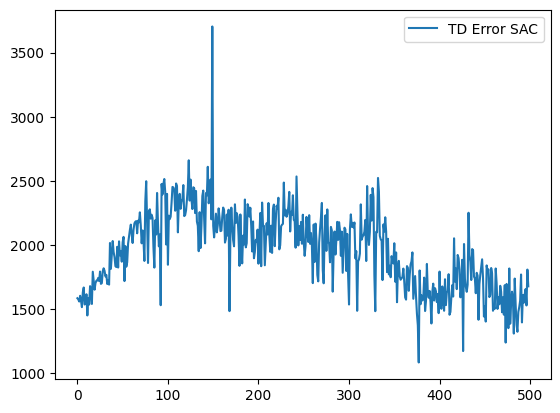

In [ ]:
import matplotlib.pyplot as plt

plt.plot(range(499), logs_error_sac.iloc[:, 2], label = 'TD Error SAC')

# Add legend
plt.legend()

# Show the plot
plt.show()

In [ ]:
actor_loss = pd.read_csv('/content/d3rlpy_logs/DiscreteSAC_20230414175406/actor_loss.csv')
critic_loss = pd.read_csv('/content/d3rlpy_logs/DiscreteSAC_20230414175406/critic_loss.csv')

In [ ]:
! d3rlpy plot /content/d3rlpy_logs/DiscreteSAC_20230414175406/td_error.csv

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.9/dist-packages/d3rlpy/cli.py:11: DeprecationWarning: Please use `uniform_filter1d` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import uniform_filter1d
d3rlpy command line interface (Version 1.1.1)
/usr/local/lib/python3.9/dist-packages/jupyter_client/connect.py:28: DeprecationWarning: Jupyter is migrating its paths to use standard platformdirs
given by the platformdirs library.  To remove this warning and
see the appropriate new directories, set the environment variable
`JUPYTER_PLATFORM_DIRS=1` and then run `jupyter --paths`.
The use of platformdirs will be the default in `jupyter_core` v6
  from jupyter_core.paths import jupyter_data_dir, jupyter_runtime_dir, secure_write

FILE NAME  :  /content/d3rlpy_logs/DiscreteSAC_20230414175406/td_error.csv
EPOCH      :  500.0
TOTAL STEPS:  79500.0
MAX VALUE  :  3702.904482787753
MIN VALUE  :  1085.6854257515026
STD VALUE  :  304.64368209919695
Fig

## CQL

In [ ]:
from d3rlpy.algos import DiscreteCQL
from sklearn.model_selection import train_test_split
from d3rlpy.metrics.scorer import discounted_sum_of_advantage_scorer
from d3rlpy.metrics.scorer import td_error_scorer
from d3rlpy.metrics.scorer import average_value_estimation_scorer

# setup CQL algorithm
cql = DiscreteCQL(target_update_interval=3000, use_gpu=True)

# split train and test episodes
train_episodes, test_episodes = train_test_split(dataset, test_size=0.2)

# start training
result = cql.fit(train_episodes,
        eval_episodes=test_episodes,
        n_epochs=500,
        scorers={
            'advantage': discounted_sum_of_advantage_scorer, # smaller is better
            'td_error': td_error_scorer, # smaller is better
            'value_scale': average_value_estimation_scorer # smaller is better
        })

2023-04-14 18:40:06 [debug    ] RoundIterator is selected.
2023-04-14 18:40:06 [info     ] Directory is created at d3rlpy_logs/DiscreteCQL_20230414184006
2023-04-14 18:40:06 [debug    ] Building models...
2023-04-14 18:40:06 [debug    ] Models have been built.
2023-04-14 18:40:06 [info     ] Parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/params.json params={'action_scaler': None, 'alpha': 1.0, 'batch_size': 32, 'encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'gamma': 0.99, 'generated_maxlen': 100000, 'learning_rate': 6.25e-05, 'n_critics': 1, 'n_frames': 1, 'n_steps': 1, 'optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 1e-08, 'weight_decay': 0, 'amsgrad': False}, 'q_func_factory': {'type': 'mean', 'params': {'share_encoder': False}}, 'real_ratio': 1.0, 'reward_scaler': None, 'scaler': None, 'target_update_interval': 3000, 'use_gpu': 0, 'algorithm': 'DiscreteCQL', 'observation_sh

Epoch 1/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:07 [info     ] DiscreteCQL_20230414184006: epoch=1 step=159 epoch=1 metrics={'time_sample_batch': 0.0001031182846933041, 'time_algorithm_update': 0.0064031867860998, 'loss': 20.984937757815956, 'time_step': 0.0066201177033238445, 'advantage': -11.501458607631484, 'td_error': 1307.2018050609256, 'value_scale': 4.531522662109799} step=159
2023-04-14 18:40:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_159.pt


Epoch 2/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:08 [info     ] DiscreteCQL_20230414184006: epoch=2 step=318 epoch=2 metrics={'time_sample_batch': 8.607060654358295e-05, 'time_algorithm_update': 0.00507027398115434, 'loss': 18.11977883704803, 'time_step': 0.005224907173300689, 'advantage': -10.122128837326116, 'td_error': 1374.0436425427831, 'value_scale': 9.580714473270234} step=318
2023-04-14 18:40:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_318.pt


Epoch 3/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:09 [info     ] DiscreteCQL_20230414184006: epoch=3 step=477 epoch=3 metrics={'time_sample_batch': 8.050900585246536e-05, 'time_algorithm_update': 0.005122856524005626, 'loss': 16.308953201245963, 'time_step': 0.005283615124300591, 'advantage': -7.755564168015689, 'td_error': 1407.6500042802284, 'value_scale': 12.529072576855857} step=477
2023-04-14 18:40:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_477.pt


Epoch 4/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:10 [info     ] DiscreteCQL_20230414184006: epoch=4 step=636 epoch=4 metrics={'time_sample_batch': 8.273424592407994e-05, 'time_algorithm_update': 0.0051505850546015135, 'loss': 15.980872352168245, 'time_step': 0.005308163241020539, 'advantage': -6.346319041547696, 'td_error': 1407.5683629505809, 'value_scale': 12.916250954733954} step=636
2023-04-14 18:40:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_636.pt


Epoch 5/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:11 [info     ] DiscreteCQL_20230414184006: epoch=5 step=795 epoch=5 metrics={'time_sample_batch': 8.210596048607017e-05, 'time_algorithm_update': 0.00513116218758829, 'loss': 15.934128791281262, 'time_step': 0.005287231889160924, 'advantage': -5.6217281378144275, 'td_error': 1405.862378007197, 'value_scale': 13.039580203994872} step=795
2023-04-14 18:40:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_795.pt


Epoch 6/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:13 [info     ] DiscreteCQL_20230414184006: epoch=6 step=954 epoch=6 metrics={'time_sample_batch': 9.096193613496216e-05, 'time_algorithm_update': 0.005234986731091385, 'loss': 15.910444466572887, 'time_step': 0.005395829302709807, 'advantage': -5.988677464084633, 'td_error': 1408.1530509627084, 'value_scale': 13.24890319468483} step=954
2023-04-14 18:40:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_954.pt


Epoch 7/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:14 [info     ] DiscreteCQL_20230414184006: epoch=7 step=1113 epoch=7 metrics={'time_sample_batch': 0.00032767109900900404, 'time_algorithm_update': 0.008678712185073949, 'loss': 15.919091530565945, 'time_step': 0.009149339963805, 'advantage': -5.431722940511427, 'td_error': 1402.5352431531642, 'value_scale': 13.07165428116208} step=1113
2023-04-14 18:40:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1113.pt


Epoch 8/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:16 [info     ] DiscreteCQL_20230414184006: epoch=8 step=1272 epoch=8 metrics={'time_sample_batch': 0.00016698297464622642, 'time_algorithm_update': 0.006312287828457431, 'loss': 15.909447592009538, 'time_step': 0.0065739679636445435, 'advantage': -5.045138820687396, 'td_error': 1402.448528667356, 'value_scale': 13.217434156887116} step=1272
2023-04-14 18:40:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1272.pt


Epoch 9/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:17 [info     ] DiscreteCQL_20230414184006: epoch=9 step=1431 epoch=9 metrics={'time_sample_batch': 8.612908657241917e-05, 'time_algorithm_update': 0.00513114869219702, 'loss': 15.938751580580226, 'time_step': 0.005305624607973879, 'advantage': -5.435926041599479, 'td_error': 1401.7355009300413, 'value_scale': 13.177869536384703} step=1431
2023-04-14 18:40:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1431.pt


Epoch 10/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:18 [info     ] DiscreteCQL_20230414184006: epoch=10 step=1590 epoch=10 metrics={'time_sample_batch': 0.00010137438024364927, 'time_algorithm_update': 0.005244508479376259, 'loss': 15.913871579200217, 'time_step': 0.00541890192331758, 'advantage': -5.344279356433149, 'td_error': 1402.9506669423854, 'value_scale': 13.318736303420295} step=1590
2023-04-14 18:40:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1590.pt


Epoch 11/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:19 [info     ] DiscreteCQL_20230414184006: epoch=11 step=1749 epoch=11 metrics={'time_sample_batch': 8.954042158786606e-05, 'time_algorithm_update': 0.005128380637498772, 'loss': 15.872348305564257, 'time_step': 0.005282063154304553, 'advantage': -6.1769185437627545, 'td_error': 1407.6309593801586, 'value_scale': 13.57306132619343} step=1749
2023-04-14 18:40:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1749.pt


Epoch 12/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:20 [info     ] DiscreteCQL_20230414184006: epoch=12 step=1908 epoch=12 metrics={'time_sample_batch': 8.50959393963124e-05, 'time_algorithm_update': 0.005207021281404316, 'loss': 15.84620810754644, 'time_step': 0.005370417480948586, 'advantage': -4.95286703347915, 'td_error': 1401.6001227916877, 'value_scale': 13.447420779485551} step=1908
2023-04-14 18:40:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_1908.pt


Epoch 13/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:21 [info     ] DiscreteCQL_20230414184006: epoch=13 step=2067 epoch=13 metrics={'time_sample_batch': 9.118535983487495e-05, 'time_algorithm_update': 0.0052924261153119165, 'loss': 15.867282732477728, 'time_step': 0.00545390746878378, 'advantage': -5.945568455642559, 'td_error': 1403.3671902359272, 'value_scale': 13.4860610674298} step=2067
2023-04-14 18:40:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2067.pt


Epoch 14/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:23 [info     ] DiscreteCQL_20230414184006: epoch=14 step=2226 epoch=14 metrics={'time_sample_batch': 0.00018176192757468553, 'time_algorithm_update': 0.008191372613487003, 'loss': 15.843796706049698, 'time_step': 0.008496720835847675, 'advantage': -6.6662629716726265, 'td_error': 1408.4325854296071, 'value_scale': 13.765249053258744} step=2226
2023-04-14 18:40:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2226.pt


Epoch 15/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:25 [info     ] DiscreteCQL_20230414184006: epoch=15 step=2385 epoch=15 metrics={'time_sample_batch': 0.00012228473927239952, 'time_algorithm_update': 0.008141664588976206, 'loss': 15.814032923500493, 'time_step': 0.008381197287601495, 'advantage': -6.39816190785075, 'td_error': 1402.177954464447, 'value_scale': 13.457029791483803} step=2385
2023-04-14 18:40:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2385.pt


Epoch 16/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:26 [info     ] DiscreteCQL_20230414184006: epoch=16 step=2544 epoch=16 metrics={'time_sample_batch': 0.00011520565680737766, 'time_algorithm_update': 0.005353851138420825, 'loss': 15.853166568204292, 'time_step': 0.005561446243861936, 'advantage': -5.7370840094428095, 'td_error': 1399.4222987773976, 'value_scale': 13.365340973838927} step=2544
2023-04-14 18:40:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2544.pt


Epoch 17/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:27 [info     ] DiscreteCQL_20230414184006: epoch=17 step=2703 epoch=17 metrics={'time_sample_batch': 0.0002731572157182034, 'time_algorithm_update': 0.006191682515654174, 'loss': 15.84867437230716, 'time_step': 0.006585693959170168, 'advantage': -7.5300301077509, 'td_error': 1409.405406440629, 'value_scale': 13.736474087881664} step=2703
2023-04-14 18:40:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2703.pt


Epoch 18/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:28 [info     ] DiscreteCQL_20230414184006: epoch=18 step=2862 epoch=18 metrics={'time_sample_batch': 0.0001858750229361672, 'time_algorithm_update': 0.005983595578175671, 'loss': 15.838077266261262, 'time_step': 0.006283007327865505, 'advantage': -5.497524123983948, 'td_error': 1401.69607520295, 'value_scale': 13.510684226808094} step=2862
2023-04-14 18:40:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_2862.pt


Epoch 19/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:30 [info     ] DiscreteCQL_20230414184006: epoch=19 step=3021 epoch=19 metrics={'time_sample_batch': 8.171009567548644e-05, 'time_algorithm_update': 0.005280850068578181, 'loss': 16.670584699642735, 'time_step': 0.005437837456757168, 'advantage': -9.307500556754537, 'td_error': 1440.4102934695957, 'value_scale': 15.416724418458484} step=3021
2023-04-14 18:40:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3021.pt


Epoch 20/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:31 [info     ] DiscreteCQL_20230414184006: epoch=20 step=3180 epoch=20 metrics={'time_sample_batch': 7.84637043311161e-05, 'time_algorithm_update': 0.005220966519049878, 'loss': 19.66058864833424, 'time_step': 0.005371969450944624, 'advantage': -5.786886183143674, 'td_error': 1589.260807455615, 'value_scale': 25.611904173048714} step=3180
2023-04-14 18:40:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3180.pt


Epoch 21/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:32 [info     ] DiscreteCQL_20230414184006: epoch=21 step=3339 epoch=21 metrics={'time_sample_batch': 8.677686535337436e-05, 'time_algorithm_update': 0.005312460773396042, 'loss': 18.75049655842331, 'time_step': 0.005468446503645219, 'advantage': -6.71759664703842, 'td_error': 1590.7215460565355, 'value_scale': 25.986094338553293} step=3339
2023-04-14 18:40:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3339.pt


Epoch 22/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:33 [info     ] DiscreteCQL_20230414184006: epoch=22 step=3498 epoch=22 metrics={'time_sample_batch': 9.341659785816505e-05, 'time_algorithm_update': 0.005633505635291526, 'loss': 18.670789868576723, 'time_step': 0.005802634377149666, 'advantage': -5.5771494289398165, 'td_error': 1576.305097357991, 'value_scale': 25.714105867961095} step=3498
2023-04-14 18:40:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3498.pt


Epoch 23/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:34 [info     ] DiscreteCQL_20230414184006: epoch=23 step=3657 epoch=23 metrics={'time_sample_batch': 8.431920465433373e-05, 'time_algorithm_update': 0.005238889898144224, 'loss': 18.66297786640671, 'time_step': 0.0053994490665459785, 'advantage': -5.211001714921732, 'td_error': 1574.1878469051292, 'value_scale': 25.9756507540506} step=3657
2023-04-14 18:40:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3657.pt


Epoch 24/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:35 [info     ] DiscreteCQL_20230414184006: epoch=24 step=3816 epoch=24 metrics={'time_sample_batch': 8.350348322646423e-05, 'time_algorithm_update': 0.005153880929047207, 'loss': 18.71316068277419, 'time_step': 0.005309608747374336, 'advantage': -5.92600378813603, 'td_error': 1573.2470507267817, 'value_scale': 26.09368269632733} step=3816
2023-04-14 18:40:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3816.pt


Epoch 25/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:36 [info     ] DiscreteCQL_20230414184006: epoch=25 step=3975 epoch=25 metrics={'time_sample_batch': 8.333404109163105e-05, 'time_algorithm_update': 0.00518817571723986, 'loss': 18.676550925152856, 'time_step': 0.005348542951187998, 'advantage': -5.971822985024979, 'td_error': 1568.508209803567, 'value_scale': 26.04832981503199} step=3975
2023-04-14 18:40:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_3975.pt


Epoch 26/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:37 [info     ] DiscreteCQL_20230414184006: epoch=26 step=4134 epoch=26 metrics={'time_sample_batch': 8.145068426552059e-05, 'time_algorithm_update': 0.0053359982352586665, 'loss': 18.638889180789203, 'time_step': 0.005492685725853878, 'advantage': -5.408656269475268, 'td_error': 1565.311187983962, 'value_scale': 26.25195728937785} step=4134
2023-04-14 18:40:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4134.pt


Epoch 27/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:39 [info     ] DiscreteCQL_20230414184006: epoch=27 step=4293 epoch=27 metrics={'time_sample_batch': 0.00019101226854624238, 'time_algorithm_update': 0.006088783156197026, 'loss': 18.580947528095365, 'time_step': 0.00636231374440703, 'advantage': -6.30365944503862, 'td_error': 1568.4073559372505, 'value_scale': 26.586780920482816} step=4293
2023-04-14 18:40:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4293.pt


Epoch 28/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:40 [info     ] DiscreteCQL_20230414184006: epoch=28 step=4452 epoch=28 metrics={'time_sample_batch': 0.00026676639820794637, 'time_algorithm_update': 0.006624682144548908, 'loss': 18.609040320294458, 'time_step': 0.007053559681154647, 'advantage': -5.5536208118161685, 'td_error': 1552.9124248792034, 'value_scale': 26.14083194884043} step=4452
2023-04-14 18:40:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4452.pt


Epoch 29/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:41 [info     ] DiscreteCQL_20230414184006: epoch=29 step=4611 epoch=29 metrics={'time_sample_batch': 8.809941369782454e-05, 'time_algorithm_update': 0.005355035733876738, 'loss': 18.598079723382146, 'time_step': 0.00551844392932436, 'advantage': -5.8122967449102605, 'td_error': 1550.2788206880043, 'value_scale': 26.2384384321788} step=4611
2023-04-14 18:40:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4611.pt


Epoch 30/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:43 [info     ] DiscreteCQL_20230414184006: epoch=30 step=4770 epoch=30 metrics={'time_sample_batch': 7.835874017679466e-05, 'time_algorithm_update': 0.005166016284774685, 'loss': 18.545515378316242, 'time_step': 0.005313855297160598, 'advantage': -4.674565871755883, 'td_error': 1546.978981985885, 'value_scale': 26.3805939840892} step=4770
2023-04-14 18:40:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4770.pt


Epoch 31/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:44 [info     ] DiscreteCQL_20230414184006: epoch=31 step=4929 epoch=31 metrics={'time_sample_batch': 7.882508091956565e-05, 'time_algorithm_update': 0.006733889849680774, 'loss': 18.586822593736947, 'time_step': 0.0068728983777124174, 'advantage': -6.058385465023786, 'td_error': 1549.8032689080992, 'value_scale': 26.378667947981093} step=4929
2023-04-14 18:40:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_4929.pt


Epoch 32/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:45 [info     ] DiscreteCQL_20230414184006: epoch=32 step=5088 epoch=32 metrics={'time_sample_batch': 8.214494717196099e-05, 'time_algorithm_update': 0.005521403918476225, 'loss': 18.564661169951815, 'time_step': 0.005666851247631529, 'advantage': -6.539460677452804, 'td_error': 1551.9685816455262, 'value_scale': 26.40629930193462} step=5088
2023-04-14 18:40:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5088.pt


Epoch 33/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:46 [info     ] DiscreteCQL_20230414184006: epoch=33 step=5247 epoch=33 metrics={'time_sample_batch': 9.612767201549602e-05, 'time_algorithm_update': 0.005235360103583186, 'loss': 18.564802991519183, 'time_step': 0.005399585519946596, 'advantage': -4.777550421164588, 'td_error': 1546.5589954060458, 'value_scale': 26.352885974399626} step=5247
2023-04-14 18:40:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5247.pt


Epoch 34/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:48 [info     ] DiscreteCQL_20230414184006: epoch=34 step=5406 epoch=34 metrics={'time_sample_batch': 0.00011895137762873428, 'time_algorithm_update': 0.007000543786294805, 'loss': 18.521350146839453, 'time_step': 0.00728990596795232, 'advantage': -5.121268379547697, 'td_error': 1548.2477987241177, 'value_scale': 26.419655465322826} step=5406
2023-04-14 18:40:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5406.pt


Epoch 35/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:49 [info     ] DiscreteCQL_20230414184006: epoch=35 step=5565 epoch=35 metrics={'time_sample_batch': 8.269375975027024e-05, 'time_algorithm_update': 0.005152825289552317, 'loss': 18.5565561378527, 'time_step': 0.005304452008421316, 'advantage': -5.5157672417620915, 'td_error': 1547.7412998219804, 'value_scale': 26.35808812701513} step=5565
2023-04-14 18:40:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5565.pt


Epoch 36/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:50 [info     ] DiscreteCQL_20230414184006: epoch=36 step=5724 epoch=36 metrics={'time_sample_batch': 8.006965589223418e-05, 'time_algorithm_update': 0.0052316413735443695, 'loss': 18.5432307885128, 'time_step': 0.005383818404479597, 'advantage': -5.644827678228974, 'td_error': 1545.4225852519983, 'value_scale': 26.25133015011984} step=5724
2023-04-14 18:40:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5724.pt


Epoch 37/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:51 [info     ] DiscreteCQL_20230414184006: epoch=37 step=5883 epoch=37 metrics={'time_sample_batch': 0.0002470466325867851, 'time_algorithm_update': 0.006019320877842933, 'loss': 18.562983392919385, 'time_step': 0.006356803126305154, 'advantage': -5.283888634438437, 'td_error': 1545.285094593962, 'value_scale': 26.291379749964154} step=5883
2023-04-14 18:40:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_5883.pt


Epoch 38/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:53 [info     ] DiscreteCQL_20230414184006: epoch=38 step=6042 epoch=38 metrics={'time_sample_batch': 0.0002401444896961908, 'time_algorithm_update': 0.006580967573249865, 'loss': 19.66851162460615, 'time_step': 0.007004054087512898, 'advantage': -8.068273139202716, 'td_error': 1624.8285865517953, 'value_scale': 30.860286969987172} step=6042
2023-04-14 18:40:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6042.pt


Epoch 39/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:54 [info     ] DiscreteCQL_20230414184006: epoch=39 step=6201 epoch=39 metrics={'time_sample_batch': 9.729877208013954e-05, 'time_algorithm_update': 0.005175577019745449, 'loss': 21.03493616715917, 'time_step': 0.005336250149229038, 'advantage': -4.779496984952805, 'td_error': 1685.6640523159433, 'value_scale': 37.319945554884654} step=6201
2023-04-14 18:40:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6201.pt


Epoch 40/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:55 [info     ] DiscreteCQL_20230414184006: epoch=40 step=6360 epoch=40 metrics={'time_sample_batch': 7.565216448322032e-05, 'time_algorithm_update': 0.0051509194404074235, 'loss': 20.617983548146373, 'time_step': 0.005286483644689404, 'advantage': -4.429069600156474, 'td_error': 1659.9421360017052, 'value_scale': 37.636781070345926} step=6360
2023-04-14 18:40:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6360.pt


Epoch 41/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:56 [info     ] DiscreteCQL_20230414184006: epoch=41 step=6519 epoch=41 metrics={'time_sample_batch': 8.196800759753341e-05, 'time_algorithm_update': 0.005192206340765803, 'loss': 20.572598751236058, 'time_step': 0.00536403865934168, 'advantage': -6.021948771930007, 'td_error': 1641.5619522795048, 'value_scale': 37.31982083093553} step=6519
2023-04-14 18:40:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6519.pt


Epoch 42/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:57 [info     ] DiscreteCQL_20230414184006: epoch=42 step=6678 epoch=42 metrics={'time_sample_batch': 8.347949141976219e-05, 'time_algorithm_update': 0.00517033780895689, 'loss': 20.522196421833158, 'time_step': 0.0053151328608674825, 'advantage': -4.897002182616431, 'td_error': 1629.1439832542032, 'value_scale': 37.33055052378821} step=6678
2023-04-14 18:40:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6678.pt


Epoch 43/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:40:58 [info     ] DiscreteCQL_20230414184006: epoch=43 step=6837 epoch=43 metrics={'time_sample_batch': 7.973527008632443e-05, 'time_algorithm_update': 0.005209207534790039, 'loss': 20.47844617471755, 'time_step': 0.005357746808034069, 'advantage': -6.351042466878948, 'td_error': 1632.870026453484, 'value_scale': 37.677397908104794} step=6837
2023-04-14 18:40:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6837.pt


Epoch 44/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:00 [info     ] DiscreteCQL_20230414184006: epoch=44 step=6996 epoch=44 metrics={'time_sample_batch': 8.033806422971329e-05, 'time_algorithm_update': 0.0052872213927454914, 'loss': 20.524671746499884, 'time_step': 0.005441968545973676, 'advantage': -6.433898932373956, 'td_error': 1635.3398887081573, 'value_scale': 37.95086195960877} step=6996
2023-04-14 18:41:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_6996.pt


Epoch 45/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:01 [info     ] DiscreteCQL_20230414184006: epoch=45 step=7155 epoch=45 metrics={'time_sample_batch': 9.17956514178582e-05, 'time_algorithm_update': 0.005288672897050965, 'loss': 20.489540849841617, 'time_step': 0.005464987185016368, 'advantage': -5.625650514850688, 'td_error': 1628.5058533305169, 'value_scale': 37.76541797395736} step=7155
2023-04-14 18:41:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7155.pt


Epoch 46/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:02 [info     ] DiscreteCQL_20230414184006: epoch=46 step=7314 epoch=46 metrics={'time_sample_batch': 8.512892813052772e-05, 'time_algorithm_update': 0.005408912334802016, 'loss': 20.517470611716217, 'time_step': 0.005575319506087393, 'advantage': -4.391658662098315, 'td_error': 1624.0936637261084, 'value_scale': 37.66858374126374} step=7314
2023-04-14 18:41:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7314.pt


Epoch 47/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:03 [info     ] DiscreteCQL_20230414184006: epoch=47 step=7473 epoch=47 metrics={'time_sample_batch': 8.390234701288571e-05, 'time_algorithm_update': 0.005513783520872488, 'loss': 20.506876255731164, 'time_step': 0.005674207735361543, 'advantage': -5.816668892954742, 'td_error': 1632.7118446864897, 'value_scale': 37.98478559312366} step=7473
2023-04-14 18:41:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7473.pt


Epoch 48/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:04 [info     ] DiscreteCQL_20230414184006: epoch=48 step=7632 epoch=48 metrics={'time_sample_batch': 0.00017255357226485726, 'time_algorithm_update': 0.006325070962965864, 'loss': 20.45957460343463, 'time_step': 0.006633646083327959, 'advantage': -5.698036519616186, 'td_error': 1630.2402078372972, 'value_scale': 37.828049205598376} step=7632
2023-04-14 18:41:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7632.pt


Epoch 49/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:06 [info     ] DiscreteCQL_20230414184006: epoch=49 step=7791 epoch=49 metrics={'time_sample_batch': 0.00020858476746757074, 'time_algorithm_update': 0.006577088398003728, 'loss': 20.455213210867637, 'time_step': 0.006933347234186137, 'advantage': -4.571084774176697, 'td_error': 1628.0650701691234, 'value_scale': 37.78990366496737} step=7791
2023-04-14 18:41:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7791.pt


Epoch 50/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:07 [info     ] DiscreteCQL_20230414184006: epoch=50 step=7950 epoch=50 metrics={'time_sample_batch': 8.839931128160008e-05, 'time_algorithm_update': 0.005329377996096821, 'loss': 20.488134744032372, 'time_step': 0.005487302564225107, 'advantage': -5.8971201842221594, 'td_error': 1631.0738316172763, 'value_scale': 37.77653419252426} step=7950
2023-04-14 18:41:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_7950.pt


Epoch 51/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:08 [info     ] DiscreteCQL_20230414184006: epoch=51 step=8109 epoch=51 metrics={'time_sample_batch': 8.320358564268868e-05, 'time_algorithm_update': 0.005381264776553748, 'loss': 20.48156290834055, 'time_step': 0.005536580235703186, 'advantage': -4.080867813396558, 'td_error': 1626.2278704038215, 'value_scale': 37.77102609816052} step=8109
2023-04-14 18:41:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8109.pt


Epoch 52/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:09 [info     ] DiscreteCQL_20230414184006: epoch=52 step=8268 epoch=52 metrics={'time_sample_batch': 8.265027460062279e-05, 'time_algorithm_update': 0.005292546074345427, 'loss': 20.477495307442528, 'time_step': 0.005445240428612667, 'advantage': -4.416757637917936, 'td_error': 1628.03912635105, 'value_scale': 37.72090804084899} step=8268
2023-04-14 18:41:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8268.pt


Epoch 53/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:10 [info     ] DiscreteCQL_20230414184006: epoch=53 step=8427 epoch=53 metrics={'time_sample_batch': 9.259787745445779e-05, 'time_algorithm_update': 0.005320276104429233, 'loss': 20.46828620838669, 'time_step': 0.005485852559407552, 'advantage': -5.6148974488685734, 'td_error': 1629.5194049475094, 'value_scale': 37.69020330338251} step=8427
2023-04-14 18:41:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8427.pt


Epoch 54/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:11 [info     ] DiscreteCQL_20230414184006: epoch=54 step=8586 epoch=54 metrics={'time_sample_batch': 9.420532850349475e-05, 'time_algorithm_update': 0.0054252972392915925, 'loss': 20.482506602065367, 'time_step': 0.005600525898003728, 'advantage': -6.019640113115922, 'td_error': 1633.485423980158, 'value_scale': 37.954973355550614} step=8586
2023-04-14 18:41:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8586.pt


Epoch 55/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:13 [info     ] DiscreteCQL_20230414184006: epoch=55 step=8745 epoch=55 metrics={'time_sample_batch': 9.336711475684208e-05, 'time_algorithm_update': 0.005366803715064091, 'loss': 20.51359952770689, 'time_step': 0.005541554037130104, 'advantage': -5.503510052948824, 'td_error': 1627.074961707883, 'value_scale': 37.69711867892553} step=8745
2023-04-14 18:41:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8745.pt


Epoch 56/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:14 [info     ] DiscreteCQL_20230414184006: epoch=56 step=8904 epoch=56 metrics={'time_sample_batch': 8.787449050999287e-05, 'time_algorithm_update': 0.005296942572923576, 'loss': 20.495823902154118, 'time_step': 0.005460367262738306, 'advantage': -4.900244168477831, 'td_error': 1630.2865589065448, 'value_scale': 37.982009253426206} step=8904
2023-04-14 18:41:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_8904.pt


Epoch 57/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:15 [info     ] DiscreteCQL_20230414184006: epoch=57 step=9063 epoch=57 metrics={'time_sample_batch': 8.587567311412883e-05, 'time_algorithm_update': 0.005322148964839912, 'loss': 21.608211403372902, 'time_step': 0.0054865243299952095, 'advantage': -7.978149972378987, 'td_error': 1739.9906674878937, 'value_scale': 45.27739312610929} step=9063
2023-04-14 18:41:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9063.pt


Epoch 58/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:16 [info     ] DiscreteCQL_20230414184006: epoch=58 step=9222 epoch=58 metrics={'time_sample_batch': 0.00010949110834853454, 'time_algorithm_update': 0.005735710731842233, 'loss': 21.607988021658652, 'time_step': 0.005916277567545573, 'advantage': -6.067188647765625, 'td_error': 1724.4901251431495, 'value_scale': 48.15302882118831} step=9222
2023-04-14 18:41:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9222.pt


Epoch 59/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:18 [info     ] DiscreteCQL_20230414184006: epoch=59 step=9381 epoch=59 metrics={'time_sample_batch': 0.00022536253779189392, 'time_algorithm_update': 0.006900640403699575, 'loss': 21.416757937497312, 'time_step': 0.007314388107203838, 'advantage': -5.022532834279115, 'td_error': 1677.475332815212, 'value_scale': 48.11906539674789} step=9381
2023-04-14 18:41:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9381.pt


Epoch 60/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:19 [info     ] DiscreteCQL_20230414184006: epoch=60 step=9540 epoch=60 metrics={'time_sample_batch': 0.00017588993288436027, 'time_algorithm_update': 0.006412973943746315, 'loss': 21.32310336490847, 'time_step': 0.006705789446081006, 'advantage': -6.561303186304562, 'td_error': 1666.0685885432222, 'value_scale': 48.437590935116724} step=9540
2023-04-14 18:41:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9540.pt


Epoch 61/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:21 [info     ] DiscreteCQL_20230414184006: epoch=61 step=9699 epoch=61 metrics={'time_sample_batch': 0.0004115374583118367, 'time_algorithm_update': 0.006434358140957431, 'loss': 21.314886285074103, 'time_step': 0.006945289155972079, 'advantage': -5.67415539614392, 'td_error': 1655.5419899796061, 'value_scale': 48.21595156230624} step=9699
2023-04-14 18:41:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9699.pt


Epoch 62/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:22 [info     ] DiscreteCQL_20230414184006: epoch=62 step=9858 epoch=62 metrics={'time_sample_batch': 8.817888655752506e-05, 'time_algorithm_update': 0.005629720927784278, 'loss': 21.270693041243643, 'time_step': 0.005798279864233245, 'advantage': -5.207770064351686, 'td_error': 1647.4749888850583, 'value_scale': 47.78079752543616} step=9858
2023-04-14 18:41:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_9858.pt


Epoch 63/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:23 [info     ] DiscreteCQL_20230414184006: epoch=63 step=10017 epoch=63 metrics={'time_sample_batch': 9.369400312315743e-05, 'time_algorithm_update': 0.005432527770036421, 'loss': 21.31172304333381, 'time_step': 0.005637309836141718, 'advantage': -5.4589674500426435, 'td_error': 1653.4004182530468, 'value_scale': 48.2235049232604} step=10017
2023-04-14 18:41:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10017.pt


Epoch 64/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:24 [info     ] DiscreteCQL_20230414184006: epoch=64 step=10176 epoch=64 metrics={'time_sample_batch': 8.311961431923153e-05, 'time_algorithm_update': 0.0054282722233226464, 'loss': 21.325981332071173, 'time_step': 0.005590459835604302, 'advantage': -4.634601535372343, 'td_error': 1649.71848501718, 'value_scale': 47.997960390363424} step=10176
2023-04-14 18:41:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10176.pt


Epoch 65/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:25 [info     ] DiscreteCQL_20230414184006: epoch=65 step=10335 epoch=65 metrics={'time_sample_batch': 8.389784854912907e-05, 'time_algorithm_update': 0.005307512463263745, 'loss': 21.340524925375885, 'time_step': 0.005463739611067862, 'advantage': -5.243823537121012, 'td_error': 1656.6997834384354, 'value_scale': 48.301775111849345} step=10335
2023-04-14 18:41:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10335.pt


Epoch 66/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:26 [info     ] DiscreteCQL_20230414184006: epoch=66 step=10494 epoch=66 metrics={'time_sample_batch': 9.890322415333874e-05, 'time_algorithm_update': 0.005275619854717134, 'loss': 21.328232939138353, 'time_step': 0.005441191811231697, 'advantage': -5.398349442917438, 'td_error': 1653.000480569056, 'value_scale': 48.06115243699816} step=10494
2023-04-14 18:41:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10494.pt


Epoch 67/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:27 [info     ] DiscreteCQL_20230414184006: epoch=67 step=10653 epoch=67 metrics={'time_sample_batch': 8.780401457780563e-05, 'time_algorithm_update': 0.005273255162269065, 'loss': 21.3349790093284, 'time_step': 0.005429059454480057, 'advantage': -6.14772687394316, 'td_error': 1656.4977009592017, 'value_scale': 48.27023843129476} step=10653
2023-04-14 18:41:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10653.pt


Epoch 68/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:29 [info     ] DiscreteCQL_20230414184006: epoch=68 step=10812 epoch=68 metrics={'time_sample_batch': 0.00011705302592343505, 'time_algorithm_update': 0.0057659644000935106, 'loss': 21.28969572175224, 'time_step': 0.005983345163693218, 'advantage': -5.425747915038558, 'td_error': 1650.295099634358, 'value_scale': 48.01628143673852} step=10812
2023-04-14 18:41:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10812.pt


Epoch 69/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:30 [info     ] DiscreteCQL_20230414184006: epoch=69 step=10971 epoch=69 metrics={'time_sample_batch': 0.00011325332353699882, 'time_algorithm_update': 0.006227932636093044, 'loss': 21.335590590470993, 'time_step': 0.006497441597704617, 'advantage': -5.254878408526598, 'td_error': 1654.9872743954734, 'value_scale': 48.33901943025135} step=10971
2023-04-14 18:41:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_10971.pt


Epoch 70/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:31 [info     ] DiscreteCQL_20230414184006: epoch=70 step=11130 epoch=70 metrics={'time_sample_batch': 0.00015859933769178091, 'time_algorithm_update': 0.006077244596661262, 'loss': 21.33205870262482, 'time_step': 0.006320804919836656, 'advantage': -5.046753112121637, 'td_error': 1656.1104880241767, 'value_scale': 48.43475317576575} step=11130
2023-04-14 18:41:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11130.pt


Epoch 71/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:33 [info     ] DiscreteCQL_20230414184006: epoch=71 step=11289 epoch=71 metrics={'time_sample_batch': 8.434319646103577e-05, 'time_algorithm_update': 0.005351424966968081, 'loss': 21.337025780347908, 'time_step': 0.0055149546209371314, 'advantage': -4.67347127145321, 'td_error': 1648.3727430899464, 'value_scale': 47.93671653687008} step=11289
2023-04-14 18:41:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11289.pt


Epoch 72/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:34 [info     ] DiscreteCQL_20230414184006: epoch=72 step=11448 epoch=72 metrics={'time_sample_batch': 8.841730513662662e-05, 'time_algorithm_update': 0.005755240062497697, 'loss': 21.31220470284516, 'time_step': 0.005931263449806838, 'advantage': -4.1689239997201275, 'td_error': 1650.610113014541, 'value_scale': 48.192016752939374} step=11448
2023-04-14 18:41:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11448.pt


Epoch 73/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:35 [info     ] DiscreteCQL_20230414184006: epoch=73 step=11607 epoch=73 metrics={'time_sample_batch': 8.22589082537957e-05, 'time_algorithm_update': 0.005709813075995295, 'loss': 21.314386355801947, 'time_step': 0.005864485254827535, 'advantage': -5.362461563252586, 'td_error': 1653.1658351186131, 'value_scale': 48.129154704865954} step=11607
2023-04-14 18:41:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11607.pt


Epoch 74/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:36 [info     ] DiscreteCQL_20230414184006: epoch=74 step=11766 epoch=74 metrics={'time_sample_batch': 8.840680872119448e-05, 'time_algorithm_update': 0.005595072260442769, 'loss': 21.270026746785867, 'time_step': 0.005763178351540236, 'advantage': -5.634147721845456, 'td_error': 1652.2898031463196, 'value_scale': 48.06301583789644} step=11766
2023-04-14 18:41:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11766.pt


Epoch 75/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:37 [info     ] DiscreteCQL_20230414184006: epoch=75 step=11925 epoch=75 metrics={'time_sample_batch': 8.691181926607335e-05, 'time_algorithm_update': 0.005502354423954802, 'loss': 21.321046379377258, 'time_step': 0.005670178611323518, 'advantage': -5.4997658392296325, 'td_error': 1658.4695403480105, 'value_scale': 48.51038445669507} step=11925
2023-04-14 18:41:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_11925.pt


Epoch 76/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:39 [info     ] DiscreteCQL_20230414184006: epoch=76 step=12084 epoch=76 metrics={'time_sample_batch': 0.00012580253793008673, 'time_algorithm_update': 0.005609803229757825, 'loss': 22.25096585615626, 'time_step': 0.005806497058028695, 'advantage': -7.354212318288205, 'td_error': 1789.273439551677, 'value_scale': 58.88115199255565} step=12084
2023-04-14 18:41:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12084.pt


Epoch 77/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:40 [info     ] DiscreteCQL_20230414184006: epoch=77 step=12243 epoch=77 metrics={'time_sample_batch': 0.00010746979863388733, 'time_algorithm_update': 0.005446678437526871, 'loss': 21.709234861457873, 'time_step': 0.005621566712481421, 'advantage': -6.077411130706601, 'td_error': 1710.2466311914934, 'value_scale': 58.683198247637065} step=12243
2023-04-14 18:41:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12243.pt


Epoch 78/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:41 [info     ] DiscreteCQL_20230414184006: epoch=78 step=12402 epoch=78 metrics={'time_sample_batch': 9.953750754302403e-05, 'time_algorithm_update': 0.005465762420270428, 'loss': 21.502242580149908, 'time_step': 0.005650232423026607, 'advantage': -5.373291733420416, 'td_error': 1656.4123044230162, 'value_scale': 58.21307155669682} step=12402
2023-04-14 18:41:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12402.pt


Epoch 79/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:42 [info     ] DiscreteCQL_20230414184006: epoch=79 step=12561 epoch=79 metrics={'time_sample_batch': 0.00026377641929770416, 'time_algorithm_update': 0.006689993840343547, 'loss': 21.463062412333937, 'time_step': 0.007110232827048631, 'advantage': -6.09830977312757, 'td_error': 1648.844388658565, 'value_scale': 58.51744116828555} step=12561
2023-04-14 18:41:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12561.pt


Epoch 80/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:44 [info     ] DiscreteCQL_20230414184006: epoch=80 step=12720 epoch=80 metrics={'time_sample_batch': 0.00025163056715479435, 'time_algorithm_update': 0.006683166671848897, 'loss': 21.462377620193195, 'time_step': 0.00703989934621367, 'advantage': -5.318806288722629, 'td_error': 1644.2453157768837, 'value_scale': 58.47041615682935} step=12720
2023-04-14 18:41:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12720.pt


Epoch 81/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:45 [info     ] DiscreteCQL_20230414184006: epoch=81 step=12879 epoch=81 metrics={'time_sample_batch': 9.187062581380208e-05, 'time_algorithm_update': 0.005404266921229333, 'loss': 21.46302536298644, 'time_step': 0.005583296781815823, 'advantage': -5.331386167959121, 'td_error': 1642.231773369984, 'value_scale': 58.31918642558749} step=12879
2023-04-14 18:41:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_12879.pt


Epoch 82/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:46 [info     ] DiscreteCQL_20230414184006: epoch=82 step=13038 epoch=82 metrics={'time_sample_batch': 9.180014988161483e-05, 'time_algorithm_update': 0.005489979150160303, 'loss': 21.42352219347684, 'time_step': 0.005659610220471268, 'advantage': -5.187100563384841, 'td_error': 1642.540447645599, 'value_scale': 58.372560852292985} step=13038
2023-04-14 18:41:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13038.pt


Epoch 83/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:47 [info     ] DiscreteCQL_20230414184006: epoch=83 step=13197 epoch=83 metrics={'time_sample_batch': 9.502554839512088e-05, 'time_algorithm_update': 0.005365809554573875, 'loss': 21.43069195897324, 'time_step': 0.005535094243175579, 'advantage': -6.100983078946099, 'td_error': 1644.9032502790765, 'value_scale': 58.3713693830702} step=13197
2023-04-14 18:41:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13197.pt


Epoch 84/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:48 [info     ] DiscreteCQL_20230414184006: epoch=84 step=13356 epoch=84 metrics={'time_sample_batch': 0.00010214211805811469, 'time_algorithm_update': 0.005411605415104321, 'loss': 21.41222883020557, 'time_step': 0.0055796920128588405, 'advantage': -4.416215182678069, 'td_error': 1638.1938003770888, 'value_scale': 58.17795357779851} step=13356
2023-04-14 18:41:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13356.pt


Epoch 85/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:50 [info     ] DiscreteCQL_20230414184006: epoch=85 step=13515 epoch=85 metrics={'time_sample_batch': 8.440317597779088e-05, 'time_algorithm_update': 0.0053594757176045355, 'loss': 21.458339835112948, 'time_step': 0.005514933628106267, 'advantage': -5.138884384942064, 'td_error': 1639.913244493613, 'value_scale': 58.11603950318836} step=13515
2023-04-14 18:41:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13515.pt


Epoch 86/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:51 [info     ] DiscreteCQL_20230414184006: epoch=86 step=13674 epoch=86 metrics={'time_sample_batch': 8.756859497454182e-05, 'time_algorithm_update': 0.005385160446166992, 'loss': 21.390214308252876, 'time_step': 0.005544106165568034, 'advantage': -4.8699769714487955, 'td_error': 1644.4525865455942, 'value_scale': 58.52417873200916} step=13674
2023-04-14 18:41:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13674.pt


Epoch 87/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:52 [info     ] DiscreteCQL_20230414184006: epoch=87 step=13833 epoch=87 metrics={'time_sample_batch': 9.951801420007862e-05, 'time_algorithm_update': 0.005440125675321375, 'loss': 21.41412188571954, 'time_step': 0.00560971625945853, 'advantage': -5.139214339923783, 'td_error': 1642.0037201394045, 'value_scale': 58.369893491835825} step=13833
2023-04-14 18:41:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13833.pt


Epoch 88/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:53 [info     ] DiscreteCQL_20230414184006: epoch=88 step=13992 epoch=88 metrics={'time_sample_batch': 0.00011607835877616451, 'time_algorithm_update': 0.005446302066059233, 'loss': 21.45746153705525, 'time_step': 0.005634271873618072, 'advantage': -3.756915478205718, 'td_error': 1637.169245495718, 'value_scale': 58.15727779448979} step=13992
2023-04-14 18:41:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_13992.pt


Epoch 89/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:54 [info     ] DiscreteCQL_20230414184006: epoch=89 step=14151 epoch=89 metrics={'time_sample_batch': 0.0001366063483856009, 'time_algorithm_update': 0.005651787391998483, 'loss': 21.45098207581718, 'time_step': 0.005866223161325515, 'advantage': -5.068796783298483, 'td_error': 1639.0357597132524, 'value_scale': 58.02578371441553} step=14151
2023-04-14 18:41:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14151.pt


Epoch 90/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:56 [info     ] DiscreteCQL_20230414184006: epoch=90 step=14310 epoch=90 metrics={'time_sample_batch': 0.00024754596206377137, 'time_algorithm_update': 0.006654623919313059, 'loss': 21.456821669572555, 'time_step': 0.007028210837886018, 'advantage': -4.430665719400065, 'td_error': 1636.802605498452, 'value_scale': 58.08970352354504} step=14310
2023-04-14 18:41:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14310.pt


Epoch 91/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:57 [info     ] DiscreteCQL_20230414184006: epoch=91 step=14469 epoch=91 metrics={'time_sample_batch': 0.00015373199990710373, 'time_algorithm_update': 0.0061927831397866305, 'loss': 21.47660503147533, 'time_step': 0.0064441797868260795, 'advantage': -5.191535776619724, 'td_error': 1645.280244975951, 'value_scale': 58.4718006436787} step=14469
2023-04-14 18:41:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14469.pt


Epoch 92/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:58 [info     ] DiscreteCQL_20230414184006: epoch=92 step=14628 epoch=92 metrics={'time_sample_batch': 8.113429231463738e-05, 'time_algorithm_update': 0.005395848796052753, 'loss': 21.377203653443534, 'time_step': 0.0055519274945529, 'advantage': -3.4553901305361525, 'td_error': 1641.5606377132829, 'value_scale': 58.4728545325143} step=14628
2023-04-14 18:41:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14628.pt


Epoch 93/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:41:59 [info     ] DiscreteCQL_20230414184006: epoch=93 step=14787 epoch=93 metrics={'time_sample_batch': 8.191552552037269e-05, 'time_algorithm_update': 0.0054248503918917675, 'loss': 21.469143819509064, 'time_step': 0.0055836386650613265, 'advantage': -4.891905347341307, 'td_error': 1644.6555509660393, 'value_scale': 58.570999206058566} step=14787
2023-04-14 18:41:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14787.pt


Epoch 94/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:00 [info     ] DiscreteCQL_20230414184006: epoch=94 step=14946 epoch=94 metrics={'time_sample_batch': 0.00010248400130361881, 'time_algorithm_update': 0.0053134729277412845, 'loss': 21.417976061503094, 'time_step': 0.005497926436130356, 'advantage': -4.71513041682288, 'td_error': 1645.610165845384, 'value_scale': 58.51606668139261} step=14946
2023-04-14 18:42:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_14946.pt


Epoch 95/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:02 [info     ] DiscreteCQL_20230414184006: epoch=95 step=15105 epoch=95 metrics={'time_sample_batch': 8.737216205716883e-05, 'time_algorithm_update': 0.005430474971075478, 'loss': 22.011920767010384, 'time_step': 0.005603024044876579, 'advantage': -3.3466475541353335, 'td_error': 1741.2009283378277, 'value_scale': 68.66835402231368} step=15105
2023-04-14 18:42:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15105.pt


Epoch 96/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:03 [info     ] DiscreteCQL_20230414184006: epoch=96 step=15264 epoch=96 metrics={'time_sample_batch': 9.885973900369129e-05, 'time_algorithm_update': 0.0054678287146226415, 'loss': 21.28324718295403, 'time_step': 0.005633066285331294, 'advantage': -6.3015004764364635, 'td_error': 1665.7480099304091, 'value_scale': 68.56171895890009} step=15264
2023-04-14 18:42:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15264.pt


Epoch 97/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:04 [info     ] DiscreteCQL_20230414184006: epoch=97 step=15423 epoch=97 metrics={'time_sample_batch': 9.2914269405341e-05, 'time_algorithm_update': 0.005581058046352939, 'loss': 21.145445937630516, 'time_step': 0.005741677194271448, 'advantage': -4.992507617329246, 'td_error': 1616.3749285814781, 'value_scale': 68.07107656569708} step=15423
2023-04-14 18:42:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15423.pt


Epoch 98/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:05 [info     ] DiscreteCQL_20230414184006: epoch=98 step=15582 epoch=98 metrics={'time_sample_batch': 9.337611168435535e-05, 'time_algorithm_update': 0.005673799874647608, 'loss': 21.086528604135573, 'time_step': 0.00583710160645299, 'advantage': -6.430826915539344, 'td_error': 1618.198676362279, 'value_scale': 68.68992640782916} step=15582
2023-04-14 18:42:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15582.pt


Epoch 99/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:06 [info     ] DiscreteCQL_20230414184006: epoch=99 step=15741 epoch=99 metrics={'time_sample_batch': 9.094844074369227e-05, 'time_algorithm_update': 0.005461413905305683, 'loss': 21.077862001814932, 'time_step': 0.005625504367756394, 'advantage': -4.688449866443217, 'td_error': 1605.0848516848826, 'value_scale': 67.82313607533773} step=15741
2023-04-14 18:42:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15741.pt


Epoch 100/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:08 [info     ] DiscreteCQL_20230414184006: epoch=100 step=15900 epoch=100 metrics={'time_sample_batch': 0.00011090512545603626, 'time_algorithm_update': 0.006826289794729941, 'loss': 21.090490881002175, 'time_step': 0.007070770803487526, 'advantage': -5.054655089873997, 'td_error': 1613.1758366379236, 'value_scale': 68.4918082312932} step=15900
2023-04-14 18:42:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_15900.pt


Epoch 101/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:09 [info     ] DiscreteCQL_20230414184006: epoch=101 step=16059 epoch=101 metrics={'time_sample_batch': 0.0003349181241209402, 'time_algorithm_update': 0.006480237972811333, 'loss': 21.0416571179276, 'time_step': 0.006934245427449544, 'advantage': -4.613746239218746, 'td_error': 1604.065859826595, 'value_scale': 67.80818282838851} step=16059
2023-04-14 18:42:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16059.pt


Epoch 102/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:10 [info     ] DiscreteCQL_20230414184006: epoch=102 step=16218 epoch=102 metrics={'time_sample_batch': 9.771712920950644e-05, 'time_algorithm_update': 0.005453810002069053, 'loss': 21.069139588553952, 'time_step': 0.005626951373598111, 'advantage': -4.578740756818343, 'td_error': 1611.0493219107625, 'value_scale': 68.40577289339096} step=16218
2023-04-14 18:42:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16218.pt


Epoch 103/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:12 [info     ] DiscreteCQL_20230414184006: epoch=103 step=16377 epoch=103 metrics={'time_sample_batch': 9.728227771303189e-05, 'time_algorithm_update': 0.005537046576445957, 'loss': 21.117092612404495, 'time_step': 0.005720705356238023, 'advantage': -5.419028924164815, 'td_error': 1612.248338154384, 'value_scale': 68.13584514799572} step=16377
2023-04-14 18:42:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16377.pt


Epoch 104/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:13 [info     ] DiscreteCQL_20230414184006: epoch=104 step=16536 epoch=104 metrics={'time_sample_batch': 9.610068123295623e-05, 'time_algorithm_update': 0.005438111863046323, 'loss': 21.113565175038463, 'time_step': 0.00563671903790168, 'advantage': -3.996999207989547, 'td_error': 1611.5774402698444, 'value_scale': 68.29504326108902} step=16536
2023-04-14 18:42:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16536.pt


Epoch 105/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:14 [info     ] DiscreteCQL_20230414184006: epoch=105 step=16695 epoch=105 metrics={'time_sample_batch': 8.403430194974696e-05, 'time_algorithm_update': 0.005697712208489952, 'loss': 21.06097028840263, 'time_step': 0.00587979202750344, 'advantage': -5.250430267754734, 'td_error': 1607.9146126988626, 'value_scale': 68.05593279278467} step=16695
2023-04-14 18:42:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16695.pt


Epoch 106/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:15 [info     ] DiscreteCQL_20230414184006: epoch=106 step=16854 epoch=106 metrics={'time_sample_batch': 9.98494010301506e-05, 'time_algorithm_update': 0.005620729998222687, 'loss': 21.10823850211857, 'time_step': 0.0057880023740372565, 'advantage': -5.256207102586405, 'td_error': 1611.912673917933, 'value_scale': 68.3760211702377} step=16854
2023-04-14 18:42:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_16854.pt


Epoch 107/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:16 [info     ] DiscreteCQL_20230414184006: epoch=107 step=17013 epoch=107 metrics={'time_sample_batch': 8.294117525688507e-05, 'time_algorithm_update': 0.005691045485202622, 'loss': 21.070878976545995, 'time_step': 0.00584342044854314, 'advantage': -6.345864837279501, 'td_error': 1614.3095525650751, 'value_scale': 68.31690967499264} step=17013
2023-04-14 18:42:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17013.pt


Epoch 108/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:18 [info     ] DiscreteCQL_20230414184006: epoch=108 step=17172 epoch=108 metrics={'time_sample_batch': 9.206405975533731e-05, 'time_algorithm_update': 0.0055919608230110985, 'loss': 21.123587218470544, 'time_step': 0.005758198552161643, 'advantage': -5.955046213370176, 'td_error': 1613.257114673879, 'value_scale': 68.24283223227849} step=17172
2023-04-14 18:42:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17172.pt


Epoch 109/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:19 [info     ] DiscreteCQL_20230414184006: epoch=109 step=17331 epoch=109 metrics={'time_sample_batch': 9.590874677933987e-05, 'time_algorithm_update': 0.005809431555885939, 'loss': 21.115065448689013, 'time_step': 0.005988720827882395, 'advantage': -6.2519993458061425, 'td_error': 1614.2416495861987, 'value_scale': 68.3247310335674} step=17331
2023-04-14 18:42:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17331.pt


Epoch 110/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:20 [info     ] DiscreteCQL_20230414184006: epoch=110 step=17490 epoch=110 metrics={'time_sample_batch': 0.00010704094508908829, 'time_algorithm_update': 0.0063098361657100656, 'loss': 21.12140332827778, 'time_step': 0.006533735203293135, 'advantage': -3.7443764078170845, 'td_error': 1604.1949903905984, 'value_scale': 67.85646774049789} step=17490
2023-04-14 18:42:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17490.pt


Epoch 111/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:22 [info     ] DiscreteCQL_20230414184006: epoch=111 step=17649 epoch=111 metrics={'time_sample_batch': 0.00017049777432807587, 'time_algorithm_update': 0.006530470818093738, 'loss': 21.079443691661524, 'time_step': 0.0068098554071390404, 'advantage': -4.758980580185805, 'td_error': 1608.5866257042403, 'value_scale': 68.16845146663606} step=17649
2023-04-14 18:42:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17649.pt


Epoch 112/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:23 [info     ] DiscreteCQL_20230414184006: epoch=112 step=17808 epoch=112 metrics={'time_sample_batch': 0.00014639050705627824, 'time_algorithm_update': 0.006723372441417766, 'loss': 21.101036107765054, 'time_step': 0.006980300699389956, 'advantage': -6.287765689801826, 'td_error': 1614.5987551934309, 'value_scale': 68.24459853399368} step=17808
2023-04-14 18:42:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17808.pt


Epoch 113/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:24 [info     ] DiscreteCQL_20230414184006: epoch=113 step=17967 epoch=113 metrics={'time_sample_batch': 0.00012642482541642098, 'time_algorithm_update': 0.005573536614951848, 'loss': 21.127791092830634, 'time_step': 0.005768849414849431, 'advantage': -4.06581016258126, 'td_error': 1607.086262418241, 'value_scale': 68.12751856607105} step=17967
2023-04-14 18:42:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_17967.pt


Epoch 114/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:25 [info     ] DiscreteCQL_20230414184006: epoch=114 step=18126 epoch=114 metrics={'time_sample_batch': 9.555936609424136e-05, 'time_algorithm_update': 0.005778366664670549, 'loss': 21.32530467915085, 'time_step': 0.005952409228438851, 'advantage': -4.954567154358695, 'td_error': 1683.231537313641, 'value_scale': 78.18409247019935} step=18126
2023-04-14 18:42:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18126.pt


Epoch 115/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:27 [info     ] DiscreteCQL_20230414184006: epoch=115 step=18285 epoch=115 metrics={'time_sample_batch': 9.450822506310805e-05, 'time_algorithm_update': 0.005575659889844978, 'loss': 20.531091114260114, 'time_step': 0.005749892888578979, 'advantage': -6.312809558254036, 'td_error': 1600.7646389404933, 'value_scale': 77.43583794851152} step=18285
2023-04-14 18:42:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18285.pt


Epoch 116/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:28 [info     ] DiscreteCQL_20230414184006: epoch=116 step=18444 epoch=116 metrics={'time_sample_batch': 9.253189998602718e-05, 'time_algorithm_update': 0.005578044075635994, 'loss': 20.423351251854086, 'time_step': 0.005752400032379343, 'advantage': -5.050717610030862, 'td_error': 1572.531449793776, 'value_scale': 77.34911426968044} step=18444
2023-04-14 18:42:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18444.pt


Epoch 117/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:29 [info     ] DiscreteCQL_20230414184006: epoch=117 step=18603 epoch=117 metrics={'time_sample_batch': 0.00011155290423699145, 'time_algorithm_update': 0.005724086701495093, 'loss': 20.394252153312635, 'time_step': 0.005911612660629944, 'advantage': -5.7359942878196915, 'td_error': 1572.7119380080983, 'value_scale': 77.56543294513037} step=18603
2023-04-14 18:42:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18603.pt


Epoch 118/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:30 [info     ] DiscreteCQL_20230414184006: epoch=118 step=18762 epoch=118 metrics={'time_sample_batch': 8.648746418503095e-05, 'time_algorithm_update': 0.005665069855983902, 'loss': 20.384652017797315, 'time_step': 0.005845917095928072, 'advantage': -5.628809456525937, 'td_error': 1572.7231603544856, 'value_scale': 77.7327000088162} step=18762
2023-04-14 18:42:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18762.pt


Epoch 119/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:31 [info     ] DiscreteCQL_20230414184006: epoch=119 step=18921 epoch=119 metrics={'time_sample_batch': 0.00010391001431447155, 'time_algorithm_update': 0.0057885871743256195, 'loss': 20.380141144278664, 'time_step': 0.005995912371941333, 'advantage': -3.5111975944948557, 'td_error': 1569.5047971636884, 'value_scale': 77.64688284132215} step=18921
2023-04-14 18:42:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_18921.pt


Epoch 120/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:33 [info     ] DiscreteCQL_20230414184006: epoch=120 step=19080 epoch=120 metrics={'time_sample_batch': 0.00012054983175025796, 'time_algorithm_update': 0.006411901809884317, 'loss': 20.40689905034671, 'time_step': 0.006614974459762093, 'advantage': -5.497115429763657, 'td_error': 1573.2096832922055, 'value_scale': 77.65129521687825} step=19080
2023-04-14 18:42:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19080.pt


Epoch 121/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:34 [info     ] DiscreteCQL_20230414184006: epoch=121 step=19239 epoch=121 metrics={'time_sample_batch': 0.00010701845277030513, 'time_algorithm_update': 0.006526623132093897, 'loss': 20.407249588636482, 'time_step': 0.006729896713352803, 'advantage': -5.583315176163565, 'td_error': 1577.2615093573572, 'value_scale': 77.87746474856422} step=19239
2023-04-14 18:42:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19239.pt


Epoch 122/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:36 [info     ] DiscreteCQL_20230414184006: epoch=122 step=19398 epoch=122 metrics={'time_sample_batch': 0.00012163396151560657, 'time_algorithm_update': 0.00676190178349333, 'loss': 20.44816955230521, 'time_step': 0.006997879196262959, 'advantage': -3.943379982732669, 'td_error': 1570.1317578392902, 'value_scale': 77.51292212955535} step=19398
2023-04-14 18:42:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19398.pt


Epoch 123/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:37 [info     ] DiscreteCQL_20230414184006: epoch=123 step=19557 epoch=123 metrics={'time_sample_batch': 0.00014801595196034173, 'time_algorithm_update': 0.006491755539516233, 'loss': 20.42973202279529, 'time_step': 0.00675832100634305, 'advantage': -5.401506244847506, 'td_error': 1574.2536557836074, 'value_scale': 77.69905712188236} step=19557
2023-04-14 18:42:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19557.pt


Epoch 124/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:39 [info     ] DiscreteCQL_20230414184006: epoch=124 step=19716 epoch=124 metrics={'time_sample_batch': 0.0001594765381243244, 'time_algorithm_update': 0.007111429418407896, 'loss': 20.44858417271068, 'time_step': 0.007426215417729983, 'advantage': -4.687368379306139, 'td_error': 1571.173644750181, 'value_scale': 77.70784881228492} step=19716
2023-04-14 18:42:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19716.pt


Epoch 125/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:40 [info     ] DiscreteCQL_20230414184006: epoch=125 step=19875 epoch=125 metrics={'time_sample_batch': 0.00010365360188034345, 'time_algorithm_update': 0.005648834900286213, 'loss': 20.395743454027475, 'time_step': 0.0058479773923286104, 'advantage': -5.4104875921390345, 'td_error': 1572.1147041331726, 'value_scale': 77.66191644214449} step=19875
2023-04-14 18:42:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_19875.pt


Epoch 126/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:41 [info     ] DiscreteCQL_20230414184006: epoch=126 step=20034 epoch=126 metrics={'time_sample_batch': 0.00011962464770431038, 'time_algorithm_update': 0.0062779240638205095, 'loss': 20.37218579706156, 'time_step': 0.006486489337945134, 'advantage': -4.4729840217493235, 'td_error': 1568.4951421936205, 'value_scale': 77.28437275962224} step=20034
2023-04-14 18:42:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20034.pt


Epoch 127/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:42 [info     ] DiscreteCQL_20230414184006: epoch=127 step=20193 epoch=127 metrics={'time_sample_batch': 0.00011488476639273781, 'time_algorithm_update': 0.005719304834521792, 'loss': 20.366957010713012, 'time_step': 0.00592145230035362, 'advantage': -4.185415917517761, 'td_error': 1565.2716909580554, 'value_scale': 77.40296187627884} step=20193
2023-04-14 18:42:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20193.pt


Epoch 128/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:44 [info     ] DiscreteCQL_20230414184006: epoch=128 step=20352 epoch=128 metrics={'time_sample_batch': 8.693281209693764e-05, 'time_algorithm_update': 0.005833196939912232, 'loss': 20.38537711617332, 'time_step': 0.005997744746178201, 'advantage': -6.044690647793838, 'td_error': 1577.084839225454, 'value_scale': 77.92623671274336} step=20352
2023-04-14 18:42:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20352.pt


Epoch 129/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:45 [info     ] DiscreteCQL_20230414184006: epoch=129 step=20511 epoch=129 metrics={'time_sample_batch': 8.94774430952732e-05, 'time_algorithm_update': 0.005787128172580551, 'loss': 20.386249218346936, 'time_step': 0.005948336619251179, 'advantage': -5.1733661725421864, 'td_error': 1570.5950029969392, 'value_scale': 77.44274024357871} step=20511
2023-04-14 18:42:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20511.pt


Epoch 130/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:46 [info     ] DiscreteCQL_20230414184006: epoch=130 step=20670 epoch=130 metrics={'time_sample_batch': 0.00011427597429767345, 'time_algorithm_update': 0.005831896883886565, 'loss': 20.325507415915435, 'time_step': 0.006043075765453794, 'advantage': -5.099421558187162, 'td_error': 1571.2502613905876, 'value_scale': 77.72800610860189} step=20670
2023-04-14 18:42:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20670.pt


Epoch 131/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:47 [info     ] DiscreteCQL_20230414184006: epoch=131 step=20829 epoch=131 metrics={'time_sample_batch': 9.814298377846772e-05, 'time_algorithm_update': 0.0056703165642120554, 'loss': 20.328053342471332, 'time_step': 0.005850169643666009, 'advantage': -5.106377036146463, 'td_error': 1573.5259917584085, 'value_scale': 77.7965618860154} step=20829
2023-04-14 18:42:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20829.pt


Epoch 132/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:49 [info     ] DiscreteCQL_20230414184006: epoch=132 step=20988 epoch=132 metrics={'time_sample_batch': 0.00011429546764061886, 'time_algorithm_update': 0.005811018014104111, 'loss': 20.42521704067974, 'time_step': 0.006001679402477336, 'advantage': -4.59292546138446, 'td_error': 1569.0405213258805, 'value_scale': 77.61170140826513} step=20988
2023-04-14 18:42:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_20988.pt


Epoch 133/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:50 [info     ] DiscreteCQL_20230414184006: epoch=133 step=21147 epoch=133 metrics={'time_sample_batch': 0.00022543451321200005, 'time_algorithm_update': 0.006555966611178416, 'loss': 20.52194565946951, 'time_step': 0.006881231032077622, 'advantage': -3.6651837072088957, 'td_error': 1609.1654201600995, 'value_scale': 86.41734247964526} step=21147
2023-04-14 18:42:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21147.pt


Epoch 134/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:52 [info     ] DiscreteCQL_20230414184006: epoch=134 step=21306 epoch=134 metrics={'time_sample_batch': 0.00041033486900089673, 'time_algorithm_update': 0.0070400238037109375, 'loss': 19.81109970020798, 'time_step': 0.007562683813227048, 'advantage': -4.902060566093552, 'td_error': 1553.8132333159476, 'value_scale': 86.81390145316956} step=21306
2023-04-14 18:42:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21306.pt


Epoch 135/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:53 [info     ] DiscreteCQL_20230414184006: epoch=135 step=21465 epoch=135 metrics={'time_sample_batch': 9.53404408580852e-05, 'time_algorithm_update': 0.00594049279794753, 'loss': 19.735457072467923, 'time_step': 0.006107690199366155, 'advantage': -4.8760605042259995, 'td_error': 1536.0164264810878, 'value_scale': 86.48304570515951} step=21465
2023-04-14 18:42:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21465.pt


Epoch 136/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:54 [info     ] DiscreteCQL_20230414184006: epoch=136 step=21624 epoch=136 metrics={'time_sample_batch': 9.967096196780415e-05, 'time_algorithm_update': 0.005841172716152743, 'loss': 19.785326735778426, 'time_step': 0.006032736796253132, 'advantage': -6.520708594823777, 'td_error': 1539.913329000014, 'value_scale': 86.58278058975462} step=21624
2023-04-14 18:42:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21624.pt


Epoch 137/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:55 [info     ] DiscreteCQL_20230414184006: epoch=137 step=21783 epoch=137 metrics={'time_sample_batch': 0.000110969603436548, 'time_algorithm_update': 0.005618702690556364, 'loss': 19.779467258813245, 'time_step': 0.005814714251824145, 'advantage': -5.192651432467044, 'td_error': 1532.74315012626, 'value_scale': 86.22958364335318} step=21783
2023-04-14 18:42:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21783.pt


Epoch 138/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:57 [info     ] DiscreteCQL_20230414184006: epoch=138 step=21942 epoch=138 metrics={'time_sample_batch': 9.459669485032184e-05, 'time_algorithm_update': 0.005922245529462707, 'loss': 19.686825683281857, 'time_step': 0.0061035231224395945, 'advantage': -4.685221011245489, 'td_error': 1535.0210564642805, 'value_scale': 86.43730006747775} step=21942
2023-04-14 18:42:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_21942.pt


Epoch 139/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:58 [info     ] DiscreteCQL_20230414184006: epoch=139 step=22101 epoch=139 metrics={'time_sample_batch': 0.00011508419828594856, 'time_algorithm_update': 0.005740365142342429, 'loss': 19.693889857837988, 'time_step': 0.005935746918684282, 'advantage': -6.130595161323955, 'td_error': 1538.2033643230322, 'value_scale': 86.64127015007867} step=22101
2023-04-14 18:42:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22101.pt


Epoch 140/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:42:59 [info     ] DiscreteCQL_20230414184006: epoch=140 step=22260 epoch=140 metrics={'time_sample_batch': 0.00010234904739091981, 'time_algorithm_update': 0.00581478772673217, 'loss': 19.78342714249713, 'time_step': 0.006012295776942991, 'advantage': -6.087536936009163, 'td_error': 1540.455201995692, 'value_scale': 86.59863372076126} step=22260
2023-04-14 18:42:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22260.pt


Epoch 141/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:00 [info     ] DiscreteCQL_20230414184006: epoch=141 step=22419 epoch=141 metrics={'time_sample_batch': 9.271933597588689e-05, 'time_algorithm_update': 0.005806293127671728, 'loss': 19.72677642894241, 'time_step': 0.006005356146854424, 'advantage': -6.090766369121056, 'td_error': 1538.1960286942592, 'value_scale': 86.52837116302005} step=22419
2023-04-14 18:43:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22419.pt


Epoch 142/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:01 [info     ] DiscreteCQL_20230414184006: epoch=142 step=22578 epoch=142 metrics={'time_sample_batch': 9.533444290640969e-05, 'time_algorithm_update': 0.005710657287693623, 'loss': 19.69756503674969, 'time_step': 0.005915325392717085, 'advantage': -5.473491254670019, 'td_error': 1539.6456690311313, 'value_scale': 86.76868134755937} step=22578
2023-04-14 18:43:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22578.pt


Epoch 143/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:03 [info     ] DiscreteCQL_20230414184006: epoch=143 step=22737 epoch=143 metrics={'time_sample_batch': 0.0001243555320883697, 'time_algorithm_update': 0.006720896786863699, 'loss': 19.727199989294856, 'time_step': 0.006989886925655341, 'advantage': -4.306235056000376, 'td_error': 1536.8136678419032, 'value_scale': 86.78604247078063} step=22737
2023-04-14 18:43:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22737.pt


Epoch 144/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:05 [info     ] DiscreteCQL_20230414184006: epoch=144 step=22896 epoch=144 metrics={'time_sample_batch': 0.00026903212445337067, 'time_algorithm_update': 0.00690589760834316, 'loss': 19.691303025251663, 'time_step': 0.0073112796687480035, 'advantage': -6.424541271916903, 'td_error': 1542.8398569000058, 'value_scale': 86.95423060220385} step=22896
2023-04-14 18:43:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_22896.pt


Epoch 145/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:06 [info     ] DiscreteCQL_20230414184006: epoch=145 step=23055 epoch=145 metrics={'time_sample_batch': 0.00012907442056907798, 'time_algorithm_update': 0.006253780808838658, 'loss': 19.73083234583057, 'time_step': 0.006478317128787251, 'advantage': -5.4468059466524466, 'td_error': 1536.0387680711756, 'value_scale': 86.47293971228221} step=23055
2023-04-14 18:43:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23055.pt


Epoch 146/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:07 [info     ] DiscreteCQL_20230414184006: epoch=146 step=23214 epoch=146 metrics={'time_sample_batch': 0.00010120793708465385, 'time_algorithm_update': 0.005911866074088235, 'loss': 19.72292870095691, 'time_step': 0.0061046132501566186, 'advantage': -5.50710892589585, 'td_error': 1535.6868759612123, 'value_scale': 86.31387674846347} step=23214
2023-04-14 18:43:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23214.pt


Epoch 147/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:08 [info     ] DiscreteCQL_20230414184006: epoch=147 step=23373 epoch=147 metrics={'time_sample_batch': 0.00010214211805811469, 'time_algorithm_update': 0.006004802835812359, 'loss': 19.711010764979715, 'time_step': 0.00619875560016752, 'advantage': -6.107643235493695, 'td_error': 1540.4492973697918, 'value_scale': 86.71197689601354} step=23373
2023-04-14 18:43:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23373.pt


Epoch 148/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:10 [info     ] DiscreteCQL_20230414184006: epoch=148 step=23532 epoch=148 metrics={'time_sample_batch': 9.996036313614755e-05, 'time_algorithm_update': 0.005942124240803269, 'loss': 19.744396059768004, 'time_step': 0.00612345131688148, 'advantage': -6.499909373561773, 'td_error': 1539.0503777573979, 'value_scale': 86.81204703194754} step=23532
2023-04-14 18:43:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23532.pt


Epoch 149/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:11 [info     ] DiscreteCQL_20230414184006: epoch=149 step=23691 epoch=149 metrics={'time_sample_batch': 0.00010373757320380061, 'time_algorithm_update': 0.005747982540970329, 'loss': 19.727151168967193, 'time_step': 0.005935084145024138, 'advantage': -5.297631637971645, 'td_error': 1536.591356646305, 'value_scale': 86.62409725491963} step=23691
2023-04-14 18:43:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23691.pt


Epoch 150/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:12 [info     ] DiscreteCQL_20230414184006: epoch=150 step=23850 epoch=150 metrics={'time_sample_batch': 9.506303559309281e-05, 'time_algorithm_update': 0.005910581012941756, 'loss': 19.75074194662226, 'time_step': 0.006100017319685258, 'advantage': -5.707439964361393, 'td_error': 1535.4345350925294, 'value_scale': 86.53175112406413} step=23850
2023-04-14 18:43:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_23850.pt


Epoch 151/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:13 [info     ] DiscreteCQL_20230414184006: epoch=151 step=24009 epoch=151 metrics={'time_sample_batch': 0.00011776528268490197, 'time_algorithm_update': 0.005894356553659499, 'loss': 19.913992323965395, 'time_step': 0.0061071608801307915, 'advantage': -6.934827045825576, 'td_error': 1554.3647465656675, 'value_scale': 87.85893824743846} step=24009
2023-04-14 18:43:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24009.pt


Epoch 152/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:15 [info     ] DiscreteCQL_20230414184006: epoch=152 step=24168 epoch=152 metrics={'time_sample_batch': 9.681893594609867e-05, 'time_algorithm_update': 0.005892264768012664, 'loss': 19.86471666180113, 'time_step': 0.00607569712512898, 'advantage': -5.98357681184151, 'td_error': 1573.2869607807625, 'value_scale': 96.25491085355245} step=24168
2023-04-14 18:43:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24168.pt


Epoch 153/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:16 [info     ] DiscreteCQL_20230414184006: epoch=153 step=24327 epoch=153 metrics={'time_sample_batch': 0.0003031109863857053, 'time_algorithm_update': 0.006994608813111887, 'loss': 19.377493342513556, 'time_step': 0.007416005404490345, 'advantage': -5.195089080039701, 'td_error': 1518.2251254411563, 'value_scale': 95.80135837736584} step=24327
2023-04-14 18:43:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24327.pt


Epoch 154/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:17 [info     ] DiscreteCQL_20230414184006: epoch=154 step=24486 epoch=154 metrics={'time_sample_batch': 0.00011322333377862126, 'time_algorithm_update': 0.006501518705356046, 'loss': 19.291063140773172, 'time_step': 0.006742003578809822, 'advantage': -4.523285819336465, 'td_error': 1509.9220319934986, 'value_scale': 95.80148544917031} step=24486
2023-04-14 18:43:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24486.pt


Epoch 155/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:19 [info     ] DiscreteCQL_20230414184006: epoch=155 step=24645 epoch=155 metrics={'time_sample_batch': 0.00013761700324292452, 'time_algorithm_update': 0.00640631321841066, 'loss': 19.2947248122977, 'time_step': 0.006635962792162625, 'advantage': -5.889516628256125, 'td_error': 1520.711312477511, 'value_scale': 96.26060312059191} step=24645
2023-04-14 18:43:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24645.pt


Epoch 156/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:20 [info     ] DiscreteCQL_20230414184006: epoch=156 step=24804 epoch=156 metrics={'time_sample_batch': 9.707834735606452e-05, 'time_algorithm_update': 0.005739032097582547, 'loss': 19.31980330989046, 'time_step': 0.005911543684185676, 'advantage': -5.313566775177517, 'td_error': 1513.4884934935187, 'value_scale': 96.02387075878325} step=24804
2023-04-14 18:43:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24804.pt


Epoch 157/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:21 [info     ] DiscreteCQL_20230414184006: epoch=157 step=24963 epoch=157 metrics={'time_sample_batch': 9.585176623842251e-05, 'time_algorithm_update': 0.005824871782986623, 'loss': 19.348628062122273, 'time_step': 0.006012619666333469, 'advantage': -5.7436069101958465, 'td_error': 1513.1576748241287, 'value_scale': 95.95086342947823} step=24963
2023-04-14 18:43:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_24963.pt


Epoch 158/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:22 [info     ] DiscreteCQL_20230414184006: epoch=158 step=25122 epoch=158 metrics={'time_sample_batch': 0.00010044469773394507, 'time_algorithm_update': 0.005706748122689109, 'loss': 19.317741807901633, 'time_step': 0.005898036297012425, 'advantage': -5.163464464228769, 'td_error': 1512.1568163177412, 'value_scale': 95.90002256726461} step=25122
2023-04-14 18:43:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25122.pt


Epoch 159/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:24 [info     ] DiscreteCQL_20230414184006: epoch=159 step=25281 epoch=159 metrics={'time_sample_batch': 8.691631772982999e-05, 'time_algorithm_update': 0.005750750595668577, 'loss': 19.313883565506845, 'time_step': 0.005935036161410733, 'advantage': -5.957088390066525, 'td_error': 1514.830573978884, 'value_scale': 96.15550503200954} step=25281
2023-04-14 18:43:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25281.pt


Epoch 160/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:25 [info     ] DiscreteCQL_20230414184006: epoch=160 step=25440 epoch=160 metrics={'time_sample_batch': 9.507503149644383e-05, 'time_algorithm_update': 0.005811577323097853, 'loss': 19.299173499053378, 'time_step': 0.005993516190246966, 'advantage': -5.645294818245723, 'td_error': 1509.5091445523121, 'value_scale': 95.68125972445048} step=25440
2023-04-14 18:43:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25440.pt


Epoch 161/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:26 [info     ] DiscreteCQL_20230414184006: epoch=161 step=25599 epoch=161 metrics={'time_sample_batch': 9.988238976436591e-05, 'time_algorithm_update': 0.005732162943426168, 'loss': 19.24668649157638, 'time_step': 0.0059196664102422365, 'advantage': -6.578192146698582, 'td_error': 1515.165330526552, 'value_scale': 95.99181895180354} step=25599
2023-04-14 18:43:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25599.pt


Epoch 162/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:27 [info     ] DiscreteCQL_20230414184006: epoch=162 step=25758 epoch=162 metrics={'time_sample_batch': 9.461618819326725e-05, 'time_algorithm_update': 0.00579621506936895, 'loss': 19.29859383301165, 'time_step': 0.00599896233036833, 'advantage': -7.075304575821226, 'td_error': 1508.0137602930859, 'value_scale': 95.3870212252178} step=25758
2023-04-14 18:43:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25758.pt


Epoch 163/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:29 [info     ] DiscreteCQL_20230414184006: epoch=163 step=25917 epoch=163 metrics={'time_sample_batch': 0.00010231455916878563, 'time_algorithm_update': 0.006239396221232864, 'loss': 19.289583122205435, 'time_step': 0.006443527509581368, 'advantage': -4.782713639108586, 'td_error': 1508.0532907312572, 'value_scale': 95.68998900519478} step=25917
2023-04-14 18:43:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_25917.pt


Epoch 164/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:30 [info     ] DiscreteCQL_20230414184006: epoch=164 step=26076 epoch=164 metrics={'time_sample_batch': 0.00010624621649208309, 'time_algorithm_update': 0.006395273988351882, 'loss': 19.308684690943306, 'time_step': 0.00659400112224075, 'advantage': -6.347034810671161, 'td_error': 1514.3542258467703, 'value_scale': 95.98559807065934} step=26076
2023-04-14 18:43:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26076.pt


Epoch 165/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:32 [info     ] DiscreteCQL_20230414184006: epoch=165 step=26235 epoch=165 metrics={'time_sample_batch': 0.00012128008236675143, 'time_algorithm_update': 0.006804362782892192, 'loss': 19.250326498499458, 'time_step': 0.007063655733312451, 'advantage': -5.362975141986168, 'td_error': 1509.496720321688, 'value_scale': 95.7378619421096} step=26235
2023-04-14 18:43:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26235.pt


Epoch 166/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:33 [info     ] DiscreteCQL_20230414184006: epoch=166 step=26394 epoch=166 metrics={'time_sample_batch': 9.838440133340703e-05, 'time_algorithm_update': 0.005749766931593793, 'loss': 19.326784901648946, 'time_step': 0.005938320039953076, 'advantage': -5.512296242061454, 'td_error': 1513.0032966072774, 'value_scale': 95.92731229388525} step=26394
2023-04-14 18:43:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26394.pt


Epoch 167/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:34 [info     ] DiscreteCQL_20230414184006: epoch=167 step=26553 epoch=167 metrics={'time_sample_batch': 9.63990793288129e-05, 'time_algorithm_update': 0.005695396999143205, 'loss': 19.263076074468266, 'time_step': 0.005876164766227674, 'advantage': -4.431691039134285, 'td_error': 1509.6310624585294, 'value_scale': 95.89035005720835} step=26553
2023-04-14 18:43:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26553.pt


Epoch 168/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:35 [info     ] DiscreteCQL_20230414184006: epoch=168 step=26712 epoch=168 metrics={'time_sample_batch': 0.00010142086436913448, 'time_algorithm_update': 0.005898412668480063, 'loss': 19.35711566157311, 'time_step': 0.0060851618928729366, 'advantage': -5.850862540905444, 'td_error': 1509.883200502987, 'value_scale': 95.8465941292899} step=26712
2023-04-14 18:43:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26712.pt


Epoch 169/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:37 [info     ] DiscreteCQL_20230414184006: epoch=169 step=26871 epoch=169 metrics={'time_sample_batch': 9.306421819722877e-05, 'time_algorithm_update': 0.006011568525302335, 'loss': 19.31919646113174, 'time_step': 0.006195701143276767, 'advantage': -4.798153694751161, 'td_error': 1512.7998908521165, 'value_scale': 95.97160419282459} step=26871
2023-04-14 18:43:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_26871.pt


Epoch 170/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:38 [info     ] DiscreteCQL_20230414184006: epoch=170 step=27030 epoch=170 metrics={'time_sample_batch': 0.00010956908172031619, 'time_algorithm_update': 0.006377951903913006, 'loss': 19.68009513279177, 'time_step': 0.006584351917482772, 'advantage': -8.430936905908839, 'td_error': 1612.4346495716345, 'value_scale': 104.23136374458434} step=27030
2023-04-14 18:43:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27030.pt


Epoch 171/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:39 [info     ] DiscreteCQL_20230414184006: epoch=171 step=27189 epoch=171 metrics={'time_sample_batch': 0.00011246159391583137, 'time_algorithm_update': 0.005998106122766651, 'loss': 19.12383857463141, 'time_step': 0.006203790880599112, 'advantage': -4.21991061002063, 'td_error': 1534.0403852674974, 'value_scale': 105.43356658087836} step=27189
2023-04-14 18:43:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27189.pt


Epoch 172/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:40 [info     ] DiscreteCQL_20230414184006: epoch=172 step=27348 epoch=172 metrics={'time_sample_batch': 0.00011171334944431137, 'time_algorithm_update': 0.005944124557687051, 'loss': 18.953448385562538, 'time_step': 0.006138978514281459, 'advantage': -5.079006919464532, 'td_error': 1492.970346631438, 'value_scale': 105.30900957016718} step=27348
2023-04-14 18:43:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27348.pt


Epoch 173/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:42 [info     ] DiscreteCQL_20230414184006: epoch=173 step=27507 epoch=173 metrics={'time_sample_batch': 9.396091197271767e-05, 'time_algorithm_update': 0.005730219607083303, 'loss': 18.842289402799786, 'time_step': 0.005903689366466594, 'advantage': -4.727908092334139, 'td_error': 1483.1047332288035, 'value_scale': 105.1385567377484} step=27507
2023-04-14 18:43:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27507.pt


Epoch 174/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:43 [info     ] DiscreteCQL_20230414184006: epoch=174 step=27666 epoch=174 metrics={'time_sample_batch': 0.0001608110823721256, 'time_algorithm_update': 0.006542349761387087, 'loss': 18.904373924687224, 'time_step': 0.006792332391319035, 'advantage': -5.862787130973296, 'td_error': 1486.8413400972215, 'value_scale': 105.28454924689399} step=27666
2023-04-14 18:43:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27666.pt


Epoch 175/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:45 [info     ] DiscreteCQL_20230414184006: epoch=175 step=27825 epoch=175 metrics={'time_sample_batch': 0.0003594572439133746, 'time_algorithm_update': 0.006858773201516589, 'loss': 18.851203774506192, 'time_step': 0.007328346840240671, 'advantage': -5.162493260182797, 'td_error': 1484.265686652691, 'value_scale': 105.07368160429455} step=27825
2023-04-14 18:43:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27825.pt


Epoch 176/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:46 [info     ] DiscreteCQL_20230414184006: epoch=176 step=27984 epoch=176 metrics={'time_sample_batch': 0.00019267070218452118, 'time_algorithm_update': 0.006027828972294646, 'loss': 18.878751148967623, 'time_step': 0.006300246940468842, 'advantage': -4.423890567944456, 'td_error': 1482.9747186027525, 'value_scale': 105.134898630778} step=27984
2023-04-14 18:43:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_27984.pt


Epoch 177/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:47 [info     ] DiscreteCQL_20230414184006: epoch=177 step=28143 epoch=177 metrics={'time_sample_batch': 0.00017287596216741599, 'time_algorithm_update': 0.006970832932670161, 'loss': 18.902676552346666, 'time_step': 0.007249271344838652, 'advantage': -4.251790238359009, 'td_error': 1483.4291335638702, 'value_scale': 105.16780875069755} step=28143
2023-04-14 18:43:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28143.pt


Epoch 178/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:49 [info     ] DiscreteCQL_20230414184006: epoch=178 step=28302 epoch=178 metrics={'time_sample_batch': 0.00020231091001498625, 'time_algorithm_update': 0.006836636261370197, 'loss': 18.910938097995782, 'time_step': 0.007131994895215305, 'advantage': -4.8728411072210385, 'td_error': 1489.093222587065, 'value_scale': 105.5826781621055} step=28302
2023-04-14 18:43:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28302.pt


Epoch 179/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:50 [info     ] DiscreteCQL_20230414184006: epoch=179 step=28461 epoch=179 metrics={'time_sample_batch': 9.784458568261105e-05, 'time_algorithm_update': 0.005733824376040285, 'loss': 18.908368272601432, 'time_step': 0.005895996993442751, 'advantage': -4.652034149639185, 'td_error': 1484.1045361382326, 'value_scale': 105.15852787078373} step=28461
2023-04-14 18:43:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28461.pt


Epoch 180/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:51 [info     ] DiscreteCQL_20230414184006: epoch=180 step=28620 epoch=180 metrics={'time_sample_batch': 0.00010015379707768279, 'time_algorithm_update': 0.0058264687376202275, 'loss': 18.859839919228225, 'time_step': 0.006004438460248071, 'advantage': -5.118613304546862, 'td_error': 1486.4018335091578, 'value_scale': 105.30874549623519} step=28620
2023-04-14 18:43:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28620.pt


Epoch 181/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:53 [info     ] DiscreteCQL_20230414184006: epoch=181 step=28779 epoch=181 metrics={'time_sample_batch': 8.859124573521644e-05, 'time_algorithm_update': 0.0059206485748291016, 'loss': 18.859794580711508, 'time_step': 0.006103862006709261, 'advantage': -5.399360179958537, 'td_error': 1488.7229520806127, 'value_scale': 105.35074362376379} step=28779
2023-04-14 18:43:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28779.pt


Epoch 182/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:54 [info     ] DiscreteCQL_20230414184006: epoch=182 step=28938 epoch=182 metrics={'time_sample_batch': 0.00011351873289864018, 'time_algorithm_update': 0.005825411598637419, 'loss': 18.90040619568255, 'time_step': 0.00601754848312282, 'advantage': -5.170612318398661, 'td_error': 1490.3535093320327, 'value_scale': 105.62357389662} step=28938
2023-04-14 18:43:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_28938.pt


Epoch 183/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:55 [info     ] DiscreteCQL_20230414184006: epoch=183 step=29097 epoch=183 metrics={'time_sample_batch': 0.00013178699421432784, 'time_algorithm_update': 0.005887455910256824, 'loss': 18.922428002147555, 'time_step': 0.0061083634694417315, 'advantage': -5.026886158520647, 'td_error': 1488.1539654968683, 'value_scale': 105.37496714516291} step=29097
2023-04-14 18:43:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29097.pt


Epoch 184/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:57 [info     ] DiscreteCQL_20230414184006: epoch=184 step=29256 epoch=184 metrics={'time_sample_batch': 0.000274793157037699, 'time_algorithm_update': 0.0070767867490180636, 'loss': 18.89867576863031, 'time_step': 0.007484433036180412, 'advantage': -4.560930796949392, 'td_error': 1483.3728114437254, 'value_scale': 105.2270744202629} step=29256
2023-04-14 18:43:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29256.pt


Epoch 185/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:43:58 [info     ] DiscreteCQL_20230414184006: epoch=185 step=29415 epoch=185 metrics={'time_sample_batch': 0.00015209755807552697, 'time_algorithm_update': 0.007342978843353079, 'loss': 18.894105563373685, 'time_step': 0.007634707216946584, 'advantage': -5.642191828485564, 'td_error': 1486.0151119856666, 'value_scale': 105.29739215184772} step=29415
2023-04-14 18:43:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29415.pt


Epoch 186/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:00 [info     ] DiscreteCQL_20230414184006: epoch=186 step=29574 epoch=186 metrics={'time_sample_batch': 9.47946272556137e-05, 'time_algorithm_update': 0.006054911223597497, 'loss': 18.902005519507068, 'time_step': 0.006251735507317309, 'advantage': -5.66247781475126, 'td_error': 1491.2906023166836, 'value_scale': 105.73807565598261} step=29574
2023-04-14 18:44:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29574.pt


Epoch 187/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:01 [info     ] DiscreteCQL_20230414184006: epoch=187 step=29733 epoch=187 metrics={'time_sample_batch': 9.428330187527638e-05, 'time_algorithm_update': 0.00586071104373572, 'loss': 18.898454444213485, 'time_step': 0.006035504850951381, 'advantage': -5.490069370108961, 'td_error': 1487.3066538993046, 'value_scale': 105.57178514874171} step=29733
2023-04-14 18:44:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29733.pt


Epoch 188/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:02 [info     ] DiscreteCQL_20230414184006: epoch=188 step=29892 epoch=188 metrics={'time_sample_batch': 9.85958291299688e-05, 'time_algorithm_update': 0.00587625023703905, 'loss': 18.88444015215028, 'time_step': 0.006053587175765127, 'advantage': -5.762943186772155, 'td_error': 1488.3754557453806, 'value_scale': 105.39077601357111} step=29892
2023-04-14 18:44:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_29892.pt


Epoch 189/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:03 [info     ] DiscreteCQL_20230414184006: epoch=189 step=30051 epoch=189 metrics={'time_sample_batch': 9.72477894908977e-05, 'time_algorithm_update': 0.0061010339724942575, 'loss': 19.265463187259698, 'time_step': 0.00632792148949965, 'advantage': -4.322851265494359, 'td_error': 1595.851557304858, 'value_scale': 116.73143274821932} step=30051
2023-04-14 18:44:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30051.pt


Epoch 190/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:05 [info     ] DiscreteCQL_20230414184006: epoch=190 step=30210 epoch=190 metrics={'time_sample_batch': 9.557136199759238e-05, 'time_algorithm_update': 0.005908219319469524, 'loss': 18.634507599116873, 'time_step': 0.0061032217253679, 'advantage': -3.927370110328169, 'td_error': 1485.3561404699253, 'value_scale': 114.31288224477616} step=30210
2023-04-14 18:44:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30210.pt


Epoch 191/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:06 [info     ] DiscreteCQL_20230414184006: epoch=191 step=30369 epoch=191 metrics={'time_sample_batch': 0.00014536185834392813, 'time_algorithm_update': 0.005876233742671943, 'loss': 18.435731440969985, 'time_step': 0.006135255285778885, 'advantage': -5.0894300048163945, 'td_error': 1464.8325399393275, 'value_scale': 114.63709251161606} step=30369
2023-04-14 18:44:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30369.pt


Epoch 192/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:07 [info     ] DiscreteCQL_20230414184006: epoch=192 step=30528 epoch=192 metrics={'time_sample_batch': 0.00011114954198681333, 'time_algorithm_update': 0.005799696880316584, 'loss': 18.404885954826884, 'time_step': 0.005991084020842546, 'advantage': -4.149216994767328, 'td_error': 1460.5149912528811, 'value_scale': 114.58621838282025} step=30528
2023-04-14 18:44:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30528.pt


Epoch 193/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:09 [info     ] DiscreteCQL_20230414184006: epoch=193 step=30687 epoch=193 metrics={'time_sample_batch': 0.0001026669388297219, 'time_algorithm_update': 0.006349806515675671, 'loss': 18.396149584332353, 'time_step': 0.00653016042409453, 'advantage': -4.35794109065676, 'td_error': 1459.6997873549187, 'value_scale': 114.685926685636} step=30687
2023-04-14 18:44:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30687.pt


Epoch 194/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:10 [info     ] DiscreteCQL_20230414184006: epoch=194 step=30846 epoch=194 metrics={'time_sample_batch': 0.00021896872130579918, 'time_algorithm_update': 0.006954457025108098, 'loss': 18.386872186600787, 'time_step': 0.007273482076776853, 'advantage': -4.6032511176351685, 'td_error': 1459.5472075346916, 'value_scale': 114.59885401044573} step=30846
2023-04-14 18:44:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_30846.pt


Epoch 195/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:12 [info     ] DiscreteCQL_20230414184006: epoch=195 step=31005 epoch=195 metrics={'time_sample_batch': 0.0002137984869615087, 'time_algorithm_update': 0.007324506651680425, 'loss': 18.45946523978275, 'time_step': 0.0076967800188364474, 'advantage': -6.168105463225194, 'td_error': 1468.7051156158063, 'value_scale': 114.9484479268392} step=31005
2023-04-14 18:44:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31005.pt


Epoch 196/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:13 [info     ] DiscreteCQL_20230414184006: epoch=196 step=31164 epoch=196 metrics={'time_sample_batch': 0.00011932924858429147, 'time_algorithm_update': 0.005801619223828586, 'loss': 18.41649456144129, 'time_step': 0.00600172738609074, 'advantage': -5.129425922483325, 'td_error': 1467.2946879595563, 'value_scale': 115.18245150853717} step=31164
2023-04-14 18:44:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31164.pt


Epoch 197/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:14 [info     ] DiscreteCQL_20230414184006: epoch=197 step=31323 epoch=197 metrics={'time_sample_batch': 8.538234158881805e-05, 'time_algorithm_update': 0.005639638540879736, 'loss': 18.410711912239123, 'time_step': 0.005798845171178662, 'advantage': -6.5121488183955485, 'td_error': 1464.6587681296148, 'value_scale': 114.62014815920875} step=31323
2023-04-14 18:44:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31323.pt


Epoch 198/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:15 [info     ] DiscreteCQL_20230414184006: epoch=198 step=31482 epoch=198 metrics={'time_sample_batch': 0.00012322191922169813, 'time_algorithm_update': 0.005783761822202671, 'loss': 18.4084297276143, 'time_step': 0.005975088983211877, 'advantage': -5.693496784818889, 'td_error': 1463.4970406742966, 'value_scale': 114.593622643607} step=31482
2023-04-14 18:44:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31482.pt


Epoch 199/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:17 [info     ] DiscreteCQL_20230414184006: epoch=199 step=31641 epoch=199 metrics={'time_sample_batch': 8.777552430734695e-05, 'time_algorithm_update': 0.005794249240707302, 'loss': 18.439770605579113, 'time_step': 0.005960465977026982, 'advantage': -5.687695155044096, 'td_error': 1460.9909209859557, 'value_scale': 114.42934407430982} step=31641
2023-04-14 18:44:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31641.pt


Epoch 200/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:18 [info     ] DiscreteCQL_20230414184006: epoch=200 step=31800 epoch=200 metrics={'time_sample_batch': 9.482911547774788e-05, 'time_algorithm_update': 0.005823183359589966, 'loss': 18.41838951230799, 'time_step': 0.005993700627260988, 'advantage': -5.143198167724186, 'td_error': 1464.042144355676, 'value_scale': 115.01412536984398} step=31800
2023-04-14 18:44:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31800.pt


Epoch 201/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:19 [info     ] DiscreteCQL_20230414184006: epoch=201 step=31959 epoch=201 metrics={'time_sample_batch': 0.0001502501889594696, 'time_algorithm_update': 0.005865390945530537, 'loss': 18.45111357790869, 'time_step': 0.006099183604402363, 'advantage': -5.689473615715503, 'td_error': 1460.8218571047446, 'value_scale': 114.63227574181936} step=31959
2023-04-14 18:44:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_31959.pt


Epoch 202/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:20 [info     ] DiscreteCQL_20230414184006: epoch=202 step=32118 epoch=202 metrics={'time_sample_batch': 0.00013591658394291716, 'time_algorithm_update': 0.005903329489366064, 'loss': 18.42550782737492, 'time_step': 0.0061117073275008295, 'advantage': -4.1804700840510955, 'td_error': 1461.625577990569, 'value_scale': 114.64534445263091} step=32118
2023-04-14 18:44:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32118.pt


Epoch 203/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:22 [info     ] DiscreteCQL_20230414184006: epoch=203 step=32277 epoch=203 metrics={'time_sample_batch': 0.00013929642971206762, 'time_algorithm_update': 0.005879021290713137, 'loss': 18.437661080990196, 'time_step': 0.006109156698550818, 'advantage': -4.658880818595572, 'td_error': 1465.3424063819268, 'value_scale': 115.03265815613761} step=32277
2023-04-14 18:44:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32277.pt


Epoch 204/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:23 [info     ] DiscreteCQL_20230414184006: epoch=204 step=32436 epoch=204 metrics={'time_sample_batch': 0.00035286099655823137, 'time_algorithm_update': 0.007401608820981199, 'loss': 18.424475969758422, 'time_step': 0.007868865750870615, 'advantage': -6.226937771412981, 'td_error': 1466.2081718760521, 'value_scale': 114.9988535320948} step=32436
2023-04-14 18:44:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32436.pt


Epoch 205/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:25 [info     ] DiscreteCQL_20230414184006: epoch=205 step=32595 epoch=205 metrics={'time_sample_batch': 0.000307481993669234, 'time_algorithm_update': 0.00684697373108294, 'loss': 18.380637126898616, 'time_step': 0.007259929704966035, 'advantage': -4.082136259138043, 'td_error': 1462.5956002658263, 'value_scale': 114.85559542822459} step=32595
2023-04-14 18:44:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32595.pt


Epoch 206/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:26 [info     ] DiscreteCQL_20230414184006: epoch=206 step=32754 epoch=206 metrics={'time_sample_batch': 0.00010728836059570312, 'time_algorithm_update': 0.00618173341331242, 'loss': 18.433154921861565, 'time_step': 0.006402212118952529, 'advantage': -5.33419224016785, 'td_error': 1460.6886873408798, 'value_scale': 114.62892839340937} step=32754
2023-04-14 18:44:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32754.pt


Epoch 207/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:27 [info     ] DiscreteCQL_20230414184006: epoch=207 step=32913 epoch=207 metrics={'time_sample_batch': 0.00010869038179985382, 'time_algorithm_update': 0.005857929493646202, 'loss': 18.402645938801317, 'time_step': 0.006070132525462024, 'advantage': -5.692385344248081, 'td_error': 1466.3989056336975, 'value_scale': 114.87065980699327} step=32913
2023-04-14 18:44:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_32913.pt


Epoch 208/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:28 [info     ] DiscreteCQL_20230414184006: epoch=208 step=33072 epoch=208 metrics={'time_sample_batch': 0.00011073568332120308, 'time_algorithm_update': 0.005724658006392185, 'loss': 18.87887034626127, 'time_step': 0.005912023520319717, 'advantage': -5.204773169886942, 'td_error': 1551.084507963966, 'value_scale': 125.11144901457287} step=33072
2023-04-14 18:44:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33072.pt


Epoch 209/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:30 [info     ] DiscreteCQL_20230414184006: epoch=209 step=33231 epoch=209 metrics={'time_sample_batch': 0.00010115845398333088, 'time_algorithm_update': 0.005729786255074747, 'loss': 18.269447458615094, 'time_step': 0.005907880435199858, 'advantage': -5.2322312923171435, 'td_error': 1468.5959519363585, 'value_scale': 124.85965165637788} step=33231
2023-04-14 18:44:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33231.pt


Epoch 210/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:31 [info     ] DiscreteCQL_20230414184006: epoch=210 step=33390 epoch=210 metrics={'time_sample_batch': 9.721779973252014e-05, 'time_algorithm_update': 0.005853258588778897, 'loss': 18.17326140853594, 'time_step': 0.006050411260352944, 'advantage': -6.477103441114678, 'td_error': 1451.7740769414727, 'value_scale': 124.42643980601477} step=33390
2023-04-14 18:44:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33390.pt


Epoch 211/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:32 [info     ] DiscreteCQL_20230414184006: epoch=211 step=33549 epoch=211 metrics={'time_sample_batch': 9.785808107388095e-05, 'time_algorithm_update': 0.0059136174759774835, 'loss': 18.234748684385288, 'time_step': 0.0061135187089068335, 'advantage': -3.923843515721733, 'td_error': 1444.4147344612059, 'value_scale': 124.27922506786528} step=33549
2023-04-14 18:44:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33549.pt


Epoch 212/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:33 [info     ] DiscreteCQL_20230414184006: epoch=212 step=33708 epoch=212 metrics={'time_sample_batch': 0.00015923512056938507, 'time_algorithm_update': 0.005771675949576516, 'loss': 18.20325781264395, 'time_step': 0.006009934083470759, 'advantage': -4.473726652774, 'td_error': 1448.341819794334, 'value_scale': 124.7134386698405} step=33708
2023-04-14 18:44:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33708.pt


Epoch 213/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:35 [info     ] DiscreteCQL_20230414184006: epoch=213 step=33867 epoch=213 metrics={'time_sample_batch': 9.983890461471845e-05, 'time_algorithm_update': 0.005962353832316848, 'loss': 18.20025174422834, 'time_step': 0.006150326638851526, 'advantage': -5.680936332030005, 'td_error': 1451.1464117320106, 'value_scale': 124.64014353070941} step=33867
2023-04-14 18:44:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_33867.pt


Epoch 214/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:36 [info     ] DiscreteCQL_20230414184006: epoch=214 step=34026 epoch=214 metrics={'time_sample_batch': 0.00017084115706149887, 'time_algorithm_update': 0.006711538482761983, 'loss': 18.184848365543772, 'time_step': 0.006972804759283486, 'advantage': -5.241448704306849, 'td_error': 1450.6278242677095, 'value_scale': 124.60865219963921} step=34026
2023-04-14 18:44:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34026.pt


Epoch 215/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:38 [info     ] DiscreteCQL_20230414184006: epoch=215 step=34185 epoch=215 metrics={'time_sample_batch': 0.00017926677967767296, 'time_algorithm_update': 0.00687726488653219, 'loss': 18.190627667888904, 'time_step': 0.0071676857066604325, 'advantage': -6.573567640478966, 'td_error': 1456.6972387245542, 'value_scale': 124.84449051751031} step=34185
2023-04-14 18:44:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34185.pt


Epoch 216/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:39 [info     ] DiscreteCQL_20230414184006: epoch=216 step=34344 epoch=216 metrics={'time_sample_batch': 0.00016111247944382002, 'time_algorithm_update': 0.007604312596830932, 'loss': 18.206696783221744, 'time_step': 0.007913745424282626, 'advantage': -4.835323859772803, 'td_error': 1449.428663430079, 'value_scale': 124.66171649145701} step=34344
2023-04-14 18:44:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34344.pt


Epoch 217/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:40 [info     ] DiscreteCQL_20230414184006: epoch=217 step=34503 epoch=217 metrics={'time_sample_batch': 0.0001002197745461134, 'time_algorithm_update': 0.005984946616790579, 'loss': 18.184144763826573, 'time_step': 0.006163330198084033, 'advantage': -6.399820757143038, 'td_error': 1452.194546895486, 'value_scale': 124.56275585719517} step=34503
2023-04-14 18:44:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34503.pt


Epoch 218/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:42 [info     ] DiscreteCQL_20230414184006: epoch=218 step=34662 epoch=218 metrics={'time_sample_batch': 0.000138494203675468, 'time_algorithm_update': 0.006254403096324993, 'loss': 18.199379830990196, 'time_step': 0.0064834123887355976, 'advantage': -6.13015599895507, 'td_error': 1452.6756636991802, 'value_scale': 124.63365724351671} step=34662
2023-04-14 18:44:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34662.pt


Epoch 219/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:43 [info     ] DiscreteCQL_20230414184006: epoch=219 step=34821 epoch=219 metrics={'time_sample_batch': 0.00010254248133245504, 'time_algorithm_update': 0.005979683414195319, 'loss': 18.213401671475584, 'time_step': 0.006170316312298085, 'advantage': -3.982967846033032, 'td_error': 1449.70134511913, 'value_scale': 124.67130721561493} step=34821
2023-04-14 18:44:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34821.pt


Epoch 220/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:44 [info     ] DiscreteCQL_20230414184006: epoch=220 step=34980 epoch=220 metrics={'time_sample_batch': 0.00011485327714644138, 'time_algorithm_update': 0.006104149908389685, 'loss': 18.20968271051563, 'time_step': 0.006297331935954544, 'advantage': -5.475340009000374, 'td_error': 1450.3402233426423, 'value_scale': 124.62026111663334} step=34980
2023-04-14 18:44:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_34980.pt


Epoch 221/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:46 [info     ] DiscreteCQL_20230414184006: epoch=221 step=35139 epoch=221 metrics={'time_sample_batch': 8.744563696519383e-05, 'time_algorithm_update': 0.005861555255434048, 'loss': 18.184670556266354, 'time_step': 0.006046655043116155, 'advantage': -4.643331443572954, 'td_error': 1444.387099242577, 'value_scale': 124.11928307669503} step=35139
2023-04-14 18:44:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35139.pt


Epoch 222/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:47 [info     ] DiscreteCQL_20230414184006: epoch=222 step=35298 epoch=222 metrics={'time_sample_batch': 9.298774431336601e-05, 'time_algorithm_update': 0.005948810457433545, 'loss': 18.23739873538227, 'time_step': 0.006128432615747991, 'advantage': -6.956043512061757, 'td_error': 1456.304789751944, 'value_scale': 124.81970848204598} step=35298
2023-04-14 18:44:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35298.pt


Epoch 223/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:48 [info     ] DiscreteCQL_20230414184006: epoch=223 step=35457 epoch=223 metrics={'time_sample_batch': 0.00010799911786925118, 'time_algorithm_update': 0.0060252798428325535, 'loss': 18.221842909758944, 'time_step': 0.00622085655260386, 'advantage': -6.398075356611936, 'td_error': 1454.1901874530085, 'value_scale': 124.72295478336395} step=35457
2023-04-14 18:44:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35457.pt


Epoch 224/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:49 [info     ] DiscreteCQL_20230414184006: epoch=224 step=35616 epoch=224 metrics={'time_sample_batch': 0.00014541733939692659, 'time_algorithm_update': 0.006371418635050456, 'loss': 18.136370137052715, 'time_step': 0.006599223838662202, 'advantage': -6.888564507377599, 'td_error': 1458.6295170025871, 'value_scale': 125.07121762472485} step=35616
2023-04-14 18:44:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35616.pt


Epoch 225/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:51 [info     ] DiscreteCQL_20230414184006: epoch=225 step=35775 epoch=225 metrics={'time_sample_batch': 0.0002278037041238269, 'time_algorithm_update': 0.007126241360070571, 'loss': 18.23239117148537, 'time_step': 0.007463443204291961, 'advantage': -5.217021981483133, 'td_error': 1447.336079606484, 'value_scale': 124.57711845276847} step=35775
2023-04-14 18:44:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35775.pt


Epoch 226/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:53 [info     ] DiscreteCQL_20230414184006: epoch=226 step=35934 epoch=226 metrics={'time_sample_batch': 0.00028103852421982483, 'time_algorithm_update': 0.007514821658344389, 'loss': 18.208865801493328, 'time_step': 0.0079095573545252, 'advantage': -4.642662513208315, 'td_error': 1448.9374923057735, 'value_scale': 124.63030583820645} step=35934
2023-04-14 18:44:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_35934.pt


Epoch 227/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:54 [info     ] DiscreteCQL_20230414184006: epoch=227 step=36093 epoch=227 metrics={'time_sample_batch': 0.00010841897448653695, 'time_algorithm_update': 0.006018419685603687, 'loss': 18.620900430019546, 'time_step': 0.0062242678876193065, 'advantage': -6.0694597655911195, 'td_error': 1510.609011474599, 'value_scale': 133.70723511226595} step=36093
2023-04-14 18:44:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36093.pt


Epoch 228/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:55 [info     ] DiscreteCQL_20230414184006: epoch=228 step=36252 epoch=228 metrics={'time_sample_batch': 0.00011323233070613453, 'time_algorithm_update': 0.005904200691846931, 'loss': 18.076850489250518, 'time_step': 0.006119908026929172, 'advantage': -4.539621827910003, 'td_error': 1452.7231678915653, 'value_scale': 134.33001553974455} step=36252
2023-04-14 18:44:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36252.pt


Epoch 229/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:56 [info     ] DiscreteCQL_20230414184006: epoch=229 step=36411 epoch=229 metrics={'time_sample_batch': 0.00010445432842902417, 'time_algorithm_update': 0.005920885493920284, 'loss': 17.983689509097886, 'time_step': 0.006110695173155586, 'advantage': -5.235623869106103, 'td_error': 1443.935178132852, 'value_scale': 134.04087457808237} step=36411
2023-04-14 18:44:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36411.pt


Epoch 230/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:58 [info     ] DiscreteCQL_20230414184006: epoch=230 step=36570 epoch=230 metrics={'time_sample_batch': 0.00013183197885189416, 'time_algorithm_update': 0.0059830482650852805, 'loss': 17.953270591279995, 'time_step': 0.006211714174762462, 'advantage': -4.985862012641847, 'td_error': 1438.9611842771844, 'value_scale': 133.4010119604686} step=36570
2023-04-14 18:44:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36570.pt


Epoch 231/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:44:59 [info     ] DiscreteCQL_20230414184006: epoch=231 step=36729 epoch=231 metrics={'time_sample_batch': 0.00011332979742086159, 'time_algorithm_update': 0.0060724747255913114, 'loss': 17.978397507337654, 'time_step': 0.006291396962771626, 'advantage': -6.138876810494187, 'td_error': 1438.6088170599724, 'value_scale': 133.5784029400538} step=36729
2023-04-14 18:44:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36729.pt


Epoch 232/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:00 [info     ] DiscreteCQL_20230414184006: epoch=232 step=36888 epoch=232 metrics={'time_sample_batch': 0.0001827560880649015, 'time_algorithm_update': 0.007030134680885939, 'loss': 18.054797520427584, 'time_step': 0.007332975759446246, 'advantage': -4.0594990414925185, 'td_error': 1439.0001362560997, 'value_scale': 133.90230393182662} step=36888
2023-04-14 18:45:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_36888.pt


Epoch 233/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:02 [info     ] DiscreteCQL_20230414184006: epoch=233 step=37047 epoch=233 metrics={'time_sample_batch': 0.0002452382501566185, 'time_algorithm_update': 0.007110051389010447, 'loss': 18.000111214019967, 'time_step': 0.007466163275376806, 'advantage': -3.76558154279715, 'td_error': 1436.8132657552285, 'value_scale': 133.5254134889633} step=37047
2023-04-14 18:45:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37047.pt


Epoch 234/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:04 [info     ] DiscreteCQL_20230414184006: epoch=234 step=37206 epoch=234 metrics={'time_sample_batch': 0.0002851246287987667, 'time_algorithm_update': 0.007396650014433471, 'loss': 17.93009264963978, 'time_step': 0.007794026308839426, 'advantage': -4.588261377982596, 'td_error': 1433.045739441223, 'value_scale': 133.4119267660474} step=37206
2023-04-14 18:45:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37206.pt


Epoch 235/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:05 [info     ] DiscreteCQL_20230414184006: epoch=235 step=37365 epoch=235 metrics={'time_sample_batch': 0.00010800811479676445, 'time_algorithm_update': 0.0065646351508374485, 'loss': 18.009196944206767, 'time_step': 0.006790048671218584, 'advantage': -4.3133044836528205, 'td_error': 1437.9799811060939, 'value_scale': 133.68027083381773} step=37365
2023-04-14 18:45:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37365.pt


Epoch 236/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:07 [info     ] DiscreteCQL_20230414184006: epoch=236 step=37524 epoch=236 metrics={'time_sample_batch': 0.0002365367217633709, 'time_algorithm_update': 0.006707380402762935, 'loss': 18.006210594057286, 'time_step': 0.007054000530602797, 'advantage': -4.151172609514554, 'td_error': 1441.644205334073, 'value_scale': 133.93576134575738} step=37524
2023-04-14 18:45:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37524.pt


Epoch 237/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:08 [info     ] DiscreteCQL_20230414184006: epoch=237 step=37683 epoch=237 metrics={'time_sample_batch': 9.57782913303975e-05, 'time_algorithm_update': 0.00601736104713296, 'loss': 18.054659735481692, 'time_step': 0.0062101082232013435, 'advantage': -4.03339606960185, 'td_error': 1439.5193116387204, 'value_scale': 133.99915882897756} step=37683
2023-04-14 18:45:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37683.pt


Epoch 238/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:09 [info     ] DiscreteCQL_20230414184006: epoch=238 step=37842 epoch=238 metrics={'time_sample_batch': 0.00010215411396146571, 'time_algorithm_update': 0.0066609547573065605, 'loss': 18.05785093067577, 'time_step': 0.006866703993119534, 'advantage': -5.762754522433034, 'td_error': 1445.2542190139611, 'value_scale': 134.10309892684694} step=37842
2023-04-14 18:45:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_37842.pt


Epoch 239/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:11 [info     ] DiscreteCQL_20230414184006: epoch=239 step=38001 epoch=239 metrics={'time_sample_batch': 0.00012162346510017444, 'time_algorithm_update': 0.006144264209195503, 'loss': 17.968716717366153, 'time_step': 0.0063710527599982495, 'advantage': -5.27156278265921, 'td_error': 1442.0188533374655, 'value_scale': 133.93233603825644} step=38001
2023-04-14 18:45:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38001.pt


Epoch 240/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:12 [info     ] DiscreteCQL_20230414184006: epoch=240 step=38160 epoch=240 metrics={'time_sample_batch': 0.00010240002998016166, 'time_algorithm_update': 0.006111528888438483, 'loss': 18.02153925625783, 'time_step': 0.006307708392353178, 'advantage': -4.977407702588398, 'td_error': 1438.276417225481, 'value_scale': 133.80095713781932} step=38160
2023-04-14 18:45:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38160.pt


Epoch 241/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:13 [info     ] DiscreteCQL_20230414184006: epoch=241 step=38319 epoch=241 metrics={'time_sample_batch': 0.00012880151376784224, 'time_algorithm_update': 0.0062053173593005296, 'loss': 18.021450810462422, 'time_step': 0.006442948707244681, 'advantage': -4.832099694383131, 'td_error': 1441.8307292890809, 'value_scale': 133.98088271125914} step=38319
2023-04-14 18:45:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38319.pt


Epoch 242/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:14 [info     ] DiscreteCQL_20230414184006: epoch=242 step=38478 epoch=242 metrics={'time_sample_batch': 0.00010539900581791716, 'time_algorithm_update': 0.006148431286122064, 'loss': 18.035212798688395, 'time_step': 0.006364276574092841, 'advantage': -3.8832888305535174, 'td_error': 1439.1850972587154, 'value_scale': 133.9422606695266} step=38478
2023-04-14 18:45:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38478.pt


Epoch 243/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:16 [info     ] DiscreteCQL_20230414184006: epoch=243 step=38637 epoch=243 metrics={'time_sample_batch': 0.00010601529535257591, 'time_algorithm_update': 0.005896815713846458, 'loss': 18.01521754714678, 'time_step': 0.006109063730299848, 'advantage': -5.2342017861808365, 'td_error': 1443.0637360867408, 'value_scale': 134.24605964781745} step=38637
2023-04-14 18:45:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38637.pt


Epoch 244/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:17 [info     ] DiscreteCQL_20230414184006: epoch=244 step=38796 epoch=244 metrics={'time_sample_batch': 9.618615204433225e-05, 'time_algorithm_update': 0.005770257434005257, 'loss': 18.047292694355708, 'time_step': 0.005971302776216711, 'advantage': -5.634655804629884, 'td_error': 1442.7105970772102, 'value_scale': 134.26253710549975} step=38796
2023-04-14 18:45:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38796.pt


Epoch 245/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:18 [info     ] DiscreteCQL_20230414184006: epoch=245 step=38955 epoch=245 metrics={'time_sample_batch': 0.00011605436696946246, 'time_algorithm_update': 0.006522649489108872, 'loss': 17.9912973979734, 'time_step': 0.006762491082245449, 'advantage': -4.45112360023827, 'td_error': 1436.4364335385462, 'value_scale': 133.63506770058282} step=38955
2023-04-14 18:45:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_38955.pt


Epoch 246/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:20 [info     ] DiscreteCQL_20230414184006: epoch=246 step=39114 epoch=246 metrics={'time_sample_batch': 0.00010507811540327732, 'time_algorithm_update': 0.0065068403879801435, 'loss': 18.592017479662626, 'time_step': 0.006724913914998372, 'advantage': -5.310287184830241, 'td_error': 1498.0005386734292, 'value_scale': 144.05334546528167} step=39114
2023-04-14 18:45:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39114.pt


Epoch 247/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:21 [info     ] DiscreteCQL_20230414184006: epoch=247 step=39273 epoch=247 metrics={'time_sample_batch': 0.00011442592308956123, 'time_algorithm_update': 0.007018257237080508, 'loss': 18.14172456849296, 'time_step': 0.0072516390362625605, 'advantage': -5.655245560507355, 'td_error': 1444.33042319022, 'value_scale': 143.75856942070854} step=39273
2023-04-14 18:45:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39273.pt


Epoch 248/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:23 [info     ] DiscreteCQL_20230414184006: epoch=248 step=39432 epoch=248 metrics={'time_sample_batch': 9.514700691654998e-05, 'time_algorithm_update': 0.005993598662082504, 'loss': 18.06720460735777, 'time_step': 0.006168197535868711, 'advantage': -4.197487534248791, 'td_error': 1435.2234214483035, 'value_scale': 143.42696550157336} step=39432
2023-04-14 18:45:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39432.pt


Epoch 249/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:24 [info     ] DiscreteCQL_20230414184006: epoch=249 step=39591 epoch=249 metrics={'time_sample_batch': 0.00011563001188842006, 'time_algorithm_update': 0.006095341916354197, 'loss': 18.088739464118046, 'time_step': 0.006295163676423847, 'advantage': -6.19506455679258, 'td_error': 1442.2290708725266, 'value_scale': 143.77749036758664} step=39591
2023-04-14 18:45:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39591.pt


Epoch 250/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:25 [info     ] DiscreteCQL_20230414184006: epoch=250 step=39750 epoch=250 metrics={'time_sample_batch': 0.00014576971905786286, 'time_algorithm_update': 0.005797653078283154, 'loss': 18.096228791482794, 'time_step': 0.006034702624914781, 'advantage': -6.521400757552395, 'td_error': 1446.4276518125264, 'value_scale': 143.90285810440307} step=39750
2023-04-14 18:45:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39750.pt


Epoch 251/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:26 [info     ] DiscreteCQL_20230414184006: epoch=251 step=39909 epoch=251 metrics={'time_sample_batch': 0.0001344440868065792, 'time_algorithm_update': 0.005966388954306548, 'loss': 18.118431199271726, 'time_step': 0.006185297696095593, 'advantage': -4.110776210318416, 'td_error': 1441.268390329868, 'value_scale': 143.66656469920324} step=39909
2023-04-14 18:45:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_39909.pt


Epoch 252/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:28 [info     ] DiscreteCQL_20230414184006: epoch=252 step=40068 epoch=252 metrics={'time_sample_batch': 0.00010990046855038817, 'time_algorithm_update': 0.006067889291535383, 'loss': 18.102543725907427, 'time_step': 0.006265461819726716, 'advantage': -6.262430543235589, 'td_error': 1444.7664148517927, 'value_scale': 143.77772088429285} step=40068
2023-04-14 18:45:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40068.pt


Epoch 253/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:29 [info     ] DiscreteCQL_20230414184006: epoch=253 step=40227 epoch=253 metrics={'time_sample_batch': 0.0001443646988778744, 'time_algorithm_update': 0.006002385661287128, 'loss': 18.108364375132435, 'time_step': 0.006230337814714924, 'advantage': -4.986843671028043, 'td_error': 1441.5816751643306, 'value_scale': 143.55445263574993} step=40227
2023-04-14 18:45:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40227.pt


Epoch 254/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:30 [info     ] DiscreteCQL_20230414184006: epoch=254 step=40386 epoch=254 metrics={'time_sample_batch': 0.00011229515075683594, 'time_algorithm_update': 0.0060648948141613845, 'loss': 18.07834823176546, 'time_step': 0.0062900999057217966, 'advantage': -5.945001534814655, 'td_error': 1442.4642238037868, 'value_scale': 143.70976980300176} step=40386
2023-04-14 18:45:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40386.pt


Epoch 255/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:32 [info     ] DiscreteCQL_20230414184006: epoch=255 step=40545 epoch=255 metrics={'time_sample_batch': 0.00016323275536111315, 'time_algorithm_update': 0.006338200479183557, 'loss': 18.11271188843925, 'time_step': 0.006606572828952622, 'advantage': -4.597062112690489, 'td_error': 1437.4689397723637, 'value_scale': 143.14499374874055} step=40545
2023-04-14 18:45:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40545.pt


Epoch 256/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:33 [info     ] DiscreteCQL_20230414184006: epoch=256 step=40704 epoch=256 metrics={'time_sample_batch': 0.0002215883267000786, 'time_algorithm_update': 0.006978288386602822, 'loss': 18.10419077243445, 'time_step': 0.007291826811976403, 'advantage': -4.308239349464018, 'td_error': 1436.8051889286155, 'value_scale': 143.53313809349424} step=40704
2023-04-14 18:45:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40704.pt


Epoch 257/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:35 [info     ] DiscreteCQL_20230414184006: epoch=257 step=40863 epoch=257 metrics={'time_sample_batch': 0.00011116153789016436, 'time_algorithm_update': 0.00627223050819253, 'loss': 18.064848995808536, 'time_step': 0.006498084878021816, 'advantage': -5.583851128117017, 'td_error': 1436.8842575753374, 'value_scale': 143.09797165885803} step=40863
2023-04-14 18:45:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_40863.pt


Epoch 258/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:36 [info     ] DiscreteCQL_20230414184006: epoch=258 step=41022 epoch=258 metrics={'time_sample_batch': 0.00017468734357342031, 'time_algorithm_update': 0.0070853143368127215, 'loss': 18.106389489563757, 'time_step': 0.007380527520329697, 'advantage': -4.003370980861393, 'td_error': 1436.1861608464685, 'value_scale': 143.50868931119405} step=41022
2023-04-14 18:45:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41022.pt


Epoch 259/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:37 [info     ] DiscreteCQL_20230414184006: epoch=259 step=41181 epoch=259 metrics={'time_sample_batch': 0.00015728278729900625, 'time_algorithm_update': 0.00604735680346219, 'loss': 18.09014090651986, 'time_step': 0.006285467987540383, 'advantage': -3.7894731792032657, 'td_error': 1439.4968413827676, 'value_scale': 143.5796865796286} step=41181
2023-04-14 18:45:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41181.pt


Epoch 260/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:39 [info     ] DiscreteCQL_20230414184006: epoch=260 step=41340 epoch=260 metrics={'time_sample_batch': 0.00010114046012830434, 'time_algorithm_update': 0.00623942771047916, 'loss': 18.108135595261675, 'time_step': 0.006430433981073728, 'advantage': -3.884714210872241, 'td_error': 1440.0678708455866, 'value_scale': 143.84938725062779} step=41340
2023-04-14 18:45:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41340.pt


Epoch 261/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:40 [info     ] DiscreteCQL_20230414184006: epoch=261 step=41499 epoch=261 metrics={'time_sample_batch': 0.00015088447234915488, 'time_algorithm_update': 0.006278318429143174, 'loss': 18.060337822392302, 'time_step': 0.00653120256819815, 'advantage': -5.677586567067347, 'td_error': 1443.957219772857, 'value_scale': 143.88781457325769} step=41499
2023-04-14 18:45:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41499.pt


Epoch 262/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:41 [info     ] DiscreteCQL_20230414184006: epoch=262 step=41658 epoch=262 metrics={'time_sample_batch': 0.00013576063719935387, 'time_algorithm_update': 0.00619484193669925, 'loss': 18.082449385205155, 'time_step': 0.0064336248913650996, 'advantage': -4.4562807606177035, 'td_error': 1435.1720614338087, 'value_scale': 143.35813481164357} step=41658
2023-04-14 18:45:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41658.pt


Epoch 263/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:43 [info     ] DiscreteCQL_20230414184006: epoch=263 step=41817 epoch=263 metrics={'time_sample_batch': 0.00012751345364552625, 'time_algorithm_update': 0.006128332150057427, 'loss': 18.09663192281183, 'time_step': 0.006381114323933919, 'advantage': -5.23059996315282, 'td_error': 1438.9328732125107, 'value_scale': 143.5023908584837} step=41817
2023-04-14 18:45:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41817.pt


Epoch 264/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:44 [info     ] DiscreteCQL_20230414184006: epoch=264 step=41976 epoch=264 metrics={'time_sample_batch': 0.00011584743763665733, 'time_algorithm_update': 0.006152346449078254, 'loss': 18.10880472375162, 'time_step': 0.006361875893934717, 'advantage': -4.772900877365454, 'td_error': 1442.1197366627969, 'value_scale': 143.8393887111119} step=41976
2023-04-14 18:45:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_41976.pt


Epoch 265/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:45 [info     ] DiscreteCQL_20230414184006: epoch=265 step=42135 epoch=265 metrics={'time_sample_batch': 0.00011739640865685805, 'time_algorithm_update': 0.006031712646004539, 'loss': 18.685524160757005, 'time_step': 0.006236046365222092, 'advantage': -6.439690015550076, 'td_error': 1479.6655105337795, 'value_scale': 152.62889652554952} step=42135
2023-04-14 18:45:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42135.pt


Epoch 266/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:47 [info     ] DiscreteCQL_20230414184006: epoch=266 step=42294 epoch=266 metrics={'time_sample_batch': 0.000259325939154475, 'time_algorithm_update': 0.006960417489585637, 'loss': 18.241885020298028, 'time_step': 0.007320571995381289, 'advantage': -5.04205161763294, 'td_error': 1442.2147013961767, 'value_scale': 152.9860349867079} step=42294
2023-04-14 18:45:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42294.pt


Epoch 267/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:48 [info     ] DiscreteCQL_20230414184006: epoch=267 step=42453 epoch=267 metrics={'time_sample_batch': 0.00014204199209153276, 'time_algorithm_update': 0.007170138868895717, 'loss': 18.21990101292448, 'time_step': 0.007433110063180984, 'advantage': -5.9724467798148355, 'td_error': 1440.4591751372056, 'value_scale': 153.06946258544923} step=42453
2023-04-14 18:45:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42453.pt


Epoch 268/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:50 [info     ] DiscreteCQL_20230414184006: epoch=268 step=42612 epoch=268 metrics={'time_sample_batch': 0.00022193620789725824, 'time_algorithm_update': 0.007136748271918147, 'loss': 18.21672807849428, 'time_step': 0.007488186254441363, 'advantage': -6.077467293262024, 'td_error': 1444.1669305545943, 'value_scale': 153.27552047002882} step=42612
2023-04-14 18:45:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42612.pt


Epoch 269/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:51 [info     ] DiscreteCQL_20230414184006: epoch=269 step=42771 epoch=269 metrics={'time_sample_batch': 0.00012843863769147382, 'time_algorithm_update': 0.006119701097596367, 'loss': 18.246370375531274, 'time_step': 0.006347438824251763, 'advantage': -3.982075126839939, 'td_error': 1433.346716386671, 'value_scale': 152.73865392775764} step=42771
2023-04-14 18:45:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42771.pt


Epoch 270/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:52 [info     ] DiscreteCQL_20230414184006: epoch=270 step=42930 epoch=270 metrics={'time_sample_batch': 0.00011989905399346501, 'time_algorithm_update': 0.00604163925602751, 'loss': 18.268886569161086, 'time_step': 0.006264978984616838, 'advantage': -5.296843199492061, 'td_error': 1437.0847351270181, 'value_scale': 152.74747493683347} step=42930
2023-04-14 18:45:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_42930.pt


Epoch 271/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:54 [info     ] DiscreteCQL_20230414184006: epoch=271 step=43089 epoch=271 metrics={'time_sample_batch': 0.00010281838710952855, 'time_algorithm_update': 0.0061048486697598825, 'loss': 18.24922961408987, 'time_step': 0.006297856756726151, 'advantage': -4.8921601368468695, 'td_error': 1440.913724745881, 'value_scale': 152.9913829985119} step=43089
2023-04-14 18:45:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43089.pt


Epoch 272/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:55 [info     ] DiscreteCQL_20230414184006: epoch=272 step=43248 epoch=272 metrics={'time_sample_batch': 0.00016532903947170425, 'time_algorithm_update': 0.006123782703711552, 'loss': 18.197398281697208, 'time_step': 0.006377086699383814, 'advantage': -5.192905875619354, 'td_error': 1434.841775924677, 'value_scale': 152.40559973338293} step=43248
2023-04-14 18:45:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43248.pt


Epoch 273/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:56 [info     ] DiscreteCQL_20230414184006: epoch=273 step=43407 epoch=273 metrics={'time_sample_batch': 0.00010938314521837535, 'time_algorithm_update': 0.0060845725941208175, 'loss': 18.272051544309413, 'time_step': 0.006308552604051506, 'advantage': -4.375242464424108, 'td_error': 1435.3486925726845, 'value_scale': 152.6537828960116} step=43407
2023-04-14 18:45:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43407.pt


Epoch 274/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:57 [info     ] DiscreteCQL_20230414184006: epoch=274 step=43566 epoch=274 metrics={'time_sample_batch': 0.00011958566101841957, 'time_algorithm_update': 0.005931509365825533, 'loss': 18.201367606157028, 'time_step': 0.0061589172051387765, 'advantage': -6.029805823060561, 'td_error': 1452.0379507274736, 'value_scale': 153.75778204297262} step=43566
2023-04-14 18:45:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43566.pt


Epoch 275/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:45:59 [info     ] DiscreteCQL_20230414184006: epoch=275 step=43725 epoch=275 metrics={'time_sample_batch': 0.00014599464224569452, 'time_algorithm_update': 0.0060396059504095115, 'loss': 18.18641064002079, 'time_step': 0.006293118374902497, 'advantage': -6.37530651712839, 'td_error': 1448.4252564095552, 'value_scale': 153.30334803263347} step=43725
2023-04-14 18:45:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43725.pt


Epoch 276/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:00 [info     ] DiscreteCQL_20230414184006: epoch=276 step=43884 epoch=276 metrics={'time_sample_batch': 0.0002935502514149408, 'time_algorithm_update': 0.007203118606183514, 'loss': 18.235792693851877, 'time_step': 0.0076094888291268975, 'advantage': -5.241519559349574, 'td_error': 1446.3895809698909, 'value_scale': 153.27085463508726} step=43884
2023-04-14 18:46:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_43884.pt


Epoch 277/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:02 [info     ] DiscreteCQL_20230414184006: epoch=277 step=44043 epoch=277 metrics={'time_sample_batch': 0.00015210505551512137, 'time_algorithm_update': 0.006927895096113097, 'loss': 18.250247034636683, 'time_step': 0.0071825666247673755, 'advantage': -4.540720317573928, 'td_error': 1440.7622392579203, 'value_scale': 153.0140620882549} step=44043
2023-04-14 18:46:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44043.pt


Epoch 278/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:03 [info     ] DiscreteCQL_20230414184006: epoch=278 step=44202 epoch=278 metrics={'time_sample_batch': 0.0002177946222653179, 'time_algorithm_update': 0.007338894238262056, 'loss': 18.201881042816353, 'time_step': 0.007694257880156895, 'advantage': -4.408251686267187, 'td_error': 1440.1762648475312, 'value_scale': 153.10629978482686} step=44202
2023-04-14 18:46:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44202.pt


Epoch 279/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:05 [info     ] DiscreteCQL_20230414184006: epoch=279 step=44361 epoch=279 metrics={'time_sample_batch': 0.00010833950162683643, 'time_algorithm_update': 0.0060486343671690744, 'loss': 18.21253583416249, 'time_step': 0.006253109038251001, 'advantage': -6.241105949348372, 'td_error': 1442.9417595684647, 'value_scale': 152.74711731199235} step=44361
2023-04-14 18:46:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44361.pt


Epoch 280/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:06 [info     ] DiscreteCQL_20230414184006: epoch=280 step=44520 epoch=280 metrics={'time_sample_batch': 0.00013080932809121954, 'time_algorithm_update': 0.006333138207969426, 'loss': 18.26569011376339, 'time_step': 0.006580874604998894, 'advantage': -5.8221551992555485, 'td_error': 1440.5335252277316, 'value_scale': 152.91448863195996} step=44520
2023-04-14 18:46:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44520.pt


Epoch 281/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:07 [info     ] DiscreteCQL_20230414184006: epoch=281 step=44679 epoch=281 metrics={'time_sample_batch': 9.624913053692512e-05, 'time_algorithm_update': 0.006330843991453543, 'loss': 18.21421632826703, 'time_step': 0.006532670566870732, 'advantage': -3.651639698276967, 'td_error': 1437.4800860633452, 'value_scale': 152.9816954476493} step=44679
2023-04-14 18:46:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44679.pt


Epoch 282/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:09 [info     ] DiscreteCQL_20230414184006: epoch=282 step=44838 epoch=282 metrics={'time_sample_batch': 0.00012039838347045131, 'time_algorithm_update': 0.0061037345502361565, 'loss': 18.22279845843525, 'time_step': 0.006317317110937346, 'advantage': -5.98748625616004, 'td_error': 1447.440379343028, 'value_scale': 153.36596022106352} step=44838
2023-04-14 18:46:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44838.pt


Epoch 283/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:10 [info     ] DiscreteCQL_20230414184006: epoch=283 step=44997 epoch=283 metrics={'time_sample_batch': 0.00011200275061265477, 'time_algorithm_update': 0.006321275759043184, 'loss': 18.208050478929245, 'time_step': 0.006538794475531428, 'advantage': -4.767550796916214, 'td_error': 1443.19358219107, 'value_scale': 153.20483646695575} step=44997
2023-04-14 18:46:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_44997.pt


Epoch 284/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:11 [info     ] DiscreteCQL_20230414184006: epoch=284 step=45156 epoch=284 metrics={'time_sample_batch': 0.00013262220898514274, 'time_algorithm_update': 0.006196932222858165, 'loss': 18.863371549162476, 'time_step': 0.0064366238672028545, 'advantage': -5.228693149972439, 'td_error': 1467.1799333342958, 'value_scale': 162.93486530364507} step=45156
2023-04-14 18:46:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45156.pt


Epoch 285/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:13 [info     ] DiscreteCQL_20230414184006: epoch=285 step=45315 epoch=285 metrics={'time_sample_batch': 0.00010809508509605935, 'time_algorithm_update': 0.006052108680677114, 'loss': 18.420961868837946, 'time_step': 0.006244582949944262, 'advantage': -6.05813756203369, 'td_error': 1451.9584785729292, 'value_scale': 163.16669236440507} step=45315
2023-04-14 18:46:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45315.pt


Epoch 286/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:14 [info     ] DiscreteCQL_20230414184006: epoch=286 step=45474 epoch=286 metrics={'time_sample_batch': 0.00022978002920090776, 'time_algorithm_update': 0.007297451391160113, 'loss': 18.446083968540407, 'time_step': 0.007633026290989522, 'advantage': -4.646983644541297, 'td_error': 1435.7034427052452, 'value_scale': 162.16166845654683} step=45474
2023-04-14 18:46:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45474.pt


Epoch 287/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:16 [info     ] DiscreteCQL_20230414184006: epoch=287 step=45633 epoch=287 metrics={'time_sample_batch': 0.00010831101135637775, 'time_algorithm_update': 0.006869815430551205, 'loss': 18.397799491882324, 'time_step': 0.007094501699291685, 'advantage': -4.413113994943803, 'td_error': 1442.827250057459, 'value_scale': 162.8202236720494} step=45633
2023-04-14 18:46:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45633.pt


Epoch 288/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:17 [info     ] DiscreteCQL_20230414184006: epoch=288 step=45792 epoch=288 metrics={'time_sample_batch': 0.00010398348922249656, 'time_algorithm_update': 0.006432563253918533, 'loss': 18.406300583725457, 'time_step': 0.006660431436022873, 'advantage': -3.41036000003369, 'td_error': 1439.463363496368, 'value_scale': 162.53324800521608} step=45792
2023-04-14 18:46:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45792.pt


Epoch 289/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:19 [info     ] DiscreteCQL_20230414184006: epoch=289 step=45951 epoch=289 metrics={'time_sample_batch': 0.00011589842022589917, 'time_algorithm_update': 0.0071493244770937745, 'loss': 18.396811755198353, 'time_step': 0.007410728706503814, 'advantage': -4.2525081697355605, 'td_error': 1444.1540185667693, 'value_scale': 162.91134242708722} step=45951
2023-04-14 18:46:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_45951.pt


Epoch 290/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:20 [info     ] DiscreteCQL_20230414184006: epoch=290 step=46110 epoch=290 metrics={'time_sample_batch': 0.00011347974621274936, 'time_algorithm_update': 0.006826907583752518, 'loss': 18.409473143283677, 'time_step': 0.007081028800340569, 'advantage': -4.350332056795489, 'td_error': 1437.3372292510574, 'value_scale': 162.29410194518073} step=46110
2023-04-14 18:46:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46110.pt


Epoch 291/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:22 [info     ] DiscreteCQL_20230414184006: epoch=291 step=46269 epoch=291 metrics={'time_sample_batch': 0.00015649255716575767, 'time_algorithm_update': 0.006637250852284941, 'loss': 18.435030841227597, 'time_step': 0.006897623434006793, 'advantage': -4.022013077597851, 'td_error': 1446.8939946874266, 'value_scale': 163.10629869491336} step=46269
2023-04-14 18:46:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46269.pt


Epoch 292/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:23 [info     ] DiscreteCQL_20230414184006: epoch=292 step=46428 epoch=292 metrics={'time_sample_batch': 0.00010380954862390674, 'time_algorithm_update': 0.006441581174262664, 'loss': 18.401499370359026, 'time_step': 0.006647471361940012, 'advantage': -5.666161279972019, 'td_error': 1447.554620256618, 'value_scale': 162.60389745803107} step=46428
2023-04-14 18:46:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46428.pt


Epoch 293/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:24 [info     ] DiscreteCQL_20230414184006: epoch=293 step=46587 epoch=293 metrics={'time_sample_batch': 0.00013551772015649567, 'time_algorithm_update': 0.006227868158112532, 'loss': 18.409366307768433, 'time_step': 0.0064573962733430685, 'advantage': -4.4544855474728156, 'td_error': 1452.6166462990027, 'value_scale': 163.27756858704583} step=46587
2023-04-14 18:46:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46587.pt


Epoch 294/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:26 [info     ] DiscreteCQL_20230414184006: epoch=294 step=46746 epoch=294 metrics={'time_sample_batch': 0.00014119478141736685, 'time_algorithm_update': 0.006060399349380589, 'loss': 18.410711102515645, 'time_step': 0.006290596236222945, 'advantage': -5.94319377385398, 'td_error': 1449.1307933535013, 'value_scale': 162.87969258626302} step=46746
2023-04-14 18:46:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46746.pt


Epoch 295/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:27 [info     ] DiscreteCQL_20230414184006: epoch=295 step=46905 epoch=295 metrics={'time_sample_batch': 0.0001393923969388758, 'time_algorithm_update': 0.0060619888065746, 'loss': 18.348734948620105, 'time_step': 0.006328030952117728, 'advantage': -5.870547450118318, 'td_error': 1447.6095238143253, 'value_scale': 162.9912872556656} step=46905
2023-04-14 18:46:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_46905.pt


Epoch 296/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:28 [info     ] DiscreteCQL_20230414184006: epoch=296 step=47064 epoch=296 metrics={'time_sample_batch': 9.848036856021522e-05, 'time_algorithm_update': 0.006088979589114399, 'loss': 18.35796943400641, 'time_step': 0.006284460331658897, 'advantage': -4.375980288925971, 'td_error': 1447.0832864830418, 'value_scale': 162.9710788908459} step=47064
2023-04-14 18:46:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47064.pt


Epoch 297/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:30 [info     ] DiscreteCQL_20230414184006: epoch=297 step=47223 epoch=297 metrics={'time_sample_batch': 0.00012940880637498772, 'time_algorithm_update': 0.006491418154734485, 'loss': 18.38255155011543, 'time_step': 0.006718283179421095, 'advantage': -6.589937905097627, 'td_error': 1448.5114953682714, 'value_scale': 162.8626236930726} step=47223
2023-04-14 18:46:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47223.pt


Epoch 298/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:31 [info     ] DiscreteCQL_20230414184006: epoch=298 step=47382 epoch=298 metrics={'time_sample_batch': 0.00021426032924052305, 'time_algorithm_update': 0.007484962355415776, 'loss': 18.449813266970075, 'time_step': 0.007826134843646356, 'advantage': -5.256634846737441, 'td_error': 1441.8911580790484, 'value_scale': 162.52303926982577} step=47382
2023-04-14 18:46:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47382.pt


Epoch 299/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:33 [info     ] DiscreteCQL_20230414184006: epoch=299 step=47541 epoch=299 metrics={'time_sample_batch': 0.00016710893163141214, 'time_algorithm_update': 0.006809927382559146, 'loss': 18.433194823235088, 'time_step': 0.0070929782195661055, 'advantage': -6.646770117825638, 'td_error': 1452.14272626312, 'value_scale': 163.10161182464114} step=47541
2023-04-14 18:46:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47541.pt


Epoch 300/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:34 [info     ] DiscreteCQL_20230414184006: epoch=300 step=47700 epoch=300 metrics={'time_sample_batch': 0.00011556553390790832, 'time_algorithm_update': 0.00694918932404908, 'loss': 18.376456473608435, 'time_step': 0.007178251098536845, 'advantage': -4.153895556213521, 'td_error': 1446.0548665345661, 'value_scale': 162.88225607493567} step=47700
2023-04-14 18:46:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47700.pt


Epoch 301/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:36 [info     ] DiscreteCQL_20230414184006: epoch=301 step=47859 epoch=301 metrics={'time_sample_batch': 0.0002004665398747666, 'time_algorithm_update': 0.006397158844665911, 'loss': 18.41892215440858, 'time_step': 0.006704654333726415, 'advantage': -6.706686669248348, 'td_error': 1451.0933495587535, 'value_scale': 162.75050891694568} step=47859
2023-04-14 18:46:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_47859.pt


Epoch 302/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:37 [info     ] DiscreteCQL_20230414184006: epoch=302 step=48018 epoch=302 metrics={'time_sample_batch': 0.00010134738946110947, 'time_algorithm_update': 0.006072575191281877, 'loss': 18.66087478061892, 'time_step': 0.006268604746404683, 'advantage': -10.89130503012884, 'td_error': 1516.064223946418, 'value_scale': 168.8787101866707} step=48018
2023-04-14 18:46:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48018.pt


Epoch 303/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:38 [info     ] DiscreteCQL_20230414184006: epoch=303 step=48177 epoch=303 metrics={'time_sample_batch': 0.0001119817577817905, 'time_algorithm_update': 0.006335385940359824, 'loss': 18.60882593550772, 'time_step': 0.006570516142455287, 'advantage': -6.2093072043743405, 'td_error': 1461.9279821976547, 'value_scale': 172.1874395824614} step=48177
2023-04-14 18:46:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48177.pt


Epoch 304/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:40 [info     ] DiscreteCQL_20230414184006: epoch=304 step=48336 epoch=304 metrics={'time_sample_batch': 0.00011995003658270686, 'time_algorithm_update': 0.006546879714390017, 'loss': 18.394611160710173, 'time_step': 0.006801533249189269, 'advantage': -5.381896341492673, 'td_error': 1439.3259773428006, 'value_scale': 171.51101235283747} step=48336
2023-04-14 18:46:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48336.pt


Epoch 305/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:41 [info     ] DiscreteCQL_20230414184006: epoch=305 step=48495 epoch=305 metrics={'time_sample_batch': 0.00010965755150752998, 'time_algorithm_update': 0.006523157815513371, 'loss': 18.404832899945337, 'time_step': 0.006766770620765926, 'advantage': -5.986457765310346, 'td_error': 1440.1378568595128, 'value_scale': 171.6153763059586} step=48495
2023-04-14 18:46:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48495.pt


Epoch 306/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:42 [info     ] DiscreteCQL_20230414184006: epoch=306 step=48654 epoch=306 metrics={'time_sample_batch': 0.00011581444890244202, 'time_algorithm_update': 0.006236424236177649, 'loss': 18.443559250741636, 'time_step': 0.0064446806157909845, 'advantage': -5.770386550926407, 'td_error': 1442.638795694283, 'value_scale': 171.61920873248388} step=48654
2023-04-14 18:46:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48654.pt


Epoch 307/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:44 [info     ] DiscreteCQL_20230414184006: epoch=307 step=48813 epoch=307 metrics={'time_sample_batch': 0.00018489735681305892, 'time_algorithm_update': 0.006493559423482643, 'loss': 18.40278744547622, 'time_step': 0.006818463967281318, 'advantage': -5.099122117900454, 'td_error': 1445.9283842020563, 'value_scale': 171.8646845862979} step=48813
2023-04-14 18:46:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48813.pt


Epoch 308/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:45 [info     ] DiscreteCQL_20230414184006: epoch=308 step=48972 epoch=308 metrics={'time_sample_batch': 0.0002440476567490296, 'time_algorithm_update': 0.00719633642232643, 'loss': 18.34260763912081, 'time_step': 0.00753802923286486, 'advantage': -4.446977509540188, 'td_error': 1437.277510881282, 'value_scale': 171.6871093023391} step=48972
2023-04-14 18:46:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_48972.pt


Epoch 309/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:47 [info     ] DiscreteCQL_20230414184006: epoch=309 step=49131 epoch=309 metrics={'time_sample_batch': 0.0004854712096400231, 'time_algorithm_update': 0.007695821846056284, 'loss': 18.38921449769218, 'time_step': 0.008285975306289, 'advantage': -3.886610858348785, 'td_error': 1444.1906851022488, 'value_scale': 172.17736207265702} step=49131
2023-04-14 18:46:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49131.pt


Epoch 310/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:49 [info     ] DiscreteCQL_20230414184006: epoch=310 step=49290 epoch=310 metrics={'time_sample_batch': 0.0001325172448308213, 'time_algorithm_update': 0.006690916025413657, 'loss': 18.382400497700434, 'time_step': 0.006951258617377131, 'advantage': -6.452978012805225, 'td_error': 1445.4031412493614, 'value_scale': 172.0163825383262} step=49290
2023-04-14 18:46:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49290.pt


Epoch 311/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:50 [info     ] DiscreteCQL_20230414184006: epoch=311 step=49449 epoch=311 metrics={'time_sample_batch': 0.0001253661869456933, 'time_algorithm_update': 0.0063359647426965105, 'loss': 18.4285405476888, 'time_step': 0.006572694898401416, 'advantage': -5.545715158746032, 'td_error': 1445.8433262383653, 'value_scale': 171.83314904106987} step=49449
2023-04-14 18:46:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49449.pt


Epoch 312/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:51 [info     ] DiscreteCQL_20230414184006: epoch=312 step=49608 epoch=312 metrics={'time_sample_batch': 0.00012991713277948728, 'time_algorithm_update': 0.006324222252803779, 'loss': 18.367257385133946, 'time_step': 0.006599576218323138, 'advantage': -4.587331316970292, 'td_error': 1437.0531579399392, 'value_scale': 171.35947593810067} step=49608
2023-04-14 18:46:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49608.pt


Epoch 313/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:53 [info     ] DiscreteCQL_20230414184006: epoch=313 step=49767 epoch=313 metrics={'time_sample_batch': 0.00010889581164474007, 'time_algorithm_update': 0.00625180148478574, 'loss': 18.395266328967594, 'time_step': 0.00648630789990695, 'advantage': -4.166182622358906, 'td_error': 1442.4468626115531, 'value_scale': 171.68411460755362} step=49767
2023-04-14 18:46:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49767.pt


Epoch 314/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:54 [info     ] DiscreteCQL_20230414184006: epoch=314 step=49926 epoch=314 metrics={'time_sample_batch': 0.000126694733241819, 'time_algorithm_update': 0.006192754649516172, 'loss': 18.41524539803559, 'time_step': 0.006423360896560381, 'advantage': -6.055231633196829, 'td_error': 1443.8941532920278, 'value_scale': 171.71710610768153} step=49926
2023-04-14 18:46:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_49926.pt


Epoch 315/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:55 [info     ] DiscreteCQL_20230414184006: epoch=315 step=50085 epoch=315 metrics={'time_sample_batch': 0.00016004034558182243, 'time_algorithm_update': 0.005986894451597202, 'loss': 18.423878657742865, 'time_step': 0.006233071381191038, 'advantage': -6.123309710583107, 'td_error': 1441.4058380704078, 'value_scale': 171.5724856422061} step=50085
2023-04-14 18:46:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50085.pt


Epoch 316/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:56 [info     ] DiscreteCQL_20230414184006: epoch=316 step=50244 epoch=316 metrics={'time_sample_batch': 9.99573641603098e-05, 'time_algorithm_update': 0.00613518181087086, 'loss': 18.37990622850334, 'time_step': 0.006369400324311646, 'advantage': -6.081064238848862, 'td_error': 1452.7839666627701, 'value_scale': 172.41325222197034} step=50244
2023-04-14 18:46:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50244.pt


Epoch 317/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:58 [info     ] DiscreteCQL_20230414184006: epoch=317 step=50403 epoch=317 metrics={'time_sample_batch': 0.00012235071674083014, 'time_algorithm_update': 0.006263621948050253, 'loss': 18.394533676171452, 'time_step': 0.006505979681914707, 'advantage': -5.010779870633055, 'td_error': 1448.7918133022292, 'value_scale': 172.12552994016616} step=50403
2023-04-14 18:46:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50403.pt


Epoch 318/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:46:59 [info     ] DiscreteCQL_20230414184006: epoch=318 step=50562 epoch=318 metrics={'time_sample_batch': 0.0002679584911034542, 'time_algorithm_update': 0.007174392916121573, 'loss': 18.421553161908996, 'time_step': 0.007569624942803533, 'advantage': -3.075395447051605, 'td_error': 1437.6592702063776, 'value_scale': 171.7586198837038} step=50562
2023-04-14 18:46:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50562.pt


Epoch 319/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:01 [info     ] DiscreteCQL_20230414184006: epoch=319 step=50721 epoch=319 metrics={'time_sample_batch': 0.00013712217222969488, 'time_algorithm_update': 0.007092047037568482, 'loss': 18.392784274599087, 'time_step': 0.007348438478865713, 'advantage': -5.675366202331588, 'td_error': 1446.7925428215947, 'value_scale': 172.1618752736894} step=50721
2023-04-14 18:47:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50721.pt


Epoch 320/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:02 [info     ] DiscreteCQL_20230414184006: epoch=320 step=50880 epoch=320 metrics={'time_sample_batch': 0.00013749404523357656, 'time_algorithm_update': 0.006832433196733582, 'loss': 18.41198108481161, 'time_step': 0.007090355615195988, 'advantage': -5.560848886384486, 'td_error': 1449.9960190868094, 'value_scale': 172.2463257199242} step=50880
2023-04-14 18:47:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_50880.pt


Epoch 321/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:04 [info     ] DiscreteCQL_20230414184006: epoch=321 step=51039 epoch=321 metrics={'time_sample_batch': 0.00011027084206635097, 'time_algorithm_update': 0.006264406180231826, 'loss': 18.805092385729903, 'time_step': 0.00648845966507054, 'advantage': -4.185748143429315, 'td_error': 1549.5518649667974, 'value_scale': 182.25382803054083} step=51039
2023-04-14 18:47:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51039.pt


Epoch 322/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:05 [info     ] DiscreteCQL_20230414184006: epoch=322 step=51198 epoch=322 metrics={'time_sample_batch': 0.0001341561851261547, 'time_algorithm_update': 0.006244981813730684, 'loss': 18.59216825917082, 'time_step': 0.006473986607677532, 'advantage': -4.791252217555962, 'td_error': 1453.395167578544, 'value_scale': 180.732320585705} step=51198
2023-04-14 18:47:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51198.pt


Epoch 323/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:06 [info     ] DiscreteCQL_20230414184006: epoch=323 step=51357 epoch=323 metrics={'time_sample_batch': 0.00017592442110649445, 'time_algorithm_update': 0.006193850775184871, 'loss': 18.528397461153425, 'time_step': 0.0064599933864185645, 'advantage': -5.510326674721121, 'td_error': 1441.6338499393019, 'value_scale': 180.25106734018476} step=51357
2023-04-14 18:47:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51357.pt


Epoch 324/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:08 [info     ] DiscreteCQL_20230414184006: epoch=324 step=51516 epoch=324 metrics={'time_sample_batch': 0.00012998161075999901, 'time_algorithm_update': 0.006317988881525004, 'loss': 18.52428969497201, 'time_step': 0.00654453751426073, 'advantage': -5.704595457132151, 'td_error': 1446.590207704819, 'value_scale': 180.76361639840263} step=51516
2023-04-14 18:47:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51516.pt


Epoch 325/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:09 [info     ] DiscreteCQL_20230414184006: epoch=325 step=51675 epoch=325 metrics={'time_sample_batch': 0.000135427750881363, 'time_algorithm_update': 0.006322415369861531, 'loss': 18.55452624806818, 'time_step': 0.006556098566115278, 'advantage': -5.625025758082934, 'td_error': 1443.2664014303023, 'value_scale': 180.62262899005225} step=51675
2023-04-14 18:47:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51675.pt


Epoch 326/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:11 [info     ] DiscreteCQL_20230414184006: epoch=326 step=51834 epoch=326 metrics={'time_sample_batch': 0.00010943562729553607, 'time_algorithm_update': 0.006632085116404407, 'loss': 18.534867052762014, 'time_step': 0.006860799009694993, 'advantage': -4.587688761621685, 'td_error': 1442.965066166908, 'value_scale': 180.76180878896562} step=51834
2023-04-14 18:47:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51834.pt


Epoch 327/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:12 [info     ] DiscreteCQL_20230414184006: epoch=327 step=51993 epoch=327 metrics={'time_sample_batch': 0.00012882250659870651, 'time_algorithm_update': 0.006125694550808121, 'loss': 18.52316136030281, 'time_step': 0.006368001302083333, 'advantage': -2.9854011549522257, 'td_error': 1440.575822508335, 'value_scale': 180.4975740584116} step=51993
2023-04-14 18:47:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_51993.pt


Epoch 328/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:14 [info     ] DiscreteCQL_20230414184006: epoch=328 step=52152 epoch=328 metrics={'time_sample_batch': 0.00031484897781468036, 'time_algorithm_update': 0.007274923084666894, 'loss': 18.538534428338586, 'time_step': 0.007684730133920346, 'advantage': -5.66186282936841, 'td_error': 1444.0407891934353, 'value_scale': 180.80410706050813} step=52152
2023-04-14 18:47:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52152.pt


Epoch 329/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:15 [info     ] DiscreteCQL_20230414184006: epoch=329 step=52311 epoch=329 metrics={'time_sample_batch': 0.00018018896474778276, 'time_algorithm_update': 0.006907473570145901, 'loss': 18.524467738169545, 'time_step': 0.0072058671675388165, 'advantage': -4.302795126021691, 'td_error': 1441.1572491996817, 'value_scale': 180.74906386118087} step=52311
2023-04-14 18:47:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52311.pt


Epoch 330/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:17 [info     ] DiscreteCQL_20230414184006: epoch=330 step=52470 epoch=330 metrics={'time_sample_batch': 0.00031818083997042676, 'time_algorithm_update': 0.006895956003441001, 'loss': 18.55800856584273, 'time_step': 0.007340189795823967, 'advantage': -6.466632861908017, 'td_error': 1451.625707937375, 'value_scale': 181.02422436910962} step=52470
2023-04-14 18:47:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52470.pt


Epoch 331/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:18 [info     ] DiscreteCQL_20230414184006: epoch=331 step=52629 epoch=331 metrics={'time_sample_batch': 0.00013630045285014985, 'time_algorithm_update': 0.006060723238771067, 'loss': 18.55069393781746, 'time_step': 0.006281776248284106, 'advantage': -3.827610628020092, 'td_error': 1444.6607886611941, 'value_scale': 180.67990520416745} step=52629
2023-04-14 18:47:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52629.pt


Epoch 332/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:19 [info     ] DiscreteCQL_20230414184006: epoch=332 step=52788 epoch=332 metrics={'time_sample_batch': 0.00012814773703521154, 'time_algorithm_update': 0.006057073485176518, 'loss': 18.526233829042447, 'time_step': 0.006271402790861309, 'advantage': -5.83259527547201, 'td_error': 1451.0800771840982, 'value_scale': 181.2243072146461} step=52788
2023-04-14 18:47:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52788.pt


Epoch 333/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:20 [info     ] DiscreteCQL_20230414184006: epoch=333 step=52947 epoch=333 metrics={'time_sample_batch': 0.00012753444647639053, 'time_algorithm_update': 0.006055397057683213, 'loss': 18.51182341425674, 'time_step': 0.006269108574345427, 'advantage': -5.672970080733523, 'td_error': 1442.073640438666, 'value_scale': 180.5988274468316} step=52947
2023-04-14 18:47:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_52947.pt


Epoch 334/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:22 [info     ] DiscreteCQL_20230414184006: epoch=334 step=53106 epoch=334 metrics={'time_sample_batch': 0.00010865289460188187, 'time_algorithm_update': 0.006015041339322456, 'loss': 18.500432401333214, 'time_step': 0.006202310886023179, 'advantage': -6.13238475204783, 'td_error': 1449.514389604472, 'value_scale': 180.79011924380347} step=53106
2023-04-14 18:47:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53106.pt


Epoch 335/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:23 [info     ] DiscreteCQL_20230414184006: epoch=335 step=53265 epoch=335 metrics={'time_sample_batch': 0.00014528988292382197, 'time_algorithm_update': 0.006030934411774641, 'loss': 18.56039319548217, 'time_step': 0.0062543341198807246, 'advantage': -4.721282203336138, 'td_error': 1448.443620872403, 'value_scale': 180.9666023859902} step=53265
2023-04-14 18:47:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53265.pt


Epoch 336/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:24 [info     ] DiscreteCQL_20230414184006: epoch=336 step=53424 epoch=336 metrics={'time_sample_batch': 0.0001227780707977103, 'time_algorithm_update': 0.006325151935313483, 'loss': 18.492907530106837, 'time_step': 0.006542384249609221, 'advantage': -5.36502254424648, 'td_error': 1449.3590833682863, 'value_scale': 181.37833775111608} step=53424
2023-04-14 18:47:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53424.pt


Epoch 337/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:26 [info     ] DiscreteCQL_20230414184006: epoch=337 step=53583 epoch=337 metrics={'time_sample_batch': 0.00010638117040478208, 'time_algorithm_update': 0.006384624625152012, 'loss': 18.53247244852894, 'time_step': 0.006619598880503913, 'advantage': -4.808576690499685, 'td_error': 1442.4769590794094, 'value_scale': 180.8156161717006} step=53583
2023-04-14 18:47:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53583.pt


Epoch 338/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:27 [info     ] DiscreteCQL_20230414184006: epoch=338 step=53742 epoch=338 metrics={'time_sample_batch': 0.0002248047282860714, 'time_algorithm_update': 0.006995471018665242, 'loss': 18.512503408036142, 'time_step': 0.007318075347996358, 'advantage': -4.623512573746209, 'td_error': 1445.252176375545, 'value_scale': 180.77531345912388} step=53742
2023-04-14 18:47:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53742.pt


Epoch 339/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:29 [info     ] DiscreteCQL_20230414184006: epoch=339 step=53901 epoch=339 metrics={'time_sample_batch': 0.00012034290241745282, 'time_algorithm_update': 0.007235928901336478, 'loss': 18.543544469389527, 'time_step': 0.007482624653750246, 'advantage': -5.078693466996515, 'td_error': 1445.9184795492463, 'value_scale': 180.82579958476717} step=53901
2023-04-14 18:47:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_53901.pt


Epoch 340/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:30 [info     ] DiscreteCQL_20230414184006: epoch=340 step=54060 epoch=340 metrics={'time_sample_batch': 0.00012081524111189933, 'time_algorithm_update': 0.006787641993108785, 'loss': 18.891501858549297, 'time_step': 0.0069958923747704465, 'advantage': -5.859872475974657, 'td_error': 1532.2846409637777, 'value_scale': 190.46972986857097} step=54060
2023-04-14 18:47:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54060.pt


Epoch 341/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:32 [info     ] DiscreteCQL_20230414184006: epoch=341 step=54219 epoch=341 metrics={'time_sample_batch': 0.00014820938590187697, 'time_algorithm_update': 0.006973731442817352, 'loss': 18.61645828403017, 'time_step': 0.007230512750973491, 'advantage': -5.850321178823581, 'td_error': 1450.9547215521336, 'value_scale': 189.77592034718347} step=54219
2023-04-14 18:47:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54219.pt


Epoch 342/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:34 [info     ] DiscreteCQL_20230414184006: epoch=342 step=54378 epoch=342 metrics={'time_sample_batch': 0.00023267254139642296, 'time_algorithm_update': 0.0070224573027412845, 'loss': 18.537026588272, 'time_step': 0.007396159681883998, 'advantage': -5.843260160252882, 'td_error': 1449.474805837775, 'value_scale': 190.06193171909877} step=54378
2023-04-14 18:47:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54378.pt


Epoch 343/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:35 [info     ] DiscreteCQL_20230414184006: epoch=343 step=54537 epoch=343 metrics={'time_sample_batch': 0.00014517742132990615, 'time_algorithm_update': 0.006651389523872039, 'loss': 18.57417904955786, 'time_step': 0.006887818282505251, 'advantage': -6.562297781196292, 'td_error': 1447.1629965101915, 'value_scale': 189.58812749953498} step=54537
2023-04-14 18:47:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54537.pt


Epoch 344/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:36 [info     ] DiscreteCQL_20230414184006: epoch=344 step=54696 epoch=344 metrics={'time_sample_batch': 0.00011404055469440964, 'time_algorithm_update': 0.006594518445572763, 'loss': 18.609292057325256, 'time_step': 0.006830284430545831, 'advantage': -5.867842656652477, 'td_error': 1439.1097030785586, 'value_scale': 189.40560805305603} step=54696
2023-04-14 18:47:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54696.pt


Epoch 345/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:38 [info     ] DiscreteCQL_20230414184006: epoch=345 step=54855 epoch=345 metrics={'time_sample_batch': 0.00015963998230748207, 'time_algorithm_update': 0.006115568508891939, 'loss': 18.549777918641674, 'time_step': 0.0063674434925775104, 'advantage': -5.377577110373331, 'td_error': 1449.831858461433, 'value_scale': 190.0644557165721} step=54855
2023-04-14 18:47:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_54855.pt


Epoch 346/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:39 [info     ] DiscreteCQL_20230414184006: epoch=346 step=55014 epoch=346 metrics={'time_sample_batch': 0.00010995145113963001, 'time_algorithm_update': 0.006288000622635368, 'loss': 18.572915494067114, 'time_step': 0.006492341839292514, 'advantage': -5.7772187616529544, 'td_error': 1449.8371425452212, 'value_scale': 190.15739307706318} step=55014
2023-04-14 18:47:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55014.pt


Epoch 347/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:40 [info     ] DiscreteCQL_20230414184006: epoch=347 step=55173 epoch=347 metrics={'time_sample_batch': 0.00010805909738600629, 'time_algorithm_update': 0.006364819388719475, 'loss': 18.519782918054354, 'time_step': 0.006579684011591306, 'advantage': -5.755277424008687, 'td_error': 1446.1715299375946, 'value_scale': 189.9370489090208} step=55173
2023-04-14 18:47:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55173.pt


Epoch 348/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:42 [info     ] DiscreteCQL_20230414184006: epoch=348 step=55332 epoch=348 metrics={'time_sample_batch': 0.00014131024198712043, 'time_algorithm_update': 0.0071796261289584565, 'loss': 18.5823830508586, 'time_step': 0.007458926746680302, 'advantage': -3.714068001162865, 'td_error': 1439.4027091123755, 'value_scale': 189.55011105007594} step=55332
2023-04-14 18:47:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55332.pt


Epoch 349/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:43 [info     ] DiscreteCQL_20230414184006: epoch=349 step=55491 epoch=349 metrics={'time_sample_batch': 0.00024781736937708827, 'time_algorithm_update': 0.0069134565269422235, 'loss': 18.615155381976432, 'time_step': 0.007284126941512966, 'advantage': -5.541227233986062, 'td_error': 1445.1386914090506, 'value_scale': 189.70974683004712} step=55491
2023-04-14 18:47:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55491.pt


Epoch 350/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:45 [info     ] DiscreteCQL_20230414184006: epoch=350 step=55650 epoch=350 metrics={'time_sample_batch': 0.00030937134844701995, 'time_algorithm_update': 0.007494795997187776, 'loss': 18.536723952623284, 'time_step': 0.00789362979385088, 'advantage': -6.12753498937531, 'td_error': 1443.6929309657642, 'value_scale': 189.65692744179378} step=55650
2023-04-14 18:47:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55650.pt


Epoch 351/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:47 [info     ] DiscreteCQL_20230414184006: epoch=351 step=55809 epoch=351 metrics={'time_sample_batch': 0.0002340865585039247, 'time_algorithm_update': 0.006403126806583045, 'loss': 18.547035961031163, 'time_step': 0.006735033958962878, 'advantage': -5.775082432824829, 'td_error': 1446.1986659532974, 'value_scale': 189.96463584294395} step=55809
2023-04-14 18:47:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55809.pt


Epoch 352/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:48 [info     ] DiscreteCQL_20230414184006: epoch=352 step=55968 epoch=352 metrics={'time_sample_batch': 9.299974021671703e-05, 'time_algorithm_update': 0.006047355303974272, 'loss': 18.609812934443635, 'time_step': 0.006229532589702486, 'advantage': -5.169727841541985, 'td_error': 1443.2401523398028, 'value_scale': 189.58070511590867} step=55968
2023-04-14 18:47:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_55968.pt


Epoch 353/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:49 [info     ] DiscreteCQL_20230414184006: epoch=353 step=56127 epoch=353 metrics={'time_sample_batch': 0.0001218079021141964, 'time_algorithm_update': 0.0061249478058245195, 'loss': 18.551683725800903, 'time_step': 0.006342896875345482, 'advantage': -4.705881909791785, 'td_error': 1443.4111027915326, 'value_scale': 189.65255025227864} step=56127
2023-04-14 18:47:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56127.pt


Epoch 354/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:50 [info     ] DiscreteCQL_20230414184006: epoch=354 step=56286 epoch=354 metrics={'time_sample_batch': 0.0002012072869066922, 'time_algorithm_update': 0.006023505948624521, 'loss': 18.552402682274394, 'time_step': 0.006326149094779536, 'advantage': -5.877976168255624, 'td_error': 1449.4406385810603, 'value_scale': 189.65725867861792} step=56286
2023-04-14 18:47:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56286.pt


Epoch 355/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:52 [info     ] DiscreteCQL_20230414184006: epoch=355 step=56445 epoch=355 metrics={'time_sample_batch': 9.801552730536311e-05, 'time_algorithm_update': 0.00621989388135994, 'loss': 18.56063502989475, 'time_step': 0.006402588490420168, 'advantage': -5.16289723208619, 'td_error': 1437.7807902702264, 'value_scale': 189.42513342963323} step=56445
2023-04-14 18:47:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56445.pt


Epoch 356/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:53 [info     ] DiscreteCQL_20230414184006: epoch=356 step=56604 epoch=356 metrics={'time_sample_batch': 0.00010287086918668927, 'time_algorithm_update': 0.006270975436804429, 'loss': 18.56685708603769, 'time_step': 0.006466648113802544, 'advantage': -4.620085501411611, 'td_error': 1444.9694434538246, 'value_scale': 189.67155207073878} step=56604
2023-04-14 18:47:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56604.pt


Epoch 357/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:54 [info     ] DiscreteCQL_20230414184006: epoch=357 step=56763 epoch=357 metrics={'time_sample_batch': 0.00022508963099065817, 'time_algorithm_update': 0.006223371193843818, 'loss': 18.571989185405226, 'time_step': 0.006544072673005878, 'advantage': -4.62039584943115, 'td_error': 1446.4400567703776, 'value_scale': 189.74441237676712} step=56763
2023-04-14 18:47:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56763.pt


Epoch 358/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:56 [info     ] DiscreteCQL_20230414184006: epoch=358 step=56922 epoch=358 metrics={'time_sample_batch': 0.0001120072490764114, 'time_algorithm_update': 0.006251939437674277, 'loss': 18.60454447464373, 'time_step': 0.006468282555634121, 'advantage': -5.755992367591395, 'td_error': 1448.6461055004881, 'value_scale': 189.97633147466752} step=56922
2023-04-14 18:47:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_56922.pt


Epoch 359/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:57 [info     ] DiscreteCQL_20230414184006: epoch=359 step=57081 epoch=359 metrics={'time_sample_batch': 0.00015400040824458284, 'time_algorithm_update': 0.0066641606624771215, 'loss': 18.97960906358635, 'time_step': 0.006929695981103669, 'advantage': -5.79236177402976, 'td_error': 1493.6242504449945, 'value_scale': 197.69029143802703} step=57081
2023-04-14 18:47:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57081.pt


Epoch 360/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:47:59 [info     ] DiscreteCQL_20230414184006: epoch=360 step=57240 epoch=360 metrics={'time_sample_batch': 0.0001289589599993244, 'time_algorithm_update': 0.006483806754058262, 'loss': 18.60120571484356, 'time_step': 0.006711166609758101, 'advantage': -4.568175993954527, 'td_error': 1434.0384496123072, 'value_scale': 197.51540039304703} step=57240
2023-04-14 18:47:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57240.pt


Epoch 361/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:00 [info     ] DiscreteCQL_20230414184006: epoch=361 step=57399 epoch=361 metrics={'time_sample_batch': 0.00022491718987998724, 'time_algorithm_update': 0.006957679424645766, 'loss': 18.576169724734324, 'time_step': 0.007275728309679331, 'advantage': -5.115687541643871, 'td_error': 1442.8132236633983, 'value_scale': 198.118728855678} step=57399
2023-04-14 18:48:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57399.pt


Epoch 362/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:02 [info     ] DiscreteCQL_20230414184006: epoch=362 step=57558 epoch=362 metrics={'time_sample_batch': 0.00010628970164173054, 'time_algorithm_update': 0.006193128022007972, 'loss': 18.55514414205491, 'time_step': 0.006401981197813022, 'advantage': -5.935207308156591, 'td_error': 1441.6364059215737, 'value_scale': 198.1826652405754} step=57558
2023-04-14 18:48:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57558.pt


Epoch 363/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:03 [info     ] DiscreteCQL_20230414184006: epoch=363 step=57717 epoch=363 metrics={'time_sample_batch': 0.00017784376564265798, 'time_algorithm_update': 0.006022813185205999, 'loss': 18.57896674054224, 'time_step': 0.006304163602912951, 'advantage': -7.73789114218109, 'td_error': 1444.9113002863196, 'value_scale': 198.29962584480407} step=57717
2023-04-14 18:48:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57717.pt


Epoch 364/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:04 [info     ] DiscreteCQL_20230414184006: epoch=364 step=57876 epoch=364 metrics={'time_sample_batch': 0.00015826945034962781, 'time_algorithm_update': 0.006255526212776232, 'loss': 18.56764451212853, 'time_step': 0.006533063432705478, 'advantage': -5.828469736387269, 'td_error': 1441.9105065573776, 'value_scale': 198.2050478496249} step=57876
2023-04-14 18:48:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_57876.pt


Epoch 365/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:05 [info     ] DiscreteCQL_20230414184006: epoch=365 step=58035 epoch=365 metrics={'time_sample_batch': 0.0001246929168701172, 'time_algorithm_update': 0.006345455001735088, 'loss': 18.529020291454387, 'time_step': 0.0065497932194163964, 'advantage': -5.40068637310653, 'td_error': 1440.582625481439, 'value_scale': 198.23121345156716} step=58035
2023-04-14 18:48:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58035.pt


Epoch 366/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:07 [info     ] DiscreteCQL_20230414184006: epoch=366 step=58194 epoch=366 metrics={'time_sample_batch': 0.0001327856531683004, 'time_algorithm_update': 0.006151823127794566, 'loss': 18.5697613032359, 'time_step': 0.006391390314641988, 'advantage': -6.388138285618627, 'td_error': 1439.1197406096119, 'value_scale': 197.91156375218952} step=58194
2023-04-14 18:48:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58194.pt


Epoch 367/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:08 [info     ] DiscreteCQL_20230414184006: epoch=367 step=58353 epoch=367 metrics={'time_sample_batch': 0.0001259794775045143, 'time_algorithm_update': 0.006342483016679871, 'loss': 18.560059316503178, 'time_step': 0.006578076560542268, 'advantage': -5.408370745367286, 'td_error': 1439.609763718905, 'value_scale': 198.16924557156034} step=58353
2023-04-14 18:48:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58353.pt


Epoch 368/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:10 [info     ] DiscreteCQL_20230414184006: epoch=368 step=58512 epoch=368 metrics={'time_sample_batch': 0.00010666157464561222, 'time_algorithm_update': 0.00626866322643352, 'loss': 18.563564879339445, 'time_step': 0.006486583805684024, 'advantage': -4.832559425586476, 'td_error': 1437.143483778314, 'value_scale': 197.78421118600028} step=58512
2023-04-14 18:48:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58512.pt


Epoch 369/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:11 [info     ] DiscreteCQL_20230414184006: epoch=369 step=58671 epoch=369 metrics={'time_sample_batch': 0.0002007709359222988, 'time_algorithm_update': 0.007450379665542698, 'loss': 18.572890413632184, 'time_step': 0.007812110133141092, 'advantage': -4.716405510376447, 'td_error': 1436.9149660091553, 'value_scale': 197.83706523350307} step=58671
2023-04-14 18:48:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58671.pt


Epoch 370/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:13 [info     ] DiscreteCQL_20230414184006: epoch=370 step=58830 epoch=370 metrics={'time_sample_batch': 0.00017325983107464868, 'time_algorithm_update': 0.007131569040646343, 'loss': 18.582835266425175, 'time_step': 0.007419355260501118, 'advantage': -5.848104234080062, 'td_error': 1441.8563297604285, 'value_scale': 198.12033619956364} step=58830
2023-04-14 18:48:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58830.pt


Epoch 371/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:14 [info     ] DiscreteCQL_20230414184006: epoch=371 step=58989 epoch=371 metrics={'time_sample_batch': 0.0002212719347491954, 'time_algorithm_update': 0.006770684284234197, 'loss': 18.532570449061364, 'time_step': 0.007076806242361009, 'advantage': -4.814916974417957, 'td_error': 1439.3853748630909, 'value_scale': 198.21563127305774} step=58989
2023-04-14 18:48:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_58989.pt


Epoch 372/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:16 [info     ] DiscreteCQL_20230414184006: epoch=372 step=59148 epoch=372 metrics={'time_sample_batch': 0.0001554789033325963, 'time_algorithm_update': 0.006260440034686394, 'loss': 18.585603588032274, 'time_step': 0.0065123240152994795, 'advantage': -7.002352828251046, 'td_error': 1442.2297644007656, 'value_scale': 197.98742140512618} step=59148
2023-04-14 18:48:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59148.pt


Epoch 373/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:17 [info     ] DiscreteCQL_20230414184006: epoch=373 step=59307 epoch=373 metrics={'time_sample_batch': 0.0001089078075480911, 'time_algorithm_update': 0.0062299089611701245, 'loss': 18.57542946053751, 'time_step': 0.00644091840060252, 'advantage': -5.308696224617392, 'td_error': 1437.19360574789, 'value_scale': 197.84065393114847} step=59307
2023-04-14 18:48:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59307.pt


Epoch 374/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:18 [info     ] DiscreteCQL_20230414184006: epoch=374 step=59466 epoch=374 metrics={'time_sample_batch': 0.00020114880687785599, 'time_algorithm_update': 0.006340653641418841, 'loss': 18.56942273985665, 'time_step': 0.00664648469888939, 'advantage': -6.405640477227107, 'td_error': 1439.3154018509483, 'value_scale': 197.87631800818065} step=59466
2023-04-14 18:48:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59466.pt


Epoch 375/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:20 [info     ] DiscreteCQL_20230414184006: epoch=375 step=59625 epoch=375 metrics={'time_sample_batch': 0.0001290729210811591, 'time_algorithm_update': 0.006300221449174221, 'loss': 18.525531468901246, 'time_step': 0.006521727304038762, 'advantage': -4.9351427751578925, 'td_error': 1441.7541562178778, 'value_scale': 197.89775684901647} step=59625
2023-04-14 18:48:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59625.pt


Epoch 376/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:21 [info     ] DiscreteCQL_20230414184006: epoch=376 step=59784 epoch=376 metrics={'time_sample_batch': 0.00010120193913297833, 'time_algorithm_update': 0.006129585721957608, 'loss': 18.57753076793263, 'time_step': 0.006321527673013555, 'advantage': -4.633322334657075, 'td_error': 1440.4744027390839, 'value_scale': 198.05763425070143} step=59784
2023-04-14 18:48:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59784.pt


Epoch 377/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:22 [info     ] DiscreteCQL_20230414184006: epoch=377 step=59943 epoch=377 metrics={'time_sample_batch': 0.00012595398620989336, 'time_algorithm_update': 0.006312335812070835, 'loss': 18.56209374073916, 'time_step': 0.006547326561789842, 'advantage': -5.6888064847807955, 'td_error': 1442.4292134749037, 'value_scale': 198.5478048899817} step=59943
2023-04-14 18:48:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_59943.pt


Epoch 378/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:24 [info     ] DiscreteCQL_20230414184006: epoch=378 step=60102 epoch=378 metrics={'time_sample_batch': 0.00010620123185451675, 'time_algorithm_update': 0.006322458855011179, 'loss': 18.89302959682057, 'time_step': 0.006541814444200048, 'advantage': -6.454580316968502, 'td_error': 1474.843908074167, 'value_scale': 206.62039458259704} step=60102
2023-04-14 18:48:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60102.pt


Epoch 379/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:25 [info     ] DiscreteCQL_20230414184006: epoch=379 step=60261 epoch=379 metrics={'time_sample_batch': 0.0002281740776397897, 'time_algorithm_update': 0.007047287323189981, 'loss': 18.45823130517636, 'time_step': 0.007370531933862458, 'advantage': -5.515653004283797, 'td_error': 1430.6231515385803, 'value_scale': 206.16278146410744} step=60261
2023-04-14 18:48:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60261.pt


Epoch 380/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:27 [info     ] DiscreteCQL_20230414184006: epoch=380 step=60420 epoch=380 metrics={'time_sample_batch': 0.00044124681244856156, 'time_algorithm_update': 0.007244084616127254, 'loss': 18.468769133465845, 'time_step': 0.0077787840141440336, 'advantage': -5.468598155187308, 'td_error': 1429.2133060942567, 'value_scale': 206.60769155593147} step=60420
2023-04-14 18:48:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60420.pt


Epoch 381/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:29 [info     ] DiscreteCQL_20230414184006: epoch=381 step=60579 epoch=381 metrics={'time_sample_batch': 0.0002464543348588284, 'time_algorithm_update': 0.007120337876133948, 'loss': 18.449695515182782, 'time_step': 0.007464209442618508, 'advantage': -3.845781669718497, 'td_error': 1423.9568469894311, 'value_scale': 206.12773995777917} step=60579
2023-04-14 18:48:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60579.pt


Epoch 382/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:30 [info     ] DiscreteCQL_20230414184006: epoch=382 step=60738 epoch=382 metrics={'time_sample_batch': 0.00010984948596114632, 'time_algorithm_update': 0.006420858251223774, 'loss': 18.417760147238678, 'time_step': 0.006641188507559914, 'advantage': -4.81023404300556, 'td_error': 1428.5720583558082, 'value_scale': 206.6834692334372} step=60738
2023-04-14 18:48:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60738.pt


Epoch 383/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:31 [info     ] DiscreteCQL_20230414184006: epoch=383 step=60897 epoch=383 metrics={'time_sample_batch': 0.0001708591509165254, 'time_algorithm_update': 0.00621572530494546, 'loss': 18.43119466529702, 'time_step': 0.00647206426416553, 'advantage': -4.849460005015243, 'td_error': 1430.1605453410318, 'value_scale': 206.45825753590418} step=60897
2023-04-14 18:48:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_60897.pt


Epoch 384/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:33 [info     ] DiscreteCQL_20230414184006: epoch=384 step=61056 epoch=384 metrics={'time_sample_batch': 0.00017413403253135442, 'time_algorithm_update': 0.006223245236858632, 'loss': 18.423137676790827, 'time_step': 0.006485301743513383, 'advantage': -7.124051438065843, 'td_error': 1431.4339706509359, 'value_scale': 206.27039449782598} step=61056
2023-04-14 18:48:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61056.pt


Epoch 385/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:34 [info     ] DiscreteCQL_20230414184006: epoch=385 step=61215 epoch=385 metrics={'time_sample_batch': 0.00018878852796254668, 'time_algorithm_update': 0.006330209708063857, 'loss': 18.45081940536979, 'time_step': 0.006627649631140367, 'advantage': -5.842764805290157, 'td_error': 1434.2510302955195, 'value_scale': 206.61871910700722} step=61215
2023-04-14 18:48:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61215.pt


Epoch 386/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:35 [info     ] DiscreteCQL_20230414184006: epoch=386 step=61374 epoch=386 metrics={'time_sample_batch': 0.00010704844252868268, 'time_algorithm_update': 0.006392981271323918, 'loss': 18.452722999284852, 'time_step': 0.00663335068420794, 'advantage': -3.598618359739311, 'td_error': 1429.0264650683555, 'value_scale': 206.51351865738158} step=61374
2023-04-14 18:48:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61374.pt


Epoch 387/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:37 [info     ] DiscreteCQL_20230414184006: epoch=387 step=61533 epoch=387 metrics={'time_sample_batch': 0.0001324692612174172, 'time_algorithm_update': 0.006267750038290923, 'loss': 18.4182214796918, 'time_step': 0.006494862478484148, 'advantage': -4.807196058881891, 'td_error': 1428.723331302499, 'value_scale': 206.31881076873296} step=61533
2023-04-14 18:48:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61533.pt


Epoch 388/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:38 [info     ] DiscreteCQL_20230414184006: epoch=388 step=61692 epoch=388 metrics={'time_sample_batch': 0.0002032031053267185, 'time_algorithm_update': 0.00616901325729658, 'loss': 18.443321308999693, 'time_step': 0.006458213494258857, 'advantage': -5.44354292382275, 'td_error': 1436.5761633527657, 'value_scale': 206.95223915463401} step=61692
2023-04-14 18:48:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61692.pt


Epoch 389/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:39 [info     ] DiscreteCQL_20230414184006: epoch=389 step=61851 epoch=389 metrics={'time_sample_batch': 0.00014867572664464796, 'time_algorithm_update': 0.0066846091792268575, 'loss': 18.43416068239032, 'time_step': 0.006925158530661145, 'advantage': -5.201128285590469, 'td_error': 1431.75032142642, 'value_scale': 206.54511156839038} step=61851
2023-04-14 18:48:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_61851.pt


Epoch 390/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:41 [info     ] DiscreteCQL_20230414184006: epoch=390 step=62010 epoch=390 metrics={'time_sample_batch': 0.00010639016733229535, 'time_algorithm_update': 0.006248430635944102, 'loss': 18.417677585433864, 'time_step': 0.006468339536175038, 'advantage': -4.061919813550239, 'td_error': 1432.4181138165413, 'value_scale': 206.79645407540457} step=62010
2023-04-14 18:48:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62010.pt


Epoch 391/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:43 [info     ] DiscreteCQL_20230414184006: epoch=391 step=62169 epoch=391 metrics={'time_sample_batch': 0.0001099589485792244, 'time_algorithm_update': 0.007588836382020195, 'loss': 18.464663865431298, 'time_step': 0.007832911029551764, 'advantage': -5.90122510379365, 'td_error': 1435.535269911138, 'value_scale': 206.5493147592696} step=62169
2023-04-14 18:48:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62169.pt


Epoch 392/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:44 [info     ] DiscreteCQL_20230414184006: epoch=392 step=62328 epoch=392 metrics={'time_sample_batch': 0.0001034481720354572, 'time_algorithm_update': 0.007172914421033559, 'loss': 18.42914449643789, 'time_step': 0.0073730900602520634, 'advantage': -5.090617810239198, 'td_error': 1433.0660141768437, 'value_scale': 206.71394493466332} step=62328
2023-04-14 18:48:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62328.pt


Epoch 393/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:46 [info     ] DiscreteCQL_20230414184006: epoch=393 step=62487 epoch=393 metrics={'time_sample_batch': 0.00010679203009455459, 'time_algorithm_update': 0.006938761885061204, 'loss': 18.4591266644076, 'time_step': 0.0071633656819661455, 'advantage': -3.9588239260233755, 'td_error': 1429.1259680505782, 'value_scale': 206.03846496097626} step=62487
2023-04-14 18:48:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62487.pt


Epoch 394/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:47 [info     ] DiscreteCQL_20230414184006: epoch=394 step=62646 epoch=394 metrics={'time_sample_batch': 0.00012261312712663375, 'time_algorithm_update': 0.0067993050101418165, 'loss': 18.484679599977888, 'time_step': 0.007044190880637498, 'advantage': -4.98800823287651, 'td_error': 1433.7440082519774, 'value_scale': 206.56391256423223} step=62646
2023-04-14 18:48:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62646.pt


Epoch 395/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:49 [info     ] DiscreteCQL_20230414184006: epoch=395 step=62805 epoch=395 metrics={'time_sample_batch': 0.00010405246566676494, 'time_algorithm_update': 0.006409280705002119, 'loss': 18.410956841594768, 'time_step': 0.006645186142351643, 'advantage': -5.516076869687202, 'td_error': 1435.5519169862307, 'value_scale': 206.83970944843594} step=62805
2023-04-14 18:48:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62805.pt


Epoch 396/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:50 [info     ] DiscreteCQL_20230414184006: epoch=396 step=62964 epoch=396 metrics={'time_sample_batch': 0.00010475422601279972, 'time_algorithm_update': 0.00636956826695856, 'loss': 18.42926319290257, 'time_step': 0.006587712269908977, 'advantage': -4.7122877602056965, 'td_error': 1436.0959993938604, 'value_scale': 206.8131510053362} step=62964
2023-04-14 18:48:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_62964.pt


Epoch 397/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:52 [info     ] DiscreteCQL_20230414184006: epoch=397 step=63123 epoch=397 metrics={'time_sample_batch': 0.00011917330184072819, 'time_algorithm_update': 0.006491784029786692, 'loss': 18.892095691752882, 'time_step': 0.0067246260133179475, 'advantage': -5.08659127851144, 'td_error': 1454.3224659722948, 'value_scale': 215.2735565912156} step=63123
2023-04-14 18:48:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63123.pt


Epoch 398/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:53 [info     ] DiscreteCQL_20230414184006: epoch=398 step=63282 epoch=398 metrics={'time_sample_batch': 0.00011507070289467865, 'time_algorithm_update': 0.006349733040767646, 'loss': 18.51621193555916, 'time_step': 0.006577203858573482, 'advantage': -5.987365839680481, 'td_error': 1425.5164553909074, 'value_scale': 215.2636234586201} step=63282
2023-04-14 18:48:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63282.pt


Epoch 399/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:55 [info     ] DiscreteCQL_20230414184006: epoch=399 step=63441 epoch=399 metrics={'time_sample_batch': 0.0003283878542342276, 'time_algorithm_update': 0.007148472767955852, 'loss': 18.464041260053527, 'time_step': 0.007564838577366475, 'advantage': -5.609526340973677, 'td_error': 1425.9875236067508, 'value_scale': 215.4208864363413} step=63441
2023-04-14 18:48:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63441.pt


Epoch 400/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:56 [info     ] DiscreteCQL_20230414184006: epoch=400 step=63600 epoch=400 metrics={'time_sample_batch': 0.00011838157221956073, 'time_algorithm_update': 0.00662866178548561, 'loss': 18.449302205499613, 'time_step': 0.006923357645670573, 'advantage': -3.782018519950266, 'td_error': 1419.2135411434704, 'value_scale': 215.20457070971293} step=63600
2023-04-14 18:48:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63600.pt


Epoch 401/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:58 [info     ] DiscreteCQL_20230414184006: epoch=401 step=63759 epoch=401 metrics={'time_sample_batch': 0.00014106582545634337, 'time_algorithm_update': 0.006846300461007364, 'loss': 18.478383190227003, 'time_step': 0.007084012781299135, 'advantage': -5.664201198786509, 'td_error': 1428.6633674540217, 'value_scale': 215.24053797646175} step=63759
2023-04-14 18:48:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63759.pt


Epoch 402/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:48:59 [info     ] DiscreteCQL_20230414184006: epoch=402 step=63918 epoch=402 metrics={'time_sample_batch': 0.0001718982960443077, 'time_algorithm_update': 0.00627553088110198, 'loss': 18.492665188867342, 'time_step': 0.006518116537130104, 'advantage': -3.7633492407747875, 'td_error': 1423.576790751162, 'value_scale': 215.3793340894911} step=63918
2023-04-14 18:48:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_63918.pt


Epoch 403/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:00 [info     ] DiscreteCQL_20230414184006: epoch=403 step=64077 epoch=403 metrics={'time_sample_batch': 0.0001578121065343701, 'time_algorithm_update': 0.006475343644244116, 'loss': 18.48099553510078, 'time_step': 0.006739136557908928, 'advantage': -5.942704662473988, 'td_error': 1436.838406241981, 'value_scale': 215.7679195585705} step=64077
2023-04-14 18:49:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64077.pt


Epoch 404/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:02 [info     ] DiscreteCQL_20230414184006: epoch=404 step=64236 epoch=404 metrics={'time_sample_batch': 0.00010094852567468799, 'time_algorithm_update': 0.006268598748453008, 'loss': 18.46765914053287, 'time_step': 0.006483566835991242, 'advantage': -3.9073604188499114, 'td_error': 1430.183530071898, 'value_scale': 215.56183873736668} step=64236
2023-04-14 18:49:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64236.pt


Epoch 405/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:03 [info     ] DiscreteCQL_20230414184006: epoch=405 step=64395 epoch=405 metrics={'time_sample_batch': 0.00014933100286519752, 'time_algorithm_update': 0.006225659412408025, 'loss': 18.471965166007948, 'time_step': 0.006475803987035212, 'advantage': -6.005109906367782, 'td_error': 1429.8649902637042, 'value_scale': 215.6085953000992} step=64395
2023-04-14 18:49:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64395.pt


Epoch 406/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:04 [info     ] DiscreteCQL_20230414184006: epoch=406 step=64554 epoch=406 metrics={'time_sample_batch': 0.00020503547956358712, 'time_algorithm_update': 0.006342887878417969, 'loss': 18.486034201376093, 'time_step': 0.00662725826479354, 'advantage': -7.318022583219488, 'td_error': 1433.5158134008211, 'value_scale': 215.850156329927} step=64554
2023-04-14 18:49:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64554.pt


Epoch 407/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:06 [info     ] DiscreteCQL_20230414184006: epoch=407 step=64713 epoch=407 metrics={'time_sample_batch': 0.00019724264084917945, 'time_algorithm_update': 0.006364859874893284, 'loss': 18.49869771273631, 'time_step': 0.006655193724722232, 'advantage': -6.383531211918824, 'td_error': 1431.5211095043592, 'value_scale': 215.8903609745086} step=64713
2023-04-14 18:49:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64713.pt


Epoch 408/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:07 [info     ] DiscreteCQL_20230414184006: epoch=408 step=64872 epoch=408 metrics={'time_sample_batch': 0.00020240537775387553, 'time_algorithm_update': 0.006312316318727889, 'loss': 18.511616430942368, 'time_step': 0.006619703844658234, 'advantage': -4.741791591153849, 'td_error': 1419.4813858250777, 'value_scale': 214.98794254121327} step=64872
2023-04-14 18:49:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_64872.pt


Epoch 409/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:09 [info     ] DiscreteCQL_20230414184006: epoch=409 step=65031 epoch=409 metrics={'time_sample_batch': 0.0002336007244182083, 'time_algorithm_update': 0.006984845647272074, 'loss': 18.465627988179524, 'time_step': 0.007326617930670205, 'advantage': -5.760155447605353, 'td_error': 1429.4860847455168, 'value_scale': 215.43916368030366} step=65031
2023-04-14 18:49:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65031.pt


Epoch 410/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:10 [info     ] DiscreteCQL_20230414184006: epoch=410 step=65190 epoch=410 metrics={'time_sample_batch': 0.00030361031586269164, 'time_algorithm_update': 0.007335964238868569, 'loss': 18.484335626446224, 'time_step': 0.007740697021004539, 'advantage': -3.981107019962494, 'td_error': 1426.6212046500236, 'value_scale': 215.6075136699374} step=65190
2023-04-14 18:49:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65190.pt


Epoch 411/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:12 [info     ] DiscreteCQL_20230414184006: epoch=411 step=65349 epoch=411 metrics={'time_sample_batch': 0.00029596442696433397, 'time_algorithm_update': 0.006945155701547299, 'loss': 18.47889457558686, 'time_step': 0.007360929213229965, 'advantage': -5.9021826109093585, 'td_error': 1428.0957617868035, 'value_scale': 215.663760412307} step=65349
2023-04-14 18:49:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65349.pt


Epoch 412/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:13 [info     ] DiscreteCQL_20230414184006: epoch=412 step=65508 epoch=412 metrics={'time_sample_batch': 0.0001889624685611365, 'time_algorithm_update': 0.006876306713752027, 'loss': 18.50210369158091, 'time_step': 0.007159437023618686, 'advantage': -3.92098408707841, 'td_error': 1424.9964866320292, 'value_scale': 215.36969665042938} step=65508
2023-04-14 18:49:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65508.pt


Epoch 413/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:15 [info     ] DiscreteCQL_20230414184006: epoch=413 step=65667 epoch=413 metrics={'time_sample_batch': 0.00010033673460378586, 'time_algorithm_update': 0.006234001063700742, 'loss': 18.48239458731885, 'time_step': 0.006449018634340298, 'advantage': -4.143377410730562, 'td_error': 1422.5150636587823, 'value_scale': 215.31828052581304} step=65667
2023-04-14 18:49:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65667.pt


Epoch 414/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:16 [info     ] DiscreteCQL_20230414184006: epoch=414 step=65826 epoch=414 metrics={'time_sample_batch': 0.00013087530555965017, 'time_algorithm_update': 0.006279883894530483, 'loss': 18.488777628484762, 'time_step': 0.006515597397426389, 'advantage': -3.932462480514129, 'td_error': 1424.4939802699619, 'value_scale': 215.1386496892051} step=65826
2023-04-14 18:49:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65826.pt


Epoch 415/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:17 [info     ] DiscreteCQL_20230414184006: epoch=415 step=65985 epoch=415 metrics={'time_sample_batch': 0.00011262353861107017, 'time_algorithm_update': 0.006300879724370608, 'loss': 18.345972738925767, 'time_step': 0.006505093484554651, 'advantage': -4.359070947970592, 'td_error': 1422.2356981481826, 'value_scale': 215.26288836040194} step=65985
2023-04-14 18:49:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_65985.pt


Epoch 416/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:19 [info     ] DiscreteCQL_20230414184006: epoch=416 step=66144 epoch=416 metrics={'time_sample_batch': 0.0001129789172478442, 'time_algorithm_update': 0.006422402723780218, 'loss': 18.809184341310704, 'time_step': 0.006643988051504459, 'advantage': -3.8832353770395076, 'td_error': 1435.407483445652, 'value_scale': 223.51169862293062} step=66144
2023-04-14 18:49:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66144.pt


Epoch 417/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:20 [info     ] DiscreteCQL_20230414184006: epoch=417 step=66303 epoch=417 metrics={'time_sample_batch': 0.0001439133530142922, 'time_algorithm_update': 0.006066589235509717, 'loss': 18.347797708691292, 'time_step': 0.006314579045997476, 'advantage': -5.385965561811306, 'td_error': 1412.2105752473785, 'value_scale': 223.43075183686756} step=66303
2023-04-14 18:49:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66303.pt


Epoch 418/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:21 [info     ] DiscreteCQL_20230414184006: epoch=418 step=66462 epoch=418 metrics={'time_sample_batch': 0.0002863302170855444, 'time_algorithm_update': 0.006699983428859111, 'loss': 18.346011317750943, 'time_step': 0.007127199532850733, 'advantage': -5.677842814241251, 'td_error': 1425.3684341255635, 'value_scale': 224.45195971292162} step=66462
2023-04-14 18:49:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66462.pt


Epoch 419/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:23 [info     ] DiscreteCQL_20230414184006: epoch=419 step=66621 epoch=419 metrics={'time_sample_batch': 0.00010602129330425143, 'time_algorithm_update': 0.006879782526747986, 'loss': 18.364174380992193, 'time_step': 0.007095641310110032, 'advantage': -5.303961071121944, 'td_error': 1418.2770356925707, 'value_scale': 223.79417574443514} step=66621
2023-04-14 18:49:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66621.pt


Epoch 420/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:25 [info     ] DiscreteCQL_20230414184006: epoch=420 step=66780 epoch=420 metrics={'time_sample_batch': 0.0001752871387409714, 'time_algorithm_update': 0.007312092391200036, 'loss': 18.335118785594243, 'time_step': 0.007598604046323764, 'advantage': -6.006782619782973, 'td_error': 1417.0315062473692, 'value_scale': 224.06066625685918} step=66780
2023-04-14 18:49:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66780.pt


Epoch 421/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:26 [info     ] DiscreteCQL_20230414184006: epoch=421 step=66939 epoch=421 metrics={'time_sample_batch': 0.00013162804849492678, 'time_algorithm_update': 0.006421137155976685, 'loss': 18.363161227987998, 'time_step': 0.006693600108788448, 'advantage': -3.5447465040648427, 'td_error': 1410.488808566994, 'value_scale': 223.5530550033327} step=66939
2023-04-14 18:49:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_66939.pt


Epoch 422/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:27 [info     ] DiscreteCQL_20230414184006: epoch=422 step=67098 epoch=422 metrics={'time_sample_batch': 0.00015403489646671702, 'time_algorithm_update': 0.0063988652619175945, 'loss': 18.36529298698377, 'time_step': 0.0066519458338899435, 'advantage': -4.828477243962852, 'td_error': 1414.8393718570944, 'value_scale': 223.84242751106385} step=67098
2023-04-14 18:49:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67098.pt


Epoch 423/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:29 [info     ] DiscreteCQL_20230414184006: epoch=423 step=67257 epoch=423 metrics={'time_sample_batch': 0.00013750754062484644, 'time_algorithm_update': 0.006327332190747531, 'loss': 18.330820098613042, 'time_step': 0.006559364450802593, 'advantage': -4.724062135146305, 'td_error': 1414.7980070984552, 'value_scale': 223.44842730325365} step=67257
2023-04-14 18:49:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67257.pt


Epoch 424/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:30 [info     ] DiscreteCQL_20230414184006: epoch=424 step=67416 epoch=424 metrics={'time_sample_batch': 0.00010140437000202683, 'time_algorithm_update': 0.006215555862810627, 'loss': 18.384677743012052, 'time_step': 0.006421504530516811, 'advantage': -5.123900587457038, 'td_error': 1417.1737249985574, 'value_scale': 223.9362439715673} step=67416
2023-04-14 18:49:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67416.pt


Epoch 425/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:31 [info     ] DiscreteCQL_20230414184006: epoch=425 step=67575 epoch=425 metrics={'time_sample_batch': 9.924060893508624e-05, 'time_algorithm_update': 0.006220195278431634, 'loss': 18.32958642791652, 'time_step': 0.006409884998633427, 'advantage': -6.390044989132998, 'td_error': 1418.5137340376302, 'value_scale': 224.0641682579404} step=67575
2023-04-14 18:49:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67575.pt


Epoch 426/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:33 [info     ] DiscreteCQL_20230414184006: epoch=426 step=67734 epoch=426 metrics={'time_sample_batch': 0.00013749254574565767, 'time_algorithm_update': 0.006269643891532466, 'loss': 18.324910208864033, 'time_step': 0.006500394089416888, 'advantage': -6.818129300539823, 'td_error': 1423.046896709478, 'value_scale': 224.39800061422682} step=67734
2023-04-14 18:49:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67734.pt


Epoch 427/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:34 [info     ] DiscreteCQL_20230414184006: epoch=427 step=67893 epoch=427 metrics={'time_sample_batch': 0.00016816007266254546, 'time_algorithm_update': 0.006049925426267228, 'loss': 18.283117969081086, 'time_step': 0.006301130138853061, 'advantage': -4.625070135217491, 'td_error': 1414.9889338629587, 'value_scale': 224.00239851209852} step=67893
2023-04-14 18:49:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_67893.pt


Epoch 428/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:36 [info     ] DiscreteCQL_20230414184006: epoch=428 step=68052 epoch=428 metrics={'time_sample_batch': 0.00011237012515277982, 'time_algorithm_update': 0.006875774395540825, 'loss': 18.36526811647715, 'time_step': 0.007095305424816204, 'advantage': -4.9345733704768, 'td_error': 1415.6636971618448, 'value_scale': 223.72084256126766} step=68052
2023-04-14 18:49:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68052.pt


Epoch 429/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:37 [info     ] DiscreteCQL_20230414184006: epoch=429 step=68211 epoch=429 metrics={'time_sample_batch': 0.0002944784344367261, 'time_algorithm_update': 0.007026648371474548, 'loss': 18.326679907504868, 'time_step': 0.0074220678341463675, 'advantage': -5.652920659555394, 'td_error': 1415.6389125393023, 'value_scale': 223.95259658571274} step=68211
2023-04-14 18:49:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68211.pt


Epoch 430/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:39 [info     ] DiscreteCQL_20230414184006: epoch=430 step=68370 epoch=430 metrics={'time_sample_batch': 0.00024043539035245308, 'time_algorithm_update': 0.00719422514333665, 'loss': 18.331901892176216, 'time_step': 0.00754484290596824, 'advantage': -6.398468906392505, 'td_error': 1426.7974768708623, 'value_scale': 224.33510716756186} step=68370
2023-04-14 18:49:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68370.pt


Epoch 431/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:40 [info     ] DiscreteCQL_20230414184006: epoch=431 step=68529 epoch=431 metrics={'time_sample_batch': 0.00030802180932002995, 'time_algorithm_update': 0.006489471819415782, 'loss': 18.31159709534555, 'time_step': 0.006891016690236218, 'advantage': -3.9204416662191552, 'td_error': 1410.5947774695971, 'value_scale': 223.43512694343687} step=68529
2023-04-14 18:49:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68529.pt


Epoch 432/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:42 [info     ] DiscreteCQL_20230414184006: epoch=432 step=68688 epoch=432 metrics={'time_sample_batch': 0.0002101457343911225, 'time_algorithm_update': 0.00692205159169323, 'loss': 18.34494168803377, 'time_step': 0.007241442518414192, 'advantage': -5.917055175126842, 'td_error': 1413.9854437031915, 'value_scale': 223.95371184576126} step=68688
2023-04-14 18:49:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68688.pt


Epoch 433/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:43 [info     ] DiscreteCQL_20230414184006: epoch=433 step=68847 epoch=433 metrics={'time_sample_batch': 0.00021059108230302918, 'time_algorithm_update': 0.006520374765935933, 'loss': 18.357853538585157, 'time_step': 0.006837658912130872, 'advantage': -5.918484379492847, 'td_error': 1423.1926094222636, 'value_scale': 224.68804442390564} step=68847
2023-04-14 18:49:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_68847.pt


Epoch 434/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:44 [info     ] DiscreteCQL_20230414184006: epoch=434 step=69006 epoch=434 metrics={'time_sample_batch': 0.0001240316426978921, 'time_algorithm_update': 0.00633650005988355, 'loss': 18.454533055143536, 'time_step': 0.006591772883193298, 'advantage': -7.947868917832126, 'td_error': 1427.1557412595266, 'value_scale': 224.89158661857485} step=69006
2023-04-14 18:49:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69006.pt


Epoch 435/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:46 [info     ] DiscreteCQL_20230414184006: epoch=435 step=69165 epoch=435 metrics={'time_sample_batch': 0.00010271492244312599, 'time_algorithm_update': 0.006257989871426948, 'loss': 18.350804922715675, 'time_step': 0.006450951474267732, 'advantage': -5.237471585960356, 'td_error': 1412.9026810136106, 'value_scale': 232.13543031480577} step=69165
2023-04-14 18:49:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69165.pt


Epoch 436/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:47 [info     ] DiscreteCQL_20230414184006: epoch=436 step=69324 epoch=436 metrics={'time_sample_batch': 0.00011962614719222927, 'time_algorithm_update': 0.006570553629653259, 'loss': 18.047692481826687, 'time_step': 0.00679519791273201, 'advantage': -5.031949585232701, 'td_error': 1398.78244001714, 'value_scale': 231.97268776061043} step=69324
2023-04-14 18:49:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69324.pt


Epoch 437/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:48 [info     ] DiscreteCQL_20230414184006: epoch=437 step=69483 epoch=437 metrics={'time_sample_batch': 0.0002177751289223725, 'time_algorithm_update': 0.006381954037168491, 'loss': 18.017970205103076, 'time_step': 0.006692292555323187, 'advantage': -4.307716814617474, 'td_error': 1402.4830184940308, 'value_scale': 231.87789019630068} step=69483
2023-04-14 18:49:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69483.pt


Epoch 438/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:50 [info     ] DiscreteCQL_20230414184006: epoch=438 step=69642 epoch=438 metrics={'time_sample_batch': 0.00014797546578653204, 'time_algorithm_update': 0.006755029630361113, 'loss': 18.04654077913776, 'time_step': 0.007020116602099917, 'advantage': -5.203800334553421, 'td_error': 1406.8698804221456, 'value_scale': 232.3537251184857} step=69642
2023-04-14 18:49:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69642.pt


Epoch 439/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:51 [info     ] DiscreteCQL_20230414184006: epoch=439 step=69801 epoch=439 metrics={'time_sample_batch': 0.00024996763505275894, 'time_algorithm_update': 0.006668392217384194, 'loss': 18.041984570101373, 'time_step': 0.006998056135837387, 'advantage': -4.7523696205546, 'td_error': 1403.7141265833188, 'value_scale': 232.33081101917085} step=69801
2023-04-14 18:49:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69801.pt


Epoch 440/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:53 [info     ] DiscreteCQL_20230414184006: epoch=440 step=69960 epoch=440 metrics={'time_sample_batch': 0.00022222710855352053, 'time_algorithm_update': 0.00696281816974376, 'loss': 18.057337029175187, 'time_step': 0.007286484136521441, 'advantage': -5.93048567447974, 'td_error': 1408.5005985364082, 'value_scale': 232.29887260558112} step=69960
2023-04-14 18:49:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_69960.pt


Epoch 441/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:54 [info     ] DiscreteCQL_20230414184006: epoch=441 step=70119 epoch=441 metrics={'time_sample_batch': 0.00031633796931812596, 'time_algorithm_update': 0.006502295440098025, 'loss': 18.05258623758952, 'time_step': 0.00690812884636645, 'advantage': -7.410334408252198, 'td_error': 1407.58735096729, 'value_scale': 232.770332191104} step=70119
2023-04-14 18:49:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70119.pt


Epoch 442/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:56 [info     ] DiscreteCQL_20230414184006: epoch=442 step=70278 epoch=442 metrics={'time_sample_batch': 0.00012442600802055695, 'time_algorithm_update': 0.00671696662902832, 'loss': 18.011009972050505, 'time_step': 0.006960390498803096, 'advantage': -6.587803673488264, 'td_error': 1403.0990025019835, 'value_scale': 232.25291452559213} step=70278
2023-04-14 18:49:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70278.pt


Epoch 443/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:58 [info     ] DiscreteCQL_20230414184006: epoch=443 step=70437 epoch=443 metrics={'time_sample_batch': 0.00016848396205302305, 'time_algorithm_update': 0.0071880652469659, 'loss': 18.026785229736905, 'time_step': 0.007495502255997568, 'advantage': -5.4456993798526065, 'td_error': 1399.8858674817616, 'value_scale': 231.98485904269748} step=70437
2023-04-14 18:49:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70437.pt


Epoch 444/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:49:59 [info     ] DiscreteCQL_20230414184006: epoch=444 step=70596 epoch=444 metrics={'time_sample_batch': 0.00012992013175532502, 'time_algorithm_update': 0.006923591565785918, 'loss': 18.050329451291066, 'time_step': 0.007178116144624146, 'advantage': -4.533857717736541, 'td_error': 1403.958261235555, 'value_scale': 232.18881223163908} step=70596
2023-04-14 18:49:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70596.pt


Epoch 445/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:01 [info     ] DiscreteCQL_20230414184006: epoch=445 step=70755 epoch=445 metrics={'time_sample_batch': 0.00016000885633552598, 'time_algorithm_update': 0.006633984967597625, 'loss': 18.03125963870834, 'time_step': 0.006886803129184171, 'advantage': -4.781134403264476, 'td_error': 1403.3045298479851, 'value_scale': 232.28235396127852} step=70755
2023-04-14 18:50:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70755.pt


Epoch 446/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:02 [info     ] DiscreteCQL_20230414184006: epoch=446 step=70914 epoch=446 metrics={'time_sample_batch': 0.00014755860814508401, 'time_algorithm_update': 0.0063985653643338185, 'loss': 17.983614807608742, 'time_step': 0.006668656127257917, 'advantage': -4.5178379601641, 'td_error': 1403.1653215790552, 'value_scale': 232.0530722481864} step=70914
2023-04-14 18:50:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_70914.pt


Epoch 447/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:03 [info     ] DiscreteCQL_20230414184006: epoch=447 step=71073 epoch=447 metrics={'time_sample_batch': 0.00018706561634375616, 'time_algorithm_update': 0.006356750644227993, 'loss': 18.03915244228435, 'time_step': 0.0066339474803996535, 'advantage': -5.616027146444157, 'td_error': 1405.7788655304719, 'value_scale': 232.23967724754698} step=71073
2023-04-14 18:50:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71073.pt


Epoch 448/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:05 [info     ] DiscreteCQL_20230414184006: epoch=448 step=71232 epoch=448 metrics={'time_sample_batch': 0.0001075057863439404, 'time_algorithm_update': 0.0067314771736193, 'loss': 18.030950636233925, 'time_step': 0.006953219947575024, 'advantage': -7.02463747846544, 'td_error': 1406.1878144983261, 'value_scale': 232.10765070839534} step=71232
2023-04-14 18:50:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71232.pt


Epoch 449/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:07 [info     ] DiscreteCQL_20230414184006: epoch=449 step=71391 epoch=449 metrics={'time_sample_batch': 0.00010437635505724254, 'time_algorithm_update': 0.00707572211259566, 'loss': 18.013304674400473, 'time_step': 0.007295326616779063, 'advantage': -4.280575047081593, 'td_error': 1394.7569619702915, 'value_scale': 231.7210366264222} step=71391
2023-04-14 18:50:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71391.pt


Epoch 450/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:08 [info     ] DiscreteCQL_20230414184006: epoch=450 step=71550 epoch=450 metrics={'time_sample_batch': 0.00019191795924924454, 'time_algorithm_update': 0.007113638164112403, 'loss': 18.01183050383562, 'time_step': 0.0074182381420015535, 'advantage': -5.937802340298315, 'td_error': 1406.93690836089, 'value_scale': 232.6766015552339} step=71550
2023-04-14 18:50:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71550.pt


Epoch 451/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:10 [info     ] DiscreteCQL_20230414184006: epoch=451 step=71709 epoch=451 metrics={'time_sample_batch': 0.000273296668094659, 'time_algorithm_update': 0.0065358059961091045, 'loss': 18.059888209936755, 'time_step': 0.006914809065045051, 'advantage': -5.925935302867097, 'td_error': 1406.1967049357436, 'value_scale': 232.44235151987226} step=71709
2023-04-14 18:50:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71709.pt


Epoch 452/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:11 [info     ] DiscreteCQL_20230414184006: epoch=452 step=71868 epoch=452 metrics={'time_sample_batch': 0.00010539900581791716, 'time_algorithm_update': 0.0063154622443816946, 'loss': 18.057143550249016, 'time_step': 0.006554596079220562, 'advantage': -5.7946160124120345, 'td_error': 1401.5740945040234, 'value_scale': 232.09689184521872} step=71868
2023-04-14 18:50:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_71868.pt


Epoch 453/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:12 [info     ] DiscreteCQL_20230414184006: epoch=453 step=72027 epoch=453 metrics={'time_sample_batch': 0.00010724637493397454, 'time_algorithm_update': 0.006548655108085969, 'loss': 18.352768226239665, 'time_step': 0.0067843161289047145, 'advantage': -7.9044036400482725, 'td_error': 1514.9707005731614, 'value_scale': 242.93183466593425} step=72027
2023-04-14 18:50:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72027.pt


Epoch 454/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:14 [info     ] DiscreteCQL_20230414184006: epoch=454 step=72186 epoch=454 metrics={'time_sample_batch': 0.00012282305543527664, 'time_algorithm_update': 0.006612483810328838, 'loss': 18.21733505320999, 'time_step': 0.006840941291185295, 'advantage': -4.726077895962643, 'td_error': 1408.1794928448542, 'value_scale': 240.8669680398608} step=72186
2023-04-14 18:50:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72186.pt


Epoch 455/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:15 [info     ] DiscreteCQL_20230414184006: epoch=455 step=72345 epoch=455 metrics={'time_sample_batch': 0.00012026642853359006, 'time_algorithm_update': 0.006292247172421629, 'loss': 18.06752236984061, 'time_step': 0.006543499868620867, 'advantage': -6.203752952570732, 'td_error': 1405.069863076437, 'value_scale': 240.93909193977478} step=72345
2023-04-14 18:50:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72345.pt


Epoch 456/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:17 [info     ] DiscreteCQL_20230414184006: epoch=456 step=72504 epoch=456 metrics={'time_sample_batch': 0.0001318769634894605, 'time_algorithm_update': 0.0063057005780298, 'loss': 18.075799768076003, 'time_step': 0.006564626153909935, 'advantage': -4.806844913945738, 'td_error': 1388.7659177140583, 'value_scale': 240.37690944368876} step=72504
2023-04-14 18:50:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72504.pt


Epoch 457/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:18 [info     ] DiscreteCQL_20230414184006: epoch=457 step=72663 epoch=457 metrics={'time_sample_batch': 0.00015257739420956786, 'time_algorithm_update': 0.006210848970233269, 'loss': 18.076441452938056, 'time_step': 0.006502499370454992, 'advantage': -5.455045203144663, 'td_error': 1401.631089848753, 'value_scale': 241.28068240937733} step=72663
2023-04-14 18:50:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72663.pt


Epoch 458/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:19 [info     ] DiscreteCQL_20230414184006: epoch=458 step=72822 epoch=458 metrics={'time_sample_batch': 0.00018346384636261178, 'time_algorithm_update': 0.006756278703797539, 'loss': 18.0529157740515, 'time_step': 0.007063678225631234, 'advantage': -5.21050751657521, 'td_error': 1402.58729966122, 'value_scale': 240.95729138813323} step=72822
2023-04-14 18:50:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72822.pt


Epoch 459/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:21 [info     ] DiscreteCQL_20230414184006: epoch=459 step=72981 epoch=459 metrics={'time_sample_batch': 0.00021922963220368392, 'time_algorithm_update': 0.006907278636716447, 'loss': 18.033560911814373, 'time_step': 0.007211887611533111, 'advantage': -6.090087657319859, 'td_error': 1397.3206188757267, 'value_scale': 240.6172747051905} step=72981
2023-04-14 18:50:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_72981.pt


Epoch 460/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:22 [info     ] DiscreteCQL_20230414184006: epoch=460 step=73140 epoch=460 metrics={'time_sample_batch': 0.00019810484640253416, 'time_algorithm_update': 0.007075395224229345, 'loss': 18.056573507920753, 'time_step': 0.007364661438660052, 'advantage': -3.5032838581479675, 'td_error': 1397.0899563545272, 'value_scale': 240.86911249312143} step=73140
2023-04-14 18:50:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73140.pt


Epoch 461/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:24 [info     ] DiscreteCQL_20230414184006: epoch=461 step=73299 epoch=461 metrics={'time_sample_batch': 0.0003584795777902663, 'time_algorithm_update': 0.006229075245887229, 'loss': 18.086851215962344, 'time_step': 0.006694777206804768, 'advantage': -3.725146310018361, 'td_error': 1391.5842542708867, 'value_scale': 240.27992677234468} step=73299
2023-04-14 18:50:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73299.pt


Epoch 462/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:25 [info     ] DiscreteCQL_20230414184006: epoch=462 step=73458 epoch=462 metrics={'time_sample_batch': 0.0003475483108616475, 'time_algorithm_update': 0.0065037469444034985, 'loss': 18.06820599238078, 'time_step': 0.006935179608423005, 'advantage': -6.379205842525469, 'td_error': 1402.1268102983634, 'value_scale': 240.9052644638788} step=73458
2023-04-14 18:50:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73458.pt


Epoch 463/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:27 [info     ] DiscreteCQL_20230414184006: epoch=463 step=73617 epoch=463 metrics={'time_sample_batch': 0.00016604879367276558, 'time_algorithm_update': 0.006506384543652805, 'loss': 18.049306323693234, 'time_step': 0.006784738984497838, 'advantage': -4.904914127169789, 'td_error': 1405.8865088110879, 'value_scale': 241.3457975115095} step=73617
2023-04-14 18:50:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73617.pt


Epoch 464/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:28 [info     ] DiscreteCQL_20230414184006: epoch=464 step=73776 epoch=464 metrics={'time_sample_batch': 0.00021259439816264985, 'time_algorithm_update': 0.006560932915165739, 'loss': 18.051662619008958, 'time_step': 0.006878890331436253, 'advantage': -5.015213623750488, 'td_error': 1401.5899533542377, 'value_scale': 240.98740371219696} step=73776
2023-04-14 18:50:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73776.pt


Epoch 465/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:29 [info     ] DiscreteCQL_20230414184006: epoch=465 step=73935 epoch=465 metrics={'time_sample_batch': 0.00011432095893523978, 'time_algorithm_update': 0.006315817623018469, 'loss': 18.097175070324784, 'time_step': 0.006561102357300572, 'advantage': -5.397240725830058, 'td_error': 1393.6475946178512, 'value_scale': 240.28507982284304} step=73935
2023-04-14 18:50:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_73935.pt


Epoch 466/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:31 [info     ] DiscreteCQL_20230414184006: epoch=466 step=74094 epoch=466 metrics={'time_sample_batch': 0.00021142029912216858, 'time_algorithm_update': 0.006486138457772117, 'loss': 18.040655705913807, 'time_step': 0.0067816500393849495, 'advantage': -4.972308862709213, 'td_error': 1394.7574216278772, 'value_scale': 240.51511364891417} step=74094
2023-04-14 18:50:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74094.pt


Epoch 467/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:32 [info     ] DiscreteCQL_20230414184006: epoch=467 step=74253 epoch=467 metrics={'time_sample_batch': 0.0001295182689930658, 'time_algorithm_update': 0.006268874654230082, 'loss': 18.07517419371215, 'time_step': 0.006488083293602901, 'advantage': -5.795607824129433, 'td_error': 1396.9735526638372, 'value_scale': 240.8610184321328} step=74253
2023-04-14 18:50:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74253.pt


Epoch 468/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:34 [info     ] DiscreteCQL_20230414184006: epoch=468 step=74412 epoch=468 metrics={'time_sample_batch': 0.00023862850741020538, 'time_algorithm_update': 0.006955002838710569, 'loss': 18.05810944539196, 'time_step': 0.007293240829083904, 'advantage': -4.097699135368767, 'td_error': 1391.722833285256, 'value_scale': 240.52423270089287} step=74412
2023-04-14 18:50:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74412.pt


Epoch 469/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:35 [info     ] DiscreteCQL_20230414184006: epoch=469 step=74571 epoch=469 metrics={'time_sample_batch': 0.00017560353069185462, 'time_algorithm_update': 0.007114734289781103, 'loss': 18.025644884169477, 'time_step': 0.007438050875873686, 'advantage': -4.207833984281149, 'td_error': 1392.5740061190393, 'value_scale': 240.66865591624426} step=74571
2023-04-14 18:50:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74571.pt


Epoch 470/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:37 [info     ] DiscreteCQL_20230414184006: epoch=470 step=74730 epoch=470 metrics={'time_sample_batch': 0.0003638372481244165, 'time_algorithm_update': 0.006790925871651128, 'loss': 18.03190602596451, 'time_step': 0.007258179802564705, 'advantage': -5.531555730107446, 'td_error': 1397.564467456511, 'value_scale': 240.44520642719573} step=74730
2023-04-14 18:50:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74730.pt


Epoch 471/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:38 [info     ] DiscreteCQL_20230414184006: epoch=471 step=74889 epoch=471 metrics={'time_sample_batch': 0.0001210386648118121, 'time_algorithm_update': 0.006353567231376216, 'loss': 18.054000782516766, 'time_step': 0.006587316405098393, 'advantage': -8.499384919399251, 'td_error': 1399.930809265375, 'value_scale': 240.5335028875442} step=74889
2023-04-14 18:50:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_74889.pt


Epoch 472/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:40 [info     ] DiscreteCQL_20230414184006: epoch=472 step=75048 epoch=472 metrics={'time_sample_batch': 0.00013922745326779923, 'time_algorithm_update': 0.006476675189516079, 'loss': 18.37838965841809, 'time_step': 0.006741300318975869, 'advantage': -6.382968766098258, 'td_error': 1462.0102341644347, 'value_scale': 248.57207381233337} step=75048
2023-04-14 18:50:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75048.pt


Epoch 473/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:41 [info     ] DiscreteCQL_20230414184006: epoch=473 step=75207 epoch=473 metrics={'time_sample_batch': 0.00016802661823776534, 'time_algorithm_update': 0.006445442355653775, 'loss': 18.024110614128833, 'time_step': 0.006715599096046304, 'advantage': -4.10657484274378, 'td_error': 1394.9767852217433, 'value_scale': 248.53583589584107} step=75207
2023-04-14 18:50:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75207.pt


Epoch 474/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:42 [info     ] DiscreteCQL_20230414184006: epoch=474 step=75366 epoch=474 metrics={'time_sample_batch': 0.00017685260412827978, 'time_algorithm_update': 0.0062646191075163065, 'loss': 17.986564408308304, 'time_step': 0.006541887919108073, 'advantage': -3.1939494395552868, 'td_error': 1395.091363365688, 'value_scale': 248.54379061744328} step=75366
2023-04-14 18:50:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75366.pt


Epoch 475/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:44 [info     ] DiscreteCQL_20230414184006: epoch=475 step=75525 epoch=475 metrics={'time_sample_batch': 0.00023460238234801863, 'time_algorithm_update': 0.006660317474941038, 'loss': 18.009517633690024, 'time_step': 0.006990533204948377, 'advantage': -5.086595294404743, 'td_error': 1397.4952133776649, 'value_scale': 248.5825429280599} step=75525
2023-04-14 18:50:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75525.pt


Epoch 476/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:45 [info     ] DiscreteCQL_20230414184006: epoch=476 step=75684 epoch=476 metrics={'time_sample_batch': 0.00011861699182282454, 'time_algorithm_update': 0.006458459410277553, 'loss': 18.033192946476007, 'time_step': 0.00667350247221173, 'advantage': -5.465344457284115, 'td_error': 1397.2808064699173, 'value_scale': 248.61433497837612} step=75684
2023-04-14 18:50:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75684.pt


Epoch 477/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:47 [info     ] DiscreteCQL_20230414184006: epoch=477 step=75843 epoch=477 metrics={'time_sample_batch': 0.00012015996489134975, 'time_algorithm_update': 0.006494814494870744, 'loss': 17.987280257842826, 'time_step': 0.006714781875130515, 'advantage': -6.305744441964217, 'td_error': 1392.505406443562, 'value_scale': 248.4690536620125} step=75843
2023-04-14 18:50:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_75843.pt


Epoch 478/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:48 [info     ] DiscreteCQL_20230414184006: epoch=478 step=76002 epoch=478 metrics={'time_sample_batch': 0.0002189597243782859, 'time_algorithm_update': 0.006797624084184754, 'loss': 18.003564720633644, 'time_step': 0.007111456409190436, 'advantage': -6.131580606028873, 'td_error': 1403.4650206779677, 'value_scale': 248.86344294472346} step=76002
2023-04-14 18:50:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76002.pt


Epoch 479/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:50 [info     ] DiscreteCQL_20230414184006: epoch=479 step=76161 epoch=479 metrics={'time_sample_batch': 0.00025180750672922195, 'time_algorithm_update': 0.0072248476856159715, 'loss': 17.9967223593274, 'time_step': 0.0075738639951502, 'advantage': -4.884187908870675, 'td_error': 1394.4383457011647, 'value_scale': 248.2851811484685} step=76161
2023-04-14 18:50:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76161.pt


Epoch 480/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:51 [info     ] DiscreteCQL_20230414184006: epoch=480 step=76320 epoch=480 metrics={'time_sample_batch': 0.0001558042922109928, 'time_algorithm_update': 0.006523577672130657, 'loss': 18.018060507264526, 'time_step': 0.006770927201277055, 'advantage': -4.505841837395775, 'td_error': 1391.6561923121649, 'value_scale': 248.37330827258882} step=76320
2023-04-14 18:50:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76320.pt


Epoch 481/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:53 [info     ] DiscreteCQL_20230414184006: epoch=481 step=76479 epoch=481 metrics={'time_sample_batch': 0.00015778961421558692, 'time_algorithm_update': 0.006428162256876628, 'loss': 17.939496670129163, 'time_step': 0.006687815084397418, 'advantage': -4.670289344018163, 'td_error': 1397.4538531717799, 'value_scale': 248.86867856222486} step=76479
2023-04-14 18:50:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76479.pt


Epoch 482/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:54 [info     ] DiscreteCQL_20230414184006: epoch=482 step=76638 epoch=482 metrics={'time_sample_batch': 0.0001768046205148757, 'time_algorithm_update': 0.006404141959904125, 'loss': 17.988411669461232, 'time_step': 0.0066990522468614875, 'advantage': -6.037445467521358, 'td_error': 1400.1996355437097, 'value_scale': 248.65863431900266} step=76638
2023-04-14 18:50:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76638.pt


Epoch 483/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:55 [info     ] DiscreteCQL_20230414184006: epoch=483 step=76797 epoch=483 metrics={'time_sample_batch': 0.00011592241203260121, 'time_algorithm_update': 0.0063144305966935065, 'loss': 18.025874500754494, 'time_step': 0.006526107308249803, 'advantage': -4.402796604583213, 'td_error': 1392.8699383495346, 'value_scale': 248.76491173638237} step=76797
2023-04-14 18:50:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76797.pt


Epoch 484/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:57 [info     ] DiscreteCQL_20230414184006: epoch=484 step=76956 epoch=484 metrics={'time_sample_batch': 0.00010942063241634728, 'time_algorithm_update': 0.006389135084811997, 'loss': 17.96429054392209, 'time_step': 0.0066119379967263655, 'advantage': -5.120163413694797, 'td_error': 1396.5133806176602, 'value_scale': 248.82678134252154} step=76956
2023-04-14 18:50:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_76956.pt


Epoch 485/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:58 [info     ] DiscreteCQL_20230414184006: epoch=485 step=77115 epoch=485 metrics={'time_sample_batch': 0.00010199066977830803, 'time_algorithm_update': 0.006247343507202916, 'loss': 17.976969086149204, 'time_step': 0.006452420972428232, 'advantage': -4.8961208538097765, 'td_error': 1394.2789036332615, 'value_scale': 248.5198880029103} step=77115
2023-04-14 18:50:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77115.pt


Epoch 486/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:50:59 [info     ] DiscreteCQL_20230414184006: epoch=486 step=77274 epoch=486 metrics={'time_sample_batch': 0.0002606979706002481, 'time_algorithm_update': 0.006369055442090305, 'loss': 17.94138177235921, 'time_step': 0.006719551746200466, 'advantage': -5.307011346832277, 'td_error': 1390.5012285334724, 'value_scale': 248.2114506312779} step=77274
2023-04-14 18:50:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77274.pt


Epoch 487/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:01 [info     ] DiscreteCQL_20230414184006: epoch=487 step=77433 epoch=487 metrics={'time_sample_batch': 0.00015395542360701652, 'time_algorithm_update': 0.006555663714618803, 'loss': 18.030612417736894, 'time_step': 0.006822578562130718, 'advantage': -5.518290036807421, 'td_error': 1399.8848323133257, 'value_scale': 248.80785467965262} step=77433
2023-04-14 18:51:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77433.pt


Epoch 488/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:02 [info     ] DiscreteCQL_20230414184006: epoch=488 step=77592 epoch=488 metrics={'time_sample_batch': 0.00010526105292938041, 'time_algorithm_update': 0.006331971606368538, 'loss': 18.029567946428024, 'time_step': 0.006558190351762112, 'advantage': -4.554106908489682, 'td_error': 1394.3259951203588, 'value_scale': 248.68364770071847} step=77592
2023-04-14 18:51:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77592.pt


Epoch 489/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:04 [info     ] DiscreteCQL_20230414184006: epoch=489 step=77751 epoch=489 metrics={'time_sample_batch': 0.00011955417177212314, 'time_algorithm_update': 0.006344309392965065, 'loss': 17.979354054672914, 'time_step': 0.006577637210582038, 'advantage': -5.451587030607236, 'td_error': 1396.807988270313, 'value_scale': 248.74932478647384} step=77751
2023-04-14 18:51:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77751.pt


Epoch 490/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:05 [info     ] DiscreteCQL_20230414184006: epoch=490 step=77910 epoch=490 metrics={'time_sample_batch': 0.00011394308797968258, 'time_algorithm_update': 0.007177286927805007, 'loss': 18.01271381618092, 'time_step': 0.007416378776982146, 'advantage': -5.968471431016076, 'td_error': 1397.8559448728486, 'value_scale': 249.07737311711386} step=77910
2023-04-14 18:51:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_77910.pt


Epoch 491/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:07 [info     ] DiscreteCQL_20230414184006: epoch=491 step=78069 epoch=491 metrics={'time_sample_batch': 0.0002264421690934859, 'time_algorithm_update': 0.006504315250324753, 'loss': 18.44832160337916, 'time_step': 0.006851847066819293, 'advantage': -5.229216611761151, 'td_error': 1446.7982202992553, 'value_scale': 257.2551388452923} step=78069
2023-04-14 18:51:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78069.pt


Epoch 492/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:08 [info     ] DiscreteCQL_20230414184006: epoch=492 step=78228 epoch=492 metrics={'time_sample_batch': 0.00023690559579141486, 'time_algorithm_update': 0.006298248123072978, 'loss': 18.26268771009625, 'time_step': 0.0066719130150177195, 'advantage': -7.040248116312987, 'td_error': 1398.228823149961, 'value_scale': 257.1052230350555} step=78228
2023-04-14 18:51:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78228.pt


Epoch 493/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:10 [info     ] DiscreteCQL_20230414184006: epoch=493 step=78387 epoch=493 metrics={'time_sample_batch': 0.00015851986483208038, 'time_algorithm_update': 0.0063781468373424605, 'loss': 18.239510950052512, 'time_step': 0.006635277526183698, 'advantage': -5.763509395604488, 'td_error': 1402.8303504198316, 'value_scale': 257.5157104128883} step=78387
2023-04-14 18:51:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78387.pt


Epoch 494/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:11 [info     ] DiscreteCQL_20230414184006: epoch=494 step=78546 epoch=494 metrics={'time_sample_batch': 0.00012449348497690644, 'time_algorithm_update': 0.006831254599229345, 'loss': 18.181948274936317, 'time_step': 0.007081850519720113, 'advantage': -5.361099306564508, 'td_error': 1401.1097480100298, 'value_scale': 257.1735029069204} step=78546
2023-04-14 18:51:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78546.pt


Epoch 495/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:13 [info     ] DiscreteCQL_20230414184006: epoch=495 step=78705 epoch=495 metrics={'time_sample_batch': 0.00013356388739819796, 'time_algorithm_update': 0.00692340113082022, 'loss': 18.213153647176874, 'time_step': 0.007177174466211091, 'advantage': -5.988780550744888, 'td_error': 1407.4278143884644, 'value_scale': 257.47018856472437} step=78705
2023-04-14 18:51:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78705.pt


Epoch 496/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:14 [info     ] DiscreteCQL_20230414184006: epoch=496 step=78864 epoch=496 metrics={'time_sample_batch': 0.0003172391615573715, 'time_algorithm_update': 0.008373657862345377, 'loss': 18.1624566953887, 'time_step': 0.008812500995659979, 'advantage': -4.142952978628543, 'td_error': 1392.1388638273118, 'value_scale': 256.8881087530227} step=78864
2023-04-14 18:51:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_78864.pt


Epoch 497/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:16 [info     ] DiscreteCQL_20230414184006: epoch=497 step=79023 epoch=497 metrics={'time_sample_batch': 0.00040547802763165166, 'time_algorithm_update': 0.007243937666311204, 'loss': 18.17216564274434, 'time_step': 0.007738018935581423, 'advantage': -3.6537495156676645, 'td_error': 1389.70714149986, 'value_scale': 256.6012689257425} step=79023
2023-04-14 18:51:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_79023.pt


Epoch 498/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:18 [info     ] DiscreteCQL_20230414184006: epoch=498 step=79182 epoch=498 metrics={'time_sample_batch': 0.00025996322151999803, 'time_algorithm_update': 0.0071829010105732855, 'loss': 18.197846700560373, 'time_step': 0.007546997670107668, 'advantage': -6.439724586098681, 'td_error': 1402.6184212083854, 'value_scale': 257.0062041025313} step=79182
2023-04-14 18:51:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_79182.pt


Epoch 499/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:19 [info     ] DiscreteCQL_20230414184006: epoch=499 step=79341 epoch=499 metrics={'time_sample_batch': 0.00018889799058062476, 'time_algorithm_update': 0.007034346742450066, 'loss': 18.200825739206756, 'time_step': 0.00732226791621754, 'advantage': -5.265686406072687, 'td_error': 1406.7054891101898, 'value_scale': 257.7507243807354} step=79341
2023-04-14 18:51:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_79341.pt


Epoch 500/500:   0%|          | 0/159 [00:00<?, ?it/s]

2023-04-14 18:51:21 [info     ] DiscreteCQL_20230414184006: epoch=500 step=79500 epoch=500 metrics={'time_sample_batch': 0.00027343462098319577, 'time_algorithm_update': 0.006580909093221028, 'loss': 18.181919466774417, 'time_step': 0.006950771283803496, 'advantage': -5.225493262195416, 'td_error': 1399.9266206365728, 'value_scale': 257.5724880157955} step=79500
2023-04-14 18:51:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteCQL_20230414184006/model_79500.pt


In [ ]:
import matplotlib.pyplot as plt
logs_CQL = pd.read_csv('/content/d3rlpy_logs/DiscreteCQL_20230414184006/td_error.csv')


In [ ]:
logs_CQL.describe()

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,1,159,1307.2018050609256
count,499.000000,499.000000,499.000000
mean,251.000000,39909.000000,1485.547386
std,144.193157,22926.712041,83.468167
min,2.000000,318.000000,1374.043643
25%,126.500000,20113.500000,1432.731927
50%,251.000000,39909.000000,1446.792543
75%,375.500000,59704.500000,1539.779499
max,500.000000,79500.000000,1789.273440


In [ ]:
! d3rlpy plot /content/d3rlpy_logs/DiscreteCQL_20230414184006/td_error.csv

/usr/local/lib/python3.9/dist-packages/d3rlpy/cli.py:11: DeprecationWarning: Please use `uniform_filter1d` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import uniform_filter1d
d3rlpy command line interface (Version 1.1.1)
/usr/local/lib/python3.9/dist-packages/jupyter_client/connect.py:28: DeprecationWarning: Jupyter is migrating its paths to use standard platformdirs
given by the platformdirs library.  To remove this warning and
see the appropriate new directories, set the environment variable
`JUPYTER_PLATFORM_DIRS=1` and then run `jupyter --paths`.
The use of platformdirs will be the default in `jupyter_core` v6
  from jupyter_core.paths import jupyter_data_dir, jupyter_runtime_dir, secure_write

FILE NAME  :  /content/d3rlpy_logs/DiscreteCQL_20230414184006/td_error.csv
EPOCH      :  500.0
TOTAL STEPS:  79500.0
MAX VALUE  :  1789.273439551677
MIN VALUE  :  1307.2018050609256
STD VALUE  :  83.68126543016052
Figu

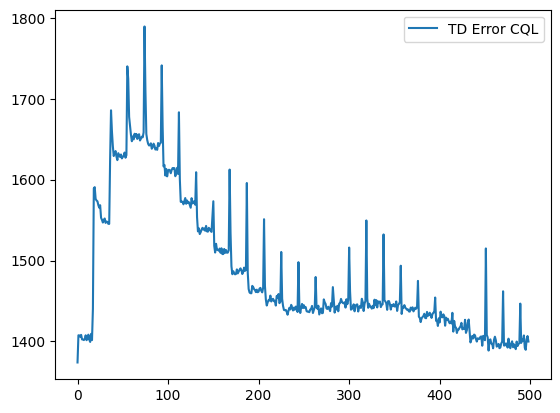

In [ ]:
plt.plot(range(499), logs_CQL.iloc[:,2], label = 'TD Error CQL')
# Add legend
plt.legend()

# Show the plot
plt.show()

In [ ]:
loss_CQL = pd.read_csv('/content/d3rlpy_logs/DiscreteCQL_20230414184006/loss.csv')
#loss.head()

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


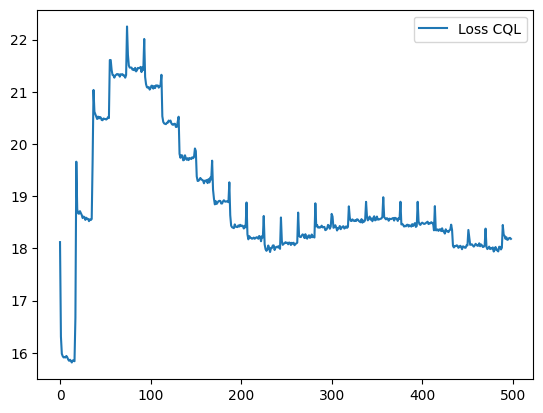

In [ ]:
plt.plot(range(499), loss_CQL.iloc[:,2], label = 'Loss CQL')
# Add legend
plt.legend()

# Show the plot
plt.show()

## BCQ

In [ ]:
from d3rlpy.algos import DiscreteBCQ
from sklearn.model_selection import train_test_split
from d3rlpy.metrics.scorer import discounted_sum_of_advantage_scorer
from d3rlpy.metrics.scorer import td_error_scorer
from d3rlpy.metrics.scorer import average_value_estimation_scorer

# setup BCQ algorithm
bcq = DiscreteBCQ(target_update_interval=3000, use_gpu=True)

# split train and test episodes
train_episodes, test_episodes = train_test_split(dataset, test_size=0.2)

# start training
result = bcq.fit(train_episodes,
        eval_episodes=test_episodes,
        n_epochs=500,
        scorers={
            'advantage': discounted_sum_of_advantage_scorer, # smaller is better
            'td_error': td_error_scorer, # smaller is better
            'value_scale': average_value_estimation_scorer # smaller is better
        })

2023-04-14 18:54:31 [debug    ] RoundIterator is selected.
2023-04-14 18:54:31 [info     ] Directory is created at d3rlpy_logs/DiscreteBCQ_20230414185431
2023-04-14 18:54:31 [debug    ] Building models...
2023-04-14 18:54:31 [debug    ] Models have been built.
2023-04-14 18:54:31 [info     ] Parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/params.json params={'action_flexibility': 0.3, 'action_scaler': None, 'batch_size': 32, 'beta': 0.5, 'encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'gamma': 0.99, 'generated_maxlen': 100000, 'learning_rate': 6.25e-05, 'n_critics': 1, 'n_frames': 1, 'n_steps': 1, 'optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 1e-08, 'weight_decay': 0, 'amsgrad': False}, 'q_func_factory': {'type': 'mean', 'params': {'share_encoder': False}}, 'real_ratio': 1.0, 'reward_scaler': None, 'scaler': None, 'target_update_interval': 3000, 'use_gpu': 0, 'algorithm': 'Dis

Epoch 1/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:32 [info     ] DiscreteBCQ_20230414185431: epoch=1 step=158 epoch=1 metrics={'time_sample_batch': 7.38931607596482e-05, 'time_algorithm_update': 0.004839461061018932, 'loss': 20.973839554605604, 'time_step': 0.004979379569427876, 'advantage': -17.615528210767465, 'td_error': 1216.2584696610145, 'value_scale': 5.800858501485876} step=158
2023-04-14 18:54:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_158.pt


Epoch 2/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:33 [info     ] DiscreteBCQ_20230414185431: epoch=2 step=316 epoch=2 metrics={'time_sample_batch': 7.371661029284513e-05, 'time_algorithm_update': 0.0046357776545271085, 'loss': 17.63411091550996, 'time_step': 0.004770204990724974, 'advantage': -22.60261351292935, 'td_error': 1306.363531154636, 'value_scale': 12.003044805563555} step=316
2023-04-14 18:54:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_316.pt


Epoch 3/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:34 [info     ] DiscreteBCQ_20230414185431: epoch=3 step=474 epoch=3 metrics={'time_sample_batch': 0.00010878526711765724, 'time_algorithm_update': 0.005220150645775131, 'loss': 16.45448719097089, 'time_step': 0.00538974019545543, 'advantage': -10.73574540599718, 'td_error': 1284.2268985602846, 'value_scale': 12.773816061940433} step=474
2023-04-14 18:54:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_474.pt


Epoch 4/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:35 [info     ] DiscreteBCQ_20230414185431: epoch=4 step=632 epoch=4 metrics={'time_sample_batch': 0.0002982782412178909, 'time_algorithm_update': 0.005666347998607007, 'loss': 16.342242162438886, 'time_step': 0.0060660431656656385, 'advantage': -6.944008440569156, 'td_error': 1274.3105159505453, 'value_scale': 12.76296893565351} step=632
2023-04-14 18:54:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_632.pt


Epoch 5/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:37 [info     ] DiscreteBCQ_20230414185431: epoch=5 step=790 epoch=5 metrics={'time_sample_batch': 8.162818377531028e-05, 'time_algorithm_update': 0.00505964665473262, 'loss': 16.312910433056988, 'time_step': 0.0052141207682935495, 'advantage': -5.423032256005177, 'td_error': 1267.6571937253577, 'value_scale': 12.614262129809406} step=790
2023-04-14 18:54:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_790.pt


Epoch 6/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:38 [info     ] DiscreteBCQ_20230414185431: epoch=6 step=948 epoch=6 metrics={'time_sample_batch': 8.396559123751484e-05, 'time_algorithm_update': 0.004827470719059811, 'loss': 16.30101529254189, 'time_step': 0.00498396535462971, 'advantage': -5.383888718570874, 'td_error': 1270.3718622168058, 'value_scale': 12.887545226623653} step=948
2023-04-14 18:54:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_948.pt


Epoch 7/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:39 [info     ] DiscreteBCQ_20230414185431: epoch=7 step=1106 epoch=7 metrics={'time_sample_batch': 7.704843448687203e-05, 'time_algorithm_update': 0.004656103592884692, 'loss': 16.28420498099508, 'time_step': 0.004791193370577655, 'advantage': -8.864164828568674, 'td_error': 1285.0164754547206, 'value_scale': 13.107461689982175} step=1106
2023-04-14 18:54:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1106.pt


Epoch 8/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:40 [info     ] DiscreteBCQ_20230414185431: epoch=8 step=1264 epoch=8 metrics={'time_sample_batch': 7.79960728898833e-05, 'time_algorithm_update': 0.004676314848887769, 'loss': 16.221640592888942, 'time_step': 0.004816428015503703, 'advantage': -8.299362040733874, 'td_error': 1284.8723566091574, 'value_scale': 13.330087558643237} step=1264
2023-04-14 18:54:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1264.pt


Epoch 9/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:41 [info     ] DiscreteBCQ_20230414185431: epoch=9 step=1422 epoch=9 metrics={'time_sample_batch': 9.808962858175929e-05, 'time_algorithm_update': 0.004728671870654142, 'loss': 16.24788430974453, 'time_step': 0.004896403867987138, 'advantage': -9.289754018967866, 'td_error': 1288.8636695802795, 'value_scale': 13.491004221411746} step=1422
2023-04-14 18:54:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1422.pt


Epoch 10/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:42 [info     ] DiscreteBCQ_20230414185431: epoch=10 step=1580 epoch=10 metrics={'time_sample_batch': 8.683717703517479e-05, 'time_algorithm_update': 0.0048016294648375694, 'loss': 16.247740564467033, 'time_step': 0.004956645301625698, 'advantage': -12.600963069795485, 'td_error': 1300.067285705592, 'value_scale': 13.595317613019906} step=1580
2023-04-14 18:54:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1580.pt


Epoch 11/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:43 [info     ] DiscreteBCQ_20230414185431: epoch=11 step=1738 epoch=11 metrics={'time_sample_batch': 7.922438126576097e-05, 'time_algorithm_update': 0.00473697728748563, 'loss': 16.17140718049641, 'time_step': 0.004879480675805973, 'advantage': -15.685782441580598, 'td_error': 1311.2882882001259, 'value_scale': 13.762775146454917} step=1738
2023-04-14 18:54:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1738.pt


Epoch 12/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:44 [info     ] DiscreteBCQ_20230414185431: epoch=12 step=1896 epoch=12 metrics={'time_sample_batch': 8.662592006635063e-05, 'time_algorithm_update': 0.004617731782454479, 'loss': 16.213705225835874, 'time_step': 0.004764114754109443, 'advantage': -16.00678889080796, 'td_error': 1313.626657670276, 'value_scale': 13.957198627575023} step=1896
2023-04-14 18:54:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_1896.pt


Epoch 13/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:45 [info     ] DiscreteBCQ_20230414185431: epoch=13 step=2054 epoch=13 metrics={'time_sample_batch': 0.00010565111908731581, 'time_algorithm_update': 0.004528614539134351, 'loss': 16.192581140542334, 'time_step': 0.004683760148060473, 'advantage': -18.158865682160084, 'td_error': 1320.5719095113884, 'value_scale': 14.083209084175728} step=2054
2023-04-14 18:54:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2054.pt


Epoch 14/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:46 [info     ] DiscreteBCQ_20230414185431: epoch=14 step=2212 epoch=14 metrics={'time_sample_batch': 0.00011306623869304415, 'time_algorithm_update': 0.005153773706170577, 'loss': 16.171374185175836, 'time_step': 0.005339565156381341, 'advantage': -19.61408201463266, 'td_error': 1325.4564168316977, 'value_scale': 14.160938130382405} step=2212
2023-04-14 18:54:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2212.pt


Epoch 15/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:48 [info     ] DiscreteBCQ_20230414185431: epoch=15 step=2370 epoch=15 metrics={'time_sample_batch': 0.00020847743070578274, 'time_algorithm_update': 0.005777591391454769, 'loss': 16.112634290622758, 'time_step': 0.006157713600351841, 'advantage': -19.59223026392203, 'td_error': 1323.9326385628763, 'value_scale': 14.09629241251117} step=2370
2023-04-14 18:54:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2370.pt


Epoch 16/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:49 [info     ] DiscreteBCQ_20230414185431: epoch=16 step=2528 epoch=16 metrics={'time_sample_batch': 0.00011758411986918389, 'time_algorithm_update': 0.005328367028055312, 'loss': 16.14002259773544, 'time_step': 0.005532495583160014, 'advantage': -18.022790387934805, 'td_error': 1320.367609363403, 'value_scale': 14.201218702250006} step=2528
2023-04-14 18:54:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2528.pt


Epoch 17/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:50 [info     ] DiscreteBCQ_20230414185431: epoch=17 step=2686 epoch=17 metrics={'time_sample_batch': 8.96695293957674e-05, 'time_algorithm_update': 0.005071472518051727, 'loss': 16.163722158987312, 'time_step': 0.005220835721945461, 'advantage': -19.180479172103407, 'td_error': 1326.2419483888102, 'value_scale': 14.23113769030479} step=2686
2023-04-14 18:54:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2686.pt


Epoch 18/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:51 [info     ] DiscreteBCQ_20230414185431: epoch=18 step=2844 epoch=18 metrics={'time_sample_batch': 7.922739922245847e-05, 'time_algorithm_update': 0.0045848345454735095, 'loss': 16.153627794000165, 'time_step': 0.004716320882869672, 'advantage': -19.11345874780535, 'td_error': 1327.376667578248, 'value_scale': 14.18151774167094} step=2844
2023-04-14 18:54:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_2844.pt


Epoch 19/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:53 [info     ] DiscreteBCQ_20230414185431: epoch=19 step=3002 epoch=19 metrics={'time_sample_batch': 0.00017928624454932878, 'time_algorithm_update': 0.005895065355904495, 'loss': 16.157332948491543, 'time_step': 0.0061750774142108385, 'advantage': -19.01092742563408, 'td_error': 1329.7451797694773, 'value_scale': 14.281286104121264} step=3002
2023-04-14 18:54:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3002.pt


Epoch 20/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:54 [info     ] DiscreteBCQ_20230414185431: epoch=20 step=3160 epoch=20 metrics={'time_sample_batch': 0.00011931491803519333, 'time_algorithm_update': 0.005788750286343731, 'loss': 20.334171343453324, 'time_step': 0.006038846848886224, 'advantage': -12.492438774137335, 'td_error': 1442.078175457682, 'value_scale': 25.338742507286515} step=3160
2023-04-14 18:54:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3160.pt


Epoch 21/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:55 [info     ] DiscreteBCQ_20230414185431: epoch=21 step=3318 epoch=21 metrics={'time_sample_batch': 7.585332363466673e-05, 'time_algorithm_update': 0.00467052338998529, 'loss': 19.260714380046988, 'time_step': 0.004800801035724109, 'advantage': -15.02247988921339, 'td_error': 1475.756250348116, 'value_scale': 26.8813988188519} step=3318
2023-04-14 18:54:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3318.pt


Epoch 22/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:56 [info     ] DiscreteBCQ_20230414185431: epoch=22 step=3476 epoch=22 metrics={'time_sample_batch': 8.377847792227058e-05, 'time_algorithm_update': 0.004722488077380989, 'loss': 19.62013446832005, 'time_step': 0.004869089850896522, 'advantage': -12.080573310660041, 'td_error': 1442.6531592195558, 'value_scale': 25.615929530670282} step=3476
2023-04-14 18:54:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3476.pt


Epoch 23/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:57 [info     ] DiscreteBCQ_20230414185431: epoch=23 step=3634 epoch=23 metrics={'time_sample_batch': 8.146521411364591e-05, 'time_algorithm_update': 0.004844025720523883, 'loss': 19.440571283992334, 'time_step': 0.004985344560840462, 'advantage': -11.217305308617712, 'td_error': 1432.86016489066, 'value_scale': 25.55851342337472} step=3634
2023-04-14 18:54:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3634.pt


Epoch 24/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:54:58 [info     ] DiscreteBCQ_20230414185431: epoch=24 step=3792 epoch=24 metrics={'time_sample_batch': 7.820883883705622e-05, 'time_algorithm_update': 0.004680153689806974, 'loss': 19.52501578874226, 'time_step': 0.004826479320284687, 'advantage': -11.721998135524073, 'td_error': 1444.2669365358815, 'value_scale': 26.30613661806556} step=3792
2023-04-14 18:54:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3792.pt


Epoch 25/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:00 [info     ] DiscreteBCQ_20230414185431: epoch=25 step=3950 epoch=25 metrics={'time_sample_batch': 0.00014618831344797643, 'time_algorithm_update': 0.005702663071547882, 'loss': 19.46590410304975, 'time_step': 0.005947494808631607, 'advantage': -9.622336555313915, 'td_error': 1428.7843837474534, 'value_scale': 26.43411425292262} step=3950
2023-04-14 18:55:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_3950.pt


Epoch 26/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:01 [info     ] DiscreteBCQ_20230414185431: epoch=26 step=4108 epoch=26 metrics={'time_sample_batch': 0.00015815602073186561, 'time_algorithm_update': 0.006099830699872367, 'loss': 19.538520390474343, 'time_step': 0.006375413906725147, 'advantage': -9.88408196609431, 'td_error': 1437.5496724179582, 'value_scale': 26.7906504907203} step=4108
2023-04-14 18:55:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4108.pt


Epoch 27/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:02 [info     ] DiscreteBCQ_20230414185431: epoch=27 step=4266 epoch=27 metrics={'time_sample_batch': 7.335294651079781e-05, 'time_algorithm_update': 0.004647420931466018, 'loss': 19.515414189688766, 'time_step': 0.004778869544403462, 'advantage': -10.37526171825168, 'td_error': 1445.8670324477241, 'value_scale': 27.00821805681501} step=4266
2023-04-14 18:55:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4266.pt


Epoch 28/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:03 [info     ] DiscreteBCQ_20230414185431: epoch=28 step=4424 epoch=28 metrics={'time_sample_batch': 8.478949341592909e-05, 'time_algorithm_update': 0.004755251015288921, 'loss': 19.42696049243589, 'time_step': 0.004902101770231995, 'advantage': -8.538885812858606, 'td_error': 1431.2616156582897, 'value_scale': 26.866399507264834} step=4424
2023-04-14 18:55:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4424.pt


Epoch 29/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:04 [info     ] DiscreteBCQ_20230414185431: epoch=29 step=4582 epoch=29 metrics={'time_sample_batch': 8.70016556751879e-05, 'time_algorithm_update': 0.005024075508117676, 'loss': 19.414385424384587, 'time_step': 0.005176898799365079, 'advantage': -10.762306724715085, 'td_error': 1450.3580166455872, 'value_scale': 27.235082271384456} step=4582
2023-04-14 18:55:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4582.pt


Epoch 30/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:05 [info     ] DiscreteBCQ_20230414185431: epoch=30 step=4740 epoch=30 metrics={'time_sample_batch': 7.931642894503437e-05, 'time_algorithm_update': 0.004973560948915119, 'loss': 19.375728039801874, 'time_step': 0.005117614057999623, 'advantage': -7.473795726527471, 'td_error': 1430.631076997845, 'value_scale': 26.930534654418473} step=4740
2023-04-14 18:55:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4740.pt


Epoch 31/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:07 [info     ] DiscreteBCQ_20230414185431: epoch=31 step=4898 epoch=31 metrics={'time_sample_batch': 0.00011981438986862762, 'time_algorithm_update': 0.004842125916782814, 'loss': 19.36321079278294, 'time_step': 0.005025898353962959, 'advantage': -7.613500394004359, 'td_error': 1433.1541772245314, 'value_scale': 27.10511453547533} step=4898
2023-04-14 18:55:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_4898.pt


Epoch 32/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:08 [info     ] DiscreteBCQ_20230414185431: epoch=32 step=5056 epoch=32 metrics={'time_sample_batch': 0.00010983551604838311, 'time_algorithm_update': 0.004737694052201283, 'loss': 19.425243250931366, 'time_step': 0.004905833473688439, 'advantage': -8.66396862536052, 'td_error': 1438.8410994887797, 'value_scale': 27.11475709303926} step=5056
2023-04-14 18:55:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5056.pt


Epoch 33/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:09 [info     ] DiscreteBCQ_20230414185431: epoch=33 step=5214 epoch=33 metrics={'time_sample_batch': 8.680699746819991e-05, 'time_algorithm_update': 0.004913185216203521, 'loss': 19.291911276080942, 'time_step': 0.005059687397148036, 'advantage': -6.315039274321083, 'td_error': 1424.0507263930435, 'value_scale': 26.715641761102273} step=5214
2023-04-14 18:55:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5214.pt


Epoch 34/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:10 [info     ] DiscreteBCQ_20230414185431: epoch=34 step=5372 epoch=34 metrics={'time_sample_batch': 0.00011956389946273611, 'time_algorithm_update': 0.004704730420172969, 'loss': 19.336549608013296, 'time_step': 0.004880799522882775, 'advantage': -6.468616839068019, 'td_error': 1426.6992570899617, 'value_scale': 26.715151269095283} step=5372
2023-04-14 18:55:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5372.pt


Epoch 35/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:11 [info     ] DiscreteBCQ_20230414185431: epoch=35 step=5530 epoch=35 metrics={'time_sample_batch': 8.149388470227205e-05, 'time_algorithm_update': 0.004873118823087668, 'loss': 19.347293654574624, 'time_step': 0.00501139405407483, 'advantage': -7.49869470124349, 'td_error': 1438.0423179000616, 'value_scale': 27.202854682303762} step=5530
2023-04-14 18:55:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5530.pt


Epoch 36/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:12 [info     ] DiscreteBCQ_20230414185431: epoch=36 step=5688 epoch=36 metrics={'time_sample_batch': 0.00012612342834472656, 'time_algorithm_update': 0.005850044986869716, 'loss': 19.289637547505052, 'time_step': 0.006090488614915292, 'advantage': -6.007357525896895, 'td_error': 1429.0808327480531, 'value_scale': 27.024479130336218} step=5688
2023-04-14 18:55:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5688.pt


Epoch 37/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:14 [info     ] DiscreteBCQ_20230414185431: epoch=37 step=5846 epoch=37 metrics={'time_sample_batch': 0.00013761278949206388, 'time_algorithm_update': 0.005825795704805398, 'loss': 19.35643863074387, 'time_step': 0.00608940969539594, 'advantage': -6.113270616841924, 'td_error': 1421.7347375930622, 'value_scale': 26.464010474304434} step=5846
2023-04-14 18:55:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_5846.pt


Epoch 38/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:15 [info     ] DiscreteBCQ_20230414185431: epoch=38 step=6004 epoch=38 metrics={'time_sample_batch': 7.992152926288074e-05, 'time_algorithm_update': 0.0049086039579367335, 'loss': 19.44404338281366, 'time_step': 0.005050653143774105, 'advantage': -8.173817383474043, 'td_error': 1440.4414982591184, 'value_scale': 27.265601449031166} step=6004
2023-04-14 18:55:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6004.pt


Epoch 39/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:16 [info     ] DiscreteBCQ_20230414185431: epoch=39 step=6162 epoch=39 metrics={'time_sample_batch': 7.942809334284143e-05, 'time_algorithm_update': 0.0047959798498998715, 'loss': 22.04561424255371, 'time_step': 0.004959783976591086, 'advantage': -10.586116955239618, 'td_error': 1566.068968820802, 'value_scale': 37.757978149178406} step=6162
2023-04-14 18:55:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6162.pt


Epoch 40/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:17 [info     ] DiscreteBCQ_20230414185431: epoch=40 step=6320 epoch=40 metrics={'time_sample_batch': 7.926210572447957e-05, 'time_algorithm_update': 0.004832643496839306, 'loss': 21.252859930448896, 'time_step': 0.004983345164528376, 'advantage': -14.754879334940085, 'td_error': 1567.9187390536645, 'value_scale': 38.205246229429505} step=6320
2023-04-14 18:55:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6320.pt


Epoch 41/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:18 [info     ] DiscreteBCQ_20230414185431: epoch=41 step=6478 epoch=41 metrics={'time_sample_batch': 9.337407124193408e-05, 'time_algorithm_update': 0.005142759673203094, 'loss': 21.230420486836493, 'time_step': 0.005300865897649451, 'advantage': -13.656955240287811, 'td_error': 1550.1343582807476, 'value_scale': 38.34057380646812} step=6478
2023-04-14 18:55:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6478.pt


Epoch 42/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:19 [info     ] DiscreteBCQ_20230414185431: epoch=42 step=6636 epoch=42 metrics={'time_sample_batch': 8.354609525656398e-05, 'time_algorithm_update': 0.005252770230739932, 'loss': 21.184343241438082, 'time_step': 0.005413183683081519, 'advantage': -10.339248235459687, 'td_error': 1530.8879332409863, 'value_scale': 38.55185088522186} step=6636
2023-04-14 18:55:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6636.pt


Epoch 43/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:21 [info     ] DiscreteBCQ_20230414185431: epoch=43 step=6794 epoch=43 metrics={'time_sample_batch': 0.00011201749874066703, 'time_algorithm_update': 0.005055756508549557, 'loss': 21.17253065109253, 'time_step': 0.0052368399463122405, 'advantage': -9.957488349808429, 'td_error': 1525.802481723384, 'value_scale': 38.14534131201078} step=6794
2023-04-14 18:55:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6794.pt


Epoch 44/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:22 [info     ] DiscreteBCQ_20230414185431: epoch=44 step=6952 epoch=44 metrics={'time_sample_batch': 7.985815217223348e-05, 'time_algorithm_update': 0.004788982717296745, 'loss': 21.118682287916354, 'time_step': 0.004932006703147405, 'advantage': -7.7956255834460215, 'td_error': 1513.074650206171, 'value_scale': 38.09508140446136} step=6952
2023-04-14 18:55:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_6952.pt


Epoch 45/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:23 [info     ] DiscreteBCQ_20230414185431: epoch=45 step=7110 epoch=45 metrics={'time_sample_batch': 7.81741323350351e-05, 'time_algorithm_update': 0.004895931557763981, 'loss': 21.146407057967366, 'time_step': 0.005046776578396182, 'advantage': -10.275918360131056, 'td_error': 1534.4595883981601, 'value_scale': 38.7043260419691} step=7110
2023-04-14 18:55:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7110.pt


Epoch 46/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:24 [info     ] DiscreteBCQ_20230414185431: epoch=46 step=7268 epoch=46 metrics={'time_sample_batch': 0.00012776821474485758, 'time_algorithm_update': 0.005455333975296986, 'loss': 21.171907527537286, 'time_step': 0.005690336227416992, 'advantage': -7.288473058466398, 'td_error': 1519.8412188550192, 'value_scale': 38.4919876864518} step=7268
2023-04-14 18:55:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7268.pt


Epoch 47/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:25 [info     ] DiscreteBCQ_20230414185431: epoch=47 step=7426 epoch=47 metrics={'time_sample_batch': 0.00024019464661803426, 'time_algorithm_update': 0.005836815773686276, 'loss': 21.139126119734367, 'time_step': 0.006213168554668185, 'advantage': -6.214782507504708, 'td_error': 1514.3011092133559, 'value_scale': 38.529346401258785} step=7426
2023-04-14 18:55:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7426.pt


Epoch 48/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:27 [info     ] DiscreteBCQ_20230414185431: epoch=48 step=7584 epoch=48 metrics={'time_sample_batch': 9.362003471277936e-05, 'time_algorithm_update': 0.005208852924878085, 'loss': 21.133476541012147, 'time_step': 0.005383595635619344, 'advantage': -7.4558605289509545, 'td_error': 1518.5272392226923, 'value_scale': 38.406656527427174} step=7584
2023-04-14 18:55:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7584.pt


Epoch 49/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:28 [info     ] DiscreteBCQ_20230414185431: epoch=49 step=7742 epoch=49 metrics={'time_sample_batch': 8.316130577763425e-05, 'time_algorithm_update': 0.004816283153582223, 'loss': 21.13665566866911, 'time_step': 0.00496636312219161, 'advantage': -5.819360995653303, 'td_error': 1508.4792474063465, 'value_scale': 38.157777826022} step=7742
2023-04-14 18:55:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7742.pt


Epoch 50/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:29 [info     ] DiscreteBCQ_20230414185431: epoch=50 step=7900 epoch=50 metrics={'time_sample_batch': 7.843216763267034e-05, 'time_algorithm_update': 0.004741306546368176, 'loss': 21.1726393699646, 'time_step': 0.004878686953194534, 'advantage': -5.342463041535908, 'td_error': 1509.980494210771, 'value_scale': 38.54664072161936} step=7900
2023-04-14 18:55:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_7900.pt


Epoch 51/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:30 [info     ] DiscreteBCQ_20230414185431: epoch=51 step=8058 epoch=51 metrics={'time_sample_batch': 8.278255221209949e-05, 'time_algorithm_update': 0.004869106449658358, 'loss': 21.12386598466318, 'time_step': 0.005018809173680559, 'advantage': -6.1434773984413, 'td_error': 1513.2073950725014, 'value_scale': 38.52254662826715} step=8058
2023-04-14 18:55:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8058.pt


Epoch 52/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:31 [info     ] DiscreteBCQ_20230414185431: epoch=52 step=8216 epoch=52 metrics={'time_sample_batch': 8.447562591939033e-05, 'time_algorithm_update': 0.004954909976524643, 'loss': 21.144358127932005, 'time_step': 0.005117378657377219, 'advantage': -8.49130765041857, 'td_error': 1521.1946081999588, 'value_scale': 38.5867378411606} step=8216
2023-04-14 18:55:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8216.pt


Epoch 53/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:32 [info     ] DiscreteBCQ_20230414185431: epoch=53 step=8374 epoch=53 metrics={'time_sample_batch': 8.070619800422765e-05, 'time_algorithm_update': 0.004671018334883678, 'loss': 21.14186877842191, 'time_step': 0.004825664471976365, 'advantage': -8.330918731417231, 'td_error': 1523.8276149599822, 'value_scale': 38.890811048235214} step=8374
2023-04-14 18:55:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8374.pt


Epoch 54/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:33 [info     ] DiscreteBCQ_20230414185431: epoch=54 step=8532 epoch=54 metrics={'time_sample_batch': 8.489663087868993e-05, 'time_algorithm_update': 0.004961618894263159, 'loss': 21.13516136966174, 'time_step': 0.005115617679644234, 'advantage': -4.102831484993485, 'td_error': 1500.7161194039243, 'value_scale': 38.591698008062295} step=8532
2023-04-14 18:55:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8532.pt


Epoch 55/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:34 [info     ] DiscreteBCQ_20230414185431: epoch=55 step=8690 epoch=55 metrics={'time_sample_batch': 8.485588846327383e-05, 'time_algorithm_update': 0.005127905290338058, 'loss': 21.12289355072794, 'time_step': 0.0052795545964301385, 'advantage': -7.757575001601842, 'td_error': 1517.8717851895458, 'value_scale': 38.720746665571646} step=8690
2023-04-14 18:55:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8690.pt


Epoch 56/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:36 [info     ] DiscreteBCQ_20230414185431: epoch=56 step=8848 epoch=56 metrics={'time_sample_batch': 8.598913120318062e-05, 'time_algorithm_update': 0.005084590066837359, 'loss': 21.113972168934495, 'time_step': 0.0052410605587536775, 'advantage': -6.901557689935582, 'td_error': 1513.4758432703902, 'value_scale': 38.57829839640142} step=8848
2023-04-14 18:55:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_8848.pt


Epoch 57/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:37 [info     ] DiscreteBCQ_20230414185431: epoch=57 step=9006 epoch=57 metrics={'time_sample_batch': 0.0001007197778436202, 'time_algorithm_update': 0.0055806455732900885, 'loss': 21.272550051725364, 'time_step': 0.005790390545808816, 'advantage': -7.292022204228147, 'td_error': 1518.5796021780711, 'value_scale': 38.935387841891135} step=9006
2023-04-14 18:55:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9006.pt


Epoch 58/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:38 [info     ] DiscreteBCQ_20230414185431: epoch=58 step=9164 epoch=58 metrics={'time_sample_batch': 0.00015980231611034538, 'time_algorithm_update': 0.0059336725669571115, 'loss': 22.787428125550477, 'time_step': 0.006228935869434212, 'advantage': -10.89488076880027, 'td_error': 1632.4302929648788, 'value_scale': 49.379033248488966} step=9164
2023-04-14 18:55:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9164.pt


Epoch 59/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:39 [info     ] DiscreteBCQ_20230414185431: epoch=59 step=9322 epoch=59 metrics={'time_sample_batch': 8.325184447855889e-05, 'time_algorithm_update': 0.005074036272266243, 'loss': 22.252576393417165, 'time_step': 0.005234058899215505, 'advantage': -7.949135223403216, 'td_error': 1562.5200813681117, 'value_scale': 48.77017391013363} step=9322
2023-04-14 18:55:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9322.pt


Epoch 60/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:41 [info     ] DiscreteBCQ_20230414185431: epoch=60 step=9480 epoch=60 metrics={'time_sample_batch': 9.229062478753585e-05, 'time_algorithm_update': 0.004859279982651336, 'loss': 22.20350721214391, 'time_step': 0.005027162877819206, 'advantage': -7.49765104838692, 'td_error': 1541.0093777285924, 'value_scale': 48.64707651027842} step=9480
2023-04-14 18:55:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9480.pt


Epoch 61/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:42 [info     ] DiscreteBCQ_20230414185431: epoch=61 step=9638 epoch=61 metrics={'time_sample_batch': 8.529047422771212e-05, 'time_algorithm_update': 0.004720490190047252, 'loss': 22.158490235292458, 'time_step': 0.004865579967257343, 'advantage': -6.42758213991275, 'td_error': 1539.6471147897103, 'value_scale': 48.60636841468369} step=9638
2023-04-14 18:55:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9638.pt


Epoch 62/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:43 [info     ] DiscreteBCQ_20230414185431: epoch=62 step=9796 epoch=62 metrics={'time_sample_batch': 8.149992061566703e-05, 'time_algorithm_update': 0.004817179486721377, 'loss': 22.164510026762756, 'time_step': 0.004966856558111649, 'advantage': -6.815253144969162, 'td_error': 1557.0357420884673, 'value_scale': 49.681164930778124} step=9796
2023-04-14 18:55:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9796.pt


Epoch 63/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:44 [info     ] DiscreteBCQ_20230414185431: epoch=63 step=9954 epoch=63 metrics={'time_sample_batch': 0.00010810622686072241, 'time_algorithm_update': 0.004921809027466593, 'loss': 22.143472701688356, 'time_step': 0.005097235305399834, 'advantage': -7.034597204022326, 'td_error': 1553.8174355920685, 'value_scale': 49.41031428451244} step=9954
2023-04-14 18:55:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_9954.pt


Epoch 64/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:45 [info     ] DiscreteBCQ_20230414185431: epoch=64 step=10112 epoch=64 metrics={'time_sample_batch': 0.00010667873334281052, 'time_algorithm_update': 0.005016452149499821, 'loss': 22.064356803894043, 'time_step': 0.005202577083925658, 'advantage': -7.951193556439852, 'td_error': 1556.9124356953132, 'value_scale': 49.50834577700346} step=10112
2023-04-14 18:55:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10112.pt


Epoch 65/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:46 [info     ] DiscreteBCQ_20230414185431: epoch=65 step=10270 epoch=65 metrics={'time_sample_batch': 8.975252320494832e-05, 'time_algorithm_update': 0.0048757746249814575, 'loss': 22.10670122315612, 'time_step': 0.005030579204800763, 'advantage': -5.704050052626262, 'td_error': 1541.2607453624976, 'value_scale': 49.038148769540676} step=10270
2023-04-14 18:55:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10270.pt


Epoch 66/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:47 [info     ] DiscreteBCQ_20230414185431: epoch=66 step=10428 epoch=66 metrics={'time_sample_batch': 9.341632263569892e-05, 'time_algorithm_update': 0.004982762698885761, 'loss': 22.094013316721856, 'time_step': 0.005139909213102317, 'advantage': -6.477418888541019, 'td_error': 1543.6013228571783, 'value_scale': 49.06535273371516} step=10428
2023-04-14 18:55:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10428.pt


Epoch 67/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:48 [info     ] DiscreteBCQ_20230414185431: epoch=67 step=10586 epoch=67 metrics={'time_sample_batch': 0.00010111965710603738, 'time_algorithm_update': 0.005027829846249351, 'loss': 22.08763604828074, 'time_step': 0.00520133670372299, 'advantage': -5.589491273029654, 'td_error': 1540.7981708756029, 'value_scale': 49.290761477790745} step=10586
2023-04-14 18:55:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10586.pt


Epoch 68/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:50 [info     ] DiscreteBCQ_20230414185431: epoch=68 step=10744 epoch=68 metrics={'time_sample_batch': 0.00014398822301550757, 'time_algorithm_update': 0.006274659422379506, 'loss': 22.059220096732997, 'time_step': 0.006548643112182617, 'advantage': -6.852553782793427, 'td_error': 1542.196768258397, 'value_scale': 49.20528668142194} step=10744
2023-04-14 18:55:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10744.pt


Epoch 69/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:51 [info     ] DiscreteBCQ_20230414185431: epoch=69 step=10902 epoch=69 metrics={'time_sample_batch': 0.00011692771428748022, 'time_algorithm_update': 0.006273437149917023, 'loss': 22.102111544790148, 'time_step': 0.0065462770341317865, 'advantage': -8.016648711889713, 'td_error': 1551.407388510955, 'value_scale': 49.384133805087174} step=10902
2023-04-14 18:55:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_10902.pt


Epoch 70/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:52 [info     ] DiscreteBCQ_20230414185431: epoch=70 step=11060 epoch=70 metrics={'time_sample_batch': 0.0001289120203332056, 'time_algorithm_update': 0.004994867723199386, 'loss': 22.074816474431678, 'time_step': 0.005187046678760384, 'advantage': -6.028782526738019, 'td_error': 1537.6647390816547, 'value_scale': 49.03841587199207} step=11060
2023-04-14 18:55:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11060.pt


Epoch 71/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:54 [info     ] DiscreteBCQ_20230414185431: epoch=71 step=11218 epoch=71 metrics={'time_sample_batch': 8.852270585072191e-05, 'time_algorithm_update': 0.0047444059878964965, 'loss': 22.067333855206453, 'time_step': 0.004896357089658326, 'advantage': -3.9151630333854164, 'td_error': 1526.9482664406012, 'value_scale': 48.86104624391062} step=11218
2023-04-14 18:55:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11218.pt


Epoch 72/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:55 [info     ] DiscreteBCQ_20230414185431: epoch=72 step=11376 epoch=72 metrics={'time_sample_batch': 9.375433378581759e-05, 'time_algorithm_update': 0.005059444451633888, 'loss': 22.136846801902674, 'time_step': 0.005221892006789582, 'advantage': -5.663298869485074, 'td_error': 1538.271496431728, 'value_scale': 49.27192941319528} step=11376
2023-04-14 18:55:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11376.pt


Epoch 73/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:56 [info     ] DiscreteBCQ_20230414185431: epoch=73 step=11534 epoch=73 metrics={'time_sample_batch': 8.545947980277146e-05, 'time_algorithm_update': 0.004922006703630279, 'loss': 22.08036231994629, 'time_step': 0.005102131940141509, 'advantage': -6.84703309053787, 'td_error': 1542.0812451839188, 'value_scale': 49.21590896665359} step=11534
2023-04-14 18:55:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11534.pt


Epoch 74/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:57 [info     ] DiscreteBCQ_20230414185431: epoch=74 step=11692 epoch=74 metrics={'time_sample_batch': 8.561792252938958e-05, 'time_algorithm_update': 0.005073782763903654, 'loss': 22.08872490291354, 'time_step': 0.0052433074275149575, 'advantage': -5.5908966880162945, 'td_error': 1539.2468005963274, 'value_scale': 49.25153577649915} step=11692
2023-04-14 18:55:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11692.pt


Epoch 75/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:58 [info     ] DiscreteBCQ_20230414185431: epoch=75 step=11850 epoch=75 metrics={'time_sample_batch': 8.987324147284786e-05, 'time_algorithm_update': 0.005011037935184527, 'loss': 22.09460744374915, 'time_step': 0.0051977679699282105, 'advantage': -4.200997391216437, 'td_error': 1530.5080700815472, 'value_scale': 49.085966203019424} step=11850
2023-04-14 18:55:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_11850.pt


Epoch 76/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:55:59 [info     ] DiscreteBCQ_20230414185431: epoch=76 step=12008 epoch=76 metrics={'time_sample_batch': 9.304662294025663e-05, 'time_algorithm_update': 0.004731661156763004, 'loss': 22.227497704421417, 'time_step': 0.004901375951646249, 'advantage': -5.211411472256444, 'td_error': 1537.94596609924, 'value_scale': 49.486820871949654} step=12008
2023-04-14 18:55:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12008.pt


Epoch 77/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:00 [info     ] DiscreteBCQ_20230414185431: epoch=77 step=12166 epoch=77 metrics={'time_sample_batch': 8.085558686075331e-05, 'time_algorithm_update': 0.004991938796224473, 'loss': 22.836495284792743, 'time_step': 0.005147277554379234, 'advantage': -8.335416719876724, 'td_error': 1617.8454190568114, 'value_scale': 58.79261807769422} step=12166
2023-04-14 18:56:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12166.pt


Epoch 78/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:01 [info     ] DiscreteBCQ_20230414185431: epoch=78 step=12324 epoch=78 metrics={'time_sample_batch': 9.290779693217217e-05, 'time_algorithm_update': 0.004865190650843367, 'loss': 22.262540159346184, 'time_step': 0.005028789556479152, 'advantage': -7.940371573288437, 'td_error': 1562.3698565881455, 'value_scale': 58.36788371907238} step=12324
2023-04-14 18:56:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12324.pt


Epoch 79/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:03 [info     ] DiscreteBCQ_20230414185431: epoch=79 step=12482 epoch=79 metrics={'time_sample_batch': 0.00010966801945167251, 'time_algorithm_update': 0.005889358399789544, 'loss': 22.234243199795106, 'time_step': 0.0061199997044816806, 'advantage': -7.937257978847769, 'td_error': 1544.4803825639676, 'value_scale': 58.53555894063707} step=12482
2023-04-14 18:56:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12482.pt


Epoch 80/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:04 [info     ] DiscreteBCQ_20230414185431: epoch=80 step=12640 epoch=80 metrics={'time_sample_batch': 0.0001823585244673717, 'time_algorithm_update': 0.005946758427197421, 'loss': 22.201111540009705, 'time_step': 0.006236126151265977, 'advantage': -6.818833877704116, 'td_error': 1533.7692494495266, 'value_scale': 58.44112899662445} step=12640
2023-04-14 18:56:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12640.pt


Epoch 81/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:06 [info     ] DiscreteBCQ_20230414185431: epoch=81 step=12798 epoch=81 metrics={'time_sample_batch': 0.0001937965803508517, 'time_algorithm_update': 0.006571424158313606, 'loss': 22.16133468965941, 'time_step': 0.006904762002486217, 'advantage': -4.50643453995486, 'td_error': 1526.6498549697137, 'value_scale': 58.628947422219056} step=12798
2023-04-14 18:56:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12798.pt


Epoch 82/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:07 [info     ] DiscreteBCQ_20230414185431: epoch=82 step=12956 epoch=82 metrics={'time_sample_batch': 0.00034754185736933843, 'time_algorithm_update': 0.006403781190703187, 'loss': 22.162747189968446, 'time_step': 0.006844692592379413, 'advantage': -4.548858613728257, 'td_error': 1529.0155029749826, 'value_scale': 58.75482149455538} step=12956
2023-04-14 18:56:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_12956.pt


Epoch 83/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:08 [info     ] DiscreteBCQ_20230414185431: epoch=83 step=13114 epoch=83 metrics={'time_sample_batch': 8.185000359257566e-05, 'time_algorithm_update': 0.004871102828013746, 'loss': 22.21088439603395, 'time_step': 0.0050135775457454635, 'advantage': -5.486382096059075, 'td_error': 1529.2793550813635, 'value_scale': 58.53618521082816} step=13114
2023-04-14 18:56:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13114.pt


Epoch 84/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:09 [info     ] DiscreteBCQ_20230414185431: epoch=84 step=13272 epoch=84 metrics={'time_sample_batch': 9.239474429359919e-05, 'time_algorithm_update': 0.004946532128732415, 'loss': 22.11128444309476, 'time_step': 0.005123657516286343, 'advantage': -7.350064649351221, 'td_error': 1536.596157340481, 'value_scale': 58.749318041120254} step=13272
2023-04-14 18:56:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13272.pt


Epoch 85/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:11 [info     ] DiscreteBCQ_20230414185431: epoch=85 step=13430 epoch=85 metrics={'time_sample_batch': 8.294099493871761e-05, 'time_algorithm_update': 0.005056862589679187, 'loss': 22.17839832547345, 'time_step': 0.005205257029473027, 'advantage': -4.870180744935426, 'td_error': 1524.7088711357214, 'value_scale': 58.484550010651695} step=13430
2023-04-14 18:56:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13430.pt


Epoch 86/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:12 [info     ] DiscreteBCQ_20230414185431: epoch=86 step=13588 epoch=86 metrics={'time_sample_batch': 9.604496291921109e-05, 'time_algorithm_update': 0.0048539653609070595, 'loss': 22.184911462325083, 'time_step': 0.005018169366860691, 'advantage': -8.866584234097116, 'td_error': 1542.8075596855645, 'value_scale': 58.8350747804384} step=13588
2023-04-14 18:56:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13588.pt


Epoch 87/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:13 [info     ] DiscreteBCQ_20230414185431: epoch=87 step=13746 epoch=87 metrics={'time_sample_batch': 7.991549334948576e-05, 'time_algorithm_update': 0.005060375491275063, 'loss': 22.158380918864964, 'time_step': 0.005202024797850017, 'advantage': -3.466926041023959, 'td_error': 1519.0963145610563, 'value_scale': 58.36008043031435} step=13746
2023-04-14 18:56:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13746.pt


Epoch 88/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:14 [info     ] DiscreteBCQ_20230414185431: epoch=88 step=13904 epoch=88 metrics={'time_sample_batch': 9.50520551657375e-05, 'time_algorithm_update': 0.0049695561203775525, 'loss': 22.181894073003456, 'time_step': 0.005128480211088929, 'advantage': -5.547199860699151, 'td_error': 1530.1340325614315, 'value_scale': 58.755730994972026} step=13904
2023-04-14 18:56:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_13904.pt


Epoch 89/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:15 [info     ] DiscreteBCQ_20230414185431: epoch=89 step=14062 epoch=89 metrics={'time_sample_batch': 9.217745141138005e-05, 'time_algorithm_update': 0.0050393674947038485, 'loss': 22.087512028368213, 'time_step': 0.00521026381963416, 'advantage': -7.0691155983813525, 'td_error': 1535.0234285844576, 'value_scale': 58.69200904286506} step=14062
2023-04-14 18:56:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14062.pt


Epoch 90/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:16 [info     ] DiscreteBCQ_20230414185431: epoch=90 step=14220 epoch=90 metrics={'time_sample_batch': 0.00011748000036312055, 'time_algorithm_update': 0.0059499393535565725, 'loss': 22.165677124940895, 'time_step': 0.0061710982383052, 'advantage': -3.836498428546314, 'td_error': 1521.0312239528334, 'value_scale': 58.47236587936814} step=14220
2023-04-14 18:56:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14220.pt


Epoch 91/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:18 [info     ] DiscreteBCQ_20230414185431: epoch=91 step=14378 epoch=91 metrics={'time_sample_batch': 0.00016045872169204905, 'time_algorithm_update': 0.0057541418679152865, 'loss': 22.17874825755252, 'time_step': 0.006023548826386657, 'advantage': -3.8623450338369354, 'td_error': 1521.4639161850466, 'value_scale': 58.59056026502926} step=14378
2023-04-14 18:56:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14378.pt


Epoch 92/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:19 [info     ] DiscreteBCQ_20230414185431: epoch=92 step=14536 epoch=92 metrics={'time_sample_batch': 0.00010385090791726415, 'time_algorithm_update': 0.0051629286778124076, 'loss': 22.16742466069475, 'time_step': 0.00536095341549644, 'advantage': -3.540968815149115, 'td_error': 1520.257745455079, 'value_scale': 58.55401979836718} step=14536
2023-04-14 18:56:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14536.pt


Epoch 93/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:20 [info     ] DiscreteBCQ_20230414185431: epoch=93 step=14694 epoch=93 metrics={'time_sample_batch': 8.750112750862218e-05, 'time_algorithm_update': 0.005429304098781151, 'loss': 22.14487367340281, 'time_step': 0.005582451820373535, 'advantage': -3.612529288850216, 'td_error': 1518.295140576356, 'value_scale': 58.57786739157894} step=14694
2023-04-14 18:56:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14694.pt


Epoch 94/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:21 [info     ] DiscreteBCQ_20230414185431: epoch=94 step=14852 epoch=94 metrics={'time_sample_batch': 0.00010535234137426449, 'time_algorithm_update': 0.00533905059476442, 'loss': 22.157392447507835, 'time_step': 0.00553270533115049, 'advantage': -3.5921290547370526, 'td_error': 1517.967196714972, 'value_scale': 58.45653787855936} step=14852
2023-04-14 18:56:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_14852.pt


Epoch 95/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:23 [info     ] DiscreteBCQ_20230414185431: epoch=95 step=15010 epoch=95 metrics={'time_sample_batch': 8.807604825949367e-05, 'time_algorithm_update': 0.005113325541532493, 'loss': 22.286972039862523, 'time_step': 0.005266879178300689, 'advantage': -3.0306382931860143, 'td_error': 1524.6504384117468, 'value_scale': 59.22689416657083} step=15010
2023-04-14 18:56:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15010.pt


Epoch 96/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:24 [info     ] DiscreteBCQ_20230414185431: epoch=96 step=15168 epoch=96 metrics={'time_sample_batch': 8.40606568734857e-05, 'time_algorithm_update': 0.005045003528836407, 'loss': 22.618468163888664, 'time_step': 0.005194416529015649, 'advantage': -6.243397355281941, 'td_error': 1592.3044845354373, 'value_scale': 68.70493823312884} step=15168
2023-04-14 18:56:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15168.pt


Epoch 97/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:25 [info     ] DiscreteBCQ_20230414185431: epoch=97 step=15326 epoch=97 metrics={'time_sample_batch': 9.186358391484128e-05, 'time_algorithm_update': 0.005106482324720938, 'loss': 22.11548082737983, 'time_step': 0.005293014683300936, 'advantage': -5.724980044089402, 'td_error': 1535.9691220514333, 'value_scale': 68.29450793763385} step=15326
2023-04-14 18:56:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15326.pt


Epoch 98/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:26 [info     ] DiscreteBCQ_20230414185431: epoch=98 step=15484 epoch=98 metrics={'time_sample_batch': 9.468386444864393e-05, 'time_algorithm_update': 0.005035267600530311, 'loss': 22.039447687849215, 'time_step': 0.005207672903809367, 'advantage': -10.003523952184873, 'td_error': 1537.4383933597246, 'value_scale': 68.83424832553938} step=15484
2023-04-14 18:56:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15484.pt


Epoch 99/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:27 [info     ] DiscreteBCQ_20230414185431: epoch=99 step=15642 epoch=99 metrics={'time_sample_batch': 0.0001142115532597409, 'time_algorithm_update': 0.0049922013584571545, 'loss': 22.013358436053313, 'time_step': 0.005181540416765816, 'advantage': -7.19795627214404, 'td_error': 1521.0670754954203, 'value_scale': 68.45653783731939} step=15642
2023-04-14 18:56:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15642.pt


Epoch 100/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:28 [info     ] DiscreteBCQ_20230414185431: epoch=100 step=15800 epoch=100 metrics={'time_sample_batch': 8.987324147284786e-05, 'time_algorithm_update': 0.00498153891744493, 'loss': 21.999024300635615, 'time_step': 0.005156613603422913, 'advantage': -4.352773711369715, 'td_error': 1501.250081860789, 'value_scale': 68.24208124521617} step=15800
2023-04-14 18:56:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15800.pt


Epoch 101/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:30 [info     ] DiscreteBCQ_20230414185431: epoch=101 step=15958 epoch=101 metrics={'time_sample_batch': 0.00022360795660863949, 'time_algorithm_update': 0.006184010566035404, 'loss': 22.071019872834412, 'time_step': 0.006529033938540688, 'advantage': -5.031946168135862, 'td_error': 1510.7559036914101, 'value_scale': 68.2288753494793} step=15958
2023-04-14 18:56:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_15958.pt


Epoch 102/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:31 [info     ] DiscreteBCQ_20230414185431: epoch=102 step=16116 epoch=102 metrics={'time_sample_batch': 0.00014471102364455596, 'time_algorithm_update': 0.006367393686801572, 'loss': 22.04216025147257, 'time_step': 0.00665934478180318, 'advantage': -5.224864899197196, 'td_error': 1511.6246416538954, 'value_scale': 68.32361973353795} step=16116
2023-04-14 18:56:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16116.pt


Epoch 103/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:32 [info     ] DiscreteBCQ_20230414185431: epoch=103 step=16274 epoch=103 metrics={'time_sample_batch': 9.161611146564726e-05, 'time_algorithm_update': 0.005090475082397461, 'loss': 22.02913137025471, 'time_step': 0.005266148832779896, 'advantage': -4.94873945366889, 'td_error': 1505.157090638181, 'value_scale': 67.91878755783023} step=16274
2023-04-14 18:56:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16274.pt


Epoch 104/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:34 [info     ] DiscreteBCQ_20230414185431: epoch=104 step=16432 epoch=104 metrics={'time_sample_batch': 0.00011443940899040126, 'time_algorithm_update': 0.005068364022653314, 'loss': 22.042814991142176, 'time_step': 0.005254407472248319, 'advantage': -4.304758627493552, 'td_error': 1504.8909318669653, 'value_scale': 68.15783126124084} step=16432
2023-04-14 18:56:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16432.pt


Epoch 105/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:35 [info     ] DiscreteBCQ_20230414185431: epoch=105 step=16590 epoch=105 metrics={'time_sample_batch': 7.87973403930664e-05, 'time_algorithm_update': 0.00517371485504923, 'loss': 22.055211489713646, 'time_step': 0.005316928972171832, 'advantage': -3.87127632397378, 'td_error': 1502.839347762836, 'value_scale': 68.00170481913798} step=16590
2023-04-14 18:56:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16590.pt


Epoch 106/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:36 [info     ] DiscreteBCQ_20230414185431: epoch=106 step=16748 epoch=106 metrics={'time_sample_batch': 8.844423897658723e-05, 'time_algorithm_update': 0.00524183919158163, 'loss': 22.003150396709202, 'time_step': 0.00539962853057475, 'advantage': -3.833527775278205, 'td_error': 1503.2087707462458, 'value_scale': 68.18809996792709} step=16748
2023-04-14 18:56:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16748.pt


Epoch 107/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:37 [info     ] DiscreteBCQ_20230414185431: epoch=107 step=16906 epoch=107 metrics={'time_sample_batch': 9.373471706728392e-05, 'time_algorithm_update': 0.005159768877150138, 'loss': 22.0402277330809, 'time_step': 0.005332807951335666, 'advantage': -5.161373128066516, 'td_error': 1509.2536715477015, 'value_scale': 68.25634335551023} step=16906
2023-04-14 18:56:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_16906.pt


Epoch 108/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:38 [info     ] DiscreteBCQ_20230414185431: epoch=108 step=17064 epoch=108 metrics={'time_sample_batch': 9.105477151991446e-05, 'time_algorithm_update': 0.005008899712864357, 'loss': 22.017759974998764, 'time_step': 0.005194582516634011, 'advantage': -3.618610582319112, 'td_error': 1504.3917725117972, 'value_scale': 68.53146904021156} step=17064
2023-04-14 18:56:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17064.pt


Epoch 109/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:39 [info     ] DiscreteBCQ_20230414185431: epoch=109 step=17222 epoch=109 metrics={'time_sample_batch': 8.600271200831932e-05, 'time_algorithm_update': 0.005178113526935819, 'loss': 22.049025789091857, 'time_step': 0.005339477635637115, 'advantage': -5.5804552159649345, 'td_error': 1513.0449223865182, 'value_scale': 68.72503772573582} step=17222
2023-04-14 18:56:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17222.pt


Epoch 110/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:40 [info     ] DiscreteBCQ_20230414185431: epoch=110 step=17380 epoch=110 metrics={'time_sample_batch': 8.837180801584751e-05, 'time_algorithm_update': 0.005053053928326957, 'loss': 22.05244836324378, 'time_step': 0.005209245259248757, 'advantage': -3.371737914694229, 'td_error': 1502.270082747338, 'value_scale': 68.41977313715519} step=17380
2023-04-14 18:56:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17380.pt


Epoch 111/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:42 [info     ] DiscreteBCQ_20230414185431: epoch=111 step=17538 epoch=111 metrics={'time_sample_batch': 0.00013936773131165324, 'time_algorithm_update': 0.005743592600279217, 'loss': 22.04645075979112, 'time_step': 0.00600364841992342, 'advantage': -3.5890190244409284, 'td_error': 1504.048676840817, 'value_scale': 68.34970743481257} step=17538
2023-04-14 18:56:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17538.pt


Epoch 112/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:43 [info     ] DiscreteBCQ_20230414185431: epoch=112 step=17696 epoch=112 metrics={'time_sample_batch': 0.000413832785208014, 'time_algorithm_update': 0.006042743030982681, 'loss': 22.00465522838544, 'time_step': 0.006563800799695751, 'advantage': -6.310730408346125, 'td_error': 1516.779672718681, 'value_scale': 68.51388775151669} step=17696
2023-04-14 18:56:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17696.pt


Epoch 113/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:45 [info     ] DiscreteBCQ_20230414185431: epoch=113 step=17854 epoch=113 metrics={'time_sample_batch': 8.533574357817445e-05, 'time_algorithm_update': 0.005587170395670058, 'loss': 22.010345742672303, 'time_step': 0.00576151473612725, 'advantage': -6.945912940971829, 'td_error': 1516.5060657951822, 'value_scale': 68.2623517481977} step=17854
2023-04-14 18:56:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_17854.pt


Epoch 114/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:46 [info     ] DiscreteBCQ_20230414185431: epoch=114 step=18012 epoch=114 metrics={'time_sample_batch': 8.214425437058074e-05, 'time_algorithm_update': 0.004954375798189187, 'loss': 22.148275646982313, 'time_step': 0.005094390881212452, 'advantage': -4.905144790667419, 'td_error': 1517.0855275734511, 'value_scale': 69.59455407337792} step=18012
2023-04-14 18:56:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18012.pt


Epoch 115/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:47 [info     ] DiscreteBCQ_20230414185431: epoch=115 step=18170 epoch=115 metrics={'time_sample_batch': 7.971329025075406e-05, 'time_algorithm_update': 0.005044796798802629, 'loss': 22.218807395500473, 'time_step': 0.00519119636921943, 'advantage': -8.339449890959077, 'td_error': 1571.6420171955108, 'value_scale': 78.0733444920838} step=18170
2023-04-14 18:56:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18170.pt


Epoch 116/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:48 [info     ] DiscreteBCQ_20230414185431: epoch=116 step=18328 epoch=116 metrics={'time_sample_batch': 7.742115213901181e-05, 'time_algorithm_update': 0.005028077318698545, 'loss': 21.714684456209593, 'time_step': 0.005170885520645335, 'advantage': -9.324697856586058, 'td_error': 1515.746441794145, 'value_scale': 77.67128636422765} step=18328
2023-04-14 18:56:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18328.pt


Epoch 117/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:49 [info     ] DiscreteBCQ_20230414185431: epoch=117 step=18486 epoch=117 metrics={'time_sample_batch': 8.360947234721124e-05, 'time_algorithm_update': 0.005095868171015872, 'loss': 21.64356503305556, 'time_step': 0.0052661835392819175, 'advantage': -4.6750357967227645, 'td_error': 1479.8637584183666, 'value_scale': 77.19935530732498} step=18486
2023-04-14 18:56:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18486.pt


Epoch 118/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:50 [info     ] DiscreteBCQ_20230414185431: epoch=118 step=18644 epoch=118 metrics={'time_sample_batch': 9.238870838020421e-05, 'time_algorithm_update': 0.005054212823698792, 'loss': 21.672183845616594, 'time_step': 0.005202839646158339, 'advantage': -4.529316412946581, 'td_error': 1479.6897379666682, 'value_scale': 77.46843915666852} step=18644
2023-04-14 18:56:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18644.pt


Epoch 119/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:51 [info     ] DiscreteBCQ_20230414185431: epoch=119 step=18802 epoch=119 metrics={'time_sample_batch': 0.00016333634340310398, 'time_algorithm_update': 0.005360242686694181, 'loss': 21.70533057104183, 'time_step': 0.005615012555182735, 'advantage': -4.3297583765714265, 'td_error': 1481.985149911564, 'value_scale': 77.69715759395173} step=18802
2023-04-14 18:56:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18802.pt


Epoch 120/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:53 [info     ] DiscreteBCQ_20230414185431: epoch=120 step=18960 epoch=120 metrics={'time_sample_batch': 8.035762400566777e-05, 'time_algorithm_update': 0.0052034915248049965, 'loss': 21.611129863352716, 'time_step': 0.005358683912059929, 'advantage': -5.561602128368227, 'td_error': 1481.8501257742694, 'value_scale': 77.23136707438465} step=18960
2023-04-14 18:56:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_18960.pt


Epoch 121/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:54 [info     ] DiscreteBCQ_20230414185431: epoch=121 step=19118 epoch=121 metrics={'time_sample_batch': 8.186056644101686e-05, 'time_algorithm_update': 0.00495709950410867, 'loss': 21.648461052134067, 'time_step': 0.0051096270355997205, 'advantage': -5.5662066533903864, 'td_error': 1479.6924032964878, 'value_scale': 77.2565452192741} step=19118
2023-04-14 18:56:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19118.pt


Epoch 122/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:55 [info     ] DiscreteBCQ_20230414185431: epoch=122 step=19276 epoch=122 metrics={'time_sample_batch': 0.00014649916298781768, 'time_algorithm_update': 0.006186059758632998, 'loss': 21.68579051464419, 'time_step': 0.006498703473730933, 'advantage': -6.217041209459318, 'td_error': 1484.471985260423, 'value_scale': 77.36426901209768} step=19276
2023-04-14 18:56:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19276.pt


Epoch 123/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:57 [info     ] DiscreteBCQ_20230414185431: epoch=123 step=19434 epoch=123 metrics={'time_sample_batch': 0.00023508826388588436, 'time_algorithm_update': 0.0063542082339902465, 'loss': 21.626184644578377, 'time_step': 0.006708707990525644, 'advantage': -3.4452837642338374, 'td_error': 1469.2614796526184, 'value_scale': 77.45342950415888} step=19434
2023-04-14 18:56:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19434.pt


Epoch 124/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:58 [info     ] DiscreteBCQ_20230414185431: epoch=124 step=19592 epoch=124 metrics={'time_sample_batch': 8.910818945003461e-05, 'time_algorithm_update': 0.0048433451712885985, 'loss': 21.680204011216947, 'time_step': 0.004999583280539211, 'advantage': -3.553955657498692, 'td_error': 1472.0790071430583, 'value_scale': 77.25461892382059} step=19592
2023-04-14 18:56:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19592.pt


Epoch 125/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:56:59 [info     ] DiscreteBCQ_20230414185431: epoch=125 step=19750 epoch=125 metrics={'time_sample_batch': 8.42553150804737e-05, 'time_algorithm_update': 0.004978370062912567, 'loss': 21.64490624319149, 'time_step': 0.0051219780233841905, 'advantage': -7.59744921264395, 'td_error': 1488.6307817183565, 'value_scale': 77.55265055770579} step=19750
2023-04-14 18:56:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19750.pt


Epoch 126/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:00 [info     ] DiscreteBCQ_20230414185431: epoch=126 step=19908 epoch=126 metrics={'time_sample_batch': 0.00010982042626489567, 'time_algorithm_update': 0.00502526005612144, 'loss': 21.641481779798678, 'time_step': 0.005216160907021052, 'advantage': -3.899460975116118, 'td_error': 1481.6397507110808, 'value_scale': 77.58364316726744} step=19908
2023-04-14 18:57:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_19908.pt


Epoch 127/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:01 [info     ] DiscreteBCQ_20230414185431: epoch=127 step=20066 epoch=127 metrics={'time_sample_batch': 8.865851390210889e-05, 'time_algorithm_update': 0.004959860934486872, 'loss': 21.63851592812357, 'time_step': 0.005112371867216086, 'advantage': -5.065295959662819, 'td_error': 1483.4057624665006, 'value_scale': 77.75783774475333} step=20066
2023-04-14 18:57:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20066.pt


Epoch 128/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:02 [info     ] DiscreteBCQ_20230414185431: epoch=128 step=20224 epoch=128 metrics={'time_sample_batch': 0.00010137467444697512, 'time_algorithm_update': 0.0051689193218569214, 'loss': 21.649973754641376, 'time_step': 0.00533339041697828, 'advantage': -3.9012193241449293, 'td_error': 1477.1195084212843, 'value_scale': 77.34920191820063} step=20224
2023-04-14 18:57:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20224.pt


Epoch 129/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:04 [info     ] DiscreteBCQ_20230414185431: epoch=129 step=20382 epoch=129 metrics={'time_sample_batch': 9.743473197840436e-05, 'time_algorithm_update': 0.005142169662668735, 'loss': 21.583242639710633, 'time_step': 0.005330527885050713, 'advantage': -4.83832958591444, 'td_error': 1481.1495682399598, 'value_scale': 77.63629611100009} step=20382
2023-04-14 18:57:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20382.pt


Epoch 130/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:05 [info     ] DiscreteBCQ_20230414185431: epoch=130 step=20540 epoch=130 metrics={'time_sample_batch': 9.325184399568582e-05, 'time_algorithm_update': 0.005243897438049316, 'loss': 21.631578288500823, 'time_step': 0.0054718633241291285, 'advantage': -4.197033012861762, 'td_error': 1480.2874475611065, 'value_scale': 77.48806656649674} step=20540
2023-04-14 18:57:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20540.pt


Epoch 131/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:06 [info     ] DiscreteBCQ_20230414185431: epoch=131 step=20698 epoch=131 metrics={'time_sample_batch': 9.754036046281646e-05, 'time_algorithm_update': 0.005382756643657443, 'loss': 21.673935534078865, 'time_step': 0.005559608906130248, 'advantage': -5.040285655531409, 'td_error': 1476.217837520778, 'value_scale': 77.35578420042532} step=20698
2023-04-14 18:57:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20698.pt


Epoch 132/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:07 [info     ] DiscreteBCQ_20230414185431: epoch=132 step=20856 epoch=132 metrics={'time_sample_batch': 0.00011682963069481186, 'time_algorithm_update': 0.0050554003896592535, 'loss': 21.596859135205232, 'time_step': 0.005249906189834015, 'advantage': -5.343976057616307, 'td_error': 1482.5285502110949, 'value_scale': 77.63520652741539} step=20856
2023-04-14 18:57:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_20856.pt


Epoch 133/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:09 [info     ] DiscreteBCQ_20230414185431: epoch=133 step=21014 epoch=133 metrics={'time_sample_batch': 0.00021184245242348201, 'time_algorithm_update': 0.00615376158605648, 'loss': 21.85591288457943, 'time_step': 0.0064999046204965326, 'advantage': -6.606638825579845, 'td_error': 1509.1096704273898, 'value_scale': 80.29969867721027} step=21014
2023-04-14 18:57:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21014.pt


Epoch 134/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:10 [info     ] DiscreteBCQ_20230414185431: epoch=134 step=21172 epoch=134 metrics={'time_sample_batch': 0.00018229816533342193, 'time_algorithm_update': 0.006290176246739641, 'loss': 21.610219068165065, 'time_step': 0.006593760055831716, 'advantage': -6.757078406045361, 'td_error': 1529.1267821931472, 'value_scale': 87.5314455304827} step=21172
2023-04-14 18:57:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21172.pt


Epoch 135/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:11 [info     ] DiscreteBCQ_20230414185431: epoch=135 step=21330 epoch=135 metrics={'time_sample_batch': 8.60706160340128e-05, 'time_algorithm_update': 0.005149038532112218, 'loss': 21.21542046341715, 'time_step': 0.005309863935543012, 'advantage': -4.937753269190766, 'td_error': 1456.944087988449, 'value_scale': 86.49015541223946} step=21330
2023-04-14 18:57:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21330.pt


Epoch 136/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:12 [info     ] DiscreteBCQ_20230414185431: epoch=136 step=21488 epoch=136 metrics={'time_sample_batch': 0.00012855891939959947, 'time_algorithm_update': 0.005145385295529908, 'loss': 21.150631343262106, 'time_step': 0.005367399771002274, 'advantage': -6.5742427450792675, 'td_error': 1455.3596626195813, 'value_scale': 86.79904907697876} step=21488
2023-04-14 18:57:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21488.pt


Epoch 137/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:14 [info     ] DiscreteBCQ_20230414185431: epoch=137 step=21646 epoch=137 metrics={'time_sample_batch': 9.335143656670292e-05, 'time_algorithm_update': 0.005211821085290063, 'loss': 21.12360764153396, 'time_step': 0.005406029616730122, 'advantage': -4.453801206950404, 'td_error': 1441.2917635445347, 'value_scale': 86.41132011855431} step=21646
2023-04-14 18:57:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21646.pt


Epoch 138/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:15 [info     ] DiscreteBCQ_20230414185431: epoch=138 step=21804 epoch=138 metrics={'time_sample_batch': 8.717217022859597e-05, 'time_algorithm_update': 0.005333168597161015, 'loss': 21.072436278379417, 'time_step': 0.005506574353085289, 'advantage': -4.825674648713105, 'td_error': 1445.5688009982232, 'value_scale': 86.81556397073517} step=21804
2023-04-14 18:57:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21804.pt


Epoch 139/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:16 [info     ] DiscreteBCQ_20230414185431: epoch=139 step=21962 epoch=139 metrics={'time_sample_batch': 8.277953425540199e-05, 'time_algorithm_update': 0.005107692525356631, 'loss': 21.169959339914442, 'time_step': 0.005279298070110852, 'advantage': -4.324571569281497, 'td_error': 1438.1249813405013, 'value_scale': 86.225902230399} step=21962
2023-04-14 18:57:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_21962.pt


Epoch 140/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:17 [info     ] DiscreteBCQ_20230414185431: epoch=140 step=22120 epoch=140 metrics={'time_sample_batch': 0.00017351892930042896, 'time_algorithm_update': 0.005795628209657307, 'loss': 21.105374245703974, 'time_step': 0.006080144568334652, 'advantage': -6.636355631197155, 'td_error': 1448.4995363576302, 'value_scale': 86.48940887451172} step=22120
2023-04-14 18:57:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22120.pt


Epoch 141/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:19 [info     ] DiscreteBCQ_20230414185431: epoch=141 step=22278 epoch=141 metrics={'time_sample_batch': 0.00028907950920394705, 'time_algorithm_update': 0.006330660626858096, 'loss': 21.09696425667292, 'time_step': 0.0067536664914481246, 'advantage': -3.293887704930621, 'td_error': 1436.1243452916144, 'value_scale': 86.68977825503552} step=22278
2023-04-14 18:57:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22278.pt


Epoch 142/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:20 [info     ] DiscreteBCQ_20230414185431: epoch=142 step=22436 epoch=142 metrics={'time_sample_batch': 9.94869425326963e-05, 'time_algorithm_update': 0.00575949572309663, 'loss': 21.124289084084428, 'time_step': 0.005965973757490327, 'advantage': -5.619646826023241, 'td_error': 1448.614042907821, 'value_scale': 86.67326381491878} step=22436
2023-04-14 18:57:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22436.pt


Epoch 143/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:22 [info     ] DiscreteBCQ_20230414185431: epoch=143 step=22594 epoch=143 metrics={'time_sample_batch': 0.0001274603831617138, 'time_algorithm_update': 0.006849011288413518, 'loss': 21.159074994582163, 'time_step': 0.007113355624524853, 'advantage': -5.099928607660278, 'td_error': 1444.0325266785862, 'value_scale': 86.58091919652283} step=22594
2023-04-14 18:57:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22594.pt


Epoch 144/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:23 [info     ] DiscreteBCQ_20230414185431: epoch=144 step=22752 epoch=144 metrics={'time_sample_batch': 0.0002960419353050522, 'time_algorithm_update': 0.0064526524724839605, 'loss': 21.15875542314747, 'time_step': 0.006841415091405941, 'advantage': -6.032304407862561, 'td_error': 1450.3748109694384, 'value_scale': 86.92786908830915} step=22752
2023-04-14 18:57:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22752.pt


Epoch 145/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:24 [info     ] DiscreteBCQ_20230414185431: epoch=145 step=22910 epoch=145 metrics={'time_sample_batch': 0.00010488908502120006, 'time_algorithm_update': 0.0051977619340148155, 'loss': 21.12436614459074, 'time_step': 0.0053982191447970234, 'advantage': -3.567982317005247, 'td_error': 1435.3738761679085, 'value_scale': 86.28826995613953} step=22910
2023-04-14 18:57:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_22910.pt


Epoch 146/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:25 [info     ] DiscreteBCQ_20230414185431: epoch=146 step=23068 epoch=146 metrics={'time_sample_batch': 0.00011203107954580573, 'time_algorithm_update': 0.005099726628653611, 'loss': 21.169153901595102, 'time_step': 0.005288534526583515, 'advantage': -5.9222075160642795, 'td_error': 1445.7900592835945, 'value_scale': 86.53673400289763} step=23068
2023-04-14 18:57:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23068.pt


Epoch 147/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:27 [info     ] DiscreteBCQ_20230414185431: epoch=147 step=23226 epoch=147 metrics={'time_sample_batch': 0.00013203409653675708, 'time_algorithm_update': 0.0049882055837896806, 'loss': 21.193022462386118, 'time_step': 0.005199199990381168, 'advantage': -3.6598039261714277, 'td_error': 1443.0853966999698, 'value_scale': 86.88499402963056} step=23226
2023-04-14 18:57:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23226.pt


Epoch 148/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:28 [info     ] DiscreteBCQ_20230414185431: epoch=148 step=23384 epoch=148 metrics={'time_sample_batch': 9.249131890791881e-05, 'time_algorithm_update': 0.0049939381925365595, 'loss': 21.14018075677413, 'time_step': 0.00516929354848741, 'advantage': -4.783121323348098, 'td_error': 1441.8998170759917, 'value_scale': 86.62508373481427} step=23384
2023-04-14 18:57:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23384.pt


Epoch 149/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:29 [info     ] DiscreteBCQ_20230414185431: epoch=149 step=23542 epoch=149 metrics={'time_sample_batch': 0.00015673305414899995, 'time_algorithm_update': 0.005095708219310905, 'loss': 21.132976749275304, 'time_step': 0.005334967299352718, 'advantage': -3.4058407896955494, 'td_error': 1435.957495649579, 'value_scale': 86.4268581081081} step=23542
2023-04-14 18:57:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23542.pt


Epoch 150/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:30 [info     ] DiscreteBCQ_20230414185431: epoch=150 step=23700 epoch=150 metrics={'time_sample_batch': 0.00010975554019589967, 'time_algorithm_update': 0.0050407904612867135, 'loss': 21.139161158211625, 'time_step': 0.005251289922979813, 'advantage': -7.558721514555553, 'td_error': 1449.7618512412755, 'value_scale': 86.32129959636673} step=23700
2023-04-14 18:57:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23700.pt


Epoch 151/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:31 [info     ] DiscreteBCQ_20230414185431: epoch=151 step=23858 epoch=151 metrics={'time_sample_batch': 9.507016290592242e-05, 'time_algorithm_update': 0.005149720590325851, 'loss': 21.124411770060092, 'time_step': 0.0053239079970347734, 'advantage': -7.0351380418847125, 'td_error': 1450.9903236875202, 'value_scale': 86.59132427083019} step=23858
2023-04-14 18:57:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_23858.pt


Epoch 152/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:32 [info     ] DiscreteBCQ_20230414185431: epoch=152 step=24016 epoch=152 metrics={'time_sample_batch': 0.00010770332964160775, 'time_algorithm_update': 0.0051491049271595625, 'loss': 21.39790146260322, 'time_step': 0.005344504042516781, 'advantage': -8.328219955272454, 'td_error': 1487.6949590672857, 'value_scale': 90.70219903305231} step=24016
2023-04-14 18:57:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24016.pt


Epoch 153/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:34 [info     ] DiscreteBCQ_20230414185431: epoch=153 step=24174 epoch=153 metrics={'time_sample_batch': 9.163572818418092e-05, 'time_algorithm_update': 0.0052868369259411775, 'loss': 20.84972102732598, 'time_step': 0.005456708654572692, 'advantage': -5.765767008098846, 'td_error': 1475.5349511867325, 'value_scale': 96.33920319899629} step=24174
2023-04-14 18:57:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24174.pt


Epoch 154/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:35 [info     ] DiscreteBCQ_20230414185431: epoch=154 step=24332 epoch=154 metrics={'time_sample_batch': 0.00010259392895276034, 'time_algorithm_update': 0.005647961097427562, 'loss': 20.55795420876032, 'time_step': 0.0058549748191350625, 'advantage': -10.09997642421582, 'td_error': 1434.2916935761464, 'value_scale': 95.7520577272393} step=24332
2023-04-14 18:57:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24332.pt


Epoch 155/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:37 [info     ] DiscreteBCQ_20230414185431: epoch=155 step=24490 epoch=155 metrics={'time_sample_batch': 0.0002479930467243436, 'time_algorithm_update': 0.00640966469728494, 'loss': 20.46614365638057, 'time_step': 0.006755801695811597, 'advantage': -7.165043497790683, 'td_error': 1410.7955616976765, 'value_scale': 95.81547810911673} step=24490
2023-04-14 18:57:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24490.pt


Epoch 156/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:38 [info     ] DiscreteBCQ_20230414185431: epoch=156 step=24648 epoch=156 metrics={'time_sample_batch': 0.00011181378666358657, 'time_algorithm_update': 0.005077565772623955, 'loss': 20.465489115896105, 'time_step': 0.005258692970758752, 'advantage': -5.257909535296282, 'td_error': 1406.5733854986095, 'value_scale': 96.07822836504019} step=24648
2023-04-14 18:57:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24648.pt


Epoch 157/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:39 [info     ] DiscreteBCQ_20230414185431: epoch=157 step=24806 epoch=157 metrics={'time_sample_batch': 8.339519742168958e-05, 'time_algorithm_update': 0.005120443392403518, 'loss': 20.483451505250567, 'time_step': 0.005276624160476878, 'advantage': -4.821261455399394, 'td_error': 1401.9254705062244, 'value_scale': 95.65391898725944} step=24806
2023-04-14 18:57:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24806.pt


Epoch 158/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:40 [info     ] DiscreteBCQ_20230414185431: epoch=158 step=24964 epoch=158 metrics={'time_sample_batch': 8.592877206923086e-05, 'time_algorithm_update': 0.005294544787346562, 'loss': 20.487355666824534, 'time_step': 0.005482153047489215, 'advantage': -8.352463031937116, 'td_error': 1411.6583490348692, 'value_scale': 95.52975739585847} step=24964
2023-04-14 18:57:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_24964.pt


Epoch 159/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:41 [info     ] DiscreteBCQ_20230414185431: epoch=159 step=25122 epoch=159 metrics={'time_sample_batch': 9.729590597031992e-05, 'time_algorithm_update': 0.005177722701543494, 'loss': 20.47562508643428, 'time_step': 0.005360367931897128, 'advantage': -7.669038334705139, 'td_error': 1414.9440280041986, 'value_scale': 96.00992369191528} step=25122
2023-04-14 18:57:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25122.pt


Epoch 160/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:42 [info     ] DiscreteBCQ_20230414185431: epoch=160 step=25280 epoch=160 metrics={'time_sample_batch': 8.997132506551622e-05, 'time_algorithm_update': 0.005247414866580239, 'loss': 20.455942591534384, 'time_step': 0.00541129595116724, 'advantage': -4.4205557342526856, 'td_error': 1397.4754853176564, 'value_scale': 95.51773042421082} step=25280
2023-04-14 18:57:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25280.pt


Epoch 161/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:44 [info     ] DiscreteBCQ_20230414185431: epoch=161 step=25438 epoch=161 metrics={'time_sample_batch': 0.00011543231674387485, 'time_algorithm_update': 0.005262628386292277, 'loss': 20.43683827376064, 'time_step': 0.005465898332716544, 'advantage': -9.600766250655651, 'td_error': 1416.8515067790006, 'value_scale': 95.74537876674107} step=25438
2023-04-14 18:57:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25438.pt


Epoch 162/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:45 [info     ] DiscreteBCQ_20230414185431: epoch=162 step=25596 epoch=162 metrics={'time_sample_batch': 0.00010609174076514907, 'time_algorithm_update': 0.005364682100996186, 'loss': 20.500661499892608, 'time_step': 0.005571333667899989, 'advantage': -3.9012002745058343, 'td_error': 1399.9183544996163, 'value_scale': 96.02634892408452} step=25596
2023-04-14 18:57:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25596.pt


Epoch 163/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:46 [info     ] DiscreteBCQ_20230414185431: epoch=163 step=25754 epoch=163 metrics={'time_sample_batch': 0.00013323222534565986, 'time_algorithm_update': 0.007111819484565831, 'loss': 20.488489042354537, 'time_step': 0.0073241372651691675, 'advantage': -8.014516597048274, 'td_error': 1409.9883540137394, 'value_scale': 95.48824069932621} step=25754
2023-04-14 18:57:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25754.pt


Epoch 164/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:48 [info     ] DiscreteBCQ_20230414185431: epoch=164 step=25912 epoch=164 metrics={'time_sample_batch': 0.00019669532775878906, 'time_algorithm_update': 0.006251120869117447, 'loss': 20.48133422754988, 'time_step': 0.006535825850088385, 'advantage': -5.262845235456114, 'td_error': 1403.1115905136676, 'value_scale': 95.71578237761862} step=25912
2023-04-14 18:57:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_25912.pt


Epoch 165/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:49 [info     ] DiscreteBCQ_20230414185431: epoch=165 step=26070 epoch=165 metrics={'time_sample_batch': 0.00011878526663478417, 'time_algorithm_update': 0.006000893025458614, 'loss': 20.458556621889525, 'time_step': 0.006250170212757739, 'advantage': -5.279278708548059, 'td_error': 1403.7733216243362, 'value_scale': 95.49019635763868} step=26070
2023-04-14 18:57:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26070.pt


Epoch 166/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:50 [info     ] DiscreteBCQ_20230414185431: epoch=166 step=26228 epoch=166 metrics={'time_sample_batch': 0.00014321411712260186, 'time_algorithm_update': 0.006075089490866359, 'loss': 20.47490194175817, 'time_step': 0.006314233888553668, 'advantage': -4.791203261576427, 'td_error': 1404.1432285370513, 'value_scale': 96.21205636985513} step=26228
2023-04-14 18:57:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26228.pt


Epoch 167/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:52 [info     ] DiscreteBCQ_20230414185431: epoch=167 step=26386 epoch=167 metrics={'time_sample_batch': 0.00010762637174582179, 'time_algorithm_update': 0.0053644738619840595, 'loss': 20.471948599513574, 'time_step': 0.005543428131296665, 'advantage': -3.8374806064342155, 'td_error': 1394.0966613909452, 'value_scale': 95.86430542699158} step=26386
2023-04-14 18:57:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26386.pt


Epoch 168/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:53 [info     ] DiscreteBCQ_20230414185431: epoch=168 step=26544 epoch=168 metrics={'time_sample_batch': 0.0001072566720503795, 'time_algorithm_update': 0.0052679354631448095, 'loss': 20.45292054550557, 'time_step': 0.005442147013507312, 'advantage': -3.9553621850979024, 'td_error': 1396.5017755112133, 'value_scale': 95.87247268500015} step=26544
2023-04-14 18:57:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26544.pt


Epoch 169/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:54 [info     ] DiscreteBCQ_20230414185431: epoch=169 step=26702 epoch=169 metrics={'time_sample_batch': 0.0001091232782677759, 'time_algorithm_update': 0.005330856842330739, 'loss': 20.4428016988537, 'time_step': 0.005518477174300182, 'advantage': -5.502468672138645, 'td_error': 1404.0366103349045, 'value_scale': 95.8044609982995} step=26702
2023-04-14 18:57:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26702.pt


Epoch 170/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:55 [info     ] DiscreteBCQ_20230414185431: epoch=170 step=26860 epoch=170 metrics={'time_sample_batch': 9.438357775724387e-05, 'time_algorithm_update': 0.00524076932593237, 'loss': 20.4387324188329, 'time_step': 0.0054142037524452695, 'advantage': -4.96888291618864, 'td_error': 1399.2324612246978, 'value_scale': 96.1003582751889} step=26860
2023-04-14 18:57:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_26860.pt


Epoch 171/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:56 [info     ] DiscreteBCQ_20230414185431: epoch=171 step=27018 epoch=171 metrics={'time_sample_batch': 0.0001207107230077816, 'time_algorithm_update': 0.005283506610725499, 'loss': 20.6485965644257, 'time_step': 0.0054898578909379015, 'advantage': -7.618582895974078, 'td_error': 1445.0086637712182, 'value_scale': 100.10274145649207} step=27018
2023-04-14 18:57:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27018.pt


Epoch 172/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:58 [info     ] DiscreteBCQ_20230414185431: epoch=172 step=27176 epoch=172 metrics={'time_sample_batch': 0.00010293043112453026, 'time_algorithm_update': 0.0053618829461592665, 'loss': 20.06338363357737, 'time_step': 0.0055454154557819605, 'advantage': -8.93260400457116, 'td_error': 1440.0150549670443, 'value_scale': 105.01739315194973} step=27176
2023-04-14 18:57:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27176.pt


Epoch 173/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:57:59 [info     ] DiscreteBCQ_20230414185431: epoch=173 step=27334 epoch=173 metrics={'time_sample_batch': 9.48091096515897e-05, 'time_algorithm_update': 0.005186548715905298, 'loss': 19.808265541173235, 'time_step': 0.005359937873067735, 'advantage': -4.398619356559468, 'td_error': 1372.9946507865398, 'value_scale': 104.7324061213313} step=27334
2023-04-14 18:57:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27334.pt


Epoch 174/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:00 [info     ] DiscreteBCQ_20230414185431: epoch=174 step=27492 epoch=174 metrics={'time_sample_batch': 0.00011157235012778753, 'time_algorithm_update': 0.005563918548294261, 'loss': 19.823381067831306, 'time_step': 0.005768326264393481, 'advantage': -9.256051212723285, 'td_error': 1387.5670348849535, 'value_scale': 104.79144488596087} step=27492
2023-04-14 18:58:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27492.pt


Epoch 175/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:01 [info     ] DiscreteBCQ_20230414185431: epoch=175 step=27650 epoch=175 metrics={'time_sample_batch': 0.0001463075227375272, 'time_algorithm_update': 0.005927144726620445, 'loss': 19.83533262301095, 'time_step': 0.006188863440404964, 'advantage': -4.9738142736505795, 'td_error': 1369.1146016623522, 'value_scale': 104.46022135023905} step=27650
2023-04-14 18:58:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27650.pt


Epoch 176/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:03 [info     ] DiscreteBCQ_20230414185431: epoch=176 step=27808 epoch=176 metrics={'time_sample_batch': 0.00016708464562138425, 'time_algorithm_update': 0.00626852693437021, 'loss': 19.783318163473396, 'time_step': 0.006602349160592767, 'advantage': -6.598079159004553, 'td_error': 1376.3668990239214, 'value_scale': 104.7433682298108} step=27808
2023-04-14 18:58:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27808.pt


Epoch 177/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:04 [info     ] DiscreteBCQ_20230414185431: epoch=177 step=27966 epoch=177 metrics={'time_sample_batch': 0.00010320053824895544, 'time_algorithm_update': 0.005318484728849387, 'loss': 19.810457929780213, 'time_step': 0.0055075823506222496, 'advantage': -4.551377724497831, 'td_error': 1362.9981575269958, 'value_scale': 104.36079359017744} step=27966
2023-04-14 18:58:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_27966.pt


Epoch 178/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:05 [info     ] DiscreteBCQ_20230414185431: epoch=178 step=28124 epoch=178 metrics={'time_sample_batch': 9.241436101213287e-05, 'time_algorithm_update': 0.005382445794117602, 'loss': 19.82147266894956, 'time_step': 0.005546959140632726, 'advantage': -5.147918195373005, 'td_error': 1367.5447534527098, 'value_scale': 104.37543068079414} step=28124
2023-04-14 18:58:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28124.pt


Epoch 179/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:06 [info     ] DiscreteBCQ_20230414185431: epoch=179 step=28282 epoch=179 metrics={'time_sample_batch': 9.628941741170763e-05, 'time_algorithm_update': 0.005197413360016255, 'loss': 19.84442651422718, 'time_step': 0.00537747371045849, 'advantage': -4.462635824832487, 'td_error': 1359.9898073909826, 'value_scale': 104.29016390767337} step=28282
2023-04-14 18:58:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28282.pt


Epoch 180/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:08 [info     ] DiscreteBCQ_20230414185431: epoch=180 step=28440 epoch=180 metrics={'time_sample_batch': 8.91247882118708e-05, 'time_algorithm_update': 0.005275777623623233, 'loss': 19.745206525054158, 'time_step': 0.005431908595411083, 'advantage': -7.084234351937526, 'td_error': 1379.155265489232, 'value_scale': 105.07370459361427} step=28440
2023-04-14 18:58:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28440.pt


Epoch 181/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:09 [info     ] DiscreteBCQ_20230414185431: epoch=181 step=28598 epoch=181 metrics={'time_sample_batch': 0.0001332986203930046, 'time_algorithm_update': 0.005448383621022671, 'loss': 19.741149878200098, 'time_step': 0.005658363994163803, 'advantage': -4.049653076913825, 'td_error': 1363.4696903672457, 'value_scale': 104.50471794688103} step=28598
2023-04-14 18:58:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28598.pt


Epoch 182/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:10 [info     ] DiscreteBCQ_20230414185431: epoch=182 step=28756 epoch=182 metrics={'time_sample_batch': 8.249584632583811e-05, 'time_algorithm_update': 0.005092652538154698, 'loss': 19.793391411817527, 'time_step': 0.005277085907851593, 'advantage': -5.564246407347119, 'td_error': 1371.3211921918346, 'value_scale': 104.56408570042909} step=28756
2023-04-14 18:58:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28756.pt


Epoch 183/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:11 [info     ] DiscreteBCQ_20230414185431: epoch=183 step=28914 epoch=183 metrics={'time_sample_batch': 0.00011732457559319991, 'time_algorithm_update': 0.005373485480682759, 'loss': 19.780697901037676, 'time_step': 0.005575318879719022, 'advantage': -4.595637438641838, 'td_error': 1366.0509367616942, 'value_scale': 104.65384937418933} step=28914
2023-04-14 18:58:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_28914.pt


Epoch 184/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:12 [info     ] DiscreteBCQ_20230414185431: epoch=184 step=29072 epoch=184 metrics={'time_sample_batch': 0.00010086463976509964, 'time_algorithm_update': 0.00520975982086568, 'loss': 19.78433228746245, 'time_step': 0.00540502312817151, 'advantage': -4.467618524719707, 'td_error': 1363.1277374177366, 'value_scale': 104.39831944174747} step=29072
2023-04-14 18:58:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29072.pt


Epoch 185/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:14 [info     ] DiscreteBCQ_20230414185431: epoch=185 step=29230 epoch=185 metrics={'time_sample_batch': 9.839293322985685e-05, 'time_algorithm_update': 0.00538537924802756, 'loss': 19.739187952838368, 'time_step': 0.005603428128399426, 'advantage': -6.186670650718024, 'td_error': 1369.1996115023564, 'value_scale': 104.60101374917049} step=29230
2023-04-14 18:58:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29230.pt


Epoch 186/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:15 [info     ] DiscreteBCQ_20230414185431: epoch=186 step=29388 epoch=186 metrics={'time_sample_batch': 0.00011348573467399501, 'time_algorithm_update': 0.005708960038197192, 'loss': 19.8010319697706, 'time_step': 0.005939462516881242, 'advantage': -4.101366634690669, 'td_error': 1355.5737395670424, 'value_scale': 104.0786060230152} step=29388
2023-04-14 18:58:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29388.pt


Epoch 187/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:16 [info     ] DiscreteBCQ_20230414185431: epoch=187 step=29546 epoch=187 metrics={'time_sample_batch': 0.00010559377791006354, 'time_algorithm_update': 0.005660820610915558, 'loss': 19.761431857000424, 'time_step': 0.005878979646706883, 'advantage': -6.2897381540929205, 'td_error': 1376.175580762252, 'value_scale': 105.24491115849911} step=29546
2023-04-14 18:58:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29546.pt


Epoch 188/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:18 [info     ] DiscreteBCQ_20230414185431: epoch=188 step=29704 epoch=188 metrics={'time_sample_batch': 0.000156656096253214, 'time_algorithm_update': 0.006017476697511311, 'loss': 19.80349312552923, 'time_step': 0.006283482418784612, 'advantage': -4.914410983240077, 'td_error': 1371.0883195858664, 'value_scale': 105.00005793037562} step=29704
2023-04-14 18:58:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29704.pt


Epoch 189/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:19 [info     ] DiscreteBCQ_20230414185431: epoch=189 step=29862 epoch=189 metrics={'time_sample_batch': 0.00010807302933705004, 'time_algorithm_update': 0.005353026752230487, 'loss': 19.75515397590927, 'time_step': 0.005562038361271725, 'advantage': -4.344802858520747, 'td_error': 1363.1603398442728, 'value_scale': 104.76325650012632} step=29862
2023-04-14 18:58:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_29862.pt


Epoch 190/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:20 [info     ] DiscreteBCQ_20230414185431: epoch=190 step=30020 epoch=190 metrics={'time_sample_batch': 0.0001429108124745043, 'time_algorithm_update': 0.005234036264540274, 'loss': 20.066032451919362, 'time_step': 0.005471163158175312, 'advantage': -8.578900038432247, 'td_error': 1429.1432075853888, 'value_scale': 111.24918796730778} step=30020
2023-04-14 18:58:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30020.pt


Epoch 191/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:21 [info     ] DiscreteBCQ_20230414185431: epoch=191 step=30178 epoch=191 metrics={'time_sample_batch': 0.00011814545981491668, 'time_algorithm_update': 0.005469372000875352, 'loss': 19.59451432167729, 'time_step': 0.005703560913665385, 'advantage': -5.068034827719164, 'td_error': 1383.465257516699, 'value_scale': 114.16435802562816} step=30178
2023-04-14 18:58:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30178.pt


Epoch 192/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:23 [info     ] DiscreteBCQ_20230414185431: epoch=192 step=30336 epoch=192 metrics={'time_sample_batch': 0.0001179266579543488, 'time_algorithm_update': 0.0056616792195959935, 'loss': 19.39155231548261, 'time_step': 0.005878042571152313, 'advantage': -7.089311448209851, 'td_error': 1355.6916275814233, 'value_scale': 113.69842298942183} step=30336
2023-04-14 18:58:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30336.pt


Epoch 193/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:24 [info     ] DiscreteBCQ_20230414185431: epoch=193 step=30494 epoch=193 metrics={'time_sample_batch': 8.832653866538519e-05, 'time_algorithm_update': 0.005186464213117768, 'loss': 19.341629728486268, 'time_step': 0.005394013622139073, 'advantage': -5.998183726049786, 'td_error': 1354.4526784686968, 'value_scale': 114.19868082760844} step=30494
2023-04-14 18:58:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30494.pt


Epoch 194/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:25 [info     ] DiscreteBCQ_20230414185431: epoch=194 step=30652 epoch=194 metrics={'time_sample_batch': 0.0001350384724291065, 'time_algorithm_update': 0.005651617351966568, 'loss': 19.329863952685006, 'time_step': 0.005865017070045954, 'advantage': -8.507707546626191, 'td_error': 1360.1163276212096, 'value_scale': 114.00543551058382} step=30652
2023-04-14 18:58:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30652.pt


Epoch 195/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:26 [info     ] DiscreteBCQ_20230414185431: epoch=195 step=30810 epoch=195 metrics={'time_sample_batch': 0.00010986871357205547, 'time_algorithm_update': 0.005328781997101216, 'loss': 19.357505659513837, 'time_step': 0.005529696428323094, 'advantage': -4.232136942400344, 'td_error': 1339.9397675834568, 'value_scale': 113.74131254100432} step=30810
2023-04-14 18:58:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30810.pt


Epoch 196/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:28 [info     ] DiscreteBCQ_20230414185431: epoch=196 step=30968 epoch=196 metrics={'time_sample_batch': 0.00010554549060290373, 'time_algorithm_update': 0.005583923074263561, 'loss': 19.37665725961516, 'time_step': 0.005821976480604727, 'advantage': -6.6244766891333375, 'td_error': 1353.6559551332907, 'value_scale': 113.87621927150889} step=30968
2023-04-14 18:58:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_30968.pt


Epoch 197/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:29 [info     ] DiscreteBCQ_20230414185431: epoch=197 step=31126 epoch=197 metrics={'time_sample_batch': 0.0001638539229767232, 'time_algorithm_update': 0.006703646877143956, 'loss': 19.310633985302115, 'time_step': 0.007006864004497287, 'advantage': -5.49868301992809, 'td_error': 1349.678592727175, 'value_scale': 114.0777376918719} step=31126
2023-04-14 18:58:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31126.pt


Epoch 198/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:31 [info     ] DiscreteBCQ_20230414185431: epoch=198 step=31284 epoch=198 metrics={'time_sample_batch': 0.00011351591424096989, 'time_algorithm_update': 0.00632274905337563, 'loss': 19.331773848473272, 'time_step': 0.006541027298456506, 'advantage': -4.931134860323275, 'td_error': 1345.997899589023, 'value_scale': 113.8785633160801} step=31284
2023-04-14 18:58:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31284.pt


Epoch 199/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:32 [info     ] DiscreteBCQ_20230414185431: epoch=199 step=31442 epoch=199 metrics={'time_sample_batch': 0.00010924852347072167, 'time_algorithm_update': 0.006349762783774846, 'loss': 19.363319976420343, 'time_step': 0.006569301025776924, 'advantage': -5.461513894376634, 'td_error': 1348.2850863697906, 'value_scale': 114.11932615184416} step=31442
2023-04-14 18:58:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31442.pt


Epoch 200/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:34 [info     ] DiscreteBCQ_20230414185431: epoch=200 step=31600 epoch=200 metrics={'time_sample_batch': 0.00015512297425089003, 'time_algorithm_update': 0.006486542617218404, 'loss': 19.29838345322428, 'time_step': 0.006741713873947723, 'advantage': -5.928957497860094, 'td_error': 1345.9627602122466, 'value_scale': 113.68239842123967} step=31600
2023-04-14 18:58:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31600.pt


Epoch 201/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:35 [info     ] DiscreteBCQ_20230414185431: epoch=201 step=31758 epoch=201 metrics={'time_sample_batch': 9.981891776941999e-05, 'time_algorithm_update': 0.005079417289057865, 'loss': 19.33543410482286, 'time_step': 0.005259827722477008, 'advantage': -11.022129665779467, 'td_error': 1370.8231653121447, 'value_scale': 114.61541573071572} step=31758
2023-04-14 18:58:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31758.pt


Epoch 202/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:36 [info     ] DiscreteBCQ_20230414185431: epoch=202 step=31916 epoch=202 metrics={'time_sample_batch': 0.00012011014962498146, 'time_algorithm_update': 0.005323989481865605, 'loss': 19.354708623282516, 'time_step': 0.00552721415893941, 'advantage': -3.97391005246289, 'td_error': 1342.534541255627, 'value_scale': 113.77760413328193} step=31916
2023-04-14 18:58:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_31916.pt


Epoch 203/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:37 [info     ] DiscreteBCQ_20230414185431: epoch=203 step=32074 epoch=203 metrics={'time_sample_batch': 8.991549286661268e-05, 'time_algorithm_update': 0.005196483829353429, 'loss': 19.3461296286764, 'time_step': 0.0053578132315527036, 'advantage': -4.2327752271293635, 'td_error': 1341.9548430105895, 'value_scale': 113.97970727162011} step=32074
2023-04-14 18:58:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32074.pt


Epoch 204/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:38 [info     ] DiscreteBCQ_20230414185431: epoch=204 step=32232 epoch=204 metrics={'time_sample_batch': 0.00010517729988581018, 'time_algorithm_update': 0.005171060562133789, 'loss': 19.335328741918637, 'time_step': 0.005348036560831191, 'advantage': -4.420695054210517, 'td_error': 1344.133271173989, 'value_scale': 114.34062469364594} step=32232
2023-04-14 18:58:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32232.pt


Epoch 205/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:40 [info     ] DiscreteBCQ_20230414185431: epoch=205 step=32390 epoch=205 metrics={'time_sample_batch': 9.50520551657375e-05, 'time_algorithm_update': 0.005256148833262769, 'loss': 19.362430204319047, 'time_step': 0.005435066887095005, 'advantage': -6.789572462819, 'td_error': 1350.5339391097139, 'value_scale': 114.0691783477901} step=32390
2023-04-14 18:58:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32390.pt


Epoch 206/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:41 [info     ] DiscreteBCQ_20230414185431: epoch=206 step=32548 epoch=206 metrics={'time_sample_batch': 9.189376348181616e-05, 'time_algorithm_update': 0.005227502388290212, 'loss': 19.339110416702077, 'time_step': 0.005407411840897572, 'advantage': -4.812397616387077, 'td_error': 1342.8874777685262, 'value_scale': 113.94397524682711} step=32548
2023-04-14 18:58:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32548.pt


Epoch 207/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:42 [info     ] DiscreteBCQ_20230414185431: epoch=207 step=32706 epoch=207 metrics={'time_sample_batch': 9.399878827831413e-05, 'time_algorithm_update': 0.00522809390780292, 'loss': 19.315860030017323, 'time_step': 0.005410532408122775, 'advantage': -8.246330948047746, 'td_error': 1359.6717233149702, 'value_scale': 114.49720826020112} step=32706
2023-04-14 18:58:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32706.pt


Epoch 208/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:44 [info     ] DiscreteBCQ_20230414185431: epoch=208 step=32864 epoch=208 metrics={'time_sample_batch': 0.0001795654055438464, 'time_algorithm_update': 0.006749121448661708, 'loss': 19.270023928412908, 'time_step': 0.007056494302387479, 'advantage': -4.41304238358665, 'td_error': 1344.5769711625162, 'value_scale': 114.02463687616886} step=32864
2023-04-14 18:58:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_32864.pt


Epoch 209/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:45 [info     ] DiscreteBCQ_20230414185431: epoch=209 step=33022 epoch=209 metrics={'time_sample_batch': 0.00022778179072126557, 'time_algorithm_update': 0.0066050623036638095, 'loss': 19.634143599980995, 'time_step': 0.006953170027913926, 'advantage': -9.82548422988906, 'td_error': 1422.081627035725, 'value_scale': 121.73772032748778} step=33022
2023-04-14 18:58:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33022.pt


Epoch 210/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:46 [info     ] DiscreteBCQ_20230414185431: epoch=210 step=33180 epoch=210 metrics={'time_sample_batch': 0.0001103455507302586, 'time_algorithm_update': 0.00599159771883035, 'loss': 19.386237343655356, 'time_step': 0.006223492984530292, 'advantage': -5.126722713280007, 'td_error': 1363.7654921509584, 'value_scale': 123.30951528659658} step=33180
2023-04-14 18:58:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33180.pt


Epoch 211/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:48 [info     ] DiscreteBCQ_20230414185431: epoch=211 step=33338 epoch=211 metrics={'time_sample_batch': 0.0001416402527048618, 'time_algorithm_update': 0.005369112461428099, 'loss': 19.242966585521458, 'time_step': 0.005599287491810473, 'advantage': -4.795028625748345, 'td_error': 1346.1928630838063, 'value_scale': 123.38527523909757} step=33338
2023-04-14 18:58:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33338.pt


Epoch 212/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:49 [info     ] DiscreteBCQ_20230414185431: epoch=212 step=33496 epoch=212 metrics={'time_sample_batch': 0.00013502640060231654, 'time_algorithm_update': 0.005279426333270496, 'loss': 19.237478781350053, 'time_step': 0.005501412138154235, 'advantage': -9.92789567487684, 'td_error': 1360.742331861253, 'value_scale': 123.63828993985092} step=33496
2023-04-14 18:58:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33496.pt


Epoch 213/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:50 [info     ] DiscreteBCQ_20230414185431: epoch=213 step=33654 epoch=213 metrics={'time_sample_batch': 0.00010118303419668464, 'time_algorithm_update': 0.00532629067384744, 'loss': 19.222096660469152, 'time_step': 0.005493366265598732, 'advantage': -5.1244024100261845, 'td_error': 1345.523229371995, 'value_scale': 123.4396886287969} step=33654
2023-04-14 18:58:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33654.pt


Epoch 214/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:51 [info     ] DiscreteBCQ_20230414185431: epoch=214 step=33812 epoch=214 metrics={'time_sample_batch': 0.00010919118229346939, 'time_algorithm_update': 0.005157423924796189, 'loss': 19.250676800933064, 'time_step': 0.005372804931447476, 'advantage': -4.521701605862373, 'td_error': 1338.597088392545, 'value_scale': 123.37970955160134} step=33812
2023-04-14 18:58:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33812.pt


Epoch 215/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:52 [info     ] DiscreteBCQ_20230414185431: epoch=215 step=33970 epoch=215 metrics={'time_sample_batch': 0.0001803002779996848, 'time_algorithm_update': 0.005880235116693038, 'loss': 19.24738239940209, 'time_step': 0.006152688702450523, 'advantage': -4.3660248721439014, 'td_error': 1337.350492477785, 'value_scale': 123.3067674379091} step=33970
2023-04-14 18:58:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_33970.pt


Epoch 216/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:54 [info     ] DiscreteBCQ_20230414185431: epoch=216 step=34128 epoch=216 metrics={'time_sample_batch': 0.0001057431667665892, 'time_algorithm_update': 0.005766723729387115, 'loss': 19.224424537224106, 'time_step': 0.005979527401018746, 'advantage': -6.227881313042641, 'td_error': 1351.3760493423947, 'value_scale': 123.74544736059477} step=34128
2023-04-14 18:58:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34128.pt


Epoch 217/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:55 [info     ] DiscreteBCQ_20230414185431: epoch=217 step=34286 epoch=217 metrics={'time_sample_batch': 8.674211139920391e-05, 'time_algorithm_update': 0.005267404302766052, 'loss': 19.22046658660792, 'time_step': 0.005447558209865908, 'advantage': -4.298416847326314, 'td_error': 1334.2004633069498, 'value_scale': 122.93053083382978} step=34286
2023-04-14 18:58:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34286.pt


Epoch 218/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:56 [info     ] DiscreteBCQ_20230414185431: epoch=218 step=34444 epoch=218 metrics={'time_sample_batch': 0.00017301794848864591, 'time_algorithm_update': 0.005978012386756607, 'loss': 19.19789092751998, 'time_step': 0.00625223449513882, 'advantage': -8.61547533116822, 'td_error': 1350.8175804999805, 'value_scale': 123.27499793211005} step=34444
2023-04-14 18:58:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34444.pt


Epoch 219/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:58 [info     ] DiscreteBCQ_20230414185431: epoch=219 step=34602 epoch=219 metrics={'time_sample_batch': 0.00017344348038299175, 'time_algorithm_update': 0.0061205957509294345, 'loss': 19.2079457633103, 'time_step': 0.006378140630601327, 'advantage': -5.393033886805376, 'td_error': 1346.0917855815078, 'value_scale': 123.75634451612082} step=34602
2023-04-14 18:58:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34602.pt


Epoch 220/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:58:59 [info     ] DiscreteBCQ_20230414185431: epoch=220 step=34760 epoch=220 metrics={'time_sample_batch': 0.00016454503506044797, 'time_algorithm_update': 0.0066313532334339766, 'loss': 19.172510660147363, 'time_step': 0.006919474541386471, 'advantage': -4.877823592334197, 'td_error': 1338.8255436989332, 'value_scale': 123.15134584876101} step=34760
2023-04-14 18:58:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34760.pt


Epoch 221/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:00 [info     ] DiscreteBCQ_20230414185431: epoch=221 step=34918 epoch=221 metrics={'time_sample_batch': 0.00013410290585288517, 'time_algorithm_update': 0.005264164526251298, 'loss': 19.204518010344685, 'time_step': 0.005498597893533828, 'advantage': -7.403610835061777, 'td_error': 1351.266716139657, 'value_scale': 123.7515498452205} step=34918
2023-04-14 18:59:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_34918.pt


Epoch 222/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:02 [info     ] DiscreteBCQ_20230414185431: epoch=222 step=35076 epoch=222 metrics={'time_sample_batch': 0.00011310999906515773, 'time_algorithm_update': 0.0053163525424426115, 'loss': 19.172578721106806, 'time_step': 0.005538742753523815, 'advantage': -5.852456696604551, 'td_error': 1340.6282095279473, 'value_scale': 123.05009408604684} step=35076
2023-04-14 18:59:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35076.pt


Epoch 223/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:03 [info     ] DiscreteBCQ_20230414185431: epoch=223 step=35234 epoch=223 metrics={'time_sample_batch': 0.00010750112654287604, 'time_algorithm_update': 0.005326856540728219, 'loss': 19.219336298447622, 'time_step': 0.005538625053212612, 'advantage': -4.2891017471308714, 'td_error': 1337.3237781914966, 'value_scale': 123.43693120065343} step=35234
2023-04-14 18:59:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35234.pt


Epoch 224/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:04 [info     ] DiscreteBCQ_20230414185431: epoch=224 step=35392 epoch=224 metrics={'time_sample_batch': 0.00012650369088861008, 'time_algorithm_update': 0.005223763139942024, 'loss': 19.21482056605665, 'time_step': 0.005429361439958404, 'advantage': -4.602201308602128, 'td_error': 1335.8216057455218, 'value_scale': 123.53675558907645} step=35392
2023-04-14 18:59:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35392.pt


Epoch 225/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:05 [info     ] DiscreteBCQ_20230414185431: epoch=225 step=35550 epoch=225 metrics={'time_sample_batch': 0.00010528896428361724, 'time_algorithm_update': 0.0055808206147785425, 'loss': 19.204609720012808, 'time_step': 0.005795260018940213, 'advantage': -7.636437851016977, 'td_error': 1352.8445047435614, 'value_scale': 123.7687271589478} step=35550
2023-04-14 18:59:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35550.pt


Epoch 226/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:06 [info     ] DiscreteBCQ_20230414185431: epoch=226 step=35708 epoch=226 metrics={'time_sample_batch': 0.00012155122394803204, 'time_algorithm_update': 0.005391821076598348, 'loss': 19.217179908028132, 'time_step': 0.0056176215787477135, 'advantage': -6.831168221831112, 'td_error': 1350.0307441039436, 'value_scale': 123.72152659883831} step=35708
2023-04-14 18:59:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35708.pt


Epoch 227/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:08 [info     ] DiscreteBCQ_20230414185431: epoch=227 step=35866 epoch=227 metrics={'time_sample_batch': 0.00010777877855904495, 'time_algorithm_update': 0.005450769315792035, 'loss': 19.22943819021877, 'time_step': 0.005639183370372917, 'advantage': -9.268083807065235, 'td_error': 1357.63322039479, 'value_scale': 123.80444421363153} step=35866
2023-04-14 18:59:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_35866.pt


Epoch 228/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:09 [info     ] DiscreteBCQ_20230414185431: epoch=228 step=36024 epoch=228 metrics={'time_sample_batch': 0.00013556812382951568, 'time_algorithm_update': 0.005455543723287461, 'loss': 19.579211639452584, 'time_step': 0.005719429329980778, 'advantage': -10.869615471613827, 'td_error': 1420.6860023184747, 'value_scale': 131.59959605448955} step=36024
2023-04-14 18:59:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36024.pt


Epoch 229/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:10 [info     ] DiscreteBCQ_20230414185431: epoch=229 step=36182 epoch=229 metrics={'time_sample_batch': 0.00014116341554665866, 'time_algorithm_update': 0.006513907939572877, 'loss': 19.379289536536493, 'time_step': 0.0067764897889728785, 'advantage': -9.791599949692914, 'td_error': 1377.1868891086358, 'value_scale': 133.15012870405633} step=36182
2023-04-14 18:59:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36182.pt


Epoch 230/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:12 [info     ] DiscreteBCQ_20230414185431: epoch=230 step=36340 epoch=230 metrics={'time_sample_batch': 0.00022830087927323353, 'time_algorithm_update': 0.006187742269491848, 'loss': 19.24944623512558, 'time_step': 0.006522315966932079, 'advantage': -12.70914134021456, 'td_error': 1372.9798266510245, 'value_scale': 133.10598421428193} step=36340
2023-04-14 18:59:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36340.pt


Epoch 231/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:13 [info     ] DiscreteBCQ_20230414185431: epoch=231 step=36498 epoch=231 metrics={'time_sample_batch': 0.00012400180478639242, 'time_algorithm_update': 0.006091048445882676, 'loss': 19.28853165952465, 'time_step': 0.006302251091486291, 'advantage': -7.380524967164278, 'td_error': 1351.1688961632924, 'value_scale': 132.6282366896228} step=36498
2023-04-14 18:59:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36498.pt


Epoch 232/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:15 [info     ] DiscreteBCQ_20230414185431: epoch=232 step=36656 epoch=232 metrics={'time_sample_batch': 0.00014142295982264266, 'time_algorithm_update': 0.005505072919628288, 'loss': 19.270930640305146, 'time_step': 0.00574856317495998, 'advantage': -10.09734516638383, 'td_error': 1362.5824475387808, 'value_scale': 132.87328468823526} step=36656
2023-04-14 18:59:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36656.pt


Epoch 233/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:16 [info     ] DiscreteBCQ_20230414185431: epoch=233 step=36814 epoch=233 metrics={'time_sample_batch': 0.00014251998708217958, 'time_algorithm_update': 0.005592628370357465, 'loss': 19.20942564855648, 'time_step': 0.005827671364892887, 'advantage': -8.800398417255995, 'td_error': 1356.6222729484086, 'value_scale': 132.89165783738537} step=36814
2023-04-14 18:59:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36814.pt


Epoch 234/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:17 [info     ] DiscreteBCQ_20230414185431: epoch=234 step=36972 epoch=234 metrics={'time_sample_batch': 0.00012866454788401158, 'time_algorithm_update': 0.00529442708703536, 'loss': 19.264855324467526, 'time_step': 0.005492373357845258, 'advantage': -5.351838012020537, 'td_error': 1341.5205844234777, 'value_scale': 132.80397817250844} step=36972
2023-04-14 18:59:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_36972.pt


Epoch 235/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:18 [info     ] DiscreteBCQ_20230414185431: epoch=235 step=37130 epoch=235 metrics={'time_sample_batch': 0.0001044861878020854, 'time_algorithm_update': 0.005476930473424211, 'loss': 19.307628094395504, 'time_step': 0.005681433255159402, 'advantage': -6.235066821213422, 'td_error': 1347.247806211604, 'value_scale': 132.6079989282321} step=37130
2023-04-14 18:59:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37130.pt


Epoch 236/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:19 [info     ] DiscreteBCQ_20230414185431: epoch=236 step=37288 epoch=236 metrics={'time_sample_batch': 9.346159198616124e-05, 'time_algorithm_update': 0.005370060099831111, 'loss': 19.260001822362973, 'time_step': 0.0055567222305491, 'advantage': -4.9158429765232015, 'td_error': 1341.313443711918, 'value_scale': 132.72965999883115} step=37288
2023-04-14 18:59:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37288.pt


Epoch 237/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:21 [info     ] DiscreteBCQ_20230414185431: epoch=237 step=37446 epoch=237 metrics={'time_sample_batch': 0.0001143624510946153, 'time_algorithm_update': 0.0053267177147201345, 'loss': 19.259292071378685, 'time_step': 0.005515250978590567, 'advantage': -7.107845599878311, 'td_error': 1350.7749199024038, 'value_scale': 133.1431292206164} step=37446
2023-04-14 18:59:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37446.pt


Epoch 238/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:22 [info     ] DiscreteBCQ_20230414185431: epoch=238 step=37604 epoch=238 metrics={'time_sample_batch': 0.00010762938970251929, 'time_algorithm_update': 0.005263518683518036, 'loss': 19.262604085704947, 'time_step': 0.005464775652825078, 'advantage': -6.914392001993276, 'td_error': 1341.9126898973605, 'value_scale': 132.40448891186807} step=37604
2023-04-14 18:59:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37604.pt


Epoch 239/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:23 [info     ] DiscreteBCQ_20230414185431: epoch=239 step=37762 epoch=239 metrics={'time_sample_batch': 0.00022040741353095331, 'time_algorithm_update': 0.006584072414832779, 'loss': 19.2972346317919, 'time_step': 0.006915020037300979, 'advantage': -5.9057552585198065, 'td_error': 1343.727140919306, 'value_scale': 132.488043106845} step=37762
2023-04-14 18:59:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37762.pt


Epoch 240/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:25 [info     ] DiscreteBCQ_20230414185431: epoch=240 step=37920 epoch=240 metrics={'time_sample_batch': 0.00015784818914872182, 'time_algorithm_update': 0.0059347514864764635, 'loss': 19.198143276987196, 'time_step': 0.006177953526943545, 'advantage': -9.033389266772982, 'td_error': 1352.9550976920773, 'value_scale': 132.91777891652464} step=37920
2023-04-14 18:59:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_37920.pt


Epoch 241/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:26 [info     ] DiscreteBCQ_20230414185431: epoch=241 step=38078 epoch=241 metrics={'time_sample_batch': 0.00027062923093385335, 'time_algorithm_update': 0.00653608388538602, 'loss': 19.307768676854387, 'time_step': 0.006888469563254827, 'advantage': -4.96063517297804, 'td_error': 1340.9279655325827, 'value_scale': 132.7255409859322} step=38078
2023-04-14 18:59:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38078.pt


Epoch 242/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:27 [info     ] DiscreteBCQ_20230414185431: epoch=242 step=38236 epoch=242 metrics={'time_sample_batch': 9.568582607221e-05, 'time_algorithm_update': 0.005320687837238553, 'loss': 19.292305089250394, 'time_step': 0.005492797380761255, 'advantage': -5.162901360324613, 'td_error': 1343.1354868708431, 'value_scale': 132.68767683699323} step=38236
2023-04-14 18:59:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38236.pt


Epoch 243/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:29 [info     ] DiscreteBCQ_20230414185431: epoch=243 step=38394 epoch=243 metrics={'time_sample_batch': 9.495397157306913e-05, 'time_algorithm_update': 0.005262421656258499, 'loss': 19.28048209299015, 'time_step': 0.00543667093107972, 'advantage': -8.226749098553011, 'td_error': 1348.4681965688021, 'value_scale': 132.8554185432817} step=38394
2023-04-14 18:59:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38394.pt


Epoch 244/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:30 [info     ] DiscreteBCQ_20230414185431: epoch=244 step=38552 epoch=244 metrics={'time_sample_batch': 0.00016126300715192963, 'time_algorithm_update': 0.005359863933128647, 'loss': 19.320384671416463, 'time_step': 0.0055942595759524575, 'advantage': -7.821219693827986, 'td_error': 1352.280125377353, 'value_scale': 132.92573731175722} step=38552
2023-04-14 18:59:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38552.pt


Epoch 245/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:31 [info     ] DiscreteBCQ_20230414185431: epoch=245 step=38710 epoch=245 metrics={'time_sample_batch': 9.078013746044303e-05, 'time_algorithm_update': 0.005169794529299193, 'loss': 19.26480581790586, 'time_step': 0.005346539654309237, 'advantage': -5.401225135617912, 'td_error': 1341.93635847725, 'value_scale': 132.3984016919228} step=38710
2023-04-14 18:59:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38710.pt


Epoch 246/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:32 [info     ] DiscreteBCQ_20230414185431: epoch=246 step=38868 epoch=246 metrics={'time_sample_batch': 0.00010512750360030162, 'time_algorithm_update': 0.005564205254180522, 'loss': 19.27880054184153, 'time_step': 0.005754107161413265, 'advantage': -6.079486492359593, 'td_error': 1349.3723186222282, 'value_scale': 133.1175982854541} step=38868
2023-04-14 18:59:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_38868.pt


Epoch 247/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:33 [info     ] DiscreteBCQ_20230414185431: epoch=247 step=39026 epoch=247 metrics={'time_sample_batch': 0.00013585030278073082, 'time_algorithm_update': 0.005578143687187871, 'loss': 19.601345551164844, 'time_step': 0.005803459807287289, 'advantage': -9.693415915872857, 'td_error': 1418.6015163262866, 'value_scale': 140.673281047335} step=39026
2023-04-14 18:59:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39026.pt


Epoch 248/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:35 [info     ] DiscreteBCQ_20230414185431: epoch=248 step=39184 epoch=248 metrics={'time_sample_batch': 0.00010220612151713311, 'time_algorithm_update': 0.005602595172350919, 'loss': 19.453162772746026, 'time_step': 0.005820168724542931, 'advantage': -5.419531418810153, 'td_error': 1357.8648605333792, 'value_scale': 141.7289134611034} step=39184
2023-04-14 18:59:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39184.pt


Epoch 249/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:36 [info     ] DiscreteBCQ_20230414185431: epoch=249 step=39342 epoch=249 metrics={'time_sample_batch': 0.00010864945906627028, 'time_algorithm_update': 0.005544887313359901, 'loss': 19.416439421569244, 'time_step': 0.005753879305682605, 'advantage': -4.784835548806603, 'td_error': 1336.144101992353, 'value_scale': 141.41719938889435} step=39342
2023-04-14 18:59:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39342.pt


Epoch 250/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:37 [info     ] DiscreteBCQ_20230414185431: epoch=250 step=39500 epoch=250 metrics={'time_sample_batch': 0.0001353115975102292, 'time_algorithm_update': 0.006450016287308705, 'loss': 19.40780603432957, 'time_step': 0.006713168530524532, 'advantage': -7.344402405440606, 'td_error': 1344.813047810595, 'value_scale': 141.52830609060163} step=39500
2023-04-14 18:59:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39500.pt


Epoch 251/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:39 [info     ] DiscreteBCQ_20230414185431: epoch=251 step=39658 epoch=251 metrics={'time_sample_batch': 0.00039365925366365457, 'time_algorithm_update': 0.00649481332754787, 'loss': 19.37415767017799, 'time_step': 0.00698650788657273, 'advantage': -4.964585740578902, 'td_error': 1340.0225712465044, 'value_scale': 142.0290673451074} step=39658
2023-04-14 18:59:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39658.pt


Epoch 252/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:40 [info     ] DiscreteBCQ_20230414185431: epoch=252 step=39816 epoch=252 metrics={'time_sample_batch': 0.00014522256730478022, 'time_algorithm_update': 0.006273714801933192, 'loss': 19.395008358774305, 'time_step': 0.006523085545889939, 'advantage': -5.049905494975435, 'td_error': 1342.9437601159439, 'value_scale': 141.85079710971434} step=39816
2023-04-14 18:59:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39816.pt


Epoch 253/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:42 [info     ] DiscreteBCQ_20230414185431: epoch=253 step=39974 epoch=253 metrics={'time_sample_batch': 0.00015027160885967787, 'time_algorithm_update': 0.005827500850339479, 'loss': 19.359873137896574, 'time_step': 0.006078077267996872, 'advantage': -5.45143028892116, 'td_error': 1341.5810043301822, 'value_scale': 141.51500403209081} step=39974
2023-04-14 18:59:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_39974.pt


Epoch 254/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:43 [info     ] DiscreteBCQ_20230414185431: epoch=254 step=40132 epoch=254 metrics={'time_sample_batch': 0.0001125607309462149, 'time_algorithm_update': 0.0058875702604462826, 'loss': 19.40789596340324, 'time_step': 0.006102287316624122, 'advantage': -7.5638125149408335, 'td_error': 1354.2799990523276, 'value_scale': 141.87544718267375} step=40132
2023-04-14 18:59:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40132.pt


Epoch 255/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:45 [info     ] DiscreteBCQ_20230414185431: epoch=255 step=40290 epoch=255 metrics={'time_sample_batch': 0.00011339821392976785, 'time_algorithm_update': 0.005996904795682883, 'loss': 19.33946665631065, 'time_step': 0.006212945225872571, 'advantage': -7.2970654755540405, 'td_error': 1350.403308546037, 'value_scale': 141.91259792725552} step=40290
2023-04-14 18:59:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40290.pt


Epoch 256/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:46 [info     ] DiscreteBCQ_20230414185431: epoch=256 step=40448 epoch=256 metrics={'time_sample_batch': 0.00012107287781148017, 'time_algorithm_update': 0.0057734552818008615, 'loss': 19.379084098188184, 'time_step': 0.006004668489287171, 'advantage': -6.76633598698539, 'td_error': 1350.4784132870927, 'value_scale': 142.08009414967424} step=40448
2023-04-14 18:59:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40448.pt


Epoch 257/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:47 [info     ] DiscreteBCQ_20230414185431: epoch=257 step=40606 epoch=257 metrics={'time_sample_batch': 0.00011871283567404445, 'time_algorithm_update': 0.005411564549313316, 'loss': 19.38175139849699, 'time_step': 0.005608941935285737, 'advantage': -6.963036312118239, 'td_error': 1351.5020897697757, 'value_scale': 141.85317006939627} step=40606
2023-04-14 18:59:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40606.pt


Epoch 258/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:48 [info     ] DiscreteBCQ_20230414185431: epoch=258 step=40764 epoch=258 metrics={'time_sample_batch': 8.980382846880562e-05, 'time_algorithm_update': 0.005250364919252033, 'loss': 19.367496783220314, 'time_step': 0.00544484053985982, 'advantage': -5.976984391535495, 'td_error': 1347.9222944723592, 'value_scale': 142.1188304768566} step=40764
2023-04-14 18:59:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40764.pt


Epoch 259/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:49 [info     ] DiscreteBCQ_20230414185431: epoch=259 step=40922 epoch=259 metrics={'time_sample_batch': 0.00011912327778490283, 'time_algorithm_update': 0.005394677572612521, 'loss': 19.418142285528063, 'time_step': 0.00559889364846145, 'advantage': -7.610405958960821, 'td_error': 1347.559489767892, 'value_scale': 141.49587057106282} step=40922
2023-04-14 18:59:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_40922.pt


Epoch 260/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:51 [info     ] DiscreteBCQ_20230414185431: epoch=260 step=41080 epoch=260 metrics={'time_sample_batch': 0.00014927417417115804, 'time_algorithm_update': 0.0062987125372584865, 'loss': 19.360734022116358, 'time_step': 0.006552632850936696, 'advantage': -10.534480750615094, 'td_error': 1359.4717036151517, 'value_scale': 141.97161093457785} step=41080
2023-04-14 18:59:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41080.pt


Epoch 261/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:52 [info     ] DiscreteBCQ_20230414185431: epoch=261 step=41238 epoch=261 metrics={'time_sample_batch': 0.00031775160680843305, 'time_algorithm_update': 0.0062747605239288715, 'loss': 19.36270341390296, 'time_step': 0.006695519519757621, 'advantage': -6.398451858612577, 'td_error': 1334.7910226742733, 'value_scale': 141.22182062215327} step=41238
2023-04-14 18:59:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41238.pt


Epoch 262/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:54 [info     ] DiscreteBCQ_20230414185431: epoch=262 step=41396 epoch=262 metrics={'time_sample_batch': 0.00038893313347538813, 'time_algorithm_update': 0.007184472265122812, 'loss': 19.36672324168531, 'time_step': 0.007676483709600907, 'advantage': -7.235615294354729, 'td_error': 1349.737631062099, 'value_scale': 141.7451765848403} step=41396
2023-04-14 18:59:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41396.pt


Epoch 263/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:55 [info     ] DiscreteBCQ_20230414185431: epoch=263 step=41554 epoch=263 metrics={'time_sample_batch': 0.00014794627322426326, 'time_algorithm_update': 0.005416568321517751, 'loss': 19.409137182597874, 'time_step': 0.005650392061547388, 'advantage': -6.353435233940791, 'td_error': 1336.7314364431447, 'value_scale': 141.23705635218087} step=41554
2023-04-14 18:59:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41554.pt


Epoch 264/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:56 [info     ] DiscreteBCQ_20230414185431: epoch=264 step=41712 epoch=264 metrics={'time_sample_batch': 9.689904466460023e-05, 'time_algorithm_update': 0.005271422712108757, 'loss': 19.36223652393003, 'time_step': 0.0054469561275047595, 'advantage': -5.3980867887582855, 'td_error': 1343.07250738641, 'value_scale': 141.62988848005023} step=41712
2023-04-14 18:59:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41712.pt


Epoch 265/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:58 [info     ] DiscreteBCQ_20230414185431: epoch=265 step=41870 epoch=265 metrics={'time_sample_batch': 0.00011888636818415002, 'time_algorithm_update': 0.005439136601701568, 'loss': 19.37525185452232, 'time_step': 0.0056471673748161215, 'advantage': -5.066954660004338, 'td_error': 1340.1619552958425, 'value_scale': 141.60013769436986} step=41870
2023-04-14 18:59:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_41870.pt


Epoch 266/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 18:59:59 [info     ] DiscreteBCQ_20230414185431: epoch=266 step=42028 epoch=266 metrics={'time_sample_batch': 0.0001416779771635804, 'time_algorithm_update': 0.005317858502834658, 'loss': 19.696944085857535, 'time_step': 0.005528440958336938, 'advantage': -9.802231956445016, 'td_error': 1432.9768445012191, 'value_scale': 150.99172758006682} step=42028
2023-04-14 18:59:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42028.pt


Epoch 267/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:00 [info     ] DiscreteBCQ_20230414185431: epoch=267 step=42186 epoch=267 metrics={'time_sample_batch': 0.0001502006868772869, 'time_algorithm_update': 0.005252125896985018, 'loss': 19.453190218044234, 'time_step': 0.005472737022593052, 'advantage': -8.829322345893923, 'td_error': 1363.068610485548, 'value_scale': 150.5250220221442} step=42186
2023-04-14 19:00:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42186.pt


Epoch 268/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:01 [info     ] DiscreteBCQ_20230414185431: epoch=268 step=42344 epoch=268 metrics={'time_sample_batch': 9.540666507769234e-05, 'time_algorithm_update': 0.005320200437231909, 'loss': 19.278232532211497, 'time_step': 0.005529510823986198, 'advantage': -8.175302205703295, 'td_error': 1357.6015815941064, 'value_scale': 150.99175069801595} step=42344
2023-04-14 19:00:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42344.pt


Epoch 269/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:02 [info     ] DiscreteBCQ_20230414185431: epoch=269 step=42502 epoch=269 metrics={'time_sample_batch': 9.622302236436289e-05, 'time_algorithm_update': 0.00527666942982734, 'loss': 19.275690634039385, 'time_step': 0.0054740951031069214, 'advantage': -6.548274478388684, 'td_error': 1335.8389525553434, 'value_scale': 149.9925624655941} step=42502
2023-04-14 19:00:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42502.pt


Epoch 270/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:04 [info     ] DiscreteBCQ_20230414185431: epoch=270 step=42660 epoch=270 metrics={'time_sample_batch': 0.00013309038138087793, 'time_algorithm_update': 0.005463808397703533, 'loss': 19.318658321718626, 'time_step': 0.005675053294700912, 'advantage': -5.870137125036614, 'td_error': 1338.955123907811, 'value_scale': 150.38448224748885} step=42660
2023-04-14 19:00:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42660.pt


Epoch 271/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:05 [info     ] DiscreteBCQ_20230414185431: epoch=271 step=42818 epoch=271 metrics={'time_sample_batch': 0.00016456314280063292, 'time_algorithm_update': 0.0066661125496972964, 'loss': 19.25956552239913, 'time_step': 0.006938306591178798, 'advantage': -5.128863122276501, 'td_error': 1333.7064303254529, 'value_scale': 150.4860934224368} step=42818
2023-04-14 19:00:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42818.pt


Epoch 272/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:07 [info     ] DiscreteBCQ_20230414185431: epoch=272 step=42976 epoch=272 metrics={'time_sample_batch': 0.000181266024142881, 'time_algorithm_update': 0.006580124927472465, 'loss': 19.30678172051152, 'time_step': 0.006910503665103188, 'advantage': -7.723868453409851, 'td_error': 1347.3754828511978, 'value_scale': 150.8014870308541} step=42976
2023-04-14 19:00:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_42976.pt


Epoch 273/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:08 [info     ] DiscreteBCQ_20230414185431: epoch=273 step=43134 epoch=273 metrics={'time_sample_batch': 0.0001701644704311709, 'time_algorithm_update': 0.006110988085782981, 'loss': 19.274773151059694, 'time_step': 0.00637146943732153, 'advantage': -7.797247460563582, 'td_error': 1345.7289881805655, 'value_scale': 150.43565880027978} step=43134
2023-04-14 19:00:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43134.pt


Epoch 274/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:09 [info     ] DiscreteBCQ_20230414185431: epoch=274 step=43292 epoch=274 metrics={'time_sample_batch': 9.893314747870723e-05, 'time_algorithm_update': 0.005518333821357051, 'loss': 19.28751265851757, 'time_step': 0.005740235123453261, 'advantage': -11.890977435645253, 'td_error': 1359.8228706739123, 'value_scale': 150.50300091482038} step=43292
2023-04-14 19:00:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43292.pt


Epoch 275/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:10 [info     ] DiscreteBCQ_20230414185431: epoch=275 step=43450 epoch=275 metrics={'time_sample_batch': 0.0001430647282660762, 'time_algorithm_update': 0.005359172821044922, 'loss': 19.291506954386264, 'time_step': 0.0056149008907849275, 'advantage': -5.598907576902439, 'td_error': 1344.2636959480963, 'value_scale': 150.74656427449702} step=43450
2023-04-14 19:00:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43450.pt


Epoch 276/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:12 [info     ] DiscreteBCQ_20230414185431: epoch=276 step=43608 epoch=276 metrics={'time_sample_batch': 9.946732581416262e-05, 'time_algorithm_update': 0.005428112005885643, 'loss': 19.22688284403161, 'time_step': 0.005633960796307914, 'advantage': -6.92013468237066, 'td_error': 1349.8038938949467, 'value_scale': 150.8557633919145} step=43608
2023-04-14 19:00:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43608.pt


Epoch 277/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:13 [info     ] DiscreteBCQ_20230414185431: epoch=277 step=43766 epoch=277 metrics={'time_sample_batch': 0.00010882751851142208, 'time_algorithm_update': 0.005297469187386428, 'loss': 19.327332436283932, 'time_step': 0.005504623244080363, 'advantage': -10.362164157924328, 'td_error': 1352.8257255336953, 'value_scale': 151.02651487372557} step=43766
2023-04-14 19:00:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43766.pt


Epoch 278/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:14 [info     ] DiscreteBCQ_20230414185431: epoch=278 step=43924 epoch=278 metrics={'time_sample_batch': 0.00010803379589998269, 'time_algorithm_update': 0.005592715891101692, 'loss': 19.284088508992255, 'time_step': 0.005811836146101167, 'advantage': -6.606073318434589, 'td_error': 1346.6040593859773, 'value_scale': 150.79839814528535} step=43924
2023-04-14 19:00:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_43924.pt


Epoch 279/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:15 [info     ] DiscreteBCQ_20230414185431: epoch=279 step=44082 epoch=279 metrics={'time_sample_batch': 9.20491882517368e-05, 'time_algorithm_update': 0.005509556094302407, 'loss': 19.30301853976672, 'time_step': 0.005678483202487607, 'advantage': -7.936890737089471, 'td_error': 1353.766713011679, 'value_scale': 151.28720084525443} step=44082
2023-04-14 19:00:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44082.pt


Epoch 280/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:17 [info     ] DiscreteBCQ_20230414185431: epoch=280 step=44240 epoch=280 metrics={'time_sample_batch': 0.00011084351358534414, 'time_algorithm_update': 0.005403598652610296, 'loss': 19.28112154369113, 'time_step': 0.005601126936417592, 'advantage': -11.090712810577905, 'td_error': 1354.9983306846102, 'value_scale': 150.68734650483003} step=44240
2023-04-14 19:00:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44240.pt


Epoch 281/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:18 [info     ] DiscreteBCQ_20230414185431: epoch=281 step=44398 epoch=281 metrics={'time_sample_batch': 0.00011907197252104555, 'time_algorithm_update': 0.005673906471155867, 'loss': 19.289981401419336, 'time_step': 0.0059273831451995464, 'advantage': -8.304626377588685, 'td_error': 1350.2758228055297, 'value_scale': 151.21046537303556} step=44398
2023-04-14 19:00:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44398.pt


Epoch 282/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:19 [info     ] DiscreteBCQ_20230414185431: epoch=282 step=44556 epoch=282 metrics={'time_sample_batch': 0.00015342537360855295, 'time_algorithm_update': 0.0063347937185553056, 'loss': 19.259293864044963, 'time_step': 0.006597727159910564, 'advantage': -6.53848538090236, 'td_error': 1342.2440958406014, 'value_scale': 150.42084920875814} step=44556
2023-04-14 19:00:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44556.pt


Epoch 283/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:21 [info     ] DiscreteBCQ_20230414185431: epoch=283 step=44714 epoch=283 metrics={'time_sample_batch': 0.00011334087275251557, 'time_algorithm_update': 0.006893741933605339, 'loss': 19.3027733066414, 'time_step': 0.007123412965219232, 'advantage': -5.22879207860791, 'td_error': 1337.785889580259, 'value_scale': 150.19259702468932} step=44714
2023-04-14 19:00:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44714.pt


Epoch 284/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:22 [info     ] DiscreteBCQ_20230414185431: epoch=284 step=44872 epoch=284 metrics={'time_sample_batch': 9.353402294690096e-05, 'time_algorithm_update': 0.00540729414058637, 'loss': 19.319299830666072, 'time_step': 0.005601205403291726, 'advantage': -7.163107825174337, 'td_error': 1349.6274488495123, 'value_scale': 151.00637591152116} step=44872
2023-04-14 19:00:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_44872.pt


Epoch 285/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:24 [info     ] DiscreteBCQ_20230414185431: epoch=285 step=45030 epoch=285 metrics={'time_sample_batch': 0.00013491775416120698, 'time_algorithm_update': 0.006259633015982712, 'loss': 19.628113124943987, 'time_step': 0.0065030614032021055, 'advantage': -10.728907579014079, 'td_error': 1433.6161999127119, 'value_scale': 160.82450788932417} step=45030
2023-04-14 19:00:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45030.pt


Epoch 286/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:25 [info     ] DiscreteBCQ_20230414185431: epoch=286 step=45188 epoch=286 metrics={'time_sample_batch': 9.480760067324095e-05, 'time_algorithm_update': 0.00553795506682577, 'loss': 19.373588272287876, 'time_step': 0.005726624138747589, 'advantage': -5.108554777554975, 'td_error': 1339.1457498638786, 'value_scale': 159.86069310015233} step=45188
2023-04-14 19:00:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45188.pt


Epoch 287/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:26 [info     ] DiscreteBCQ_20230414185431: epoch=287 step=45346 epoch=287 metrics={'time_sample_batch': 0.00010529650917536096, 'time_algorithm_update': 0.005630482601214059, 'loss': 19.164486058150665, 'time_step': 0.005822590634792666, 'advantage': -6.581327311008502, 'td_error': 1337.0882900560225, 'value_scale': 159.9368717149418} step=45346
2023-04-14 19:00:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45346.pt


Epoch 288/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:27 [info     ] DiscreteBCQ_20230414185431: epoch=288 step=45504 epoch=288 metrics={'time_sample_batch': 0.00011485437803630587, 'time_algorithm_update': 0.005462918100477774, 'loss': 19.214807148221173, 'time_step': 0.005669052087807957, 'advantage': -5.565798856906517, 'td_error': 1331.5398595879897, 'value_scale': 159.65548587047917} step=45504
2023-04-14 19:00:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45504.pt


Epoch 289/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:29 [info     ] DiscreteBCQ_20230414185431: epoch=289 step=45662 epoch=289 metrics={'time_sample_batch': 0.00011023841326749778, 'time_algorithm_update': 0.0054978901826882665, 'loss': 19.267132747022412, 'time_step': 0.005712863765185392, 'advantage': -7.896229992619501, 'td_error': 1341.8812223578052, 'value_scale': 160.0655647307289} step=45662
2023-04-14 19:00:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45662.pt


Epoch 290/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:30 [info     ] DiscreteBCQ_20230414185431: epoch=290 step=45820 epoch=290 metrics={'time_sample_batch': 0.00013045872314066827, 'time_algorithm_update': 0.005636437029778203, 'loss': 19.259119703799865, 'time_step': 0.0058727973624120786, 'advantage': -5.4396027197593595, 'td_error': 1332.097666106353, 'value_scale': 159.723149515395} step=45820
2023-04-14 19:00:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45820.pt


Epoch 291/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:31 [info     ] DiscreteBCQ_20230414185431: epoch=291 step=45978 epoch=291 metrics={'time_sample_batch': 9.563602978670144e-05, 'time_algorithm_update': 0.0054354562035089805, 'loss': 19.198666958869257, 'time_step': 0.005643031265162215, 'advantage': -8.091079599883207, 'td_error': 1337.4316009613538, 'value_scale': 159.62280113190758} step=45978
2023-04-14 19:00:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_45978.pt


Epoch 292/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:32 [info     ] DiscreteBCQ_20230414185431: epoch=292 step=46136 epoch=292 metrics={'time_sample_batch': 0.00011475478546528876, 'time_algorithm_update': 0.005811001681074311, 'loss': 19.180950261369535, 'time_step': 0.006021437765676764, 'advantage': -7.735673330481659, 'td_error': 1342.6434188754401, 'value_scale': 160.3664872806505} step=46136
2023-04-14 19:00:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46136.pt


Epoch 293/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:34 [info     ] DiscreteBCQ_20230414185431: epoch=293 step=46294 epoch=293 metrics={'time_sample_batch': 0.00010648860207086877, 'time_algorithm_update': 0.0057796767995327335, 'loss': 19.202491814577126, 'time_step': 0.005981808976282047, 'advantage': -4.864181642730913, 'td_error': 1326.4039443371378, 'value_scale': 159.78591916588744} step=46294
2023-04-14 19:00:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46294.pt


Epoch 294/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:35 [info     ] DiscreteBCQ_20230414185431: epoch=294 step=46452 epoch=294 metrics={'time_sample_batch': 0.00012495547910279867, 'time_algorithm_update': 0.006213622757151157, 'loss': 19.27932081946844, 'time_step': 0.0064698880231833155, 'advantage': -5.026590041541067, 'td_error': 1325.2543157266373, 'value_scale': 159.9351028972611} step=46452
2023-04-14 19:00:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46452.pt


Epoch 295/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:37 [info     ] DiscreteBCQ_20230414185431: epoch=295 step=46610 epoch=295 metrics={'time_sample_batch': 0.00010540817357316802, 'time_algorithm_update': 0.005764982368372664, 'loss': 19.226976937885524, 'time_step': 0.005952711346783215, 'advantage': -6.747866639180872, 'td_error': 1338.8342905346492, 'value_scale': 159.81205440801082} step=46610
2023-04-14 19:00:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46610.pt


Epoch 296/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:38 [info     ] DiscreteBCQ_20230414185431: epoch=296 step=46768 epoch=296 metrics={'time_sample_batch': 0.00011846385424650168, 'time_algorithm_update': 0.005311469488506076, 'loss': 19.22671687452099, 'time_step': 0.005499934848350815, 'advantage': -8.724922485573783, 'td_error': 1345.1916120381889, 'value_scale': 160.25474249055486} step=46768
2023-04-14 19:00:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46768.pt


Epoch 297/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:39 [info     ] DiscreteBCQ_20230414185431: epoch=297 step=46926 epoch=297 metrics={'time_sample_batch': 0.00010298777230178254, 'time_algorithm_update': 0.005615086495121823, 'loss': 19.204724375205704, 'time_step': 0.005822211881227131, 'advantage': -7.146164208562671, 'td_error': 1331.036413559122, 'value_scale': 159.69932751747632} step=46926
2023-04-14 19:00:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_46926.pt


Epoch 298/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:40 [info     ] DiscreteBCQ_20230414185431: epoch=298 step=47084 epoch=298 metrics={'time_sample_batch': 0.0001592107965976377, 'time_algorithm_update': 0.005682092678697803, 'loss': 19.2502428791191, 'time_step': 0.005930570107472094, 'advantage': -5.649520243829044, 'td_error': 1335.8463669338742, 'value_scale': 159.88976674908378} step=47084
2023-04-14 19:00:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47084.pt


Epoch 299/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:42 [info     ] DiscreteBCQ_20230414185431: epoch=299 step=47242 epoch=299 metrics={'time_sample_batch': 0.0001270906834662715, 'time_algorithm_update': 0.005629225622249555, 'loss': 19.227471949178963, 'time_step': 0.0058768052089063424, 'advantage': -4.849370454995295, 'td_error': 1333.3126007556916, 'value_scale': 160.25780993133898} step=47242
2023-04-14 19:00:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47242.pt


Epoch 300/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:43 [info     ] DiscreteBCQ_20230414185431: epoch=300 step=47400 epoch=300 metrics={'time_sample_batch': 0.00013505356221259394, 'time_algorithm_update': 0.005591544923903067, 'loss': 19.211160131647617, 'time_step': 0.0058184077468099475, 'advantage': -5.072225985015404, 'td_error': 1329.2733157220493, 'value_scale': 160.1141326432983} step=47400
2023-04-14 19:00:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47400.pt


Epoch 301/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:44 [info     ] DiscreteBCQ_20230414185431: epoch=301 step=47558 epoch=301 metrics={'time_sample_batch': 0.00013868416411967217, 'time_algorithm_update': 0.005736178989651837, 'loss': 19.291794034499155, 'time_step': 0.005951108811776849, 'advantage': -5.024252328679456, 'td_error': 1330.6280915420489, 'value_scale': 159.94236619868335} step=47558
2023-04-14 19:00:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47558.pt


Epoch 302/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:45 [info     ] DiscreteBCQ_20230414185431: epoch=302 step=47716 epoch=302 metrics={'time_sample_batch': 0.000133390668072278, 'time_algorithm_update': 0.005405493929416318, 'loss': 19.265207544157775, 'time_step': 0.005626346491560151, 'advantage': -7.812771188010659, 'td_error': 1338.699618712171, 'value_scale': 159.86842226006348} step=47716
2023-04-14 19:00:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47716.pt


Epoch 303/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:47 [info     ] DiscreteBCQ_20230414185431: epoch=303 step=47874 epoch=303 metrics={'time_sample_batch': 0.0001805100259901602, 'time_algorithm_update': 0.006508667257767689, 'loss': 19.239111182055897, 'time_step': 0.006794586966309367, 'advantage': -8.65071546861704, 'td_error': 1337.8793614308347, 'value_scale': 160.05634059832363} step=47874
2023-04-14 19:00:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_47874.pt


Epoch 304/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:49 [info     ] DiscreteBCQ_20230414185431: epoch=304 step=48032 epoch=304 metrics={'time_sample_batch': 0.00019500074507314947, 'time_algorithm_update': 0.00667991366567491, 'loss': 19.577577524547337, 'time_step': 0.006977476651155496, 'advantage': -10.605898959536454, 'td_error': 1432.4281181217737, 'value_scale': 170.7796727125249} step=48032
2023-04-14 19:00:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48032.pt


Epoch 305/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:50 [info     ] DiscreteBCQ_20230414185431: epoch=305 step=48190 epoch=305 metrics={'time_sample_batch': 0.00012057793291309212, 'time_algorithm_update': 0.006392187710049786, 'loss': 19.37296318706078, 'time_step': 0.006633693658852879, 'advantage': -5.987617154532838, 'td_error': 1344.1535616274507, 'value_scale': 168.76592804308564} step=48190
2023-04-14 19:00:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48190.pt


Epoch 306/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:51 [info     ] DiscreteBCQ_20230414185431: epoch=306 step=48348 epoch=306 metrics={'time_sample_batch': 0.00012535535836521582, 'time_algorithm_update': 0.005605270590963243, 'loss': 19.333888974370836, 'time_step': 0.005830520316015316, 'advantage': -5.216181037438158, 'td_error': 1321.6749801175474, 'value_scale': 168.28453940608787} step=48348
2023-04-14 19:00:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48348.pt


Epoch 307/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:52 [info     ] DiscreteBCQ_20230414185431: epoch=307 step=48506 epoch=307 metrics={'time_sample_batch': 0.0001241179961192457, 'time_algorithm_update': 0.005453476422949683, 'loss': 19.354539768605292, 'time_step': 0.005699706982962693, 'advantage': -5.533490953554734, 'td_error': 1326.3563409797935, 'value_scale': 168.78441764212943} step=48506
2023-04-14 19:00:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48506.pt


Epoch 308/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:54 [info     ] DiscreteBCQ_20230414185431: epoch=308 step=48664 epoch=308 metrics={'time_sample_batch': 0.00010882450055472458, 'time_algorithm_update': 0.005993014649499821, 'loss': 19.27806406383273, 'time_step': 0.006205982799771466, 'advantage': -5.64711376356304, 'td_error': 1329.490284163059, 'value_scale': 168.99003110907714} step=48664
2023-04-14 19:00:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48664.pt


Epoch 309/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:55 [info     ] DiscreteBCQ_20230414185431: epoch=309 step=48822 epoch=309 metrics={'time_sample_batch': 0.00016415119171142578, 'time_algorithm_update': 0.0065573001209693615, 'loss': 19.337836935550353, 'time_step': 0.006840974469728108, 'advantage': -5.750334200642086, 'td_error': 1333.0979075737441, 'value_scale': 169.21756033289847} step=48822
2023-04-14 19:00:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48822.pt


Epoch 310/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:57 [info     ] DiscreteBCQ_20230414185431: epoch=310 step=48980 epoch=310 metrics={'time_sample_batch': 0.0002970967111708243, 'time_algorithm_update': 0.00648269019549406, 'loss': 19.37004578868045, 'time_step': 0.0068770586689816246, 'advantage': -5.046459979122267, 'td_error': 1322.8610815390657, 'value_scale': 168.54852067512894} step=48980
2023-04-14 19:00:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_48980.pt


Epoch 311/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:00:58 [info     ] DiscreteBCQ_20230414185431: epoch=311 step=49138 epoch=311 metrics={'time_sample_batch': 0.0002152633063400848, 'time_algorithm_update': 0.006855766984480846, 'loss': 19.29544891284991, 'time_step': 0.007205261459833459, 'advantage': -5.711532961788543, 'td_error': 1330.5078933520667, 'value_scale': 169.06370368869148} step=49138
2023-04-14 19:00:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49138.pt


Epoch 312/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:00 [info     ] DiscreteBCQ_20230414185431: epoch=312 step=49296 epoch=312 metrics={'time_sample_batch': 0.00012407725370382962, 'time_algorithm_update': 0.00549728508237042, 'loss': 19.272793962985656, 'time_step': 0.005698357956318916, 'advantage': -5.029079036527734, 'td_error': 1322.9873153428773, 'value_scale': 168.48967166149478} step=49296
2023-04-14 19:01:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49296.pt


Epoch 313/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:01 [info     ] DiscreteBCQ_20230414185431: epoch=313 step=49454 epoch=313 metrics={'time_sample_batch': 0.00013630752322040026, 'time_algorithm_update': 0.006118012379996384, 'loss': 19.357081008862846, 'time_step': 0.006401203855683532, 'advantage': -5.128801699245928, 'td_error': 1321.7177570033718, 'value_scale': 168.76553157379269} step=49454
2023-04-14 19:01:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49454.pt


Epoch 314/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:03 [info     ] DiscreteBCQ_20230414185431: epoch=314 step=49612 epoch=314 metrics={'time_sample_batch': 0.00015678134145615975, 'time_algorithm_update': 0.006331499618819997, 'loss': 19.37403936627545, 'time_step': 0.006600040423719189, 'advantage': -6.12614555469231, 'td_error': 1333.7974104936518, 'value_scale': 169.23801701961798} step=49612
2023-04-14 19:01:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49612.pt


Epoch 315/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:04 [info     ] DiscreteBCQ_20230414185431: epoch=315 step=49770 epoch=315 metrics={'time_sample_batch': 0.00020804888085473942, 'time_algorithm_update': 0.006670640993721878, 'loss': 19.34715952450716, 'time_step': 0.00698701188534121, 'advantage': -4.95896773834619, 'td_error': 1331.0233029236665, 'value_scale': 168.72797475689626} step=49770
2023-04-14 19:01:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49770.pt


Epoch 316/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:05 [info     ] DiscreteBCQ_20230414185431: epoch=316 step=49928 epoch=316 metrics={'time_sample_batch': 0.00012834162651738034, 'time_algorithm_update': 0.0057392180720462075, 'loss': 19.323200584966926, 'time_step': 0.005963263632375983, 'advantage': -6.590437609631205, 'td_error': 1326.7901220623592, 'value_scale': 168.61957811038926} step=49928
2023-04-14 19:01:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_49928.pt


Epoch 317/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:07 [info     ] DiscreteBCQ_20230414185431: epoch=317 step=50086 epoch=317 metrics={'time_sample_batch': 9.250188175636001e-05, 'time_algorithm_update': 0.005362394489819491, 'loss': 19.335960104495665, 'time_step': 0.005551377429237849, 'advantage': -9.388728620546026, 'td_error': 1341.5055203091683, 'value_scale': 169.39975439830175} step=50086
2023-04-14 19:01:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50086.pt


Epoch 318/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:08 [info     ] DiscreteBCQ_20230414185431: epoch=318 step=50244 epoch=318 metrics={'time_sample_batch': 0.0002565595168101637, 'time_algorithm_update': 0.005363636379000507, 'loss': 19.315376260612585, 'time_step': 0.005701982522312599, 'advantage': -5.387701090956692, 'td_error': 1324.668318466054, 'value_scale': 168.52834830854852} step=50244
2023-04-14 19:01:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50244.pt


Epoch 319/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:09 [info     ] DiscreteBCQ_20230414185431: epoch=319 step=50402 epoch=319 metrics={'time_sample_batch': 9.387656103206586e-05, 'time_algorithm_update': 0.005498492265049415, 'loss': 19.30223924902421, 'time_step': 0.005681096752987632, 'advantage': -5.439445811246602, 'td_error': 1317.902917974428, 'value_scale': 168.81956842488765} step=50402
2023-04-14 19:01:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50402.pt


Epoch 320/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:10 [info     ] DiscreteBCQ_20230414185431: epoch=320 step=50560 epoch=320 metrics={'time_sample_batch': 0.00011609777619567098, 'time_algorithm_update': 0.005634688123872009, 'loss': 19.327832264236257, 'time_step': 0.005833453769925274, 'advantage': -4.920268604776928, 'td_error': 1320.3546891201418, 'value_scale': 168.67531424857475} step=50560
2023-04-14 19:01:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50560.pt


Epoch 321/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:12 [info     ] DiscreteBCQ_20230414185431: epoch=321 step=50718 epoch=321 metrics={'time_sample_batch': 0.00016264372234103046, 'time_algorithm_update': 0.005614535718024532, 'loss': 19.280280433123625, 'time_step': 0.005875361116626595, 'advantage': -5.47499947096889, 'td_error': 1317.2211231997574, 'value_scale': 168.367094050227} step=50718
2023-04-14 19:01:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50718.pt


Epoch 322/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:13 [info     ] DiscreteBCQ_20230414185431: epoch=322 step=50876 epoch=322 metrics={'time_sample_batch': 0.00011804737622224832, 'time_algorithm_update': 0.005644282208213323, 'loss': 19.32933648326729, 'time_step': 0.005876157857194732, 'advantage': -5.433083318576262, 'td_error': 1324.7489169304895, 'value_scale': 168.75347251155662} step=50876
2023-04-14 19:01:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_50876.pt


Epoch 323/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:14 [info     ] DiscreteBCQ_20230414185431: epoch=323 step=51034 epoch=323 metrics={'time_sample_batch': 9.792062300669996e-05, 'time_algorithm_update': 0.005659627009041702, 'loss': 19.58524093748648, 'time_step': 0.005867665327048, 'advantage': -10.628313275877208, 'td_error': 1418.9189482216439, 'value_scale': 179.09138264895407} step=51034
2023-04-14 19:01:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51034.pt


Epoch 324/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:16 [info     ] DiscreteBCQ_20230414185431: epoch=324 step=51192 epoch=324 metrics={'time_sample_batch': 0.000309055364584621, 'time_algorithm_update': 0.006717745261856273, 'loss': 19.1850168674807, 'time_step': 0.007104374185393128, 'advantage': -6.14410902108835, 'td_error': 1324.5998374252247, 'value_scale': 176.96707843795247} step=51192
2023-04-14 19:01:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51192.pt


Epoch 325/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:17 [info     ] DiscreteBCQ_20230414185431: epoch=325 step=51350 epoch=325 metrics={'time_sample_batch': 0.0002317986910856223, 'time_algorithm_update': 0.006716957575158227, 'loss': 19.058288314674474, 'time_step': 0.007028620454329479, 'advantage': -4.19095078773999, 'td_error': 1309.2163800703513, 'value_scale': 176.82710051665435} step=51350
2023-04-14 19:01:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51350.pt


Epoch 326/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:19 [info     ] DiscreteBCQ_20230414185431: epoch=326 step=51508 epoch=326 metrics={'time_sample_batch': 0.00011443940899040126, 'time_algorithm_update': 0.005515827408319787, 'loss': 18.946862154369114, 'time_step': 0.0057063736493074444, 'advantage': -4.737196044454782, 'td_error': 1317.9434846463812, 'value_scale': 177.77820491127986} step=51508
2023-04-14 19:01:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51508.pt


Epoch 327/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:20 [info     ] DiscreteBCQ_20230414185431: epoch=327 step=51666 epoch=327 metrics={'time_sample_batch': 0.00015157989308803895, 'time_algorithm_update': 0.005748403223255013, 'loss': 19.035021863406218, 'time_step': 0.005985696104508412, 'advantage': -4.602883063812995, 'td_error': 1312.6451915168393, 'value_scale': 177.35126197844397} step=51666
2023-04-14 19:01:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51666.pt


Epoch 328/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:21 [info     ] DiscreteBCQ_20230414185431: epoch=328 step=51824 epoch=328 metrics={'time_sample_batch': 0.00011938131308253807, 'time_algorithm_update': 0.005592380897908271, 'loss': 19.080740312986737, 'time_step': 0.00580142721345153, 'advantage': -7.406743682475164, 'td_error': 1329.798763529214, 'value_scale': 177.83908203596314} step=51824
2023-04-14 19:01:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51824.pt


Epoch 329/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:22 [info     ] DiscreteBCQ_20230414185431: epoch=329 step=51982 epoch=329 metrics={'time_sample_batch': 0.00013796287246897252, 'time_algorithm_update': 0.005487918853759766, 'loss': 19.06686820259577, 'time_step': 0.005705053293252293, 'advantage': -8.447810070974892, 'td_error': 1330.3782483384416, 'value_scale': 177.710667272148} step=51982
2023-04-14 19:01:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_51982.pt


Epoch 330/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:24 [info     ] DiscreteBCQ_20230414185431: epoch=330 step=52140 epoch=330 metrics={'time_sample_batch': 0.00012945827049545095, 'time_algorithm_update': 0.005942489527448823, 'loss': 19.051115361950064, 'time_step': 0.00616811951504478, 'advantage': -5.015675517896711, 'td_error': 1312.5295493516223, 'value_scale': 177.34719663642088} step=52140
2023-04-14 19:01:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52140.pt


Epoch 331/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:25 [info     ] DiscreteBCQ_20230414185431: epoch=331 step=52298 epoch=331 metrics={'time_sample_batch': 0.00013131129590770866, 'time_algorithm_update': 0.005847780010368251, 'loss': 19.02626707584043, 'time_step': 0.0060658681241771845, 'advantage': -7.788033075753477, 'td_error': 1330.042594372812, 'value_scale': 177.60284316604202} step=52298
2023-04-14 19:01:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52298.pt


Epoch 332/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:26 [info     ] DiscreteBCQ_20230414185431: epoch=332 step=52456 epoch=332 metrics={'time_sample_batch': 0.00013735173623773117, 'time_algorithm_update': 0.005634416507769234, 'loss': 19.03702575949174, 'time_step': 0.005868931359882596, 'advantage': -6.114223218818878, 'td_error': 1313.1058997671576, 'value_scale': 177.0622633414839} step=52456
2023-04-14 19:01:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52456.pt


Epoch 333/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:28 [info     ] DiscreteBCQ_20230414185431: epoch=333 step=52614 epoch=333 metrics={'time_sample_batch': 0.00011033649686016614, 'time_algorithm_update': 0.005514523651026473, 'loss': 18.986810647988623, 'time_step': 0.00573752047140387, 'advantage': -7.463911500981799, 'td_error': 1323.7891701238036, 'value_scale': 177.43141795272533} step=52614
2023-04-14 19:01:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52614.pt


Epoch 334/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:29 [info     ] DiscreteBCQ_20230414185431: epoch=334 step=52772 epoch=334 metrics={'time_sample_batch': 0.00010376640512973447, 'time_algorithm_update': 0.005946491338029693, 'loss': 19.078891923155965, 'time_step': 0.006181636943092829, 'advantage': -4.829384290530083, 'td_error': 1318.8694474172407, 'value_scale': 177.1777646922697} step=52772
2023-04-14 19:01:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52772.pt


Epoch 335/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:31 [info     ] DiscreteBCQ_20230414185431: epoch=335 step=52930 epoch=335 metrics={'time_sample_batch': 0.00013644333127178724, 'time_algorithm_update': 0.006618718557719943, 'loss': 19.037928828710243, 'time_step': 0.006869080700451815, 'advantage': -3.890953814756119, 'td_error': 1309.9977417678906, 'value_scale': 177.33237919752202} step=52930
2023-04-14 19:01:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_52930.pt


Epoch 336/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:32 [info     ] DiscreteBCQ_20230414185431: epoch=336 step=53088 epoch=336 metrics={'time_sample_batch': 0.00011620642263678056, 'time_algorithm_update': 0.006592415556122985, 'loss': 19.025490676300436, 'time_step': 0.006818555578400817, 'advantage': -5.833440571341006, 'td_error': 1317.7966558357002, 'value_scale': 177.30928304664877} step=53088
2023-04-14 19:01:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53088.pt


Epoch 337/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:33 [info     ] DiscreteBCQ_20230414185431: epoch=337 step=53246 epoch=337 metrics={'time_sample_batch': 0.00013843669167047814, 'time_algorithm_update': 0.005609471586686146, 'loss': 19.058883651902406, 'time_step': 0.00584955909584142, 'advantage': -7.053981434389399, 'td_error': 1321.6659286454837, 'value_scale': 177.26068974204046} step=53246
2023-04-14 19:01:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53246.pt


Epoch 338/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:35 [info     ] DiscreteBCQ_20230414185431: epoch=338 step=53404 epoch=338 metrics={'time_sample_batch': 9.888335119319868e-05, 'time_algorithm_update': 0.005723061440866204, 'loss': 19.08908711807637, 'time_step': 0.005923729908617237, 'advantage': -5.221656124588013, 'td_error': 1314.6859448300365, 'value_scale': 177.1002673410541} step=53404
2023-04-14 19:01:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53404.pt


Epoch 339/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:36 [info     ] DiscreteBCQ_20230414185431: epoch=339 step=53562 epoch=339 metrics={'time_sample_batch': 0.00015320657174798508, 'time_algorithm_update': 0.005743153487579732, 'loss': 19.05638268627698, 'time_step': 0.005988214589372466, 'advantage': -6.132071466905774, 'td_error': 1321.9877332168196, 'value_scale': 177.44089262384244} step=53562
2023-04-14 19:01:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53562.pt


Epoch 340/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:37 [info     ] DiscreteBCQ_20230414185431: epoch=340 step=53720 epoch=340 metrics={'time_sample_batch': 0.00023730495308018937, 'time_algorithm_update': 0.005626319329949874, 'loss': 19.058883497986614, 'time_step': 0.005965306789060182, 'advantage': -7.414176150363529, 'td_error': 1323.0611629125235, 'value_scale': 177.55354978347836} step=53720
2023-04-14 19:01:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53720.pt


Epoch 341/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:38 [info     ] DiscreteBCQ_20230414185431: epoch=341 step=53878 epoch=341 metrics={'time_sample_batch': 0.0001578512071054193, 'time_algorithm_update': 0.005599981621850895, 'loss': 19.03546706332436, 'time_step': 0.005851947808567482, 'advantage': -7.021353272331472, 'td_error': 1317.9659648979953, 'value_scale': 176.92248925168542} step=53878
2023-04-14 19:01:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_53878.pt


Epoch 342/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:40 [info     ] DiscreteBCQ_20230414185431: epoch=342 step=54036 epoch=342 metrics={'time_sample_batch': 0.0001104753228682506, 'time_algorithm_update': 0.005588996259472038, 'loss': 19.31855402415312, 'time_step': 0.00579024266593064, 'advantage': -12.812868621866745, 'td_error': 1415.6837090685676, 'value_scale': 188.39715123710485} step=54036
2023-04-14 19:01:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54036.pt


Epoch 343/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:41 [info     ] DiscreteBCQ_20230414185431: epoch=343 step=54194 epoch=343 metrics={'time_sample_batch': 0.00010966801945167251, 'time_algorithm_update': 0.005363674103459225, 'loss': 19.046244995503486, 'time_step': 0.005584200726279729, 'advantage': -5.01121556285753, 'td_error': 1308.9205714717334, 'value_scale': 185.51940120269893} step=54194
2023-04-14 19:01:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54194.pt


Epoch 344/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:42 [info     ] DiscreteBCQ_20230414185431: epoch=344 step=54352 epoch=344 metrics={'time_sample_batch': 0.00013709219196174718, 'time_algorithm_update': 0.005787131152575529, 'loss': 18.899310027496725, 'time_step': 0.006029740164551554, 'advantage': -3.951371313824295, 'td_error': 1298.4647439894068, 'value_scale': 185.56530521348637} step=54352
2023-04-14 19:01:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54352.pt


Epoch 345/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:44 [info     ] DiscreteBCQ_20230414185431: epoch=345 step=54510 epoch=345 metrics={'time_sample_batch': 0.00040763692010807086, 'time_algorithm_update': 0.006499957434738739, 'loss': 18.97897568835488, 'time_step': 0.007024772559540181, 'advantage': -4.042362439682716, 'td_error': 1294.233403318545, 'value_scale': 185.46995292280633} step=54510
2023-04-14 19:01:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54510.pt


Epoch 346/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:46 [info     ] DiscreteBCQ_20230414185431: epoch=346 step=54668 epoch=346 metrics={'time_sample_batch': 0.0002474060541466822, 'time_algorithm_update': 0.007220739050756527, 'loss': 18.977894119069546, 'time_step': 0.007577393628373931, 'advantage': -9.733933810913557, 'td_error': 1321.166999547362, 'value_scale': 185.71552769723547} step=54668
2023-04-14 19:01:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54668.pt


Epoch 347/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:47 [info     ] DiscreteBCQ_20230414185431: epoch=347 step=54826 epoch=347 metrics={'time_sample_batch': 0.0001324219039723843, 'time_algorithm_update': 0.005587721172767349, 'loss': 18.927364264862447, 'time_step': 0.005804768091515649, 'advantage': -4.032937175179951, 'td_error': 1306.0962995716964, 'value_scale': 185.81874786730438} step=54826
2023-04-14 19:01:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54826.pt


Epoch 348/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:48 [info     ] DiscreteBCQ_20230414185431: epoch=348 step=54984 epoch=348 metrics={'time_sample_batch': 0.0001295593720448168, 'time_algorithm_update': 0.005678889117663419, 'loss': 19.000708272185506, 'time_step': 0.005920604814456988, 'advantage': -5.38345667655336, 'td_error': 1310.900182658825, 'value_scale': 185.90967803130278} step=54984
2023-04-14 19:01:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_54984.pt


Epoch 349/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:49 [info     ] DiscreteBCQ_20230414185431: epoch=349 step=55142 epoch=349 metrics={'time_sample_batch': 0.00011946128893502151, 'time_algorithm_update': 0.005597701555565942, 'loss': 18.907227655000323, 'time_step': 0.00582706626457504, 'advantage': -7.384912114036262, 'td_error': 1316.3759306296417, 'value_scale': 185.65400162037736} step=55142
2023-04-14 19:01:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55142.pt


Epoch 350/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:51 [info     ] DiscreteBCQ_20230414185431: epoch=350 step=55300 epoch=350 metrics={'time_sample_batch': 0.0001339489900613133, 'time_algorithm_update': 0.005707001384300522, 'loss': 18.92629401291473, 'time_step': 0.005944783174538914, 'advantage': -4.109518891632319, 'td_error': 1300.9049991025888, 'value_scale': 185.42681815246817} step=55300
2023-04-14 19:01:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55300.pt


Epoch 351/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:52 [info     ] DiscreteBCQ_20230414185431: epoch=351 step=55458 epoch=351 metrics={'time_sample_batch': 0.0001495231555987008, 'time_algorithm_update': 0.005796492854251137, 'loss': 18.912938963008834, 'time_step': 0.0060497492174559, 'advantage': -6.030182363974595, 'td_error': 1308.5403951320868, 'value_scale': 185.6142610292177} step=55458
2023-04-14 19:01:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55458.pt


Epoch 352/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:53 [info     ] DiscreteBCQ_20230414185431: epoch=352 step=55616 epoch=352 metrics={'time_sample_batch': 0.00011569638795490507, 'time_algorithm_update': 0.005773159522044507, 'loss': 18.900541377972953, 'time_step': 0.0060022601598425755, 'advantage': -4.578294824411071, 'td_error': 1301.168462564402, 'value_scale': 185.63700589802275} step=55616
2023-04-14 19:01:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55616.pt


Epoch 353/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:54 [info     ] DiscreteBCQ_20230414185431: epoch=353 step=55774 epoch=353 metrics={'time_sample_batch': 0.00010173833822902245, 'time_algorithm_update': 0.005602845662756812, 'loss': 18.92134033275556, 'time_step': 0.00579680219481263, 'advantage': -6.743037095235754, 'td_error': 1313.8186861855643, 'value_scale': 185.90264073670141} step=55774
2023-04-14 19:01:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55774.pt


Epoch 354/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:56 [info     ] DiscreteBCQ_20230414185431: epoch=354 step=55932 epoch=354 metrics={'time_sample_batch': 0.0001408420031583762, 'time_algorithm_update': 0.006170555006099652, 'loss': 18.934224831907056, 'time_step': 0.0064099438582794575, 'advantage': -6.297791081631069, 'td_error': 1314.0724827994711, 'value_scale': 185.93789777718916} step=55932
2023-04-14 19:01:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_55932.pt


Epoch 355/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:58 [info     ] DiscreteBCQ_20230414185431: epoch=355 step=56090 epoch=355 metrics={'time_sample_batch': 0.0005100890050960493, 'time_algorithm_update': 0.006666569770136966, 'loss': 18.91571644288075, 'time_step': 0.007264861577673804, 'advantage': -4.408920234167406, 'td_error': 1307.31132914348, 'value_scale': 186.19686589185795} step=56090
2023-04-14 19:01:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56090.pt


Epoch 356/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:01:59 [info     ] DiscreteBCQ_20230414185431: epoch=356 step=56248 epoch=356 metrics={'time_sample_batch': 0.0003621065163914161, 'time_algorithm_update': 0.006545151336283623, 'loss': 18.943200721016414, 'time_step': 0.007018087785455245, 'advantage': -4.5084733350017006, 'td_error': 1297.9650401502042, 'value_scale': 185.53022617649387} step=56248
2023-04-14 19:01:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56248.pt


Epoch 357/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:00 [info     ] DiscreteBCQ_20230414185431: epoch=357 step=56406 epoch=357 metrics={'time_sample_batch': 0.00020988228954846346, 'time_algorithm_update': 0.0056603513186490985, 'loss': 18.942671673207343, 'time_step': 0.005989833723140668, 'advantage': -4.886124684737563, 'td_error': 1305.306141592269, 'value_scale': 185.17546891024674} step=56406
2023-04-14 19:02:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56406.pt


Epoch 358/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:02 [info     ] DiscreteBCQ_20230414185431: epoch=358 step=56564 epoch=358 metrics={'time_sample_batch': 0.0001220325880412814, 'time_algorithm_update': 0.005792699282682395, 'loss': 18.865891975692556, 'time_step': 0.005995161925690083, 'advantage': -9.052421886619422, 'td_error': 1319.7197536085564, 'value_scale': 185.81169744660954} step=56564
2023-04-14 19:02:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56564.pt


Epoch 359/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:03 [info     ] DiscreteBCQ_20230414185431: epoch=359 step=56722 epoch=359 metrics={'time_sample_batch': 0.0002042236207406732, 'time_algorithm_update': 0.0055298005478291576, 'loss': 18.937407614309578, 'time_step': 0.005827490287491038, 'advantage': -5.842654346373476, 'td_error': 1310.752108996255, 'value_scale': 185.87217526233334} step=56722
2023-04-14 19:02:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56722.pt


Epoch 360/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:04 [info     ] DiscreteBCQ_20230414185431: epoch=360 step=56880 epoch=360 metrics={'time_sample_batch': 9.561490408981902e-05, 'time_algorithm_update': 0.005610197405271892, 'loss': 18.904999075056633, 'time_step': 0.00579794298244428, 'advantage': -9.265424292345681, 'td_error': 1320.1133511384942, 'value_scale': 185.87701776570796} step=56880
2023-04-14 19:02:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_56880.pt


Epoch 361/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:06 [info     ] DiscreteBCQ_20230414185431: epoch=361 step=57038 epoch=361 metrics={'time_sample_batch': 0.00012762335282337817, 'time_algorithm_update': 0.005916482285608219, 'loss': 19.20060540452788, 'time_step': 0.006142343146891533, 'advantage': -6.276399797972265, 'td_error': 1384.0018358164311, 'value_scale': 195.4808224239865} step=57038
2023-04-14 19:02:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57038.pt


Epoch 362/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:07 [info     ] DiscreteBCQ_20230414185431: epoch=362 step=57196 epoch=362 metrics={'time_sample_batch': 0.00010045117969754376, 'time_algorithm_update': 0.005701095243043537, 'loss': 18.921880595291718, 'time_step': 0.0059039879448806185, 'advantage': -4.609635550521634, 'td_error': 1301.2969494020617, 'value_scale': 193.37823778542773} step=57196
2023-04-14 19:02:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57196.pt


Epoch 363/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:08 [info     ] DiscreteBCQ_20230414185431: epoch=363 step=57354 epoch=363 metrics={'time_sample_batch': 0.00013020219682138178, 'time_algorithm_update': 0.006217558172684681, 'loss': 18.81217985515353, 'time_step': 0.006466067290004296, 'advantage': -3.6936469389891493, 'td_error': 1301.7339771270751, 'value_scale': 194.65458694516923} step=57354
2023-04-14 19:02:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57354.pt


Epoch 364/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:10 [info     ] DiscreteBCQ_20230414185431: epoch=364 step=57512 epoch=364 metrics={'time_sample_batch': 0.0001083521903315677, 'time_algorithm_update': 0.00580061085616486, 'loss': 18.88017413586001, 'time_step': 0.006028757819646522, 'advantage': -6.630448855952332, 'td_error': 1308.7742533392889, 'value_scale': 194.02741445887503} step=57512
2023-04-14 19:02:10 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57512.pt


Epoch 365/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:11 [info     ] DiscreteBCQ_20230414185431: epoch=365 step=57670 epoch=365 metrics={'time_sample_batch': 0.0001133212560339819, 'time_algorithm_update': 0.005869453466391262, 'loss': 18.84986125668393, 'time_step': 0.0061002864113336875, 'advantage': -4.271909563168936, 'td_error': 1292.5884202776729, 'value_scale': 193.70120927376178} step=57670
2023-04-14 19:02:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57670.pt


Epoch 366/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:13 [info     ] DiscreteBCQ_20230414185431: epoch=366 step=57828 epoch=366 metrics={'time_sample_batch': 0.0001693979094300089, 'time_algorithm_update': 0.006625757941716834, 'loss': 18.873759426648103, 'time_step': 0.006930760190456729, 'advantage': -4.4782799458076585, 'td_error': 1296.5694930776206, 'value_scale': 193.61665700080312} step=57828
2023-04-14 19:02:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57828.pt


Epoch 367/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:14 [info     ] DiscreteBCQ_20230414185431: epoch=367 step=57986 epoch=367 metrics={'time_sample_batch': 0.0001687852642204188, 'time_algorithm_update': 0.006386172922351692, 'loss': 18.828987025007418, 'time_step': 0.006651037855993343, 'advantage': -4.761656455682495, 'td_error': 1297.433259428606, 'value_scale': 193.73225002215176} step=57986
2023-04-14 19:02:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_57986.pt


Epoch 368/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:16 [info     ] DiscreteBCQ_20230414185431: epoch=368 step=58144 epoch=368 metrics={'time_sample_batch': 0.00018752224837677387, 'time_algorithm_update': 0.006248480157007145, 'loss': 18.85501024994669, 'time_step': 0.00660414786278447, 'advantage': -6.781574469867163, 'td_error': 1303.2880578611807, 'value_scale': 193.9073822139313} step=58144
2023-04-14 19:02:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58144.pt


Epoch 369/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:17 [info     ] DiscreteBCQ_20230414185431: epoch=369 step=58302 epoch=369 metrics={'time_sample_batch': 0.00017523916461799718, 'time_algorithm_update': 0.00580187236206441, 'loss': 18.851283378238918, 'time_step': 0.006110034411466575, 'advantage': -4.119138831916671, 'td_error': 1298.4576919533572, 'value_scale': 194.14575058631456} step=58302
2023-04-14 19:02:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58302.pt


Epoch 370/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:18 [info     ] DiscreteBCQ_20230414185431: epoch=370 step=58460 epoch=370 metrics={'time_sample_batch': 0.00022606457336039483, 'time_algorithm_update': 0.005887647218342069, 'loss': 18.84253478955619, 'time_step': 0.0062278901474385326, 'advantage': -5.152420801909189, 'td_error': 1306.2658605888544, 'value_scale': 194.23412267029516} step=58460
2023-04-14 19:02:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58460.pt


Epoch 371/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:20 [info     ] DiscreteBCQ_20230414185431: epoch=371 step=58618 epoch=371 metrics={'time_sample_batch': 0.00013297419004802463, 'time_algorithm_update': 0.005728359463848645, 'loss': 18.85018751289271, 'time_step': 0.005946596966514104, 'advantage': -4.48801979442965, 'td_error': 1298.1801075869084, 'value_scale': 194.33154544314823} step=58618
2023-04-14 19:02:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58618.pt


Epoch 372/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:21 [info     ] DiscreteBCQ_20230414185431: epoch=372 step=58776 epoch=372 metrics={'time_sample_batch': 0.0001822393151778209, 'time_algorithm_update': 0.005692563479459739, 'loss': 18.865620540667184, 'time_step': 0.005991611299635489, 'advantage': -4.656830267363517, 'td_error': 1292.9079081270224, 'value_scale': 194.10615432326858} step=58776
2023-04-14 19:02:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58776.pt


Epoch 373/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:22 [info     ] DiscreteBCQ_20230414185431: epoch=373 step=58934 epoch=373 metrics={'time_sample_batch': 0.00013167194173305849, 'time_algorithm_update': 0.005729109426087971, 'loss': 18.79304023030438, 'time_step': 0.0059790490548821944, 'advantage': -4.05338031143179, 'td_error': 1296.4602437218184, 'value_scale': 193.87931863792156} step=58934
2023-04-14 19:02:22 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_58934.pt


Epoch 374/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:24 [info     ] DiscreteBCQ_20230414185431: epoch=374 step=59092 epoch=374 metrics={'time_sample_batch': 0.00011572204058683371, 'time_algorithm_update': 0.005862501603138598, 'loss': 18.789375437965877, 'time_step': 0.006096627138837983, 'advantage': -6.782029739268247, 'td_error': 1310.1530903543744, 'value_scale': 194.34273500184756} step=59092
2023-04-14 19:02:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59092.pt


Epoch 375/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:25 [info     ] DiscreteBCQ_20230414185431: epoch=375 step=59250 epoch=375 metrics={'time_sample_batch': 0.0001182178907756564, 'time_algorithm_update': 0.006095942062667653, 'loss': 18.856032407736475, 'time_step': 0.006308012370821796, 'advantage': -4.883544486507048, 'td_error': 1299.4311802637624, 'value_scale': 194.27108413519545} step=59250
2023-04-14 19:02:25 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59250.pt


Epoch 376/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:26 [info     ] DiscreteBCQ_20230414185431: epoch=376 step=59408 epoch=376 metrics={'time_sample_batch': 0.00010628187203709083, 'time_algorithm_update': 0.005873443205145341, 'loss': 18.850157773947412, 'time_step': 0.006102027772348138, 'advantage': -4.644602882982492, 'td_error': 1300.2649547444348, 'value_scale': 193.90007134514886} step=59408
2023-04-14 19:02:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59408.pt


Epoch 377/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:28 [info     ] DiscreteBCQ_20230414185431: epoch=377 step=59566 epoch=377 metrics={'time_sample_batch': 0.00027828880503207823, 'time_algorithm_update': 0.006794817839996724, 'loss': 18.873344342919843, 'time_step': 0.007189608827421937, 'advantage': -4.369600339696531, 'td_error': 1299.2947987280297, 'value_scale': 194.3650345850175} step=59566
2023-04-14 19:02:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59566.pt


Epoch 378/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:29 [info     ] DiscreteBCQ_20230414185431: epoch=378 step=59724 epoch=378 metrics={'time_sample_batch': 0.00026724761045431787, 'time_algorithm_update': 0.00656817532792876, 'loss': 18.839402053929582, 'time_step': 0.00692362121388882, 'advantage': -5.037603270183792, 'td_error': 1302.1860807179485, 'value_scale': 193.9787929107784} step=59724
2023-04-14 19:02:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59724.pt


Epoch 379/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:31 [info     ] DiscreteBCQ_20230414185431: epoch=379 step=59882 epoch=379 metrics={'time_sample_batch': 0.00015602685228178773, 'time_algorithm_update': 0.006076772001725209, 'loss': 18.884610568420797, 'time_step': 0.00633800784243813, 'advantage': -4.123888427455117, 'td_error': 1299.8711010866643, 'value_scale': 194.43291485760662} step=59882
2023-04-14 19:02:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_59882.pt


Epoch 380/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:32 [info     ] DiscreteBCQ_20230414185431: epoch=380 step=60040 epoch=380 metrics={'time_sample_batch': 0.00019835369496405878, 'time_algorithm_update': 0.005654087549523462, 'loss': 19.175160468379154, 'time_step': 0.005958852888662604, 'advantage': -11.341264330557216, 'td_error': 1391.490058818425, 'value_scale': 204.77021192160353} step=60040
2023-04-14 19:02:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60040.pt


Epoch 381/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:33 [info     ] DiscreteBCQ_20230414185431: epoch=381 step=60198 epoch=381 metrics={'time_sample_batch': 0.00017354609091070633, 'time_algorithm_update': 0.005739285976071901, 'loss': 18.943887119051777, 'time_step': 0.006025768533537659, 'advantage': -4.219999280439751, 'td_error': 1296.1734156833193, 'value_scale': 202.944547604594} step=60198
2023-04-14 19:02:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60198.pt


Epoch 382/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:35 [info     ] DiscreteBCQ_20230414185431: epoch=382 step=60356 epoch=382 metrics={'time_sample_batch': 0.00012650670884530756, 'time_algorithm_update': 0.00572339190712458, 'loss': 18.941346735893926, 'time_step': 0.0059322737440278255, 'advantage': -6.25307930685341, 'td_error': 1303.8921083048965, 'value_scale': 202.77619249498522} step=60356
2023-04-14 19:02:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60356.pt


Epoch 383/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:36 [info     ] DiscreteBCQ_20230414185431: epoch=383 step=60514 epoch=383 metrics={'time_sample_batch': 0.0002615270735342291, 'time_algorithm_update': 0.006059279924706567, 'loss': 18.94957597949837, 'time_step': 0.006436086908171448, 'advantage': -4.404694720231471, 'td_error': 1295.4061545383056, 'value_scale': 203.08959890240408} step=60514
2023-04-14 19:02:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60514.pt


Epoch 384/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:37 [info     ] DiscreteBCQ_20230414185431: epoch=384 step=60672 epoch=384 metrics={'time_sample_batch': 0.00012009505984149402, 'time_algorithm_update': 0.005497734757918346, 'loss': 18.918983036958718, 'time_step': 0.005707137192351909, 'advantage': -5.435657463482922, 'td_error': 1303.0137543144374, 'value_scale': 203.21812512018505} step=60672
2023-04-14 19:02:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60672.pt


Epoch 385/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:39 [info     ] DiscreteBCQ_20230414185431: epoch=385 step=60830 epoch=385 metrics={'time_sample_batch': 0.00011945374404327779, 'time_algorithm_update': 0.005762634398062018, 'loss': 18.921537320825117, 'time_step': 0.005970058561880378, 'advantage': -7.534146027110446, 'td_error': 1306.0502569209655, 'value_scale': 202.6656743347875} step=60830
2023-04-14 19:02:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60830.pt


Epoch 386/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:40 [info     ] DiscreteBCQ_20230414185431: epoch=386 step=60988 epoch=386 metrics={'time_sample_batch': 0.0001478527165666411, 'time_algorithm_update': 0.00637883476064175, 'loss': 18.905658057973355, 'time_step': 0.006632181662547437, 'advantage': -7.6142141262933825, 'td_error': 1307.3122066961753, 'value_scale': 202.73275615441753} step=60988
2023-04-14 19:02:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_60988.pt


Epoch 387/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:42 [info     ] DiscreteBCQ_20230414185431: epoch=387 step=61146 epoch=387 metrics={'time_sample_batch': 0.0001628263087212285, 'time_algorithm_update': 0.0065107768094992335, 'loss': 18.920479997803895, 'time_step': 0.006779082213776021, 'advantage': -4.020470122974242, 'td_error': 1297.0756507601056, 'value_scale': 202.7383819815735} step=61146
2023-04-14 19:02:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61146.pt


Epoch 388/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:43 [info     ] DiscreteBCQ_20230414185431: epoch=388 step=61304 epoch=388 metrics={'time_sample_batch': 0.00021092650256579435, 'time_algorithm_update': 0.006989637507668025, 'loss': 18.86180403262754, 'time_step': 0.007304869120634055, 'advantage': -4.289790187580569, 'td_error': 1297.7714948735181, 'value_scale': 203.29269149957017} step=61304
2023-04-14 19:02:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61304.pt


Epoch 389/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:44 [info     ] DiscreteBCQ_20230414185431: epoch=389 step=61462 epoch=389 metrics={'time_sample_batch': 0.00013698203654228887, 'time_algorithm_update': 0.0055087442639507826, 'loss': 18.944983965233913, 'time_step': 0.0057410409178914905, 'advantage': -5.484771725185852, 'td_error': 1302.7283401978982, 'value_scale': 203.16500030871063} step=61462
2023-04-14 19:02:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61462.pt


Epoch 390/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:46 [info     ] DiscreteBCQ_20230414185431: epoch=390 step=61620 epoch=390 metrics={'time_sample_batch': 0.00011670287651351736, 'time_algorithm_update': 0.005604158473920219, 'loss': 18.934521693217604, 'time_step': 0.00582602205155771, 'advantage': -4.065320727533954, 'td_error': 1292.4982902247013, 'value_scale': 203.1179300079935} step=61620
2023-04-14 19:02:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61620.pt


Epoch 391/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:47 [info     ] DiscreteBCQ_20230414185431: epoch=391 step=61778 epoch=391 metrics={'time_sample_batch': 0.00018040137954905065, 'time_algorithm_update': 0.005666574345359319, 'loss': 18.91608520399166, 'time_step': 0.0059381481967394865, 'advantage': -4.8678156962783365, 'td_error': 1293.2931098573456, 'value_scale': 202.83576093401228} step=61778
2023-04-14 19:02:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61778.pt


Epoch 392/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:48 [info     ] DiscreteBCQ_20230414185431: epoch=392 step=61936 epoch=392 metrics={'time_sample_batch': 0.00019408781317215932, 'time_algorithm_update': 0.005624922015998937, 'loss': 18.90779616561117, 'time_step': 0.005912806414350678, 'advantage': -8.53791718297864, 'td_error': 1313.3249068101861, 'value_scale': 203.54040378879856} step=61936
2023-04-14 19:02:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_61936.pt


Epoch 393/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:50 [info     ] DiscreteBCQ_20230414185431: epoch=393 step=62094 epoch=393 metrics={'time_sample_batch': 0.00011087218417397028, 'time_algorithm_update': 0.005675321892846989, 'loss': 18.95328369925294, 'time_step': 0.005909703954865661, 'advantage': -4.314495972013008, 'td_error': 1293.529754268985, 'value_scale': 202.57503510110627} step=62094
2023-04-14 19:02:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62094.pt


Epoch 394/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:51 [info     ] DiscreteBCQ_20230414185431: epoch=394 step=62252 epoch=394 metrics={'time_sample_batch': 0.00010023690477202211, 'time_algorithm_update': 0.005578688428371768, 'loss': 18.89172925224787, 'time_step': 0.005767105500909347, 'advantage': -11.549817943659388, 'td_error': 1317.3408250720345, 'value_scale': 203.25830877002142} step=62252
2023-04-14 19:02:51 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62252.pt


Epoch 395/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:52 [info     ] DiscreteBCQ_20230414185431: epoch=395 step=62410 epoch=395 metrics={'time_sample_batch': 0.00025368642203415495, 'time_algorithm_update': 0.005792744552032857, 'loss': 18.928380573852152, 'time_step': 0.006174593032160892, 'advantage': -5.435327506889926, 'td_error': 1296.8560513220239, 'value_scale': 202.47666131096918} step=62410
2023-04-14 19:02:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62410.pt


Epoch 396/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:54 [info     ] DiscreteBCQ_20230414185431: epoch=396 step=62568 epoch=396 metrics={'time_sample_batch': 0.00017392937141128733, 'time_algorithm_update': 0.006090698362905768, 'loss': 18.885889976839476, 'time_step': 0.006352344645729548, 'advantage': -5.486404492124825, 'td_error': 1302.363274266453, 'value_scale': 203.30048180068323} step=62568
2023-04-14 19:02:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62568.pt


Epoch 397/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:55 [info     ] DiscreteBCQ_20230414185431: epoch=397 step=62726 epoch=397 metrics={'time_sample_batch': 0.00015205823922459082, 'time_algorithm_update': 0.006461221960526478, 'loss': 18.84985977486719, 'time_step': 0.006753290755839287, 'advantage': -6.4463430020615755, 'td_error': 1305.347307968508, 'value_scale': 202.98038708307567} step=62726
2023-04-14 19:02:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62726.pt


Epoch 398/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:57 [info     ] DiscreteBCQ_20230414185431: epoch=398 step=62884 epoch=398 metrics={'time_sample_batch': 0.000314326225956784, 'time_algorithm_update': 0.006466888174226013, 'loss': 18.839284157451196, 'time_step': 0.006909667691097984, 'advantage': -3.763671417810882, 'td_error': 1291.429506575831, 'value_scale': 202.99777105029486} step=62884
2023-04-14 19:02:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_62884.pt


Epoch 399/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:58 [info     ] DiscreteBCQ_20230414185431: epoch=399 step=63042 epoch=399 metrics={'time_sample_batch': 0.00015072732032099856, 'time_algorithm_update': 0.005887552152706098, 'loss': 19.267575644239596, 'time_step': 0.006139050556134574, 'advantage': -6.681826444923028, 'td_error': 1371.8820201619712, 'value_scale': 212.07215332266907} step=63042
2023-04-14 19:02:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63042.pt


Epoch 400/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:02:59 [info     ] DiscreteBCQ_20230414185431: epoch=400 step=63200 epoch=400 metrics={'time_sample_batch': 0.00020547154583508455, 'time_algorithm_update': 0.005655987353264531, 'loss': 19.014294705813445, 'time_step': 0.005946971193144593, 'advantage': -3.5855223484586483, 'td_error': 1284.2269136093757, 'value_scale': 209.3074232064619} step=63200
2023-04-14 19:02:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63200.pt


Epoch 401/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:01 [info     ] DiscreteBCQ_20230414185431: epoch=401 step=63358 epoch=401 metrics={'time_sample_batch': 0.0001596212387084961, 'time_algorithm_update': 0.005832703807685948, 'loss': 19.043231028544753, 'time_step': 0.006075377705730969, 'advantage': -4.723581164950767, 'td_error': 1293.2586679230326, 'value_scale': 210.9789496108832} step=63358
2023-04-14 19:03:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63358.pt


Epoch 402/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:02 [info     ] DiscreteBCQ_20230414185431: epoch=402 step=63516 epoch=402 metrics={'time_sample_batch': 0.0001529515544070473, 'time_algorithm_update': 0.006393151947214634, 'loss': 18.97029935257344, 'time_step': 0.006640349762349189, 'advantage': -7.0437577117313745, 'td_error': 1304.4164797642977, 'value_scale': 211.40269656383853} step=63516
2023-04-14 19:03:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63516.pt


Epoch 403/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:03 [info     ] DiscreteBCQ_20230414185431: epoch=403 step=63674 epoch=403 metrics={'time_sample_batch': 0.0001815300953539112, 'time_algorithm_update': 0.006189399127718769, 'loss': 18.946312717244595, 'time_step': 0.006469249725341797, 'advantage': -6.4930745744037095, 'td_error': 1304.7096073857606, 'value_scale': 211.5342500546724} step=63674
2023-04-14 19:03:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63674.pt


Epoch 404/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:05 [info     ] DiscreteBCQ_20230414185431: epoch=404 step=63832 epoch=404 metrics={'time_sample_batch': 0.00013003319124632243, 'time_algorithm_update': 0.005903103683568254, 'loss': 18.958589046816282, 'time_step': 0.006121190288398839, 'advantage': -4.367991468210677, 'td_error': 1289.775767332983, 'value_scale': 210.6152345163942} step=63832
2023-04-14 19:03:05 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63832.pt


Epoch 405/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:06 [info     ] DiscreteBCQ_20230414185431: epoch=405 step=63990 epoch=405 metrics={'time_sample_batch': 0.00015530556063108805, 'time_algorithm_update': 0.006030458438245556, 'loss': 18.83920264545875, 'time_step': 0.0062971447087541415, 'advantage': -4.194469748782524, 'td_error': 1289.762436357152, 'value_scale': 210.99325966853434} step=63990
2023-04-14 19:03:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_63990.pt


Epoch 406/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:07 [info     ] DiscreteBCQ_20230414185431: epoch=406 step=64148 epoch=406 metrics={'time_sample_batch': 0.00023804586144942272, 'time_algorithm_update': 0.0060947439338587504, 'loss': 18.90048665336416, 'time_step': 0.006441132931769649, 'advantage': -3.7252435335600085, 'td_error': 1292.461251711385, 'value_scale': 210.9983107401137} step=64148
2023-04-14 19:03:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64148.pt


Epoch 407/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:09 [info     ] DiscreteBCQ_20230414185431: epoch=407 step=64306 epoch=407 metrics={'time_sample_batch': 0.00013844423656222187, 'time_algorithm_update': 0.006514197663415836, 'loss': 18.896776443795314, 'time_step': 0.006759406645086747, 'advantage': -3.7508885076327667, 'td_error': 1288.4402017302496, 'value_scale': 210.5825237612927} step=64306
2023-04-14 19:03:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64306.pt


Epoch 408/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:11 [info     ] DiscreteBCQ_20230414185431: epoch=408 step=64464 epoch=408 metrics={'time_sample_batch': 0.00033500979218301893, 'time_algorithm_update': 0.007190971434870853, 'loss': 18.91723568831818, 'time_step': 0.007631463340566128, 'advantage': -10.925470384568909, 'td_error': 1309.39597720658, 'value_scale': 210.95841353132917} step=64464
2023-04-14 19:03:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64464.pt


Epoch 409/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:12 [info     ] DiscreteBCQ_20230414185431: epoch=409 step=64622 epoch=409 metrics={'time_sample_batch': 0.0001931416837474968, 'time_algorithm_update': 0.005983482433270805, 'loss': 18.89270874216587, 'time_step': 0.006305181527439552, 'advantage': -4.404925626969682, 'td_error': 1290.9020740891976, 'value_scale': 210.54200487762805} step=64622
2023-04-14 19:03:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64622.pt


Epoch 410/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:13 [info     ] DiscreteBCQ_20230414185431: epoch=410 step=64780 epoch=410 metrics={'time_sample_batch': 0.0001249569880811474, 'time_algorithm_update': 0.005766194077986705, 'loss': 18.90274284157572, 'time_step': 0.0059810409063025365, 'advantage': -7.004729670868702, 'td_error': 1305.5603282236225, 'value_scale': 211.13830858620898} step=64780
2023-04-14 19:03:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64780.pt


Epoch 411/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:15 [info     ] DiscreteBCQ_20230414185431: epoch=411 step=64938 epoch=411 metrics={'time_sample_batch': 0.00014857551719568953, 'time_algorithm_update': 0.006033983411668222, 'loss': 18.90452277509472, 'time_step': 0.006302427641953094, 'advantage': -5.692344035007158, 'td_error': 1300.0190316369635, 'value_scale': 211.32138273614714} step=64938
2023-04-14 19:03:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_64938.pt


Epoch 412/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:16 [info     ] DiscreteBCQ_20230414185431: epoch=412 step=65096 epoch=412 metrics={'time_sample_batch': 0.0002084593229655978, 'time_algorithm_update': 0.0056845613672763485, 'loss': 18.907498444182963, 'time_step': 0.005988854396192333, 'advantage': -5.960147595604814, 'td_error': 1301.0030917064564, 'value_scale': 211.0414260451858} step=65096
2023-04-14 19:03:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65096.pt


Epoch 413/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:17 [info     ] DiscreteBCQ_20230414185431: epoch=413 step=65254 epoch=413 metrics={'time_sample_batch': 0.00017569034914427165, 'time_algorithm_update': 0.005893333048760136, 'loss': 18.92701276344589, 'time_step': 0.006188714051548439, 'advantage': -9.230362458278956, 'td_error': 1315.6675080361974, 'value_scale': 211.57177744979563} step=65254
2023-04-14 19:03:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65254.pt


Epoch 414/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:19 [info     ] DiscreteBCQ_20230414185431: epoch=414 step=65412 epoch=414 metrics={'time_sample_batch': 0.00018557868426359153, 'time_algorithm_update': 0.005841745605951623, 'loss': 18.955184882200218, 'time_step': 0.006107214130932772, 'advantage': -4.506376094175517, 'td_error': 1292.6069998645414, 'value_scale': 211.1242160635105} step=65412
2023-04-14 19:03:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65412.pt


Epoch 415/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:20 [info     ] DiscreteBCQ_20230414185431: epoch=415 step=65570 epoch=415 metrics={'time_sample_batch': 0.00010852119590662702, 'time_algorithm_update': 0.005686609050895595, 'loss': 18.879209409786178, 'time_step': 0.00588423390931721, 'advantage': -4.669124503164313, 'td_error': 1294.904185817969, 'value_scale': 210.92969837556936} step=65570
2023-04-14 19:03:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65570.pt


Epoch 416/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:21 [info     ] DiscreteBCQ_20230414185431: epoch=416 step=65728 epoch=416 metrics={'time_sample_batch': 0.00012676776209964027, 'time_algorithm_update': 0.006080023850066753, 'loss': 18.86806332310544, 'time_step': 0.006319224079952964, 'advantage': -6.939500276291669, 'td_error': 1305.2929515382039, 'value_scale': 211.23097257282743} step=65728
2023-04-14 19:03:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65728.pt


Epoch 417/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:23 [info     ] DiscreteBCQ_20230414185431: epoch=417 step=65886 epoch=417 metrics={'time_sample_batch': 0.00013971479633186437, 'time_algorithm_update': 0.005665398851225648, 'loss': 18.93003767351561, 'time_step': 0.005907967120786256, 'advantage': -6.908164356144731, 'td_error': 1305.844194418123, 'value_scale': 211.4470290607467} step=65886
2023-04-14 19:03:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_65886.pt


Epoch 418/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:24 [info     ] DiscreteBCQ_20230414185431: epoch=418 step=66044 epoch=418 metrics={'time_sample_batch': 0.00011866756632358213, 'time_algorithm_update': 0.005932492545888394, 'loss': 19.151309912717796, 'time_step': 0.0061917531339428095, 'advantage': -10.516293411367446, 'td_error': 1385.5979135951256, 'value_scale': 221.3703134426279} step=66044
2023-04-14 19:03:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66044.pt


Epoch 419/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:26 [info     ] DiscreteBCQ_20230414185431: epoch=419 step=66202 epoch=419 metrics={'time_sample_batch': 0.0002791730663444422, 'time_algorithm_update': 0.007163094568856155, 'loss': 18.895361194127723, 'time_step': 0.00753880301608315, 'advantage': -4.650407455254356, 'td_error': 1293.7280762105374, 'value_scale': 219.47482487151981} step=66202
2023-04-14 19:03:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66202.pt


Epoch 420/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:27 [info     ] DiscreteBCQ_20230414185431: epoch=420 step=66360 epoch=420 metrics={'time_sample_batch': 0.00023762636546847187, 'time_algorithm_update': 0.006163097635100159, 'loss': 18.84222924558422, 'time_step': 0.006511359275141849, 'advantage': -5.9398053519177445, 'td_error': 1296.4795476261713, 'value_scale': 219.1726778597445} step=66360
2023-04-14 19:03:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66360.pt


Epoch 421/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:29 [info     ] DiscreteBCQ_20230414185431: epoch=421 step=66518 epoch=421 metrics={'time_sample_batch': 0.00014033347745484945, 'time_algorithm_update': 0.006303271160850042, 'loss': 18.83436033393763, 'time_step': 0.006549254248413859, 'advantage': -4.24627924663024, 'td_error': 1286.9591106558398, 'value_scale': 219.17046314372058} step=66518
2023-04-14 19:03:29 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66518.pt


Epoch 422/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:30 [info     ] DiscreteBCQ_20230414185431: epoch=422 step=66676 epoch=422 metrics={'time_sample_batch': 0.0001686207855804057, 'time_algorithm_update': 0.00613016418263882, 'loss': 18.835121444509, 'time_step': 0.006454991388924514, 'advantage': -7.377586765864533, 'td_error': 1298.5834904482927, 'value_scale': 218.88357000755988} step=66676
2023-04-14 19:03:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66676.pt


Epoch 423/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:32 [info     ] DiscreteBCQ_20230414185431: epoch=423 step=66834 epoch=423 metrics={'time_sample_batch': 0.00017126149769070782, 'time_algorithm_update': 0.0058522390413887895, 'loss': 18.844574022896683, 'time_step': 0.006127614009229443, 'advantage': -5.0064614615875085, 'td_error': 1294.9111265966792, 'value_scale': 219.48402225685857} step=66834
2023-04-14 19:03:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66834.pt


Epoch 424/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:33 [info     ] DiscreteBCQ_20230414185431: epoch=424 step=66992 epoch=424 metrics={'time_sample_batch': 0.00031479551822324344, 'time_algorithm_update': 0.00576908377152455, 'loss': 18.82881163041803, 'time_step': 0.006194968766803983, 'advantage': -4.694763360325892, 'td_error': 1294.4134108366654, 'value_scale': 219.39484736026483} step=66992
2023-04-14 19:03:33 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_66992.pt


Epoch 425/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:34 [info     ] DiscreteBCQ_20230414185431: epoch=425 step=67150 epoch=425 metrics={'time_sample_batch': 0.0001643820653987836, 'time_algorithm_update': 0.0056055316442175755, 'loss': 18.81868642794935, 'time_step': 0.005847094934197921, 'advantage': -5.668511207094725, 'td_error': 1295.521826273134, 'value_scale': 219.01163366604956} step=67150
2023-04-14 19:03:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67150.pt


Epoch 426/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:36 [info     ] DiscreteBCQ_20230414185431: epoch=426 step=67308 epoch=426 metrics={'time_sample_batch': 0.00014466877225079115, 'time_algorithm_update': 0.005707936950876743, 'loss': 18.861510820026638, 'time_step': 0.005983574480950078, 'advantage': -5.344450078168567, 'td_error': 1293.7944884963017, 'value_scale': 219.67988747850808} step=67308
2023-04-14 19:03:36 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67308.pt


Epoch 427/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:37 [info     ] DiscreteBCQ_20230414185431: epoch=427 step=67466 epoch=427 metrics={'time_sample_batch': 0.00011147577551346791, 'time_algorithm_update': 0.005775816832916646, 'loss': 18.8157527295849, 'time_step': 0.006013379821294471, 'advantage': -12.451468719216571, 'td_error': 1316.2192408329731, 'value_scale': 219.7164419402487} step=67466
2023-04-14 19:03:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67466.pt


Epoch 428/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:38 [info     ] DiscreteBCQ_20230414185431: epoch=428 step=67624 epoch=428 metrics={'time_sample_batch': 0.00010695336740228194, 'time_algorithm_update': 0.006208928325508214, 'loss': 18.827876392799087, 'time_step': 0.006446915336802036, 'advantage': -4.49879958478266, 'td_error': 1284.4340728778177, 'value_scale': 219.4065538325365} step=67624
2023-04-14 19:03:38 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67624.pt


Epoch 429/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:40 [info     ] DiscreteBCQ_20230414185431: epoch=429 step=67782 epoch=429 metrics={'time_sample_batch': 0.0001050173481808433, 'time_algorithm_update': 0.006017443499987638, 'loss': 18.8183942082562, 'time_step': 0.006249753734733485, 'advantage': -4.21941088213395, 'td_error': 1287.0332950028674, 'value_scale': 219.4062956821044} step=67782
2023-04-14 19:03:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67782.pt


Epoch 430/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:41 [info     ] DiscreteBCQ_20230414185431: epoch=430 step=67940 epoch=430 metrics={'time_sample_batch': 0.0003038810778267776, 'time_algorithm_update': 0.00644998610774173, 'loss': 18.80496604533135, 'time_step': 0.006853790222843991, 'advantage': -5.696224431848631, 'td_error': 1299.0932785059954, 'value_scale': 219.8035034061859} step=67940
2023-04-14 19:03:41 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_67940.pt


Epoch 431/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:43 [info     ] DiscreteBCQ_20230414185431: epoch=431 step=68098 epoch=431 metrics={'time_sample_batch': 0.0001424686818183223, 'time_algorithm_update': 0.0060415630099139635, 'loss': 18.831197430815877, 'time_step': 0.006308549567113949, 'advantage': -4.876411489314166, 'td_error': 1299.881085464301, 'value_scale': 219.35155789290616} step=68098
2023-04-14 19:03:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68098.pt


Epoch 432/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:44 [info     ] DiscreteBCQ_20230414185431: epoch=432 step=68256 epoch=432 metrics={'time_sample_batch': 0.00018527537961549398, 'time_algorithm_update': 0.005792438229428062, 'loss': 18.797115875195853, 'time_step': 0.006065926974332786, 'advantage': -6.513529804518371, 'td_error': 1296.2612101116697, 'value_scale': 219.30758348855272} step=68256
2023-04-14 19:03:44 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68256.pt


Epoch 433/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:45 [info     ] DiscreteBCQ_20230414185431: epoch=433 step=68414 epoch=433 metrics={'time_sample_batch': 0.00010848045349121094, 'time_algorithm_update': 0.005590855320797691, 'loss': 18.932006938548028, 'time_step': 0.005813918536222434, 'advantage': -4.373045747237153, 'td_error': 1288.2105499061379, 'value_scale': 219.37298046686473} step=68414
2023-04-14 19:03:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68414.pt


Epoch 434/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:47 [info     ] DiscreteBCQ_20230414185431: epoch=434 step=68572 epoch=434 metrics={'time_sample_batch': 0.00014456012580968156, 'time_algorithm_update': 0.005722195287294026, 'loss': 18.88653393636776, 'time_step': 0.005975632727900638, 'advantage': -8.546086056248624, 'td_error': 1301.1063998211305, 'value_scale': 219.3474500972792} step=68572
2023-04-14 19:03:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68572.pt


Epoch 435/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:48 [info     ] DiscreteBCQ_20230414185431: epoch=435 step=68730 epoch=435 metrics={'time_sample_batch': 0.00016924852057348324, 'time_algorithm_update': 0.005709872970098182, 'loss': 18.802422067787074, 'time_step': 0.006036770494678352, 'advantage': -7.4906119554858375, 'td_error': 1301.4951150098823, 'value_scale': 219.87470992983077} step=68730
2023-04-14 19:03:48 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68730.pt


Epoch 436/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:49 [info     ] DiscreteBCQ_20230414185431: epoch=436 step=68888 epoch=436 metrics={'time_sample_batch': 0.0001638026177128659, 'time_algorithm_update': 0.00563270381734341, 'loss': 18.77685684795621, 'time_step': 0.005891244622725475, 'advantage': -10.910803657859637, 'td_error': 1305.9000946221665, 'value_scale': 219.84278203897955} step=68888
2023-04-14 19:03:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_68888.pt


Epoch 437/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:50 [info     ] DiscreteBCQ_20230414185431: epoch=437 step=69046 epoch=437 metrics={'time_sample_batch': 0.0001371887665760668, 'time_algorithm_update': 0.005740155147600777, 'loss': 19.185669035851202, 'time_step': 0.0059796149217629735, 'advantage': -6.6611027693758835, 'td_error': 1360.6483360100897, 'value_scale': 227.90963574265882} step=69046
2023-04-14 19:03:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69046.pt


Epoch 438/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:52 [info     ] DiscreteBCQ_20230414185431: epoch=438 step=69204 epoch=438 metrics={'time_sample_batch': 0.00034964688216583637, 'time_algorithm_update': 0.006527767905706092, 'loss': 19.10587258580365, 'time_step': 0.006999159161048599, 'advantage': -3.8690137874554216, 'td_error': 1281.3795705990442, 'value_scale': 226.88051195770618} step=69204
2023-04-14 19:03:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69204.pt


Epoch 439/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:54 [info     ] DiscreteBCQ_20230414185431: epoch=439 step=69362 epoch=439 metrics={'time_sample_batch': 0.00027072127861312674, 'time_algorithm_update': 0.0067568172382403025, 'loss': 19.06926072096523, 'time_step': 0.007130802432193032, 'advantage': -4.595791785880024, 'td_error': 1294.5411661295357, 'value_scale': 227.68951027181618} step=69362
2023-04-14 19:03:54 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69362.pt


Epoch 440/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:55 [info     ] DiscreteBCQ_20230414185431: epoch=440 step=69520 epoch=440 metrics={'time_sample_batch': 0.00021008600162554392, 'time_algorithm_update': 0.006785828855973256, 'loss': 19.03420970711527, 'time_step': 0.007093332990815368, 'advantage': -4.4266213675087815, 'td_error': 1285.0329828704187, 'value_scale': 227.70935123399417} step=69520
2023-04-14 19:03:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69520.pt


Epoch 441/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:57 [info     ] DiscreteBCQ_20230414185431: epoch=441 step=69678 epoch=441 metrics={'time_sample_batch': 0.00011564206473435027, 'time_algorithm_update': 0.005865397332589837, 'loss': 19.003620325764523, 'time_step': 0.006077769436413729, 'advantage': -5.939047006879805, 'td_error': 1292.792677682707, 'value_scale': 227.80022072810465} step=69678
2023-04-14 19:03:57 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69678.pt


Epoch 442/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:58 [info     ] DiscreteBCQ_20230414185431: epoch=442 step=69836 epoch=442 metrics={'time_sample_batch': 0.00010707710362687896, 'time_algorithm_update': 0.005680259270004079, 'loss': 19.040955772882775, 'time_step': 0.005898302114462551, 'advantage': -6.4529965940345075, 'td_error': 1298.256130886078, 'value_scale': 228.22533411445764} step=69836
2023-04-14 19:03:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69836.pt


Epoch 443/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:03:59 [info     ] DiscreteBCQ_20230414185431: epoch=443 step=69994 epoch=443 metrics={'time_sample_batch': 0.0002546159526969813, 'time_algorithm_update': 0.006054653397089318, 'loss': 19.02441948275023, 'time_step': 0.006394043753418742, 'advantage': -5.070047320694548, 'td_error': 1296.78996868244, 'value_scale': 227.961135227984} step=69994
2023-04-14 19:03:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_69994.pt


Epoch 444/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:00 [info     ] DiscreteBCQ_20230414185431: epoch=444 step=70152 epoch=444 metrics={'time_sample_batch': 0.00011569035204151009, 'time_algorithm_update': 0.0060538400577593455, 'loss': 19.021261136743085, 'time_step': 0.006257075297681591, 'advantage': -5.3655681413090885, 'td_error': 1286.5030481334818, 'value_scale': 227.04784788625122} step=70152
2023-04-14 19:04:01 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70152.pt


Epoch 445/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:02 [info     ] DiscreteBCQ_20230414185431: epoch=445 step=70310 epoch=445 metrics={'time_sample_batch': 0.0002435415605955486, 'time_algorithm_update': 0.0056642459917672075, 'loss': 19.063169177574448, 'time_step': 0.005981857263589207, 'advantage': -6.168699742165323, 'td_error': 1296.5286564204685, 'value_scale': 227.85396517602632} step=70310
2023-04-14 19:04:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70310.pt


Epoch 446/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:03 [info     ] DiscreteBCQ_20230414185431: epoch=446 step=70468 epoch=446 metrics={'time_sample_batch': 0.0001332820216311684, 'time_algorithm_update': 0.005765524091599862, 'loss': 19.01693157606487, 'time_step': 0.006025878688957118, 'advantage': -4.388818791548219, 'td_error': 1286.8270623115038, 'value_scale': 227.33987346634441} step=70468
2023-04-14 19:04:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70468.pt


Epoch 447/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:04 [info     ] DiscreteBCQ_20230414185431: epoch=447 step=70626 epoch=447 metrics={'time_sample_batch': 0.00011522558671009691, 'time_algorithm_update': 0.005789872966235197, 'loss': 19.050139777268036, 'time_step': 0.0060195077823687205, 'advantage': -5.102343024613881, 'td_error': 1294.3082123148856, 'value_scale': 227.81026392167138} step=70626
2023-04-14 19:04:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70626.pt


Epoch 448/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:06 [info     ] DiscreteBCQ_20230414185431: epoch=448 step=70784 epoch=448 metrics={'time_sample_batch': 0.00012949146801912332, 'time_algorithm_update': 0.006240882451021218, 'loss': 19.037309737145147, 'time_step': 0.006528615951538086, 'advantage': -4.825319633442663, 'td_error': 1288.4101022101738, 'value_scale': 226.80783187100326} step=70784
2023-04-14 19:04:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70784.pt


Epoch 449/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:07 [info     ] DiscreteBCQ_20230414185431: epoch=449 step=70942 epoch=449 metrics={'time_sample_batch': 0.00013077259063720703, 'time_algorithm_update': 0.006342964836313755, 'loss': 19.02709207051917, 'time_step': 0.006606874586660651, 'advantage': -4.930703670704138, 'td_error': 1290.67776489221, 'value_scale': 227.51188927138634} step=70942
2023-04-14 19:04:07 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_70942.pt


Epoch 450/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:09 [info     ] DiscreteBCQ_20230414185431: epoch=450 step=71100 epoch=450 metrics={'time_sample_batch': 0.00021422060230110265, 'time_algorithm_update': 0.006602875794036479, 'loss': 19.085144779350184, 'time_step': 0.0069013698191582405, 'advantage': -5.423640035259328, 'td_error': 1294.4856496494249, 'value_scale': 227.81836441805925} step=71100
2023-04-14 19:04:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71100.pt


Epoch 451/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:10 [info     ] DiscreteBCQ_20230414185431: epoch=451 step=71258 epoch=451 metrics={'time_sample_batch': 0.0001526361779321598, 'time_algorithm_update': 0.006562320491935634, 'loss': 19.0126874718485, 'time_step': 0.006807312180724325, 'advantage': -8.346266290691993, 'td_error': 1304.597967359182, 'value_scale': 227.57886146339212} step=71258
2023-04-14 19:04:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71258.pt


Epoch 452/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:12 [info     ] DiscreteBCQ_20230414185431: epoch=452 step=71416 epoch=452 metrics={'time_sample_batch': 0.00012601025496857075, 'time_algorithm_update': 0.006036031095287468, 'loss': 19.01774947854537, 'time_step': 0.006285001959981797, 'advantage': -5.927704166377377, 'td_error': 1301.4832515517717, 'value_scale': 227.93880928658152} step=71416
2023-04-14 19:04:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71416.pt


Epoch 453/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:13 [info     ] DiscreteBCQ_20230414185431: epoch=453 step=71574 epoch=453 metrics={'time_sample_batch': 0.00010562546645538717, 'time_algorithm_update': 0.005813049364693557, 'loss': 19.03327719169327, 'time_step': 0.006037114541741866, 'advantage': -4.213592572126187, 'td_error': 1292.580186365562, 'value_scale': 227.61323759454558} step=71574
2023-04-14 19:04:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71574.pt


Epoch 454/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:14 [info     ] DiscreteBCQ_20230414185431: epoch=454 step=71732 epoch=454 metrics={'time_sample_batch': 0.00010186056547527071, 'time_algorithm_update': 0.005757134171980846, 'loss': 19.079212363762192, 'time_step': 0.005967537059059626, 'advantage': -8.612659775087135, 'td_error': 1310.538212316653, 'value_scale': 228.04162175830265} step=71732
2023-04-14 19:04:14 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71732.pt


Epoch 455/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:16 [info     ] DiscreteBCQ_20230414185431: epoch=455 step=71890 epoch=455 metrics={'time_sample_batch': 0.0001617036288297629, 'time_algorithm_update': 0.005742370327816734, 'loss': 19.054608157918423, 'time_step': 0.005987967116923272, 'advantage': -8.101735206692023, 'td_error': 1304.0696478239818, 'value_scale': 227.7574720817183} step=71890
2023-04-14 19:04:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_71890.pt


Epoch 456/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:17 [info     ] DiscreteBCQ_20230414185431: epoch=456 step=72048 epoch=456 metrics={'time_sample_batch': 0.00030339820475517947, 'time_algorithm_update': 0.00553101074846485, 'loss': 19.320786859415755, 'time_step': 0.005929622469069083, 'advantage': -12.75679004848896, 'td_error': 1384.3883919825196, 'value_scale': 238.6389852869925} step=72048
2023-04-14 19:04:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72048.pt


Epoch 457/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:18 [info     ] DiscreteBCQ_20230414185431: epoch=457 step=72206 epoch=457 metrics={'time_sample_batch': 0.00011045570614971692, 'time_algorithm_update': 0.005948363980160484, 'loss': 19.062151432037354, 'time_step': 0.006181490572193001, 'advantage': -4.537575417461559, 'td_error': 1291.0381153165604, 'value_scale': 236.24461024221768} step=72206
2023-04-14 19:04:18 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72206.pt


Epoch 458/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:20 [info     ] DiscreteBCQ_20230414185431: epoch=458 step=72364 epoch=458 metrics={'time_sample_batch': 0.00013097781169263623, 'time_algorithm_update': 0.0059409790401217305, 'loss': 18.98012556003619, 'time_step': 0.006184170517740371, 'advantage': -4.736515748889872, 'td_error': 1283.3092542073903, 'value_scale': 236.18148413698646} step=72364
2023-04-14 19:04:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72364.pt


Epoch 459/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:21 [info     ] DiscreteBCQ_20230414185431: epoch=459 step=72522 epoch=459 metrics={'time_sample_batch': 0.00017267239244678353, 'time_algorithm_update': 0.006301854230180572, 'loss': 18.970642708524874, 'time_step': 0.006578753266153457, 'advantage': -8.506434147698215, 'td_error': 1302.8696102215977, 'value_scale': 236.44776537096178} step=72522
2023-04-14 19:04:21 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72522.pt


Epoch 460/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:23 [info     ] DiscreteBCQ_20230414185431: epoch=460 step=72680 epoch=460 metrics={'time_sample_batch': 0.00016335294216494016, 'time_algorithm_update': 0.006253968311261527, 'loss': 18.984051740622217, 'time_step': 0.00651364085040515, 'advantage': -4.27542250295785, 'td_error': 1290.1651169143588, 'value_scale': 236.7640501869231} step=72680
2023-04-14 19:04:23 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72680.pt


Epoch 461/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:24 [info     ] DiscreteBCQ_20230414185431: epoch=461 step=72838 epoch=461 metrics={'time_sample_batch': 0.00010233740263347384, 'time_algorithm_update': 0.005894274651249753, 'loss': 18.983458416371406, 'time_step': 0.006116509437561035, 'advantage': -5.240155433246566, 'td_error': 1295.9461133990048, 'value_scale': 236.50438974741343} step=72838
2023-04-14 19:04:24 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72838.pt


Epoch 462/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:26 [info     ] DiscreteBCQ_20230414185431: epoch=462 step=72996 epoch=462 metrics={'time_sample_batch': 0.00010159800324258925, 'time_algorithm_update': 0.005689495726476742, 'loss': 19.028549725496315, 'time_step': 0.005899542494665218, 'advantage': -5.3841976695373095, 'td_error': 1289.1718565432723, 'value_scale': 236.2587839605265} step=72996
2023-04-14 19:04:26 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_72996.pt


Epoch 463/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:27 [info     ] DiscreteBCQ_20230414185431: epoch=463 step=73154 epoch=463 metrics={'time_sample_batch': 0.00010028670105753065, 'time_algorithm_update': 0.0056081753742845755, 'loss': 18.953984001014806, 'time_step': 0.005811054495316517, 'advantage': -4.71125837472385, 'td_error': 1286.5350297644331, 'value_scale': 236.82954054431104} step=73154
2023-04-14 19:04:27 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73154.pt


Epoch 464/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:28 [info     ] DiscreteBCQ_20230414185431: epoch=464 step=73312 epoch=464 metrics={'time_sample_batch': 0.00020377545417109622, 'time_algorithm_update': 0.005843938151492348, 'loss': 18.962906254997737, 'time_step': 0.006157938438125804, 'advantage': -5.2277794240121045, 'td_error': 1292.5386237030325, 'value_scale': 236.24957242398648} step=73312
2023-04-14 19:04:28 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73312.pt


Epoch 465/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:30 [info     ] DiscreteBCQ_20230414185431: epoch=465 step=73470 epoch=465 metrics={'time_sample_batch': 0.0002364433264430565, 'time_algorithm_update': 0.0060329889949364, 'loss': 18.91885357265231, 'time_step': 0.006387555146519142, 'advantage': -7.221343180523425, 'td_error': 1299.6791241759959, 'value_scale': 236.3454815131817} step=73470
2023-04-14 19:04:30 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73470.pt


Epoch 466/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:31 [info     ] DiscreteBCQ_20230414185431: epoch=466 step=73628 epoch=466 metrics={'time_sample_batch': 0.0001226663589477539, 'time_algorithm_update': 0.006008548072621792, 'loss': 19.00684349446357, 'time_step': 0.006238649163065078, 'advantage': -4.853923593470169, 'td_error': 1287.626454877301, 'value_scale': 236.76391651050466} step=73628
2023-04-14 19:04:31 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73628.pt


Epoch 467/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:32 [info     ] DiscreteBCQ_20230414185431: epoch=467 step=73786 epoch=467 metrics={'time_sample_batch': 0.00013143955906735192, 'time_algorithm_update': 0.006066847451125519, 'loss': 19.026574982872493, 'time_step': 0.00630929349343988, 'advantage': -5.636845771127272, 'td_error': 1291.1607357636383, 'value_scale': 236.30374530806964} step=73786
2023-04-14 19:04:32 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73786.pt


Epoch 468/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:34 [info     ] DiscreteBCQ_20230414185431: epoch=468 step=73944 epoch=468 metrics={'time_sample_batch': 0.00037282478960254525, 'time_algorithm_update': 0.007028937339782715, 'loss': 19.020519826985613, 'time_step': 0.007515066786657406, 'advantage': -5.781156147712888, 'td_error': 1296.2858353044076, 'value_scale': 237.25173271503226} step=73944
2023-04-14 19:04:34 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_73944.pt


Epoch 469/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:35 [info     ] DiscreteBCQ_20230414185431: epoch=469 step=74102 epoch=469 metrics={'time_sample_batch': 0.0002664056005357187, 'time_algorithm_update': 0.00614144681375238, 'loss': 18.99097857897795, 'time_step': 0.006498006325733813, 'advantage': -4.7684936113696965, 'td_error': 1282.6969473286485, 'value_scale': 236.51568429129463} step=74102
2023-04-14 19:04:35 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74102.pt


Epoch 470/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:37 [info     ] DiscreteBCQ_20230414185431: epoch=470 step=74260 epoch=470 metrics={'time_sample_batch': 0.00014162214496467687, 'time_algorithm_update': 0.007235075854047944, 'loss': 18.995665145825736, 'time_step': 0.007562536227552197, 'advantage': -8.977884811950858, 'td_error': 1305.2988271057836, 'value_scale': 236.8286445647133} step=74260
2023-04-14 19:04:37 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74260.pt


Epoch 471/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:39 [info     ] DiscreteBCQ_20230414185431: epoch=471 step=74418 epoch=471 metrics={'time_sample_batch': 0.00011116945290867287, 'time_algorithm_update': 0.00676907466936715, 'loss': 18.97189921970609, 'time_step': 0.007000779803795151, 'advantage': -4.797303542033429, 'td_error': 1287.6708089099427, 'value_scale': 236.43019384435706} step=74418
2023-04-14 19:04:39 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74418.pt


Epoch 472/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:40 [info     ] DiscreteBCQ_20230414185431: epoch=472 step=74576 epoch=472 metrics={'time_sample_batch': 0.00018470045886462248, 'time_algorithm_update': 0.006289088273350197, 'loss': 19.00929941406733, 'time_step': 0.006616138204743591, 'advantage': -4.456688983380886, 'td_error': 1285.1269885313557, 'value_scale': 235.9674073679567} step=74576
2023-04-14 19:04:40 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74576.pt


Epoch 473/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:42 [info     ] DiscreteBCQ_20230414185431: epoch=473 step=74734 epoch=473 metrics={'time_sample_batch': 0.00020255016375191604, 'time_algorithm_update': 0.005869610400139531, 'loss': 18.963117333907114, 'time_step': 0.006195205676404736, 'advantage': -4.587550744739232, 'td_error': 1283.7602131751514, 'value_scale': 236.2011203603855} step=74734
2023-04-14 19:04:42 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74734.pt


Epoch 474/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:43 [info     ] DiscreteBCQ_20230414185431: epoch=474 step=74892 epoch=474 metrics={'time_sample_batch': 0.00031414967548998096, 'time_algorithm_update': 0.005958667284325708, 'loss': 18.98946727076663, 'time_step': 0.006369092796422258, 'advantage': -4.668833112588868, 'td_error': 1289.486604144122, 'value_scale': 236.71827740172162} step=74892
2023-04-14 19:04:43 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_74892.pt


Epoch 475/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:45 [info     ] DiscreteBCQ_20230414185431: epoch=475 step=75050 epoch=475 metrics={'time_sample_batch': 0.00010659423055528086, 'time_algorithm_update': 0.005883655970609641, 'loss': 19.301150207278095, 'time_step': 0.006113840054862107, 'advantage': -8.703374534604771, 'td_error': 1355.6617199798347, 'value_scale': 245.7011257569302} step=75050
2023-04-14 19:04:45 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75050.pt


Epoch 476/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:46 [info     ] DiscreteBCQ_20230414185431: epoch=476 step=75208 epoch=476 metrics={'time_sample_batch': 0.00016542627841611453, 'time_algorithm_update': 0.005823413027992732, 'loss': 19.08210761034036, 'time_step': 0.0060917410669447504, 'advantage': -4.488636590567158, 'td_error': 1286.6937574261403, 'value_scale': 244.24172056927185} step=75208
2023-04-14 19:04:46 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75208.pt


Epoch 477/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:47 [info     ] DiscreteBCQ_20230414185431: epoch=477 step=75366 epoch=477 metrics={'time_sample_batch': 0.0003015421613862243, 'time_algorithm_update': 0.0058585526067999345, 'loss': 19.107495579538465, 'time_step': 0.006272420098509969, 'advantage': -5.901749716338702, 'td_error': 1299.0534404496889, 'value_scale': 244.7643204854722} step=75366
2023-04-14 19:04:47 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75366.pt


Epoch 478/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:49 [info     ] DiscreteBCQ_20230414185431: epoch=478 step=75524 epoch=478 metrics={'time_sample_batch': 0.000304038011575047, 'time_algorithm_update': 0.00573122501373291, 'loss': 19.08947902993311, 'time_step': 0.00612728052501437, 'advantage': -6.996575157689698, 'td_error': 1297.6340975787189, 'value_scale': 244.8213130405971} step=75524
2023-04-14 19:04:49 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75524.pt


Epoch 479/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:50 [info     ] DiscreteBCQ_20230414185431: epoch=479 step=75682 epoch=479 metrics={'time_sample_batch': 0.00012052059173583984, 'time_algorithm_update': 0.006091932707195041, 'loss': 19.04184446757353, 'time_step': 0.006304564355294915, 'advantage': -5.057044434206269, 'td_error': 1284.7747316916477, 'value_scale': 244.62931599856344} step=75682
2023-04-14 19:04:50 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75682.pt


Epoch 480/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:52 [info     ] DiscreteBCQ_20230414185431: epoch=480 step=75840 epoch=480 metrics={'time_sample_batch': 0.0002420340912251533, 'time_algorithm_update': 0.006592442717733262, 'loss': 19.027124610128283, 'time_step': 0.0069240920151336285, 'advantage': -5.256048038766362, 'td_error': 1292.694362585517, 'value_scale': 244.8691226915043} step=75840
2023-04-14 19:04:52 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75840.pt


Epoch 481/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:53 [info     ] DiscreteBCQ_20230414185431: epoch=481 step=75998 epoch=481 metrics={'time_sample_batch': 0.0001799833925464485, 'time_algorithm_update': 0.00700056401989128, 'loss': 19.10979384712026, 'time_step': 0.007271799860121329, 'advantage': -4.529407595868171, 'td_error': 1290.6750850703265, 'value_scale': 245.00068559683427} step=75998
2023-04-14 19:04:53 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_75998.pt


Epoch 482/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:55 [info     ] DiscreteBCQ_20230414185431: epoch=482 step=76156 epoch=482 metrics={'time_sample_batch': 0.0001631341403043723, 'time_algorithm_update': 0.006616403784932969, 'loss': 19.11173308348354, 'time_step': 0.0068887638140328325, 'advantage': -4.638259140142379, 'td_error': 1288.980883555983, 'value_scale': 244.75997062300164} step=76156
2023-04-14 19:04:55 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76156.pt


Epoch 483/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:56 [info     ] DiscreteBCQ_20230414185431: epoch=483 step=76314 epoch=483 metrics={'time_sample_batch': 0.00011631657805623888, 'time_algorithm_update': 0.005850378471084788, 'loss': 19.100543167017683, 'time_step': 0.006073936631407918, 'advantage': -8.050561160528794, 'td_error': 1301.6179123241468, 'value_scale': 244.9874149042667} step=76314
2023-04-14 19:04:56 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76314.pt


Epoch 484/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:58 [info     ] DiscreteBCQ_20230414185431: epoch=484 step=76472 epoch=484 metrics={'time_sample_batch': 0.00019789043861099436, 'time_algorithm_update': 0.005997645704052116, 'loss': 19.088706933999365, 'time_step': 0.00631086735785762, 'advantage': -9.161306507772057, 'td_error': 1307.7191595408908, 'value_scale': 245.1136610819106} step=76472
2023-04-14 19:04:58 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76472.pt


Epoch 485/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:04:59 [info     ] DiscreteBCQ_20230414185431: epoch=485 step=76630 epoch=485 metrics={'time_sample_batch': 0.0001218032233322723, 'time_algorithm_update': 0.005834369719782962, 'loss': 19.13870024982887, 'time_step': 0.006071621858620945, 'advantage': -5.0663247848537685, 'td_error': 1293.3220262317584, 'value_scale': 245.4787210471842} step=76630
2023-04-14 19:04:59 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76630.pt


Epoch 486/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:00 [info     ] DiscreteBCQ_20230414185431: epoch=486 step=76788 epoch=486 metrics={'time_sample_batch': 0.00013716160496578942, 'time_algorithm_update': 0.005952865262574787, 'loss': 19.06171583827538, 'time_step': 0.0062110635298716875, 'advantage': -4.132968195910474, 'td_error': 1284.9887465473307, 'value_scale': 244.60990846847474} step=76788
2023-04-14 19:05:00 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76788.pt


Epoch 487/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:02 [info     ] DiscreteBCQ_20230414185431: epoch=487 step=76946 epoch=487 metrics={'time_sample_batch': 0.00013899803161621094, 'time_algorithm_update': 0.005845883224583879, 'loss': 19.08563787122316, 'time_step': 0.006082743029051189, 'advantage': -6.5849834035375, 'td_error': 1297.4299145993118, 'value_scale': 245.17174161815274} step=76946
2023-04-14 19:05:02 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_76946.pt


Epoch 488/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:03 [info     ] DiscreteBCQ_20230414185431: epoch=488 step=77104 epoch=488 metrics={'time_sample_batch': 0.00012460690510423877, 'time_algorithm_update': 0.0056537419934816, 'loss': 19.099464199211024, 'time_step': 0.005887894690791263, 'advantage': -3.985088059200653, 'td_error': 1282.7289452828957, 'value_scale': 244.7053029771017} step=77104
2023-04-14 19:05:03 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77104.pt


Epoch 489/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:04 [info     ] DiscreteBCQ_20230414185431: epoch=489 step=77262 epoch=489 metrics={'time_sample_batch': 0.00012968461724776256, 'time_algorithm_update': 0.00644238085686406, 'loss': 19.043674710430675, 'time_step': 0.006680266766608516, 'advantage': -5.8385810709298065, 'td_error': 1293.7956450466024, 'value_scale': 244.70240371291703} step=77262
2023-04-14 19:05:04 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77262.pt


Epoch 490/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:06 [info     ] DiscreteBCQ_20230414185431: epoch=490 step=77420 epoch=490 metrics={'time_sample_batch': 0.00011081182504002052, 'time_algorithm_update': 0.006668428831462619, 'loss': 19.069167885599256, 'time_step': 0.006889708434479146, 'advantage': -4.46099511419371, 'td_error': 1285.3114550984503, 'value_scale': 244.8833196809393} step=77420
2023-04-14 19:05:06 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77420.pt


Epoch 491/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:08 [info     ] DiscreteBCQ_20230414185431: epoch=491 step=77578 epoch=491 metrics={'time_sample_batch': 0.0002858201159706599, 'time_algorithm_update': 0.006942122797422771, 'loss': 19.088749251788176, 'time_step': 0.007315772998182079, 'advantage': -6.74086538199476, 'td_error': 1296.4325514539328, 'value_scale': 244.9792145364533} step=77578
2023-04-14 19:05:08 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77578.pt


Epoch 492/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:09 [info     ] DiscreteBCQ_20230414185431: epoch=492 step=77736 epoch=492 metrics={'time_sample_batch': 0.00014807000944886027, 'time_algorithm_update': 0.006099195419987546, 'loss': 19.104224488705018, 'time_step': 0.006376768969282319, 'advantage': -4.418308457996354, 'td_error': 1269.7777860151755, 'value_scale': 243.79742438710335} step=77736
2023-04-14 19:05:09 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77736.pt


Epoch 493/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:11 [info     ] DiscreteBCQ_20230414185431: epoch=493 step=77894 epoch=493 metrics={'time_sample_batch': 0.00011003771914711481, 'time_algorithm_update': 0.005806246890297419, 'loss': 19.10138326958765, 'time_step': 0.006026542639430565, 'advantage': -5.968315608800909, 'td_error': 1297.147326485623, 'value_scale': 245.3302738498997} step=77894
2023-04-14 19:05:11 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_77894.pt


Epoch 494/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:12 [info     ] DiscreteBCQ_20230414185431: epoch=494 step=78052 epoch=494 metrics={'time_sample_batch': 0.00015649463556989838, 'time_algorithm_update': 0.005742743045468873, 'loss': 19.361915926390058, 'time_step': 0.00602433802206305, 'advantage': -7.02303794833079, 'td_error': 1348.085138661889, 'value_scale': 252.9353874177086} step=78052
2023-04-14 19:05:12 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78052.pt


Epoch 495/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:13 [info     ] DiscreteBCQ_20230414185431: epoch=495 step=78210 epoch=495 metrics={'time_sample_batch': 0.00013906442666355566, 'time_algorithm_update': 0.005844734892060485, 'loss': 19.11372803434541, 'time_step': 0.006063821949536288, 'advantage': -5.08426042412288, 'td_error': 1285.611107802299, 'value_scale': 253.07422074130142} step=78210
2023-04-14 19:05:13 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78210.pt


Epoch 496/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:15 [info     ] DiscreteBCQ_20230414185431: epoch=496 step=78368 epoch=496 metrics={'time_sample_batch': 0.00014383128926723817, 'time_algorithm_update': 0.00585890570773354, 'loss': 19.117469075359875, 'time_step': 0.006149518338939812, 'advantage': -6.8221139527649965, 'td_error': 1292.560299801182, 'value_scale': 253.1534642517797} step=78368
2023-04-14 19:05:15 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78368.pt


Epoch 497/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:16 [info     ] DiscreteBCQ_20230414185431: epoch=497 step=78526 epoch=497 metrics={'time_sample_batch': 0.00012019314343416238, 'time_algorithm_update': 0.0058247001865242105, 'loss': 19.160643402534195, 'time_step': 0.006041650530658191, 'advantage': -5.798883129625561, 'td_error': 1287.562694601847, 'value_scale': 252.93088658159763} step=78526
2023-04-14 19:05:16 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78526.pt


Epoch 498/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:17 [info     ] DiscreteBCQ_20230414185431: epoch=498 step=78684 epoch=498 metrics={'time_sample_batch': 0.00012542778932595554, 'time_algorithm_update': 0.0060515252849723715, 'loss': 19.148294231559657, 'time_step': 0.006293699711183959, 'advantage': -6.892041607362442, 'td_error': 1303.0352695980587, 'value_scale': 253.5244678276386} step=78684
2023-04-14 19:05:17 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78684.pt


Epoch 499/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:19 [info     ] DiscreteBCQ_20230414185431: epoch=499 step=78842 epoch=499 metrics={'time_sample_batch': 0.00019004526017587397, 'time_algorithm_update': 0.006273874753638159, 'loss': 19.20616769187058, 'time_step': 0.006546426422988312, 'advantage': -6.158671890295628, 'td_error': 1292.6576593811449, 'value_scale': 253.10768410229775} step=78842
2023-04-14 19:05:19 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_78842.pt


Epoch 500/500:   0%|          | 0/158 [00:00<?, ?it/s]

2023-04-14 19:05:20 [info     ] DiscreteBCQ_20230414185431: epoch=500 step=79000 epoch=500 metrics={'time_sample_batch': 0.0001997992962221556, 'time_algorithm_update': 0.006131152563457248, 'loss': 19.22918756098687, 'time_step': 0.006477906734128541, 'advantage': -4.848682965130094, 'td_error': 1294.0461882837951, 'value_scale': 253.10821927928555} step=79000
2023-04-14 19:05:20 [info     ] Model parameters are saved to d3rlpy_logs/DiscreteBCQ_20230414185431/model_79000.pt


In [ ]:
error_BCQ = pd.read_csv('/content/d3rlpy_logs/DiscreteBCQ_20230414185431/td_error.csv')
loss_BCQ = pd.read_csv('/content/d3rlpy_logs/DiscreteBCQ_20230414185431/loss.csv')

In [ ]:
error_BCQ.describe()

,1,158,1216.2584696610145
count,499.000000,499.000000,499.000000
mean,251.000000,39658.000000,1374.786766
std,144.193157,22782.518883,85.214739
min,2.000000,316.000000,1267.657194
25%,126.500000,19987.000000,1304.507224
50%,251.000000,39658.000000,1343.135487
75%,375.500000,59329.000000,1436.040920
max,500.000000,79000.000000,1632.430293


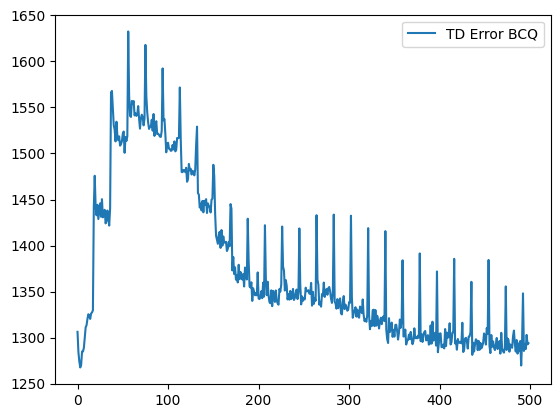

In [ ]:
plt.plot(range(499), error_BCQ.iloc[:,2], label = 'TD Error BCQ')
# Add legend
plt.legend()

# Show the plot
plt.show()

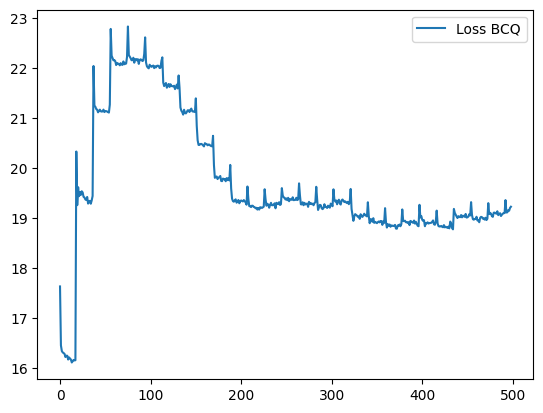

In [ ]:
plt.plot(range(499), loss_BCQ.iloc[:,2], label = 'Loss BCQ')
# Add legend
plt.legend()

# Show the plot
plt.show()

## Compare the TD error for all three algorithms 

In [ ]:
#### PLOT AND COMPARE TD ERROR OF ALL THREE ALGORITHMS #####

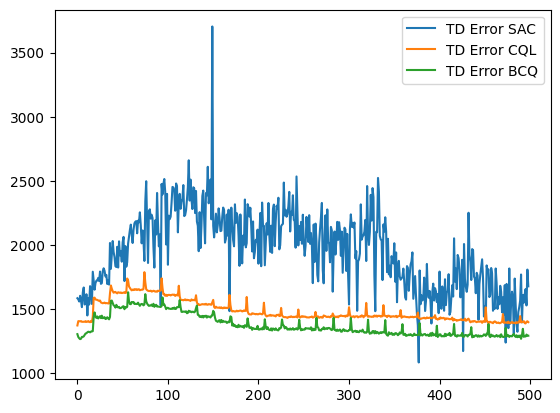

In [ ]:
plt.plot(range(499), logs_error_sac.iloc[:, 2], label = 'TD Error SAC')
plt.plot(range(499), logs_CQL.iloc[:,2], label = 'TD Error CQL')
plt.plot(range(499), error_BCQ.iloc[:,2], label = 'TD Error BCQ')


# Add legend
plt.legend()

# Show the plot
plt.show()

In [ ]:
import numpy as np 
R = np.array([[-1, 10, 25, 100],[-1, 10, 25, 100],[-1, 10, 25, 100]])

In [ ]:
print(R)

[[ -1  10  25 100]
 [ -1  10  25 100]
 [ -1  10  25 100]]
